### Imports

In [1]:
import pickle
from connections.mysql_connector import MySQL_Connector
from models.topic_modeling import Topic_Modeling
from connections.neo4j_connector import Neo4j_Connector
import os
from datetime import datetime
from gensim import corpora, models, similarities
from models.graph_generator import Graph_Generator
from models.tuple_extractor import Tuple_Extractor
from acessos import read, get_conn, persistir_uma_linha, persistir_multiplas_linhas, replace_df, update_banco
import pandas as pd
import re
import numpy as np
import spacy
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from gensim.parsing.preprocessing import strip_punctuation
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
import numpy as np
from tqdm.auto import tqdm  # for notebooks
import math

### Funções

In [7]:
def gerar_tuplas(texto):
    tuple_extractor.extrair_tupla(texto)
    
    try:
        df_tuplas = tuple_extractor.get_ultimas_tuplas_geradas()
    except:
        df_tuplas = pd.DataFrame()
    
    return df_tuplas

def gerar_df_doc(texto, video_id=""):
    if video_id !="":
        data =  {'nome': [texto], 'type': ["DOC"], 'id': [video_id]}
    else:
        data =  {'nome': [texto], 'type': ["DOC"]}
    
    df_doc = pd.DataFrame(data=data)
    return df_doc

def pre_processar_tuplas(df_tuplas):
    df_tuplas['arg1'] = df_tuplas.apply(lambda x: graph_generator.pre_process_text(x['arg1']), axis=1) 
    df_tuplas['arg2'] = df_tuplas.apply(lambda x: graph_generator.pre_process_text(x['arg2']), axis=1) 
    df_tuplas['rel'] = df_tuplas.apply(lambda x: graph_generator.pre_process_text(x['rel'], rel=True), axis=1) 
    
    return df_tuplas

def get_df_sentencas(df_tuplas, video_id):
    lista_sentencas = df_tuplas["sentenca"].unique().tolist()
    data = {'sentenca':lista_sentencas}
    df_sentencas = pd.DataFrame(data)
    df_sentencas['video_id'] = video_id
    return df_sentencas

def processar_df_tuplas(df_tuplas):
    
    df_arg1 = df_tuplas[['arg1']]
    df_arg1['type'] = "ARG1"
    df_arg1 = df_arg1.rename(columns={"arg1": 'nome'})
    
    df_arg2 = df_tuplas[['arg2']]
    df_arg2['type'] = "ARG2"
    df_arg2 = df_arg2.rename(columns={"arg2": 'nome'})
    
    return df_arg1, df_arg2

def gerar_relacao_doc_sentenca(texto, df_sentencas):
    #ATENÇÃO usar somente após a criação dos nós sentenças e doc
    for sentenca in df_sentencas.iterrows():
        neo4j_client.criar_relacao_de_para(texto, sentenca[1]['nome'], "DOC", sentenca[1]['type'], "extraiu")

def gerar_relacao_arg1_rel_arg2(df_tuplas):
    #ATENÇÃO usar somente após a criação dos nós arg1, arg2 e rel
    for linha in df_tuplas.iterrows():
        relacao = "RELAÇÃO_TUPLA {rel:'" + linha[1]["rel"] + "'}"
        neo4j_client.criar_relacao_de_para(linha[1]["arg1"], linha[1]['arg2'], "ARG1", "ARG2", relacao)
        

def gerar_relacao_sentenca_arg1(df_tuplas): #estou chamando de relação cabeça
    for linha in df_tuplas.iterrows():
        neo4j_client.criar_relacao_de_para(linha[1]["sentenca"], linha[1]['arg1'], "SENTENÇA", "ARG1", "extraiu")
        
def processar_texto_entrada(texto): #Remover emojis tag [Musica]... e as aspas
    emoji_pattern = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U0001F1F2-\U0001F1F4"  # Macau flag
        u"\U0001F1E6-\U0001F1FF"  # flags
        u"\U0001F600-\U0001F64F"
        u"\U00002702-\U000027B0"
        u"\U000024C2-\U0001F251"
        u"\U0001f926-\U0001f937"
        u"\U0001F1F2"
        u"\U0001F1F4"
        u"\U0001F620"
        u"\u200d"
        u"\u2640-\u2642"
        "]+", flags=re.UNICODE)
    
    texto = re.sub(r"\[.*?\]\s*", "", texto)
    texto = texto.replace("'", "")
    texto = texto.replace('"', "")
    texto = texto.replace('\n', " ")
    #texto = texto.rstrip("\n")
    texto = emoji_pattern.sub(r'', texto)
    
    return texto

def calcular_similaridade_jaccard(texto1, texto2):
    texto1 = str(texto1).lower()
    texto1 = strip_punctuation(texto1)
    
    texto2 = str(texto2).lower()
    texto2 = strip_punctuation(texto2)
    
    s1 = set(texto1.split())
    s2 = set(texto2.split())
          
    return float(len(s1.intersection(s2)) / len(s1.union(s2)))


def calcular_similaridade_cos(texto1, texto2):
    texto1 = str(texto1).lower()
    texto1 = strip_punctuation(texto1)
    
    texto2 = str(texto2).lower()
    texto2 = strip_punctuation(texto2)
    
    tfidf_vectorizer = TfidfVectorizer()
    list_doc = (texto1, texto2)
    tfidf_vectorizer = TfidfVectorizer()
    tfidf_matrix = tfidf_vectorizer.fit_transform(list_doc)
    
    similaridade = cosine_similarity(tfidf_matrix[0], tfidf_matrix[1])[0][0]
    return similaridade

def obter_embedding(texto):
    return nlp(texto).vector


# FUNÇÕES K-MEANS
def most_frequent(List): 
    return max(set(List), key = List.count) 

def gerar_modelos_kMeans(componentes, metric="distortion"):
    
#     max_k = 15
    max_k = 100
    #componentes = np.unique(componentes, axis=0) 
     
    #print("Tam apos remoção: {}".format(len(componentes)))
    if len(componentes)==1:
        return 1   
    
    if len(componentes)==2:
        #TODO IMPLEMENTAR REGRA DE SIMILARIDADE!!!!
        return -1    
        
        
    if len(componentes)<15:
        max_k = len(componentes)
        #return max_k    
        
    #print("Max k: {}".format(max_k))
    lista_k = []
    dict_modelos = {}
    
    for i in range(0, 10):

        model = KMeans()
        visualizer = KElbowVisualizer(model, k=(2,max_k), timings=False, showbool=False, metric=metric)
        visualizer.fit(componentes)        # Fit the data to the visualizer
        valor_k = visualizer.elbow_value_
        lista_k.append(valor_k)

    visualizer.show() # Finalize and render the figure
    melhor_k = most_frequent(lista_k)
    
    if melhor_k is None:
        melhor_k = -1
    
    return melhor_k

def categorizar_tuplas_clusters(num_tuplas):
    if num_tuplas <= 5:
        return "<= 5"
    if num_tuplas <= 10:
        return "<= 10"
    if num_tuplas <= 15:
        return "<= 15"
    if num_tuplas <= 20:
        return "<= 20"
    if num_tuplas <= 25:
        return "<= 25"
    if num_tuplas <=30:
        return "<= 30"
    if num_tuplas > 30:
        return "> 30"
    

### Conectando com o banco de dados


In [8]:
nlp = spacy.load("pt_core_news_lg")

connector = MySQL_Connector("conn_orfeu")
db_name = "flairs2"
conn = connector.return_conn(db_name)

#conn = connector.return_conn("influencer_br")
tuple_extractor = Tuple_Extractor()

### Carregando o corpus


In [5]:
query = "SELECT video_id, transcription FROM video where status = 0"
df_corpus = read(conn,query)
print(df_corpus.shape)
df_corpus.head()

(0, 0)


""


# Extraindo as tuplas


In [20]:
def persistir_df_sentencas(df_sentencas, video_id):
    status = replace_df(df_sentencas,"sentencas", conn)
    
    if status == -1:
        print("erro nas sentenças do video: {}".format(video_id))
        return df_sentencas, -1
    
    query = "SELECT * FROM sentencas where video_id = '{}'".format(video_id)
    
    df_sentencas = read(conn, query)
    
    return df_sentencas, 1

def persistir_df_tuplas(df_tuplas):
    status = replace_df(df_tuplas,"tuplas", conn)
    
    if status == -1:
        print("erro nas tuplas do video: {}".format(video_id))
        return -1
    return status 

def atualizar_status_video(video_id, status):
    dict_set = {"status":status}
    dict_where = {"video_id": video_id}
    update_banco(dict_set, dict_where, "video", conn)
    

for row in tqdm(df_corpus.iterrows(), total=df_corpus.shape[0]):
    print("        --> Processando video: {}".format(row[1]['video_id']))
    conn = connector.return_conn(db_name)
    
    texto = row[1]['transcription']
    video_id = row[1]['video_id']
    
    
    df_tuplas = gerar_tuplas(texto)
    
    if df_tuplas.empty:
        print("df_tuplas vazio e nada será feito!!")
        atualizar_status_video(video_id, -1)
        continue
    
    df_sentencas = get_df_sentencas(df_tuplas, video_id)
    
    #persiste as sentenças no banco e retorna o df_sentença com os ids do banco
    df_sentencas, status_sentenca = persistir_df_sentencas(df_sentencas, video_id) 
    
    #Adiciona o id da sentença nas tuplas 
    df_tuplas = pd.merge(df_tuplas, df_sentencas, on="sentenca")
    #remove o texto da sentença
    df_tuplas.drop(['sentenca'], inplace=True, axis=1)
    
    #Gerando a tupla completa
    df_tuplas['tupla_completa'] = df_tuplas.apply(lambda x: "{} {} {}".format(x['arg1'],
                                                                          x['rel'].replace('_', " "),
                                                                          x['arg2']),
                                              axis=1)
    
    status_tuplas = persistir_df_tuplas(df_tuplas)
    
    if status_tuplas == 1 and status_sentenca == 1:
        atualizar_status_video(video_id, 1)
        print("*** SUCESSO!! **")
    else:
        atualizar_status_video(video_id, -1)
        print("*** ERRO!! **")




        --> Processando video: --K2l7qd7W0
 -> Salvando texto no input.txt
  -> Extraindo Tuplas...
Pronto :D
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Sucesso no UPDATE
*** SUCESSO!! **
        --> Processando video: --to_yZQfEU
 -> Salvando texto no input.txt
  -> Extraindo Tuplas...
Pronto :D
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Sucesso no UPDATE
*** SUCESSO!! **
        --> Processando video: -0ztRC_ygpA
 -> Salvando texto no input.txt
  -> Extraindo Tuplas...
Pronto :D
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Sucesso no UPDATE
*** SUCESSO!! **
        --> Processando video: -1aclOmWGIE
 -> Salvando texto no input.txt
  -> Extraindo Tuplas...
Pronto :D
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Sucesso no UPDATE
*** SUCESSO!! **
        --> Processando video: -68JFjOrOdI
 -> Salvando texto no input.txt
 

# Obtendo os Embeddings

In [23]:
query = "SELECT * FROM tuplas"
df_tuplas = read(conn, query)

query = "SELECT * FROM sentencas"
df_sentencas = read(conn, query)

print("Sentenças...")
df_sentencas['word_embedding_sentenca'] = df_sentencas.apply(lambda x: obter_embedding(x['sentenca']), axis=1)
df_sentencas.head()

print("Arg1...")
df_tuplas['word_embedding_arg1'] = df_tuplas.apply(lambda x: obter_embedding(x['arg1']), axis=1)

print("Arg2...")
df_tuplas['word_embedding_arg2'] = df_tuplas.apply(lambda x: obter_embedding(x['arg2']), axis=1)

print("Rel...")
df_tuplas['word_embedding_rel'] = df_tuplas.apply(lambda x: obter_embedding(x['rel']), axis=1)

print("Tupla Completa...")
df_tuplas['word_embedding_tupla_completa'] = df_tuplas.apply(lambda x: obter_embedding(x['tupla_completa']), axis=1)

Sentenças...
Arg1...
Arg2...
Rel...
Tupla Completa...


In [39]:
df_word_sent = df_sentencas[["word_embedding_sentenca","sentenca_id"]].rename(
    columns={"word_embedding_sentenca": "word_embedding"})
df_word_sent['label'] = "sent"
df_word_sent['tupla_id'] = -1

df_word_arg1 = df_tuplas[["word_embedding_arg1","sentenca_id", "tupla_id"]].rename(
    columns={"word_embedding_arg1": "word_embedding"})
df_word_arg1['label'] = "arg1"

df_word_arg2 = df_tuplas[["word_embedding_arg2","sentenca_id", "tupla_id"]].rename(
    columns={"word_embedding_arg2": "word_embedding"})
df_word_arg2['label'] = "arg2"

df_word_rel = df_tuplas[["word_embedding_rel","sentenca_id", "tupla_id"]].rename(
    columns={"word_embedding_rel": "word_embedding"})
df_word_rel['label'] = "rel"

df_word_tupla_completa = df_tuplas[["word_embedding_tupla_completa", "sentenca_id", "tupla_id"]].rename(
    columns={"word_embedding_tupla_completa": "word_embedding"})
df_word_tupla_completa['label'] = "tupla_completa"


frames = [
    df_word_sent,
    df_word_arg1,
    df_word_arg2,
    df_word_rel,
    df_word_tupla_completa   
]

df_aux = pd.concat(frames, ignore_index=True,sort=True)
df_aux.reset_index(drop=True)
# df_aux.reset_index(drop=True)

df_embeddings = pd.DataFrame(df_aux['word_embedding'].to_list()).rename(
    columns={key:f'''dim_{str(key+1)}''' for key in range(len(df_aux['word_embedding'][0]))} )


df_embeddings = pd.concat([df_aux[["label","sentenca_id", "tupla_id"]],df_embeddings], axis=1)

df_embeddings.head()

,label,sentenca_id,tupla_id,dim_1,dim_2,dim_3,dim_4,dim_5,dim_6,dim_7,...,dim_291,dim_292,dim_293,dim_294,dim_295,dim_296,dim_297,dim_298,dim_299,dim_300
0,sent,1,-1,-1.209558,-0.072367,0.774506,1.106767,-1.936779,-0.760900,-1.407283,...,0.741058,3.395386,3.047692,1.652314,-0.350771,-2.433272,2.243453,0.027623,-0.291306,1.207734
1,sent,2,-1,0.420354,-0.473905,-0.685078,2.241324,-1.089828,-0.223676,-0.179414,...,1.876480,3.328717,1.899621,1.746925,0.600629,-1.927907,1.194448,1.674927,-0.894944,0.633434
2,sent,3,-1,-0.065644,-1.059596,-0.544430,0.901529,-1.362480,-0.132255,-0.134447,...,1.050342,2.825549,-0.554776,0.071316,0.588129,-1.551312,0.653755,0.509141,0.143283,1.219816
3,sent,4,-1,-0.733679,-1.468997,0.312858,0.711822,-1.385231,0.467892,1.165696,...,1.017903,2.478750,-0.870178,1.169799,0.133927,-1.237739,-0.195538,0.881841,0.411981,1.719538
4,sent,5,-1,-0.212000,-0.987506,-0.505106,0.938903,-1.712626,0.022673,-0.032995,...,-0.036155,3.268988,0.290386,-0.572548,0.326845,-1.566797,1.023622,-0.281238,0.551349,1.513116


### Persistindo os Embeddings

In [42]:
status = replace_df(df_embeddings,"embeddings", conn)

Iniciando Persistencia
Sucesso na inserção


### Normalizando os dados

In [43]:
features = df_embeddings.drop(["label","sentenca_id", "tupla_id"], axis=1).columns.to_list()
array_valores = df_embeddings.loc[:, features].values
array_normalizado = StandardScaler().fit_transform(array_valores)

len(array_normalizado)

94564

### Reduzindo a dimensionalidade

In [44]:
tsne = TSNE()
tsne_results = tsne.fit_transform(array_normalizado)

componentes = tsne_results

componentes

array([[-31.47932  , -27.311396 ],
       [  9.763819 ,   1.0188079],
       [ -5.1876984,  19.216318 ],
       ...,
       [-15.840411 , -15.463295 ],
       [ -2.917844 ,  31.0955   ],
       [-15.955687 , -15.403615 ]], dtype=float32)

### Recuperando os IDs dos embeddings no bancos

In [47]:
query = "SELECT embedding_id, sentenca_id, tupla_id, label FROM embeddings"
df_consulta_embedding = read(conn, query)
df_consulta_embedding.head()

,embedding_id,sentenca_id,tupla_id,label
0,1,1,-1,sent
1,2,2,-1,sent
2,3,3,-1,sent
3,4,4,-1,sent
4,5,5,-1,sent


#### Gerando o DF do T-SNE
#### Vinculando o id do embedding no T-SNE

In [48]:
df_tsne = pd.DataFrame(data=componentes)
df_tsne = pd.concat([df_aux[["label", "sentenca_id", "tupla_id"]],df_tsne], axis=1)
df_tsne.rename(columns={0: "dim_1",1: "dim_2"},inplace=True)

df_tsne = pd.merge(df_tsne, df_consulta_embedding, on=["sentenca_id","tupla_id","label"])


status = replace_df(df_tsne,"tsne", conn)

df_tsne.head()

Iniciando Persistencia
Sucesso na inserção


,label,sentenca_id,tupla_id,dim_1,dim_2,embedding_id
0,sent,1,-1,-31.479321,-27.311396,1
1,sent,2,-1,9.763819,1.018808,2
2,sent,3,-1,-5.187698,19.216318,3
3,sent,4,-1,-4.417983,21.309738,4
4,sent,5,-1,-19.630926,-8.238655,5


# Trabalhando com os Agrupamentos
## Processando Tuplas Completas

Informe tag do método:
tsne_distortion_grupo_100
Informe table - embeddings/tsne:
tsne
Informe a medida do cotovelo - distortion/silhouette/calinski_harabasz:
distortion


Processando sent: 1
Iniciando Persistencia
Sucesso na inserção
Processando sent: 2


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 3
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 4


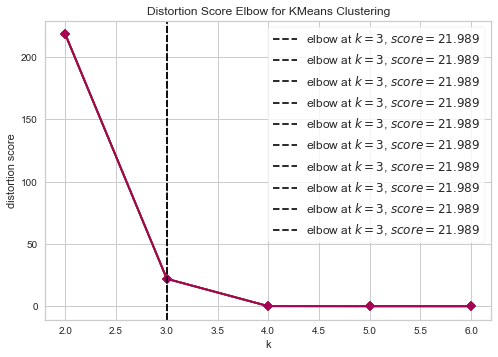

Iniciando Persistencia
Sucesso na inserção
Processando sent: 5
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 6


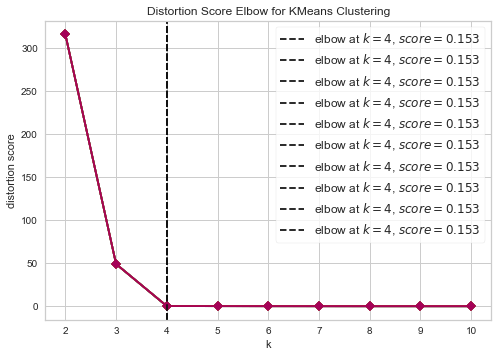

Iniciando Persistencia
Sucesso na inserção
Processando sent: 7


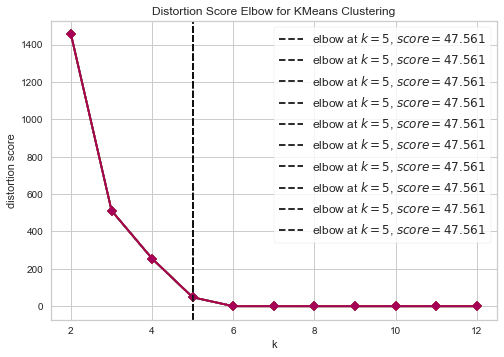

Iniciando Persistencia
Sucesso na inserção
Processando sent: 8
Iniciando Persistencia
Sucesso na inserção
Processando sent: 9


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

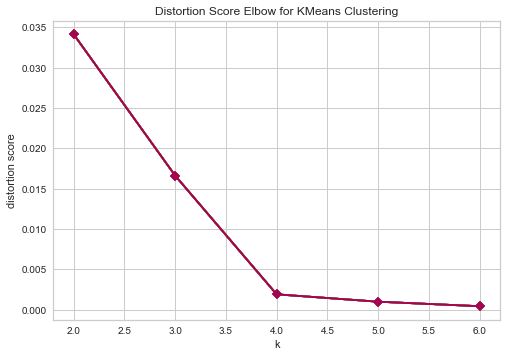

Iniciando Persistencia
Sucesso na inserção
Processando sent: 10


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (17) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (17) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 11
Iniciando Persistencia
Sucesso na inserção
Processando sent: 12
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 13


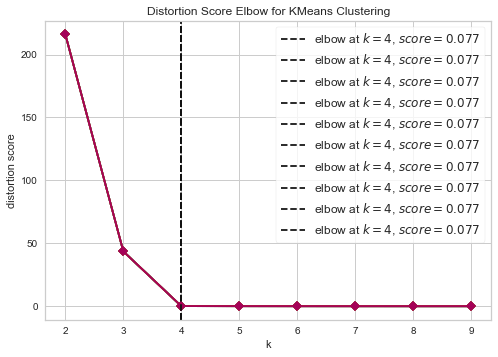

Iniciando Persistencia
Sucesso na inserção
Processando sent: 14


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (34) found smaller than n_clusters (35). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warni

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 15


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

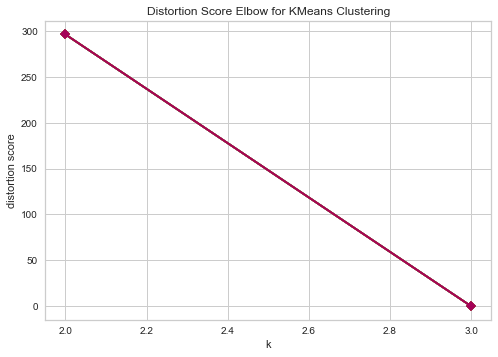

Iniciando Persistencia
Sucesso na inserção
Processando sent: 16


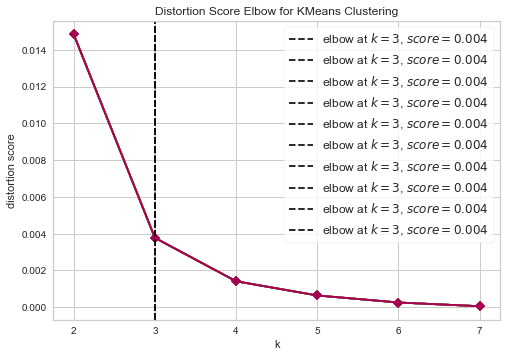

Iniciando Persistencia
Sucesso na inserção
Processando sent: 17


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 18
Iniciando Persistencia
Sucesso na inserção
Processando sent: 19
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 20


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

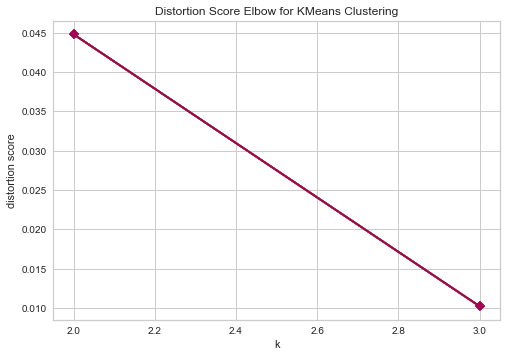

Iniciando Persistencia
Sucesso na inserção
Processando sent: 21
Iniciando Persistencia
Sucesso na inserção
Processando sent: 22
Iniciando Persistencia
Sucesso na inserção
Processando sent: 23


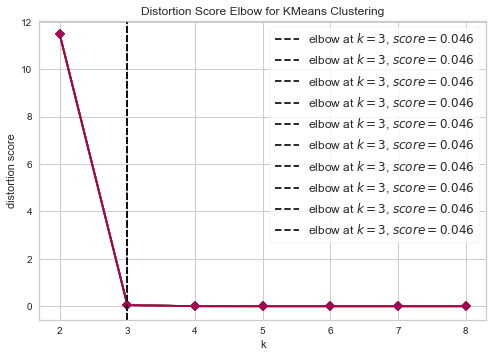

Iniciando Persistencia
Sucesso na inserção
Processando sent: 24


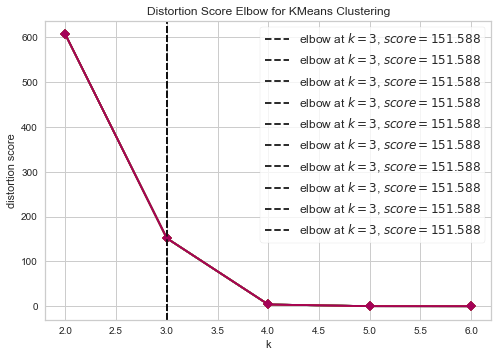

Iniciando Persistencia
Sucesso na inserção
Processando sent: 25
Iniciando Persistencia
Sucesso na inserção
Processando sent: 26
Iniciando Persistencia
Sucesso na inserção
Processando sent: 27
Iniciando Persistencia
Sucesso na inserção
Processando sent: 28
Iniciando Persistencia
Sucesso na inserção
Processando sent: 29
Iniciando Persistencia
Sucesso na inserção
Processando sent: 30


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

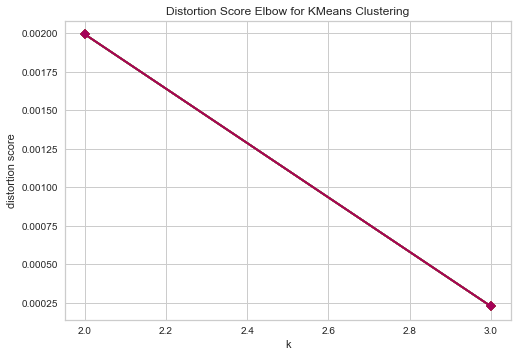

Iniciando Persistencia
Sucesso na inserção
Processando sent: 31


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

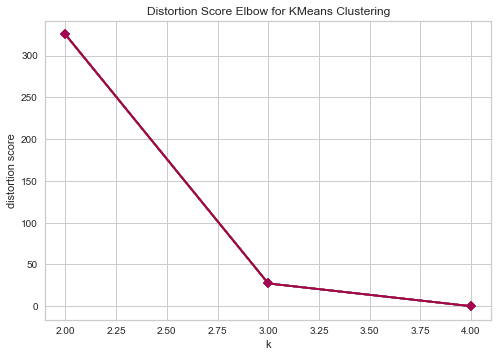

Iniciando Persistencia
Sucesso na inserção
Processando sent: 32


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

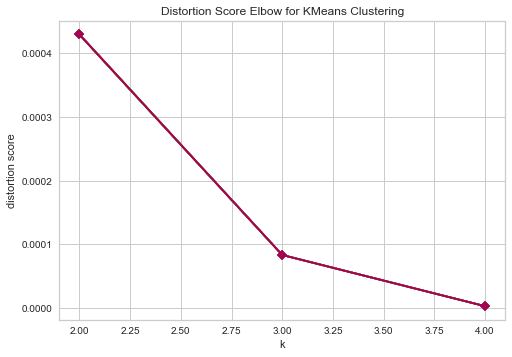

Iniciando Persistencia
Sucesso na inserção
Processando sent: 33


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

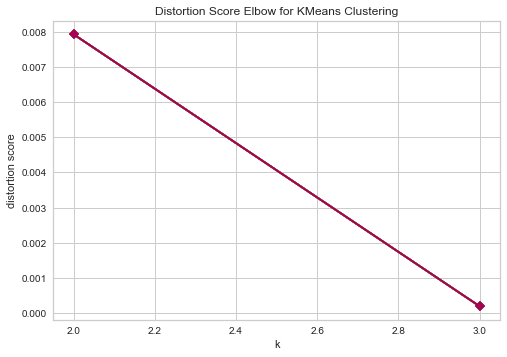

Iniciando Persistencia
Sucesso na inserção
Processando sent: 34


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 35


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (33). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (34). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (35). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (36). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 36


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

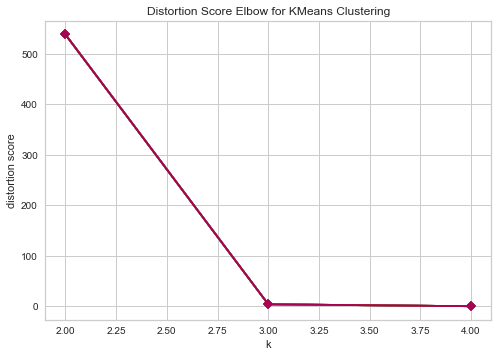

Iniciando Persistencia
Sucesso na inserção
Processando sent: 37
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 38


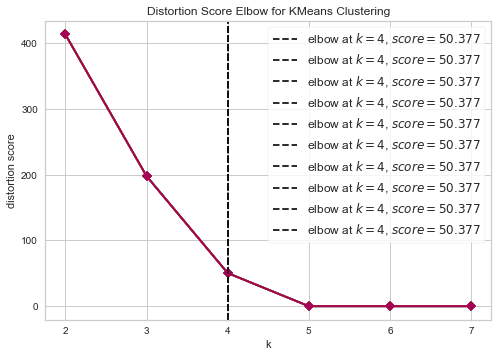

Iniciando Persistencia
Sucesso na inserção
Processando sent: 39


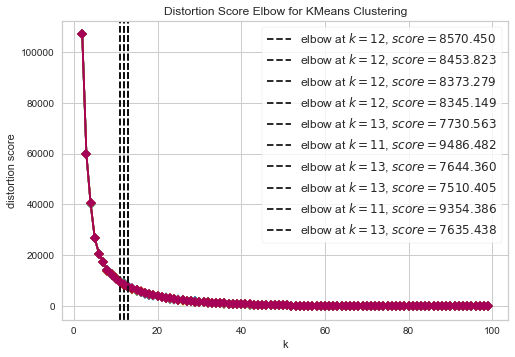

Iniciando Persistencia
Sucesso na inserção
Processando sent: 40


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 41
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 42


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

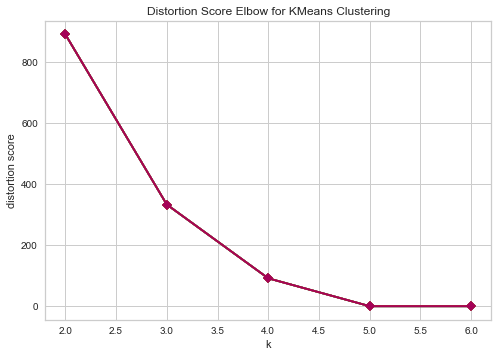

Iniciando Persistencia
Sucesso na inserção
Processando sent: 43


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 44
Iniciando Persistencia
Sucesso na inserção
Processando sent: 45
Iniciando Persistencia
Sucesso na inserção
Processando sent: 46


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 47
Iniciando Persistencia
Sucesso na inserção
Processando sent: 48
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 49


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (38) found smaller than n_clusters (39). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (38) found smaller than n_clusters (40). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 50


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

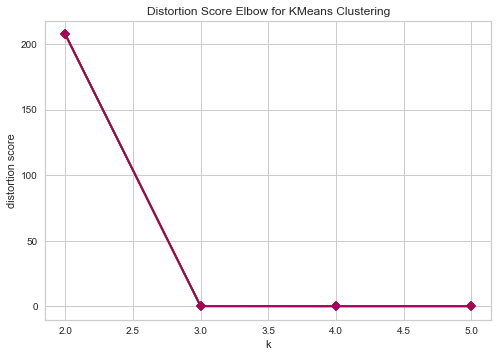

Iniciando Persistencia
Sucesso na inserção
Processando sent: 51


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 52


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (17) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (17) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 53
Iniciando Persistencia
Sucesso na inserção
Processando sent: 54


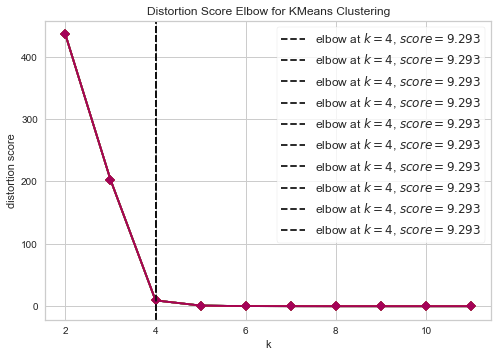

Iniciando Persistencia
Sucesso na inserção
Processando sent: 55


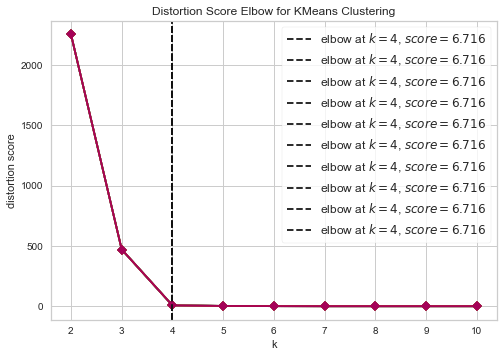

Iniciando Persistencia
Sucesso na inserção
Processando sent: 56


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

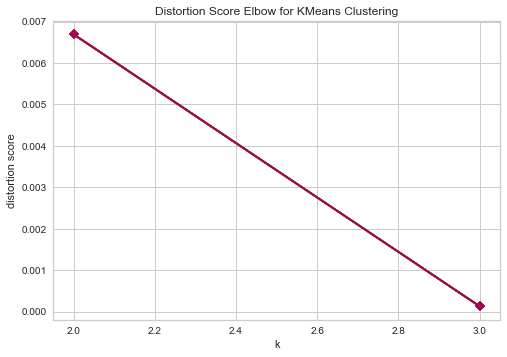

Iniciando Persistencia
Sucesso na inserção
Processando sent: 57
Iniciando Persistencia
Sucesso na inserção
Processando sent: 58


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

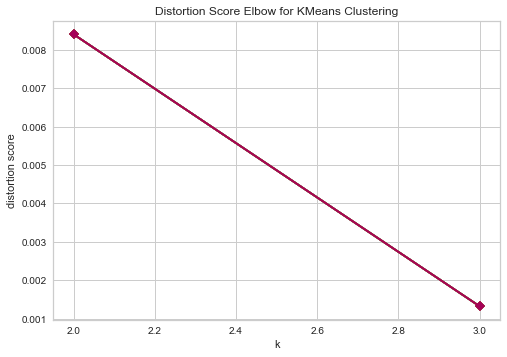

Iniciando Persistencia
Sucesso na inserção
Processando sent: 59


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

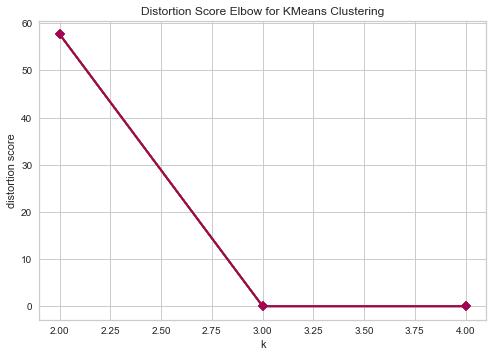

Iniciando Persistencia
Sucesso na inserção
Processando sent: 60
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 61


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (20) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (20) found smaller than n_clusters (22). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 62


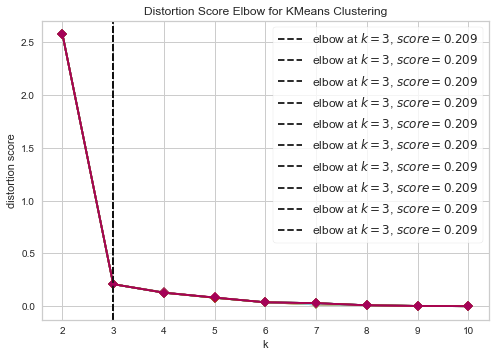

Iniciando Persistencia
Sucesso na inserção
Processando sent: 63
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 64
Iniciando Persistencia
Sucesso na inserção
Processando sent: 65
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 66


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (34) found smaller than n_clusters (35). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (34) found smaller than n_clusters (36). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 67
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 68
Iniciando Persistencia
Sucesso na inserção
Processando sent: 69
Iniciando Persistencia
Sucesso na inserção
Processando sent: 70


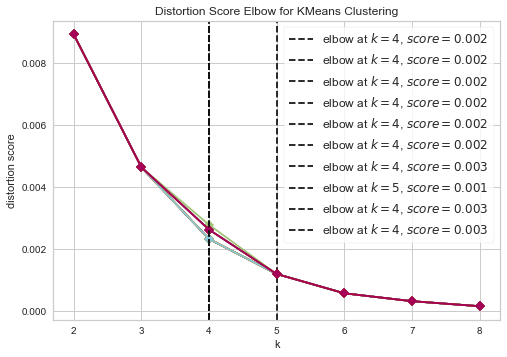

Iniciando Persistencia
Sucesso na inserção
Processando sent: 71


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

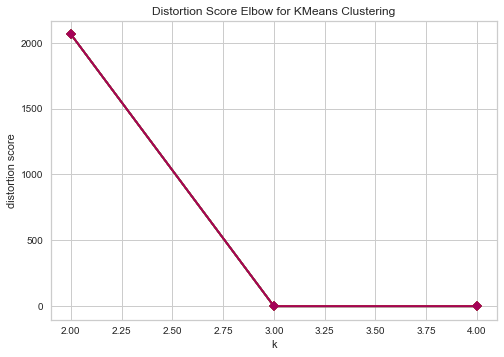

Iniciando Persistencia
Sucesso na inserção
Processando sent: 72
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 73


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

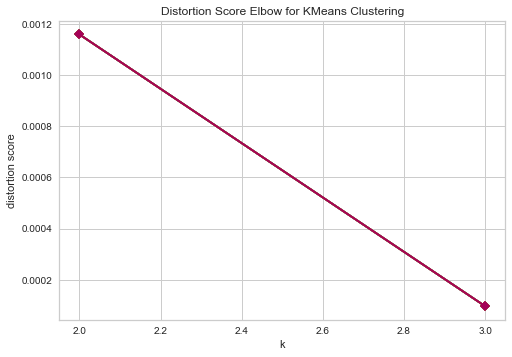

Iniciando Persistencia
Sucesso na inserção
Processando sent: 74


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

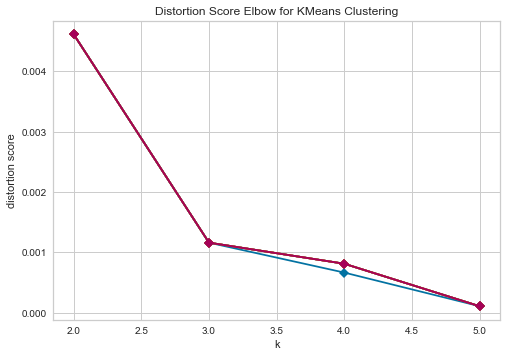

Iniciando Persistencia
Sucesso na inserção
Processando sent: 75
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 76
Iniciando Persistencia
Sucesso na inserção
Processando sent: 77
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 78


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (20) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (20) found smaller than n_clusters (22). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (20) found smaller than n_clusters (23). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (20) found smaller than n_clusters (24). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 79


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 80


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

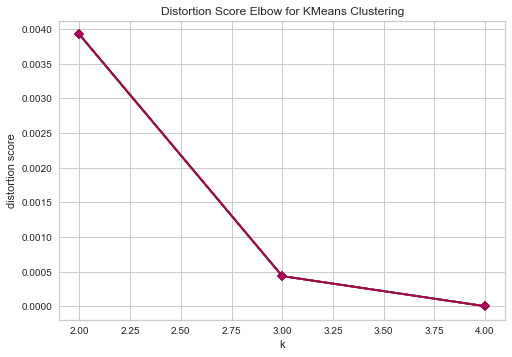

Iniciando Persistencia
Sucesso na inserção
Processando sent: 81


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

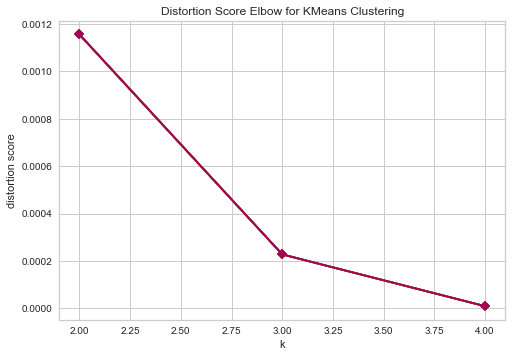

Iniciando Persistencia
Sucesso na inserção
Processando sent: 82


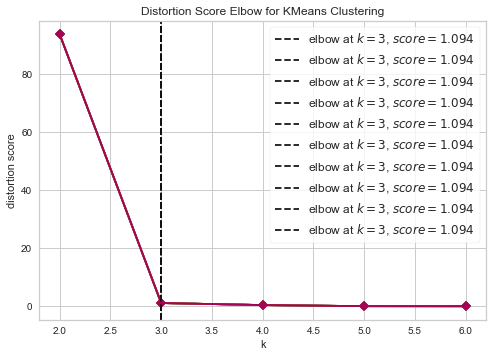

Iniciando Persistencia
Sucesso na inserção
Processando sent: 83


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

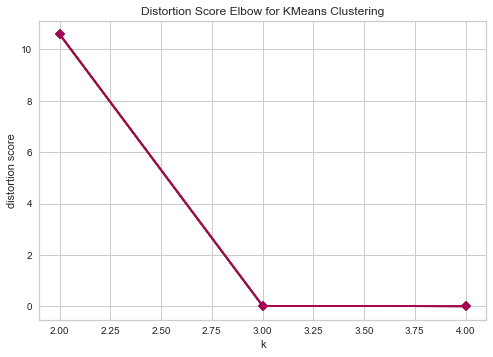

Iniciando Persistencia
Sucesso na inserção
Processando sent: 84
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 85
Iniciando Persistencia
Sucesso na inserção
Processando sent: 86
Iniciando Persistencia
Sucesso na inserção
Processando sent: 87


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

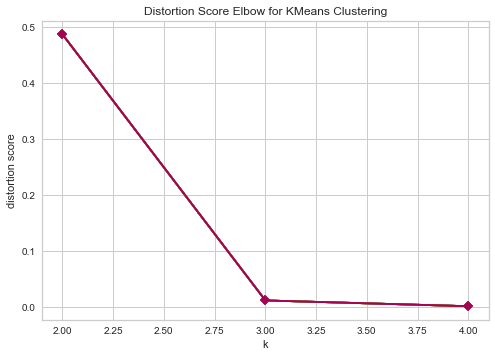

Iniciando Persistencia
Sucesso na inserção
Processando sent: 88
Iniciando Persistencia
Sucesso na inserção
Processando sent: 89
Iniciando Persistencia
Sucesso na inserção
Processando sent: 90
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 91
Iniciando Persistencia
Sucesso na inserção
Processando sent: 92


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

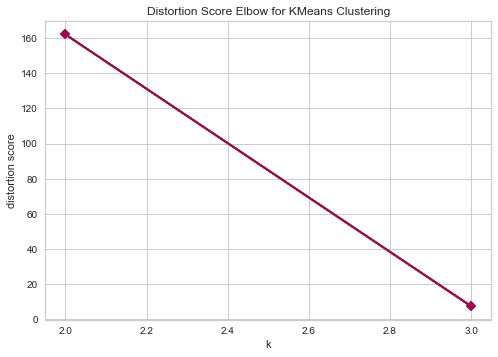

Iniciando Persistencia
Sucesso na inserção
Processando sent: 93
Iniciando Persistencia
Sucesso na inserção
Processando sent: 94


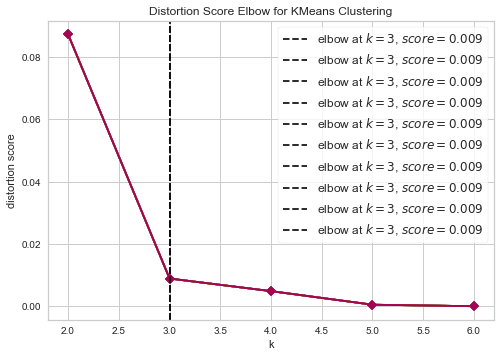

Iniciando Persistencia
Sucesso na inserção
Processando sent: 95


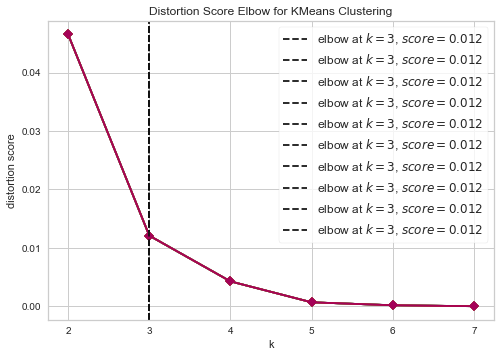

Iniciando Persistencia
Sucesso na inserção
Processando sent: 96


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

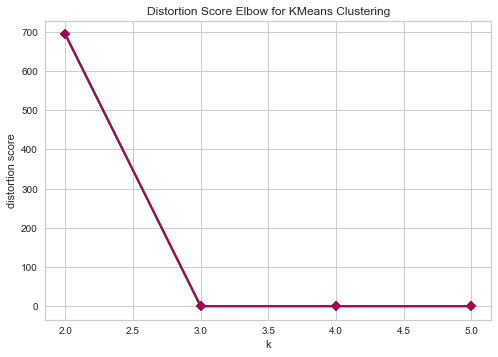

Iniciando Persistencia
Sucesso na inserção
Processando sent: 97
Iniciando Persistencia
Sucesso na inserção
Processando sent: 98
Iniciando Persistencia
Sucesso na inserção
Processando sent: 99


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

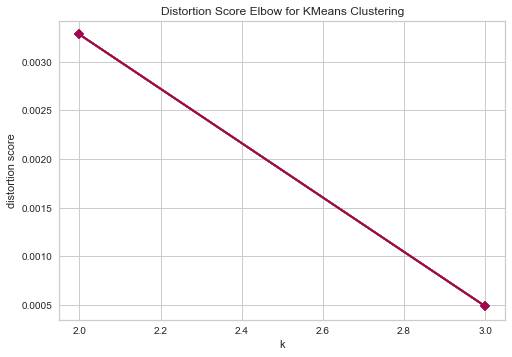

Iniciando Persistencia
Sucesso na inserção
Processando sent: 100


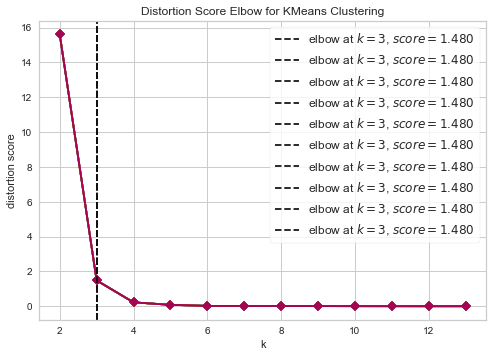

Iniciando Persistencia
Sucesso na inserção
Processando sent: 101
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 102
Iniciando Persistencia
Sucesso na inserção
Processando sent: 103


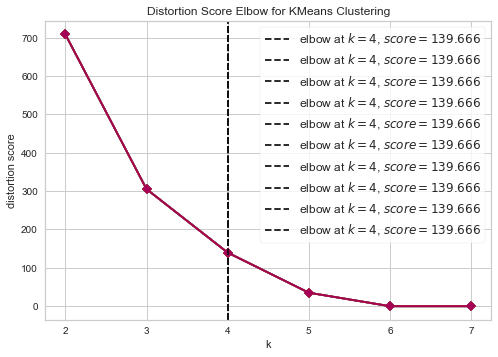

Iniciando Persistencia
Sucesso na inserção
Processando sent: 104
Iniciando Persistencia
Sucesso na inserção
Processando sent: 105


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (34) found smaller than n_clusters (35). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (34) found smaller than n_clusters (36). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 106
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 107


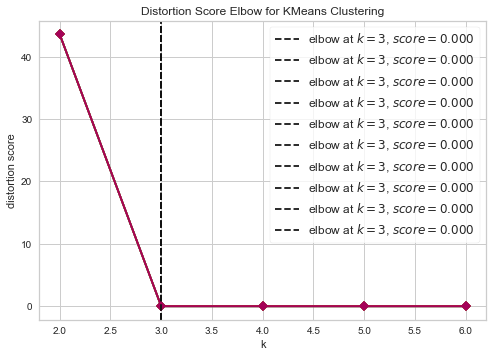

Iniciando Persistencia
Sucesso na inserção
Processando sent: 108


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

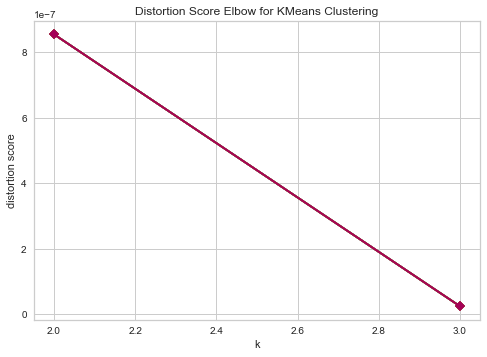

Iniciando Persistencia
Sucesso na inserção
Processando sent: 109


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (98) found smaller than n_clusters (99). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (98) found smaller than n_clusters (99). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (98) found smaller than n_clusters (99). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (98) found smaller than n_clusters (99). Possibly due to duplicate points in X.
  self.estimator.fit(X

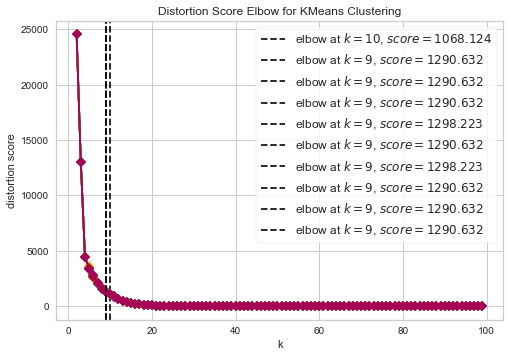

Iniciando Persistencia
Sucesso na inserção
Processando sent: 110


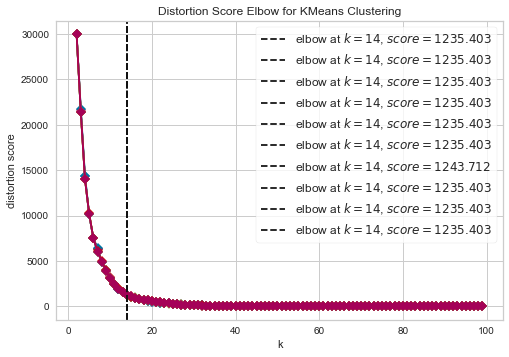

Iniciando Persistencia
Sucesso na inserção
Processando sent: 111


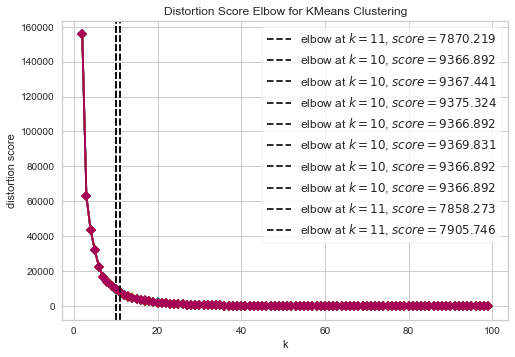

Iniciando Persistencia
Sucesso na inserção
Processando sent: 112
Iniciando Persistencia
Sucesso na inserção
Processando sent: 113
Iniciando Persistencia
Sucesso na inserção
Processando sent: 114
Iniciando Persistencia
Sucesso na inserção
Processando sent: 115


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

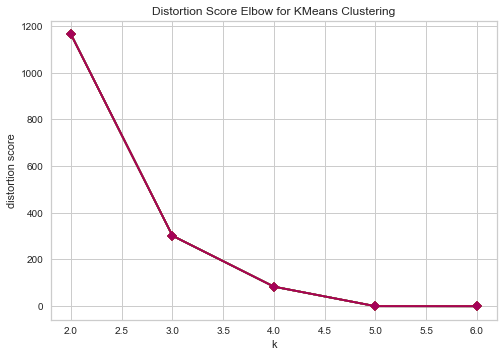

Iniciando Persistencia
Sucesso na inserção
Processando sent: 116
Iniciando Persistencia
Sucesso na inserção
Processando sent: 117
Iniciando Persistencia
Sucesso na inserção
Processando sent: 118


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

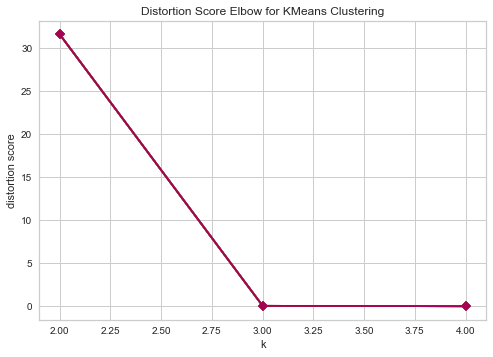

Iniciando Persistencia
Sucesso na inserção
Processando sent: 119


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **

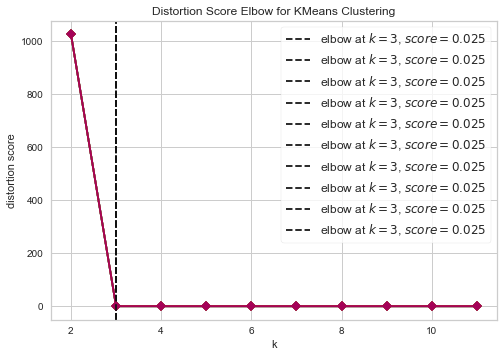

Iniciando Persistencia
Sucesso na inserção
Processando sent: 120


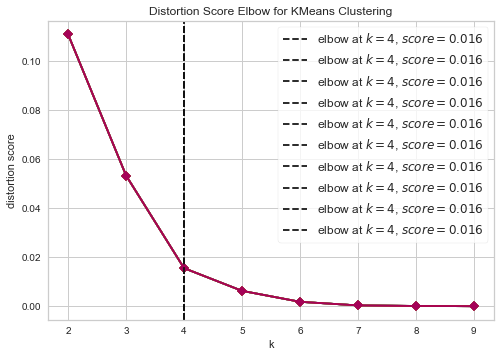

Iniciando Persistencia
Sucesso na inserção
Processando sent: 121
Iniciando Persistencia
Sucesso na inserção
Processando sent: 122


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (26) found smaller than n_clusters (27). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (26) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 123


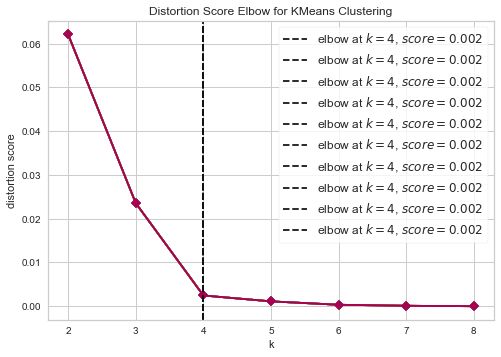

Iniciando Persistencia
Sucesso na inserção
Processando sent: 124


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

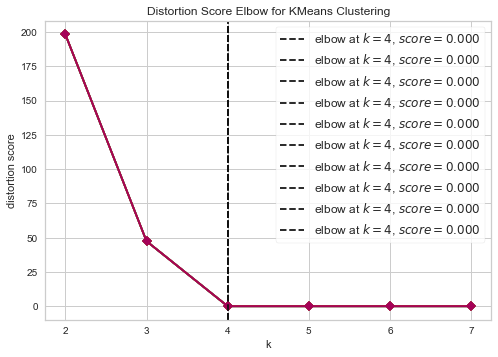

Iniciando Persistencia
Sucesso na inserção
Processando sent: 125


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

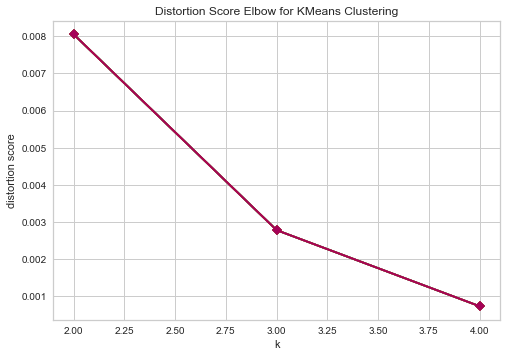

Iniciando Persistencia
Sucesso na inserção
Processando sent: 126


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

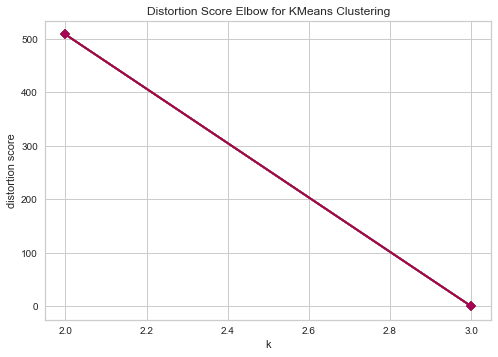

Iniciando Persistencia
Sucesso na inserção
Processando sent: 127
Iniciando Persistencia
Sucesso na inserção
Processando sent: 128


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

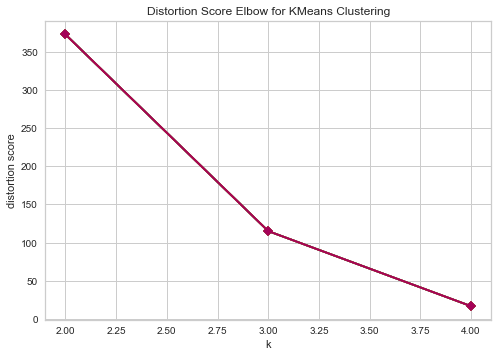

Iniciando Persistencia
Sucesso na inserção
Processando sent: 129


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (20) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 130


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (23) found smaller than n_clusters (24). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (23) found smaller than n_clusters (25). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 131


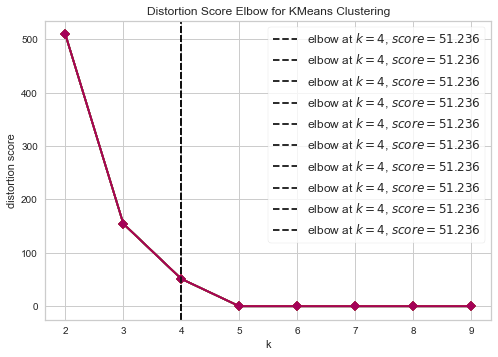

Iniciando Persistencia
Sucesso na inserção
Processando sent: 132


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

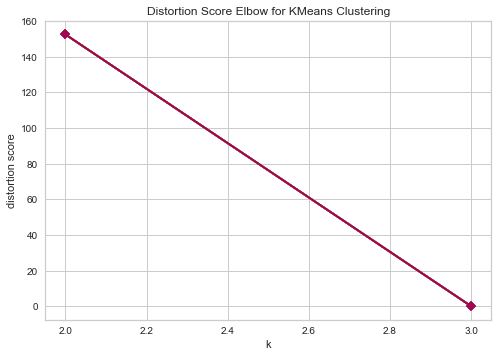

Iniciando Persistencia
Sucesso na inserção
Processando sent: 133


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

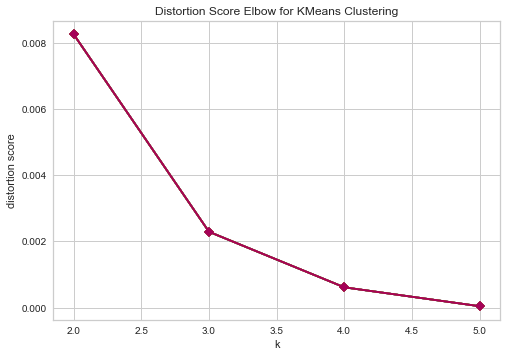

Iniciando Persistencia
Sucesso na inserção
Processando sent: 134
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 135
Iniciando Persistencia
Sucesso na inserção
Processando sent: 136


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 137


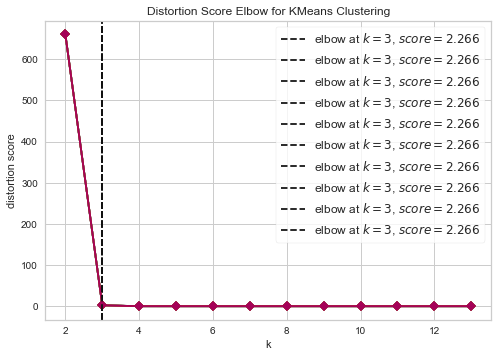

Iniciando Persistencia
Sucesso na inserção
Processando sent: 138


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

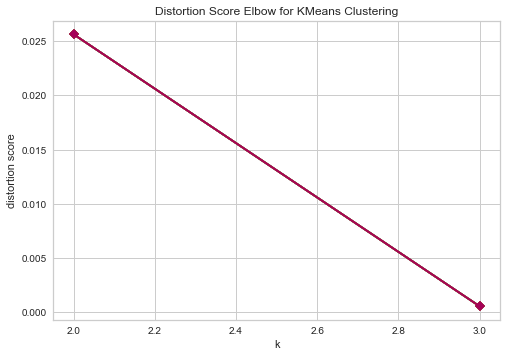

Iniciando Persistencia
Sucesso na inserção
Processando sent: 139


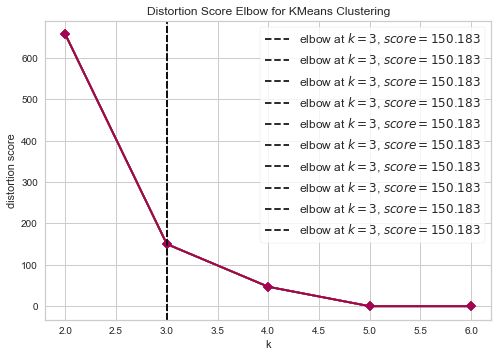

Iniciando Persistencia
Sucesso na inserção
Processando sent: 140


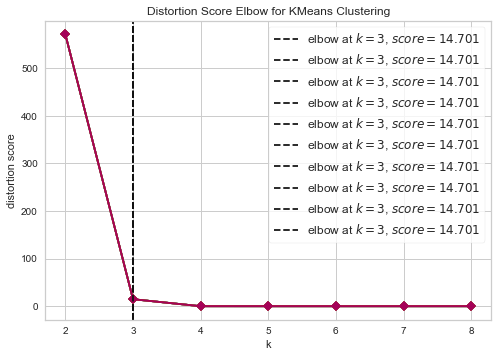

Iniciando Persistencia
Sucesso na inserção
Processando sent: 141


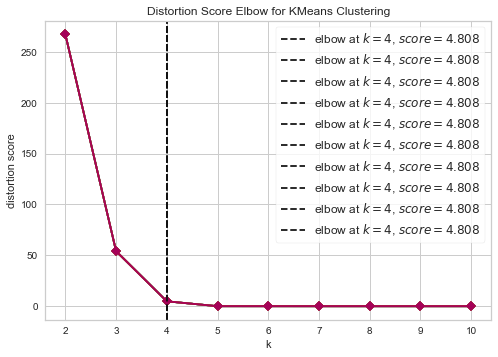

Iniciando Persistencia
Sucesso na inserção
Processando sent: 142


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X

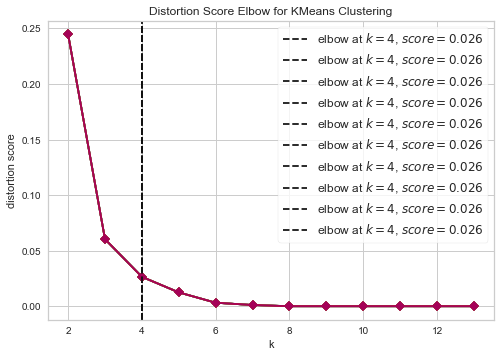

Iniciando Persistencia
Sucesso na inserção
Processando sent: 143


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

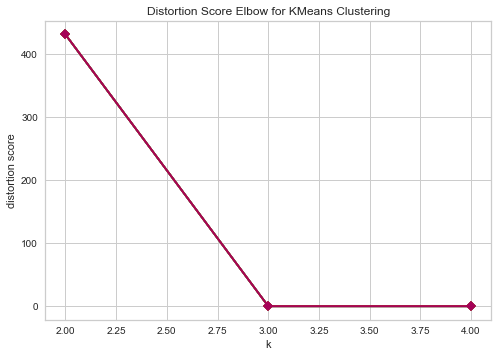

Iniciando Persistencia
Sucesso na inserção
Processando sent: 144


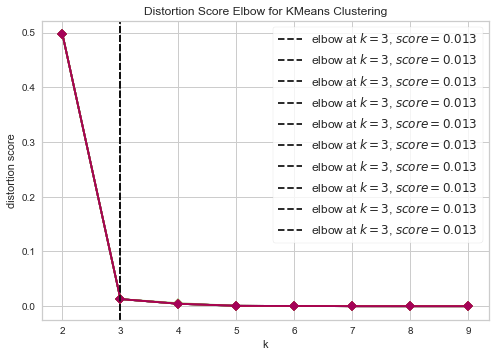

Iniciando Persistencia
Sucesso na inserção
Processando sent: 145
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 146


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (29). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 147


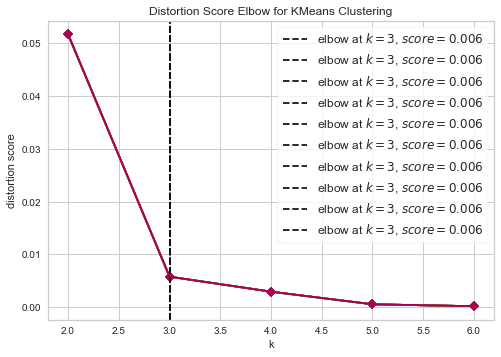

Iniciando Persistencia
Sucesso na inserção
Processando sent: 148
Iniciando Persistencia
Sucesso na inserção
Processando sent: 149


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

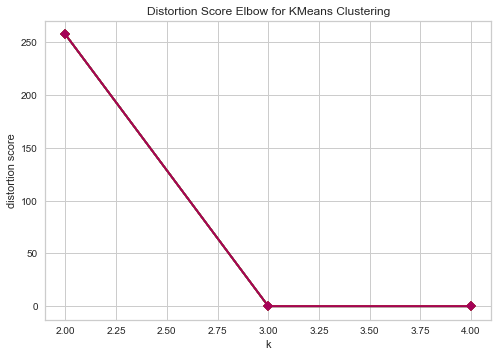

Iniciando Persistencia
Sucesso na inserção
Processando sent: 150


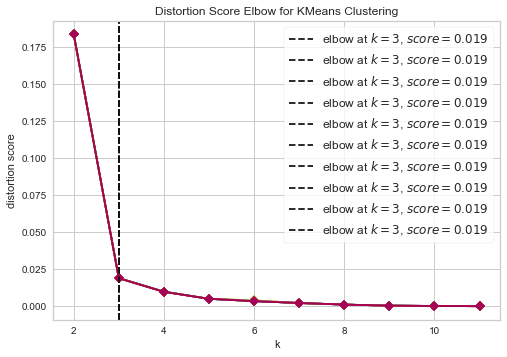

Iniciando Persistencia
Sucesso na inserção
Processando sent: 151


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 152
Iniciando Persistencia
Sucesso na inserção
Processando sent: 153


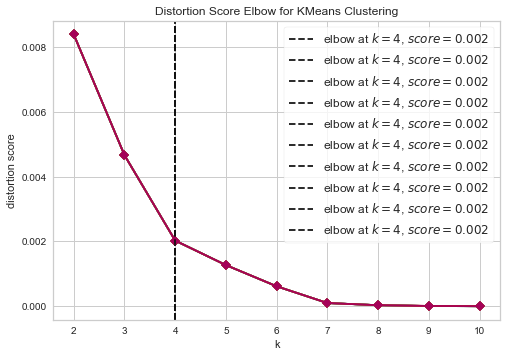

Iniciando Persistencia
Sucesso na inserção
Processando sent: 154


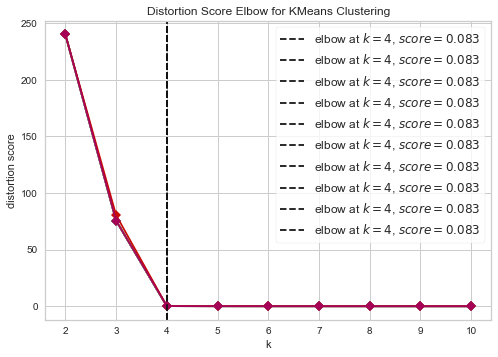

Iniciando Persistencia
Sucesso na inserção
Processando sent: 155
Iniciando Persistencia
Sucesso na inserção
Processando sent: 156
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 157
Iniciando Persistencia
Sucesso na inserção
Processando sent: 158


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

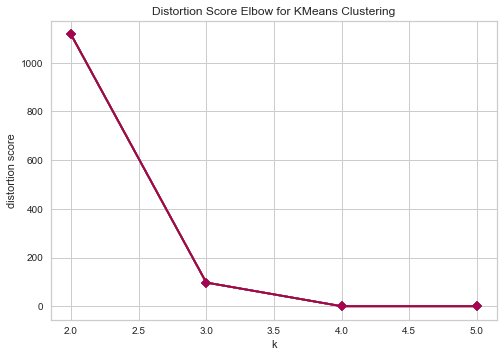

Iniciando Persistencia
Sucesso na inserção
Processando sent: 159
Iniciando Persistencia
Sucesso na inserção
Processando sent: 160
Iniciando Persistencia
Sucesso na inserção
Processando sent: 161
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 162


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

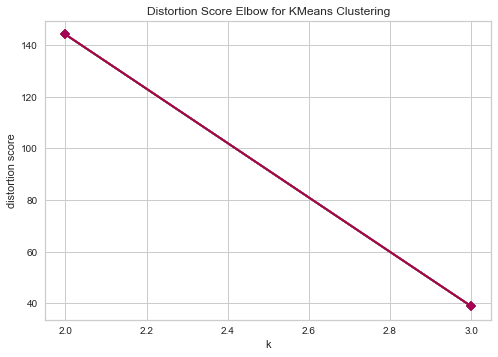

Iniciando Persistencia
Sucesso na inserção
Processando sent: 163
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 164
Iniciando Persistencia
Sucesso na inserção
Processando sent: 165
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 166


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 167
Iniciando Persistencia
Sucesso na inserção
Processando sent: 168


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 169


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

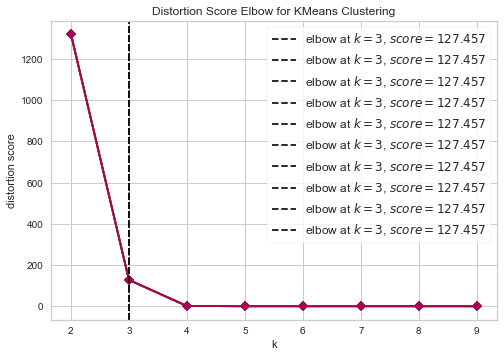

Iniciando Persistencia
Sucesso na inserção
Processando sent: 170


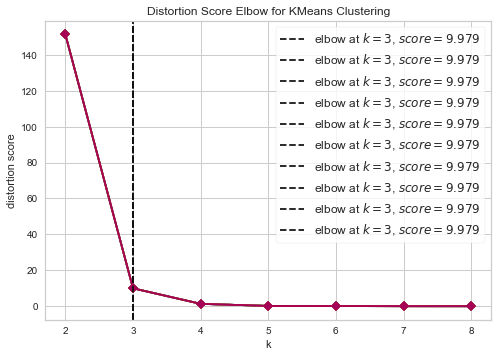

Iniciando Persistencia
Sucesso na inserção
Processando sent: 171
Iniciando Persistencia
Sucesso na inserção
Processando sent: 172


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

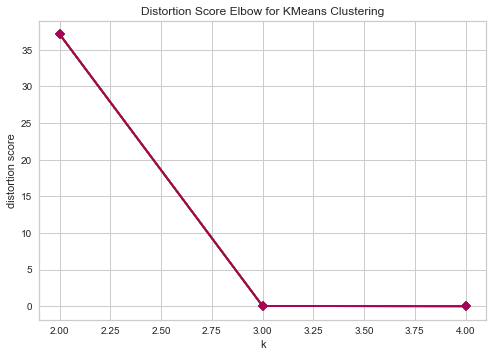

Iniciando Persistencia
Sucesso na inserção
Processando sent: 173
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 174


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

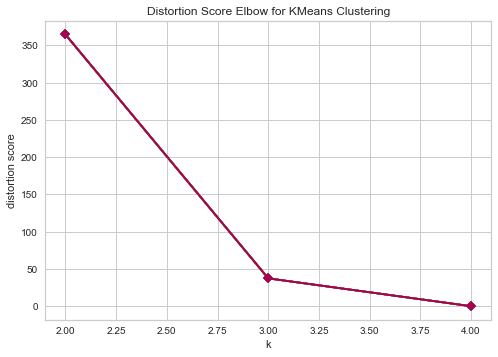

Iniciando Persistencia
Sucesso na inserção
Processando sent: 175


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 176
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 177
Iniciando Persistencia
Sucesso na inserção
Processando sent: 178
Iniciando Persistencia
Sucesso na inserção
Processando sent: 179
Iniciando Persistencia
Sucesso na inserção
Processando sent: 180


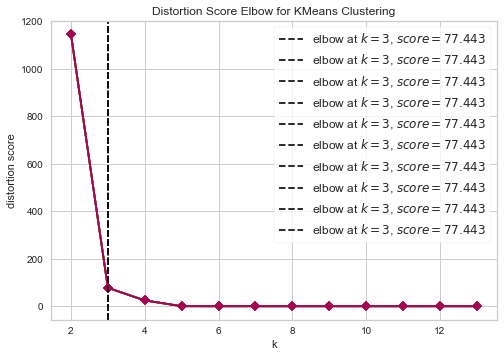

Iniciando Persistencia
Sucesso na inserção
Processando sent: 181
Iniciando Persistencia
Sucesso na inserção
Processando sent: 182
Iniciando Persistencia
Sucesso na inserção
Processando sent: 183
Iniciando Persistencia
Sucesso na inserção
Processando sent: 184
Iniciando Persistencia
Sucesso na inserção
Processando sent: 185
Iniciando Persistencia
Sucesso na inserção
Processando sent: 186
Iniciando Persistencia
Sucesso na inserção
Processando sent: 187
Iniciando Persistencia
Sucesso na inserção
Processando sent: 188
Iniciando Persistencia
Sucesso na inserção
Processando sent: 189


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

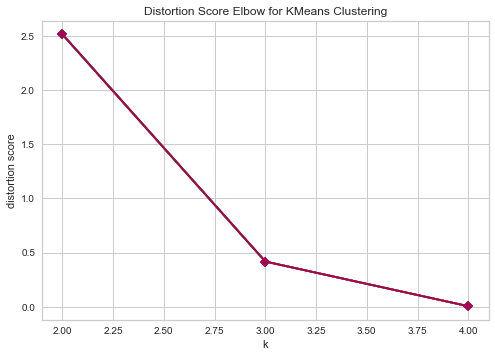

Iniciando Persistencia
Sucesso na inserção
Processando sent: 190
Iniciando Persistencia
Sucesso na inserção
Processando sent: 191


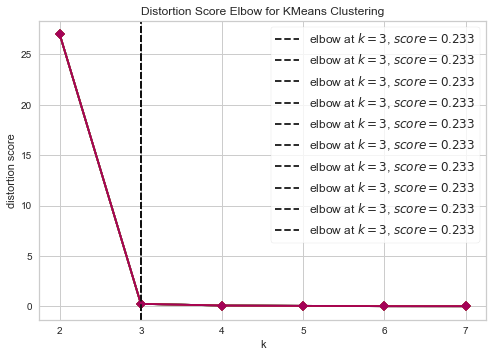

Iniciando Persistencia
Sucesso na inserção
Processando sent: 192
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 193


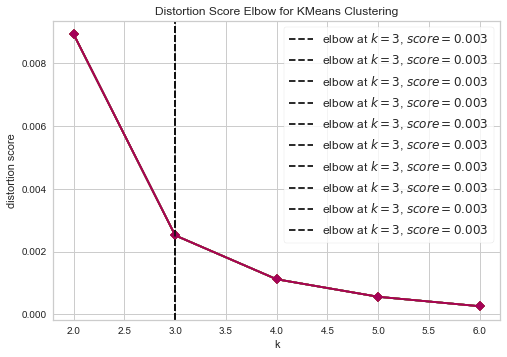

Iniciando Persistencia
Sucesso na inserção
Processando sent: 194
Iniciando Persistencia
Sucesso na inserção
Processando sent: 195


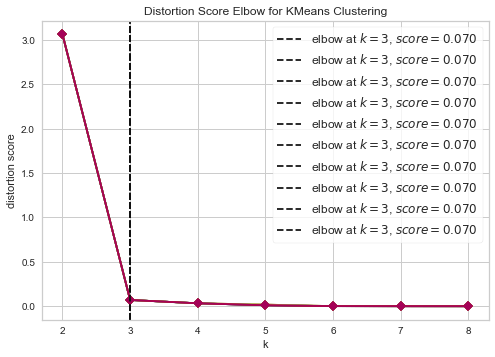

Iniciando Persistencia
Sucesso na inserção
Processando sent: 196


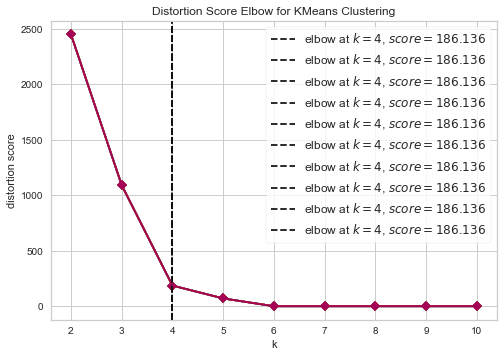

Iniciando Persistencia
Sucesso na inserção
Processando sent: 197
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 198


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 199


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.esti

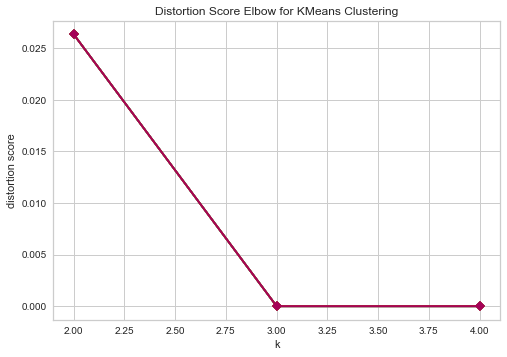

Iniciando Persistencia
Sucesso na inserção
Processando sent: 200


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 201


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

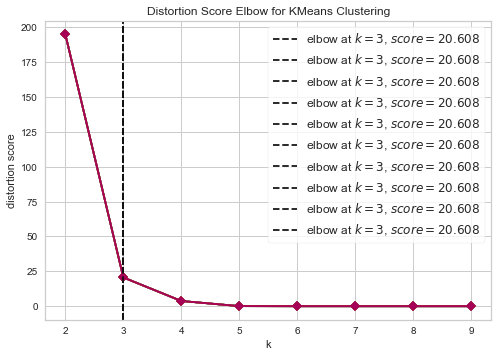

Iniciando Persistencia
Sucesso na inserção
Processando sent: 202
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 203


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

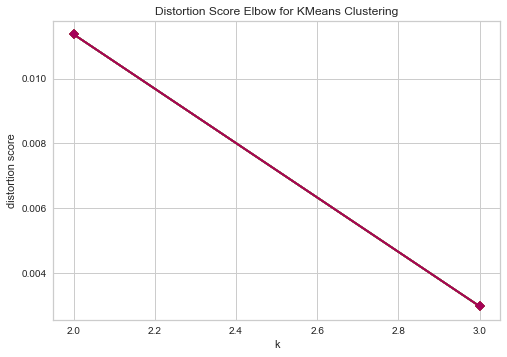

Iniciando Persistencia
Sucesso na inserção
Processando sent: 204


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

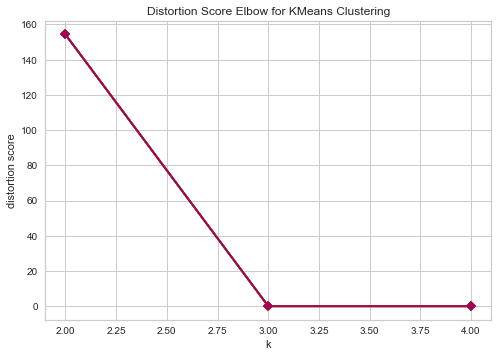

Iniciando Persistencia
Sucesso na inserção
Processando sent: 205
Iniciando Persistencia
Sucesso na inserção
Processando sent: 206
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 207


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

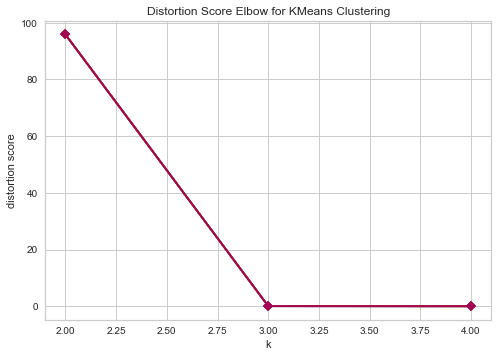

Iniciando Persistencia
Sucesso na inserção
Processando sent: 208
Iniciando Persistencia
Sucesso na inserção
Processando sent: 209


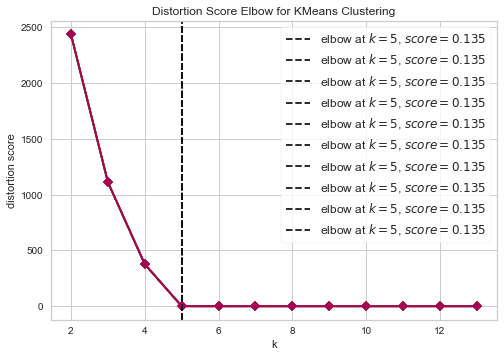

Iniciando Persistencia
Sucesso na inserção
Processando sent: 210
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 211
Iniciando Persistencia
Sucesso na inserção
Processando sent: 212
Iniciando Persistencia
Sucesso na inserção
Processando sent: 213


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (21) found smaller than n_clusters (22). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (21) found smaller than n_clusters (23). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 214


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

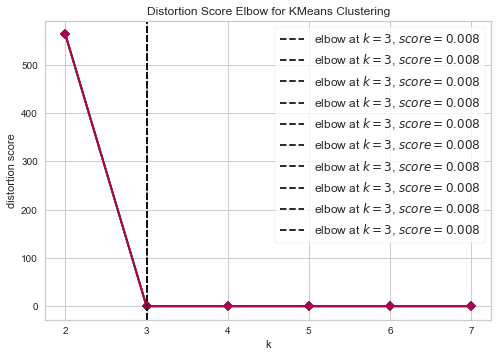

Iniciando Persistencia
Sucesso na inserção
Processando sent: 215
Iniciando Persistencia
Sucesso na inserção
Processando sent: 216


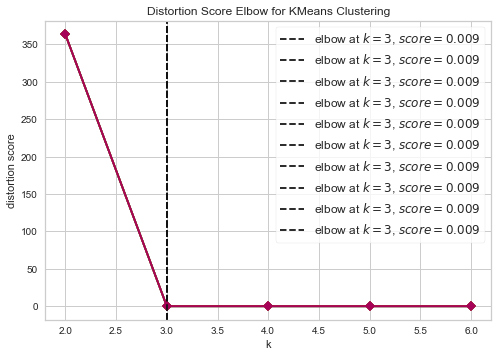

Iniciando Persistencia
Sucesso na inserção
Processando sent: 217


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

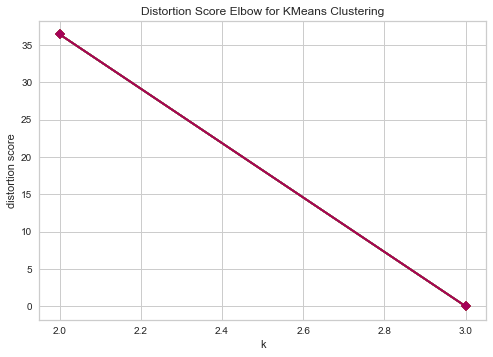

Iniciando Persistencia
Sucesso na inserção
Processando sent: 218


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

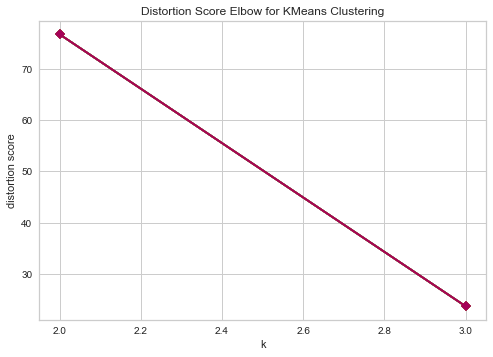

Iniciando Persistencia
Sucesso na inserção
Processando sent: 219
Iniciando Persistencia
Sucesso na inserção
Processando sent: 220
Iniciando Persistencia
Sucesso na inserção
Processando sent: 221
Iniciando Persistencia
Sucesso na inserção
Processando sent: 222
Iniciando Persistencia
Sucesso na inserção
Processando sent: 223
Iniciando Persistencia
Sucesso na inserção
Processando sent: 224
Iniciando Persistencia
Sucesso na inserção
Processando sent: 225
Iniciando Persistencia
Sucesso na inserção
Processando sent: 226


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

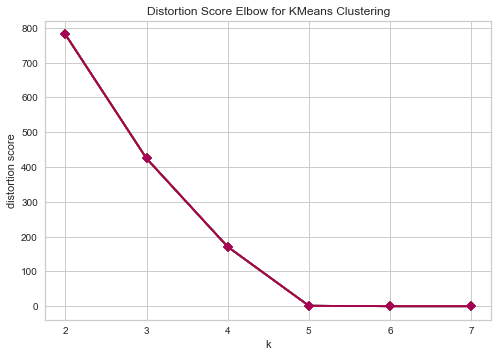

Iniciando Persistencia
Sucesso na inserção
Processando sent: 227


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

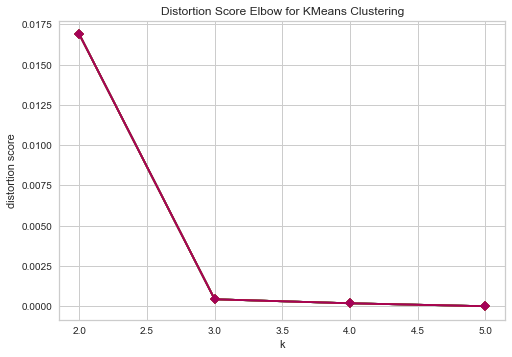

Iniciando Persistencia
Sucesso na inserção
Processando sent: 228
Iniciando Persistencia
Sucesso na inserção
Processando sent: 229
Iniciando Persistencia
Sucesso na inserção
Processando sent: 230


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

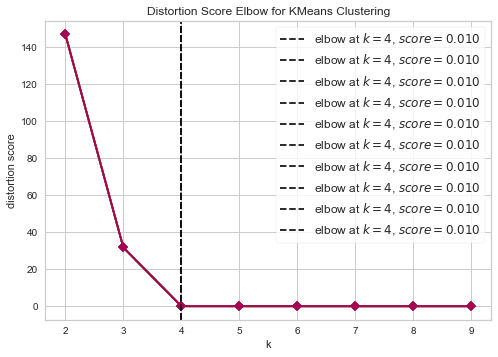

Iniciando Persistencia
Sucesso na inserção
Processando sent: 231
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 232


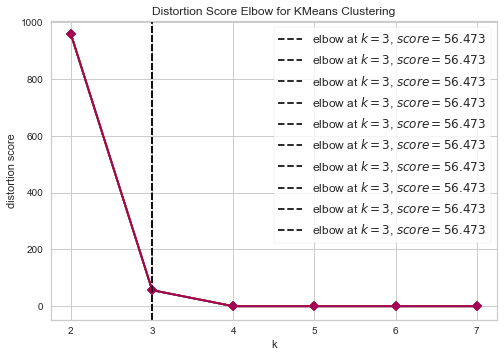

Iniciando Persistencia
Sucesso na inserção
Processando sent: 233
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 234


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

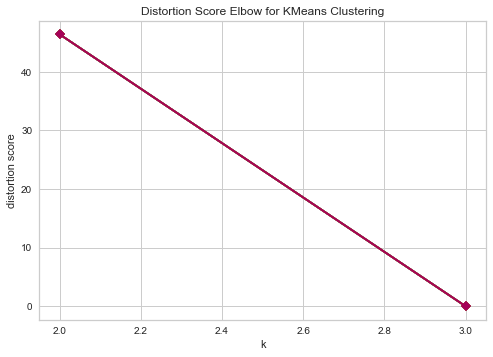

Iniciando Persistencia
Sucesso na inserção
Processando sent: 235
Iniciando Persistencia
Sucesso na inserção
Processando sent: 236


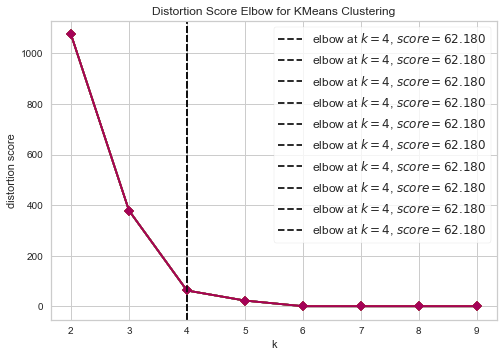

Iniciando Persistencia
Sucesso na inserção
Processando sent: 237


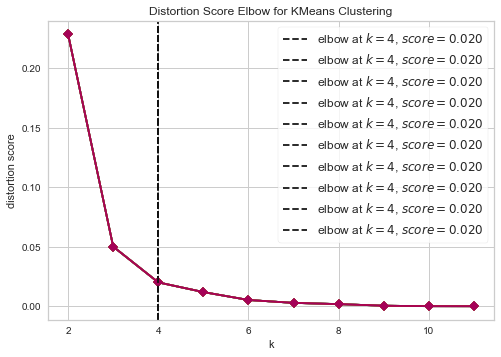

Iniciando Persistencia
Sucesso na inserção
Processando sent: 238
Iniciando Persistencia
Sucesso na inserção
Processando sent: 239


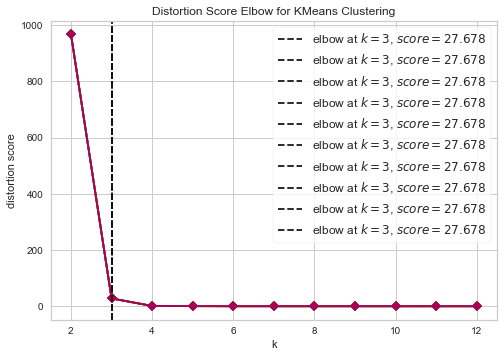

Iniciando Persistencia
Sucesso na inserção
Processando sent: 240


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X

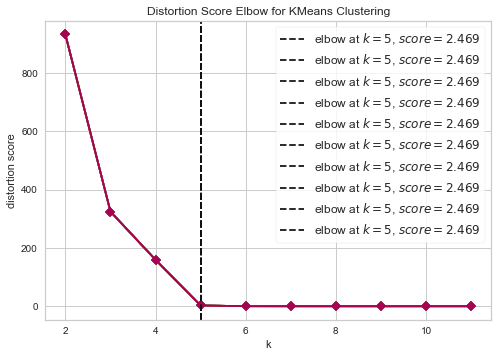

Iniciando Persistencia
Sucesso na inserção
Processando sent: 241


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

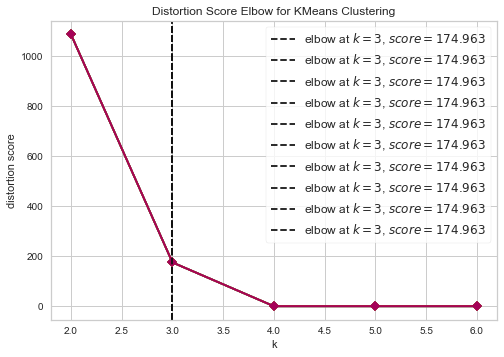

Iniciando Persistencia
Sucesso na inserção
Processando sent: 242
Iniciando Persistencia
Sucesso na inserção
Processando sent: 243
Iniciando Persistencia
Sucesso na inserção
Processando sent: 244
Iniciando Persistencia
Sucesso na inserção
Processando sent: 245
Iniciando Persistencia
Sucesso na inserção
Processando sent: 246


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

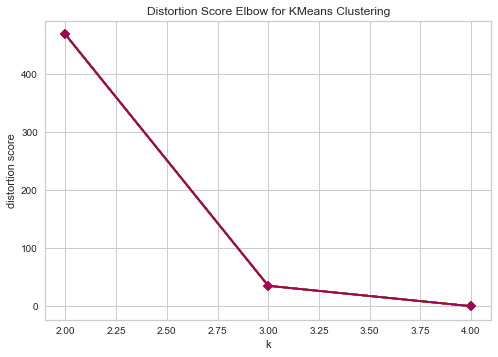

Iniciando Persistencia
Sucesso na inserção
Processando sent: 247


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

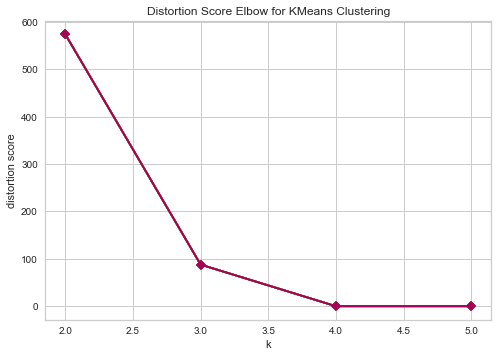

Iniciando Persistencia
Sucesso na inserção
Processando sent: 248
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 249


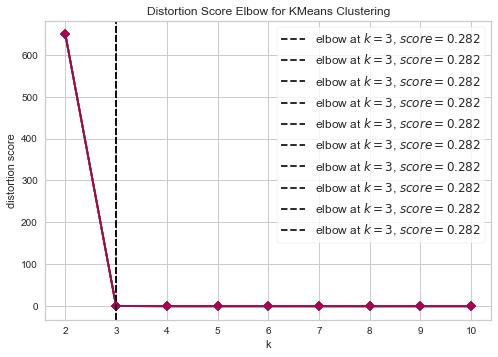

Iniciando Persistencia
Sucesso na inserção
Processando sent: 250


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

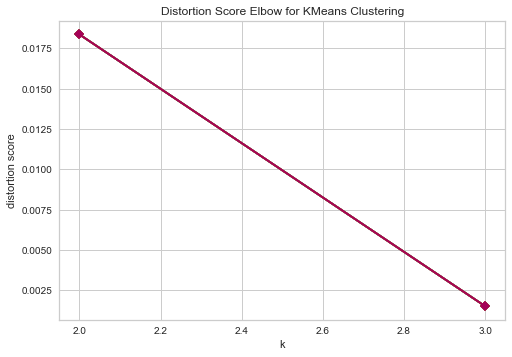

Iniciando Persistencia
Sucesso na inserção
Processando sent: 251
Iniciando Persistencia
Sucesso na inserção
Processando sent: 252
Iniciando Persistencia
Sucesso na inserção
Processando sent: 253
Iniciando Persistencia
Sucesso na inserção
Processando sent: 254
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 255
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 256
Iniciando Persistencia
Sucesso na inserção
Processando sent: 257


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

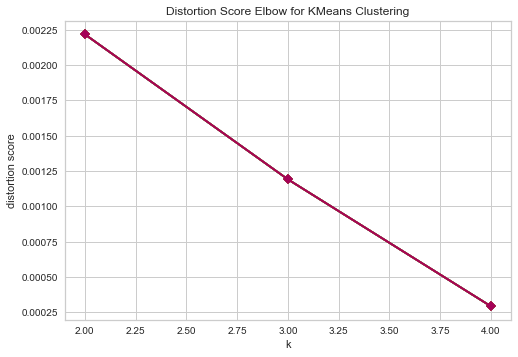

Iniciando Persistencia
Sucesso na inserção
Processando sent: 258
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 259


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **

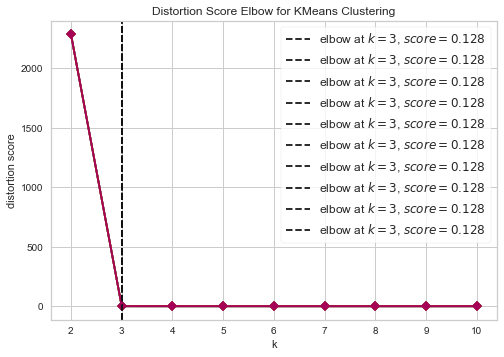

Iniciando Persistencia
Sucesso na inserção
Processando sent: 260
Iniciando Persistencia
Sucesso na inserção
Processando sent: 261
Iniciando Persistencia
Sucesso na inserção
Processando sent: 262


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

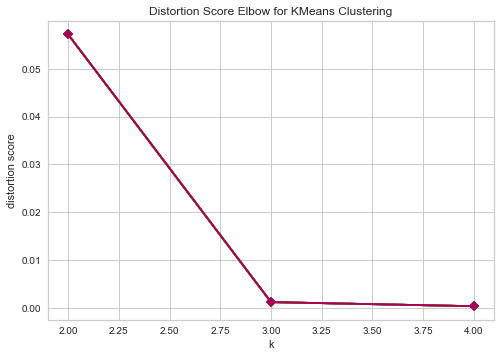

Iniciando Persistencia
Sucesso na inserção
Processando sent: 263
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 264


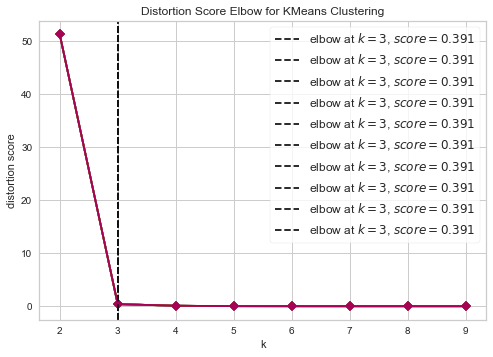

Iniciando Persistencia
Sucesso na inserção
Processando sent: 265
Iniciando Persistencia
Sucesso na inserção
Processando sent: 266
Iniciando Persistencia
Sucesso na inserção
Processando sent: 267
Iniciando Persistencia
Sucesso na inserção
Processando sent: 268
Iniciando Persistencia
Sucesso na inserção
Processando sent: 269
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 270


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

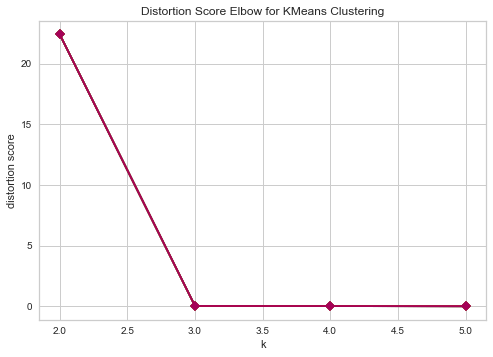

Iniciando Persistencia
Sucesso na inserção
Processando sent: 271
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 272
Iniciando Persistencia
Sucesso na inserção
Processando sent: 273
Iniciando Persistencia
Sucesso na inserção
Processando sent: 274


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

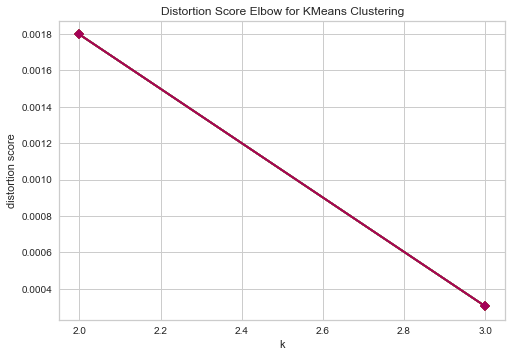

Iniciando Persistencia
Sucesso na inserção
Processando sent: 275
Iniciando Persistencia
Sucesso na inserção
Processando sent: 276
Iniciando Persistencia
Sucesso na inserção
Processando sent: 277


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

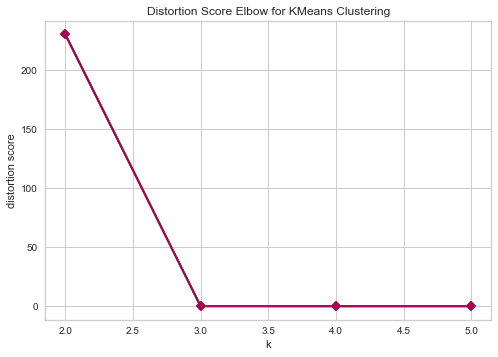

Iniciando Persistencia
Sucesso na inserção
Processando sent: 278
Iniciando Persistencia
Sucesso na inserção
Processando sent: 279
Iniciando Persistencia
Sucesso na inserção
Processando sent: 280
Iniciando Persistencia
Sucesso na inserção
Processando sent: 281
Iniciando Persistencia
Sucesso na inserção
Processando sent: 282


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

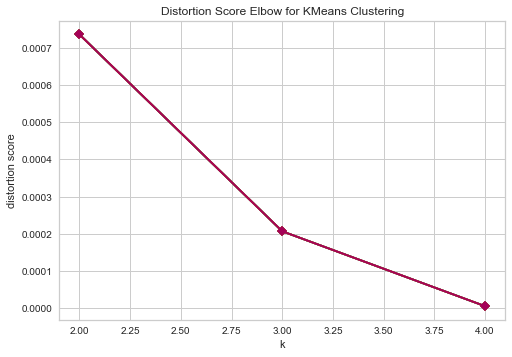

Iniciando Persistencia
Sucesso na inserção
Processando sent: 283
Iniciando Persistencia
Sucesso na inserção
Processando sent: 284
Iniciando Persistencia
Sucesso na inserção
Processando sent: 285
Iniciando Persistencia
Sucesso na inserção
Processando sent: 286
Iniciando Persistencia
Sucesso na inserção
Processando sent: 287
Iniciando Persistencia
Sucesso na inserção
Processando sent: 288


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 289


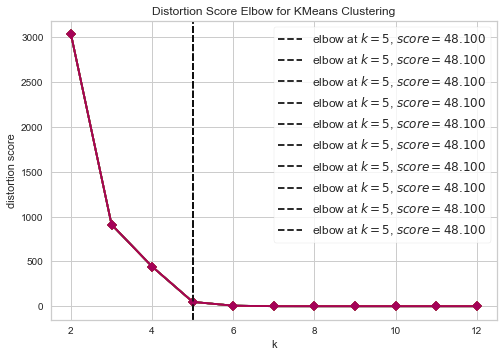

Iniciando Persistencia
Sucesso na inserção
Processando sent: 290


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

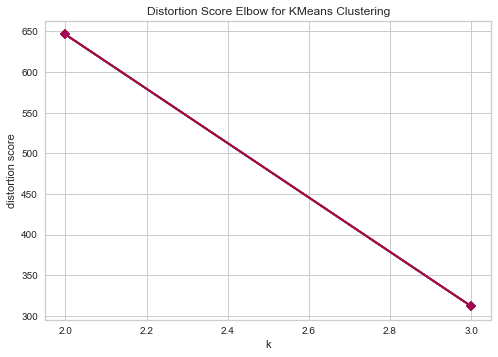

Iniciando Persistencia
Sucesso na inserção
Processando sent: 291
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 292


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

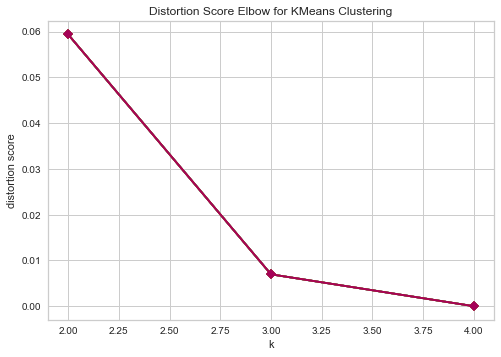

Iniciando Persistencia
Sucesso na inserção
Processando sent: 293


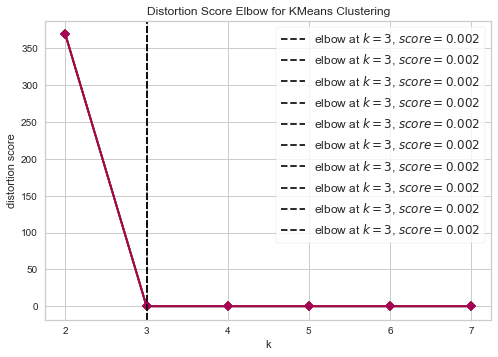

Iniciando Persistencia
Sucesso na inserção
Processando sent: 294


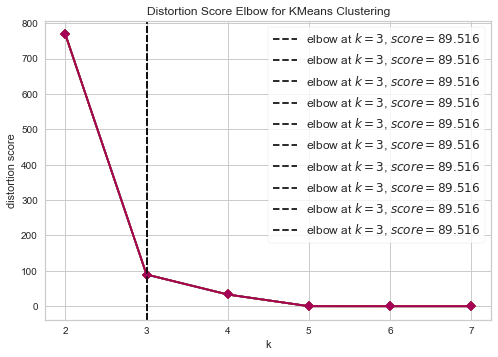

Iniciando Persistencia
Sucesso na inserção
Processando sent: 295
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 296


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

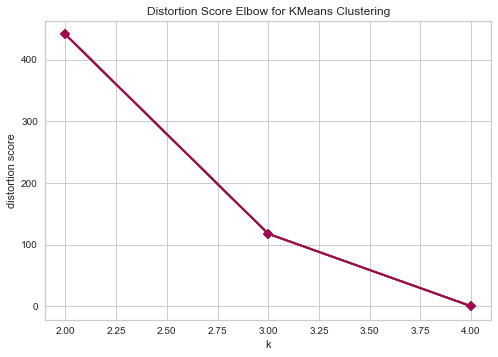

Iniciando Persistencia
Sucesso na inserção
Processando sent: 297
Iniciando Persistencia
Sucesso na inserção
Processando sent: 298


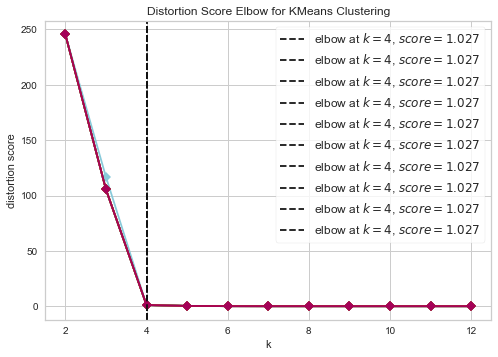

Iniciando Persistencia
Sucesso na inserção
Processando sent: 299
Iniciando Persistencia
Sucesso na inserção
Processando sent: 300
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 301


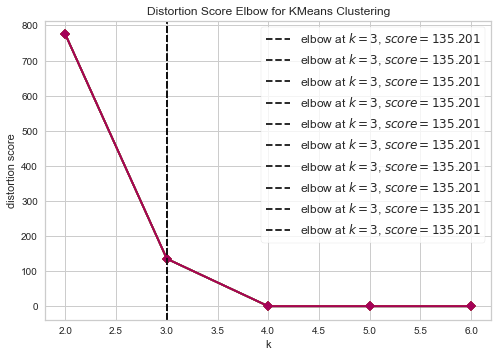

Iniciando Persistencia
Sucesso na inserção
Processando sent: 302


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

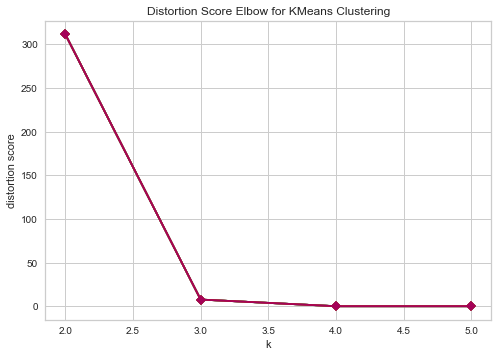

Iniciando Persistencia
Sucesso na inserção
Processando sent: 303
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 304


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 305


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 306
Iniciando Persistencia
Sucesso na inserção
Processando sent: 307


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (53) found smaller than n_clusters (54). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (53) found smaller than n_clusters (55). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 308


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

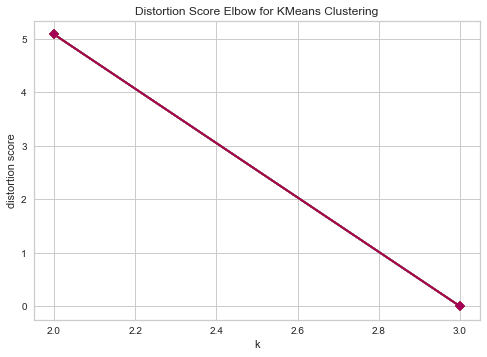

Iniciando Persistencia
Sucesso na inserção
Processando sent: 309


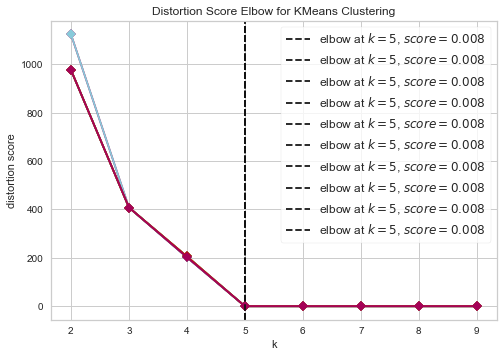

Iniciando Persistencia
Sucesso na inserção
Processando sent: 310


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (45) found smaller than n_clusters (46). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 311
Iniciando Persistencia
Sucesso na inserção
Processando sent: 312
Iniciando Persistencia
Sucesso na inserção
Processando sent: 313


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 314
Iniciando Persistencia
Sucesso na inserção
Processando sent: 315

C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being 

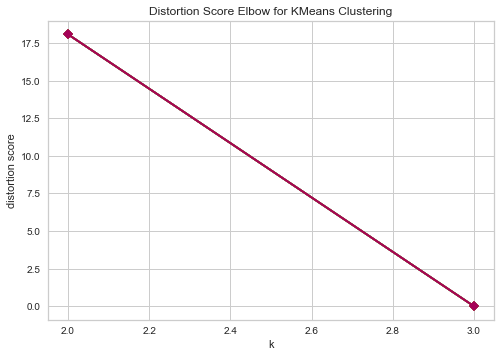

Iniciando Persistencia
Sucesso na inserção
Processando sent: 316


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 317
Iniciando Persistencia
Sucesso na inserção
Processando sent: 318
Iniciando Persistencia
Sucesso na inserção
Processando sent: 319
Iniciando Persistencia
Sucesso na inserção
Processando sent: 320
Iniciando Persistencia
Sucesso na inserção
Processando sent: 321


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (30) found smaller than n_clusters (31). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (30) found smaller than n_clusters (32). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 322
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 323
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 324
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 325


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

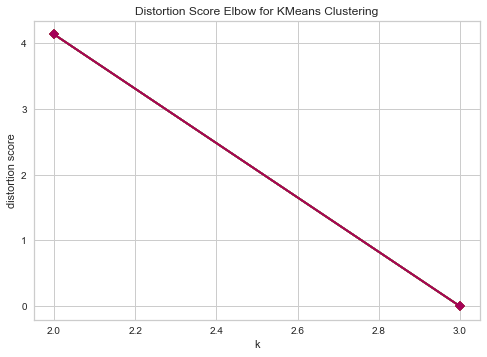

Iniciando Persistencia
Sucesso na inserção
Processando sent: 326
Iniciando Persistencia
Sucesso na inserção
Processando sent: 327


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

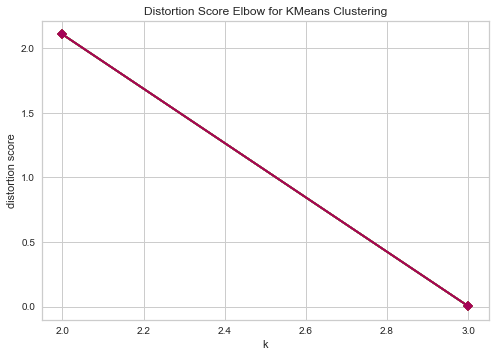

Iniciando Persistencia
Sucesso na inserção
Processando sent: 328
Iniciando Persistencia
Sucesso na inserção
Processando sent: 329
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 330
Iniciando Persistencia
Sucesso na inserção
Processando sent: 331


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **

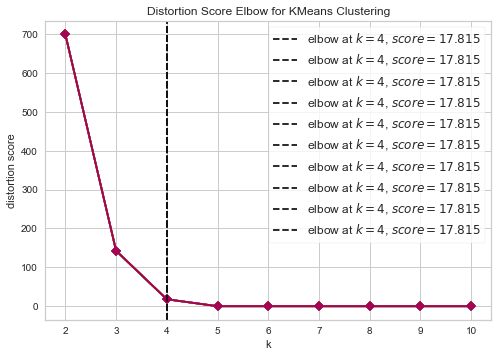

Iniciando Persistencia
Sucesso na inserção
Processando sent: 332


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 333


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.

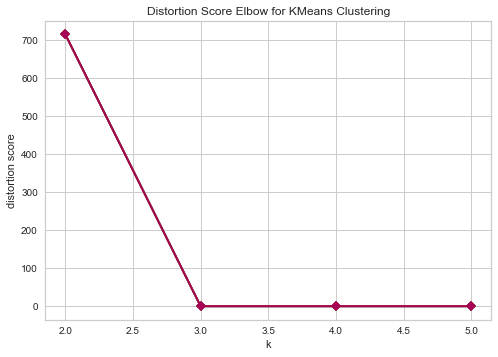

Iniciando Persistencia
Sucesso na inserção
Processando sent: 334
Iniciando Persistencia
Sucesso na inserção
Processando sent: 335
Iniciando Persistencia
Sucesso na inserção
Processando sent: 336
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 337
Iniciando Persistencia
Sucesso na inserção
Processando sent: 338
Iniciando Persistencia
Sucesso na inserção
Processando sent: 339
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 340
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 341


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

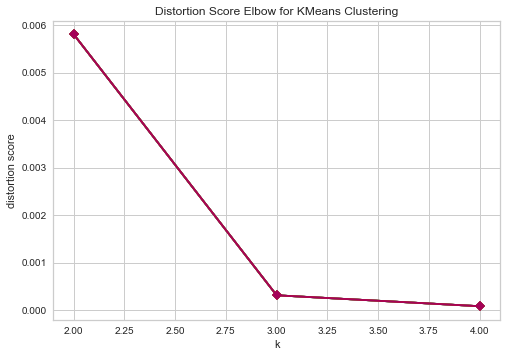

Iniciando Persistencia
Sucesso na inserção
Processando sent: 342
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 343


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (29) found smaller than n_clusters (30). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (29) found smaller than n_clusters (31). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 344
Iniciando Persistencia
Sucesso na inserção
Processando sent: 345
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 346
Iniciando Persistencia
Sucesso na inserção
Processando sent: 347


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

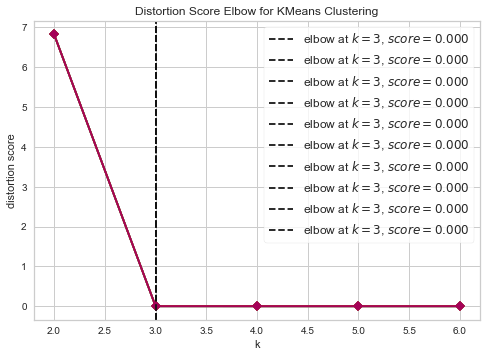

Iniciando Persistencia
Sucesso na inserção
Processando sent: 348
Iniciando Persistencia
Sucesso na inserção
Processando sent: 349
Iniciando Persistencia
Sucesso na inserção
Processando sent: 350


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

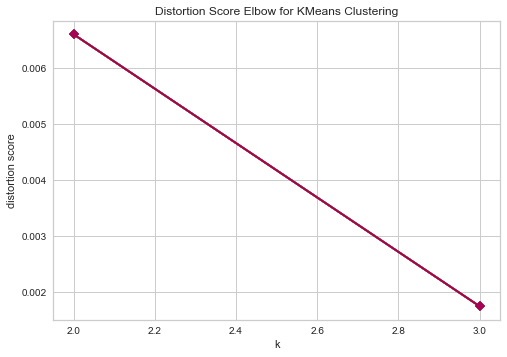

Iniciando Persistencia
Sucesso na inserção
Processando sent: 351


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

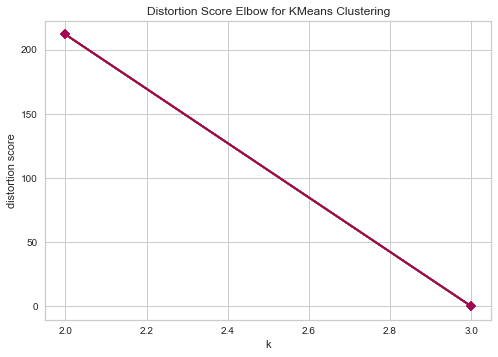

Iniciando Persistencia
Sucesso na inserção
Processando sent: 352
Iniciando Persistencia
Sucesso na inserção
Processando sent: 353
Iniciando Persistencia
Sucesso na inserção
Processando sent: 354
Iniciando Persistencia
Sucesso na inserção
Processando sent: 355
Iniciando Persistencia
Sucesso na inserção
Processando sent: 356


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

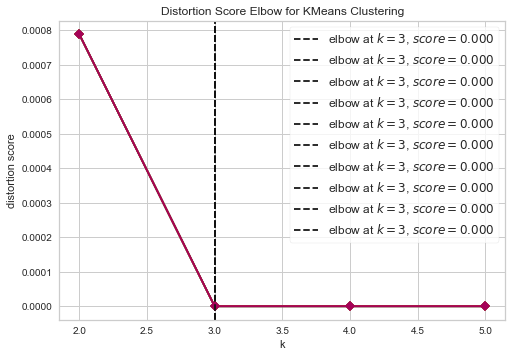

Iniciando Persistencia
Sucesso na inserção
Processando sent: 357
Iniciando Persistencia
Sucesso na inserção
Processando sent: 358
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 359
Iniciando Persistencia
Sucesso na inserção
Processando sent: 360
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 361
Iniciando Persistencia
Sucesso na inserção
Processando sent: 362


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

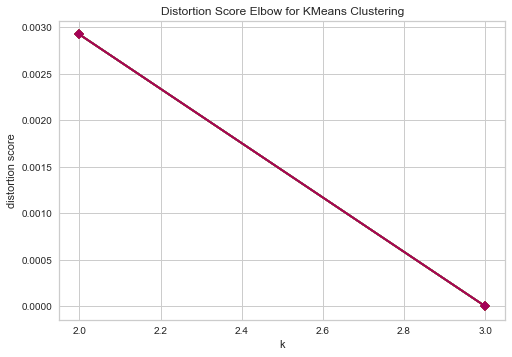

Iniciando Persistencia
Sucesso na inserção
Processando sent: 363


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 364
Iniciando Persistencia
Sucesso na inserção
Processando sent: 365


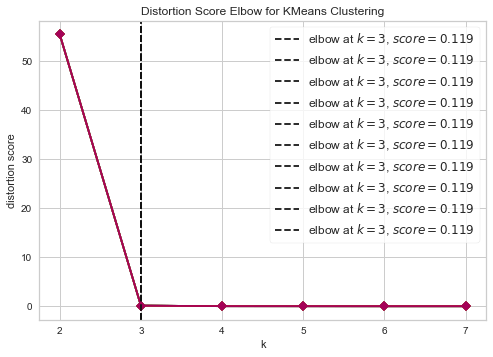

Iniciando Persistencia
Sucesso na inserção
Processando sent: 366
Iniciando Persistencia
Sucesso na inserção
Processando sent: 367


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (23). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (24). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (25). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 368


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

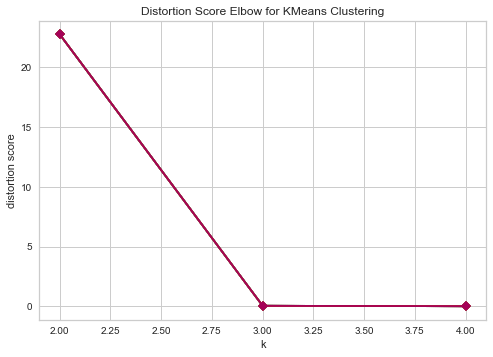

Iniciando Persistencia
Sucesso na inserção
Processando sent: 369


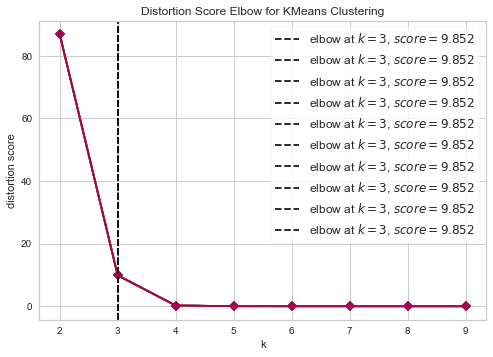

Iniciando Persistencia
Sucesso na inserção
Processando sent: 370
Iniciando Persistencia
Sucesso na inserção
Processando sent: 371


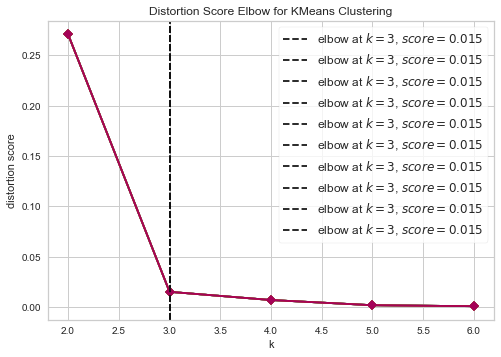

Iniciando Persistencia
Sucesso na inserção
Processando sent: 372


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (46) found smaller than n_clusters (47). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (46) found smaller than n_clusters (48). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 373


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

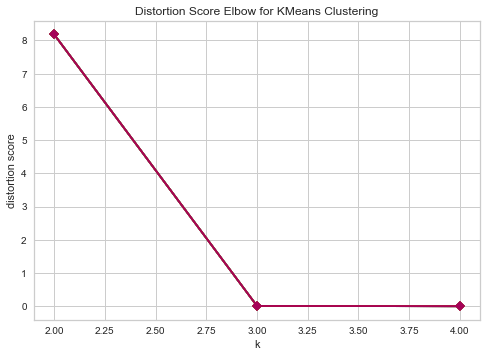

Iniciando Persistencia
Sucesso na inserção
Processando sent: 374


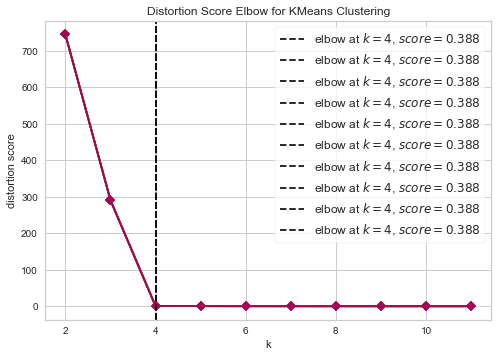

Iniciando Persistencia
Sucesso na inserção
Processando sent: 375
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 376


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

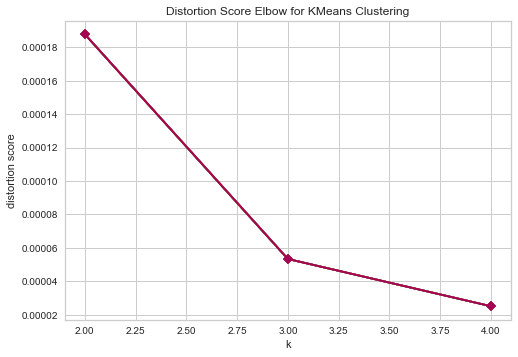

Iniciando Persistencia
Sucesso na inserção
Processando sent: 377
Iniciando Persistencia
Sucesso na inserção
Processando sent: 378


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

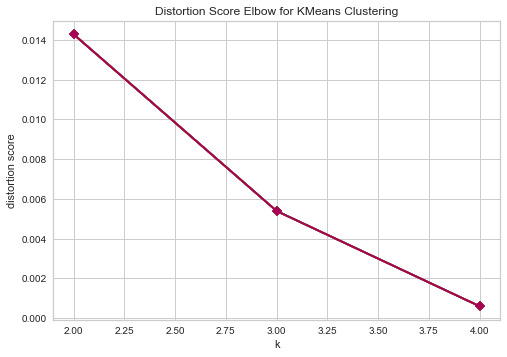

Iniciando Persistencia
Sucesso na inserção
Processando sent: 379
Iniciando Persistencia
Sucesso na inserção
Processando sent: 380
Iniciando Persistencia
Sucesso na inserção
Processando sent: 381
Iniciando Persistencia
Sucesso na inserção
Processando sent: 382


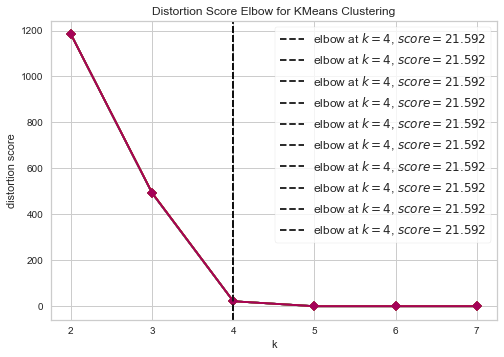

Iniciando Persistencia
Sucesso na inserção
Processando sent: 383


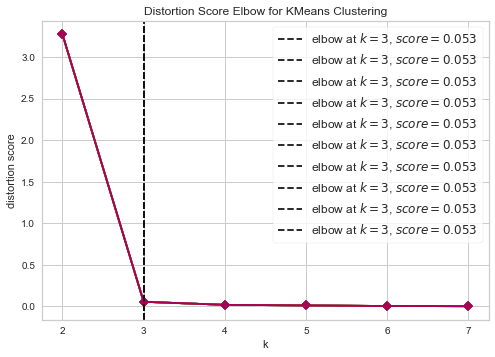

Iniciando Persistencia
Sucesso na inserção
Processando sent: 384
Iniciando Persistencia
Sucesso na inserção
Processando sent: 385
Iniciando Persistencia
Sucesso na inserção
Processando sent: 386
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 387


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

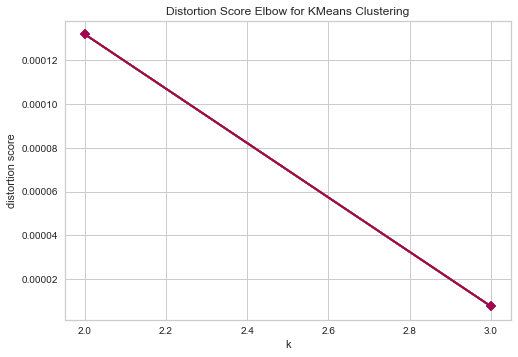

Iniciando Persistencia
Sucesso na inserção
Processando sent: 388


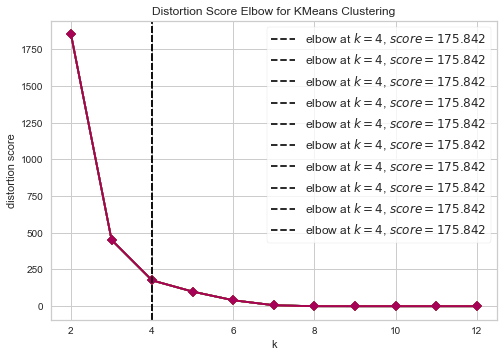

Iniciando Persistencia
Sucesso na inserção
Processando sent: 389
Iniciando Persistencia
Sucesso na inserção
Processando sent: 390
Iniciando Persistencia
Sucesso na inserção
Processando sent: 391


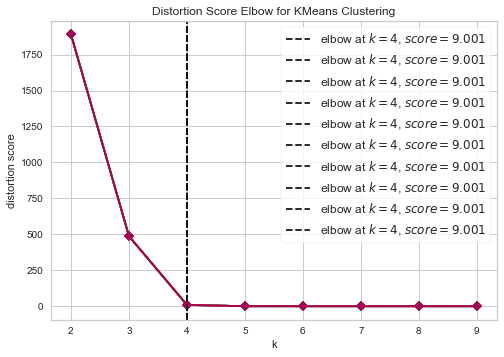

Iniciando Persistencia
Sucesso na inserção
Processando sent: 392
Iniciando Persistencia
Sucesso na inserção
Processando sent: 393
Iniciando Persistencia
Sucesso na inserção
Processando sent: 394
Iniciando Persistencia
Sucesso na inserção
Processando sent: 395
Iniciando Persistencia
Sucesso na inserção
Processando sent: 396
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 397
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 398
Iniciando Persistencia
Sucesso na inserção
Processando sent: 399
Iniciando Persistencia
Sucesso na inserção
Processando sent: 400
Iniciando Persistencia
Sucesso na inserção
Processando sent: 401
Iniciando Persistencia
Sucesso na inserção
Processando sent: 402
Iniciando Persistencia
Sucesso na inserção
Processando sent: 403


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

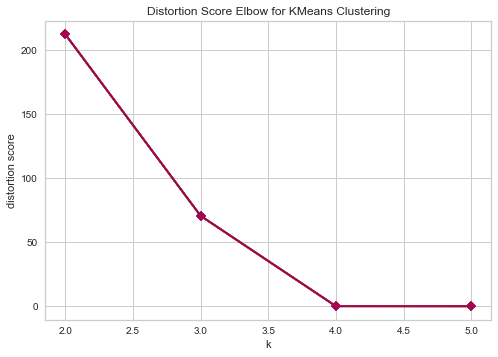

Iniciando Persistencia
Sucesso na inserção
Processando sent: 404
Iniciando Persistencia
Sucesso na inserção
Processando sent: 405
Iniciando Persistencia
Sucesso na inserção
Processando sent: 406
Iniciando Persistencia
Sucesso na inserção
Processando sent: 407


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

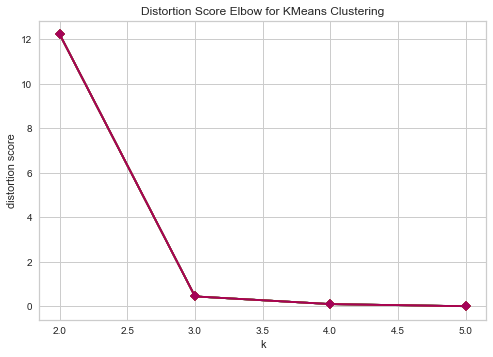

Iniciando Persistencia
Sucesso na inserção
Processando sent: 408
Iniciando Persistencia
Sucesso na inserção
Processando sent: 409
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 410


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (29) found smaller than n_clusters (30). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (29) found smaller than n_clusters (31). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (29) found smaller than n_clusters (32). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 411


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

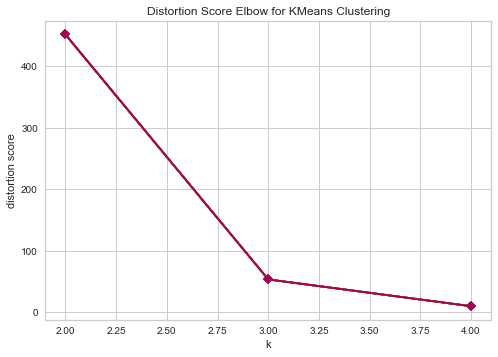

Iniciando Persistencia
Sucesso na inserção
Processando sent: 412


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

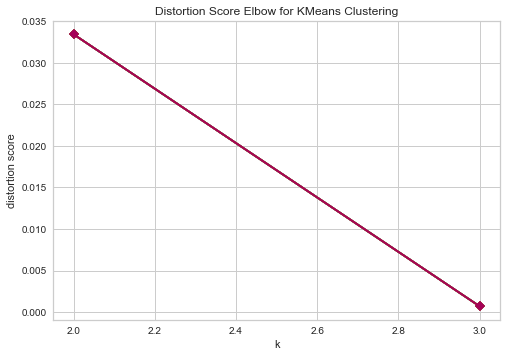

Iniciando Persistencia
Sucesso na inserção
Processando sent: 413
Iniciando Persistencia
Sucesso na inserção
Processando sent: 414


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

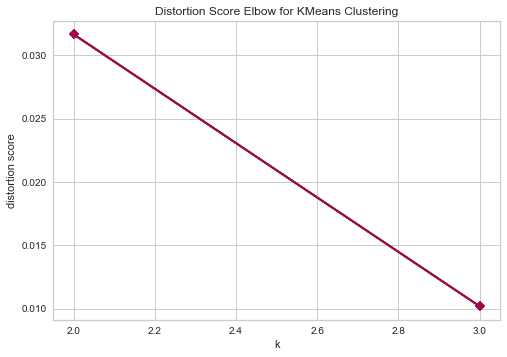

Iniciando Persistencia
Sucesso na inserção
Processando sent: 415


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

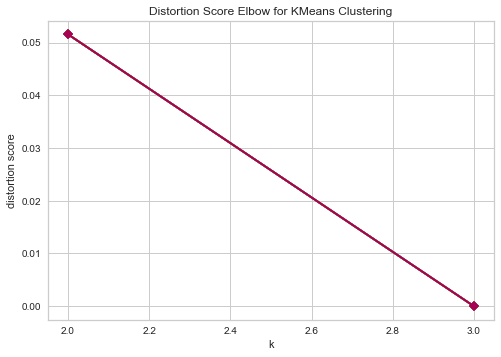

Iniciando Persistencia
Sucesso na inserção
Processando sent: 416
Iniciando Persistencia
Sucesso na inserção
Processando sent: 417
Iniciando Persistencia
Sucesso na inserção
Processando sent: 418
Iniciando Persistencia
Sucesso na inserção
Processando sent: 419
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 420
Iniciando Persistencia
Sucesso na inserção
Processando sent: 421
Iniciando Persistencia
Sucesso na inserção
Processando sent: 422


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

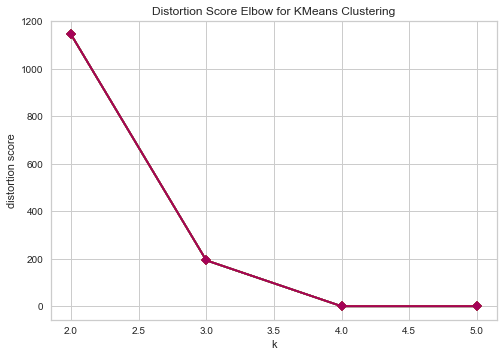

Iniciando Persistencia
Sucesso na inserção
Processando sent: 423
Iniciando Persistencia
Sucesso na inserção
Processando sent: 424
Iniciando Persistencia
Sucesso na inserção
Processando sent: 425
Iniciando Persistencia
Sucesso na inserção
Processando sent: 426
Iniciando Persistencia
Sucesso na inserção
Processando sent: 427
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 428
Iniciando Persistencia
Sucesso na inserção
Processando sent: 429
Iniciando Persistencia
Sucesso na inserção
Processando sent: 430


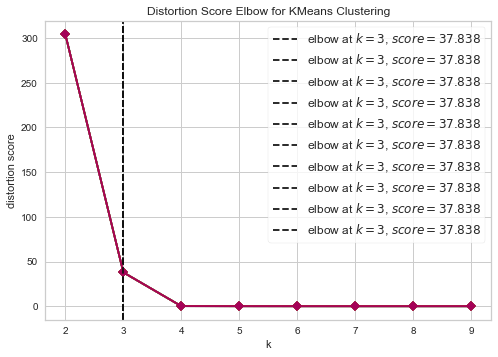

Iniciando Persistencia
Sucesso na inserção
Processando sent: 431
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 432
Iniciando Persistencia
Sucesso na inserção
Processando sent: 433
Iniciando Persistencia
Sucesso na inserção
Processando sent: 434


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

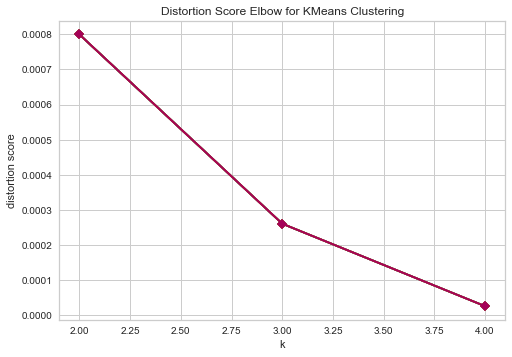

Iniciando Persistencia
Sucesso na inserção
Processando sent: 435
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 436


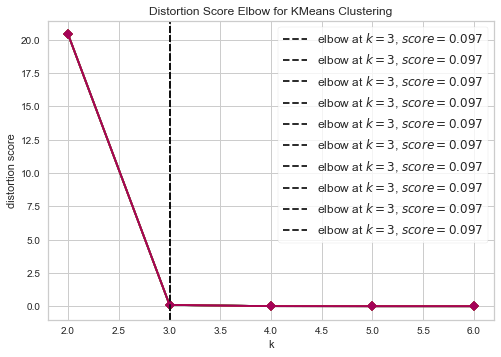

Iniciando Persistencia
Sucesso na inserção
Processando sent: 437
Iniciando Persistencia
Sucesso na inserção
Processando sent: 438
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 439


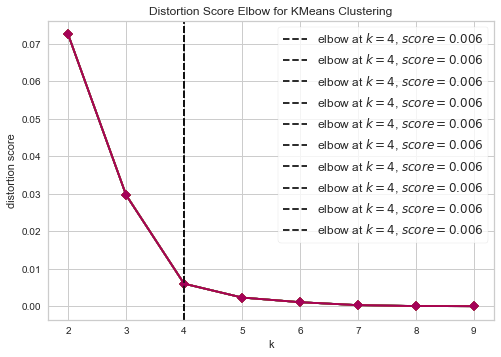

Iniciando Persistencia
Sucesso na inserção
Processando sent: 440
Iniciando Persistencia
Sucesso na inserção
Processando sent: 441
Iniciando Persistencia
Sucesso na inserção
Processando sent: 442
Iniciando Persistencia
Sucesso na inserção
Processando sent: 443
Iniciando Persistencia
Sucesso na inserção
Processando sent: 444
Iniciando Persistencia
Sucesso na inserção
Processando sent: 445


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

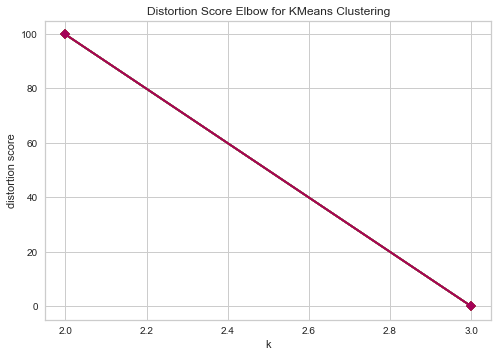

Iniciando Persistencia
Sucesso na inserção
Processando sent: 446


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 447


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.

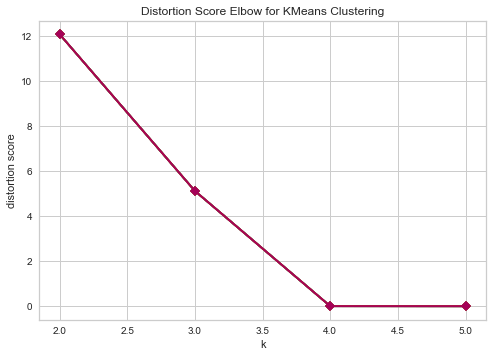

Iniciando Persistencia
Sucesso na inserção
Processando sent: 448
Iniciando Persistencia
Sucesso na inserção
Processando sent: 449
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 450


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

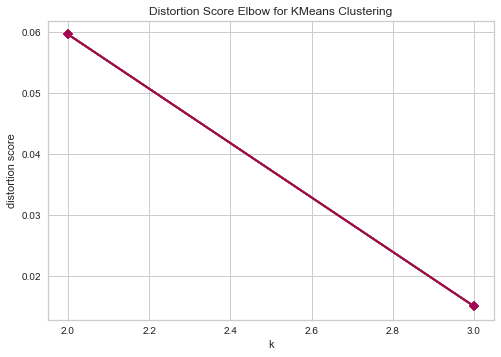

Iniciando Persistencia
Sucesso na inserção
Processando sent: 451
Iniciando Persistencia
Sucesso na inserção
Processando sent: 452
Iniciando Persistencia
Sucesso na inserção
Processando sent: 453
Iniciando Persistencia
Sucesso na inserção
Processando sent: 454


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

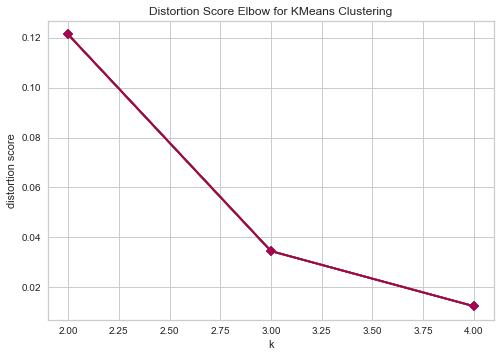

Iniciando Persistencia
Sucesso na inserção
Processando sent: 455


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (23). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (24). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 456
Iniciando Persistencia
Sucesso na inserção
Processando sent: 457


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

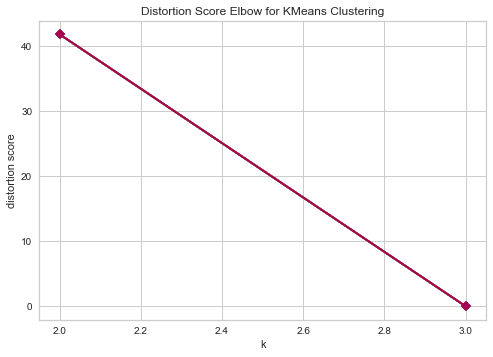

Iniciando Persistencia
Sucesso na inserção
Processando sent: 458
Iniciando Persistencia
Sucesso na inserção
Processando sent: 459
Iniciando Persistencia
Sucesso na inserção
Processando sent: 460
Iniciando Persistencia
Sucesso na inserção
Processando sent: 461
Iniciando Persistencia
Sucesso na inserção
Processando sent: 462


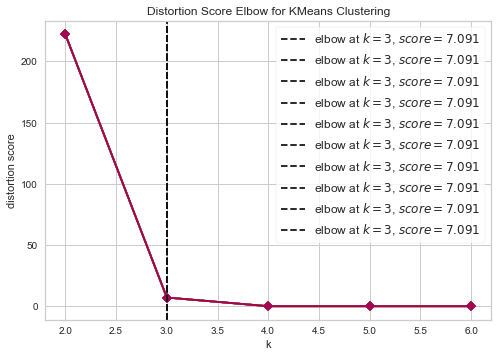

Iniciando Persistencia
Sucesso na inserção
Processando sent: 463
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 464
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 465
Iniciando Persistencia
Sucesso na inserção
Processando sent: 466


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

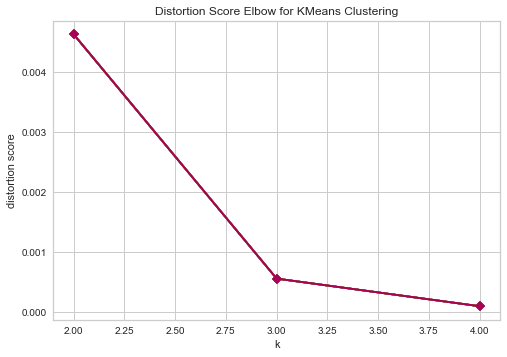

Iniciando Persistencia
Sucesso na inserção
Processando sent: 467
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 468


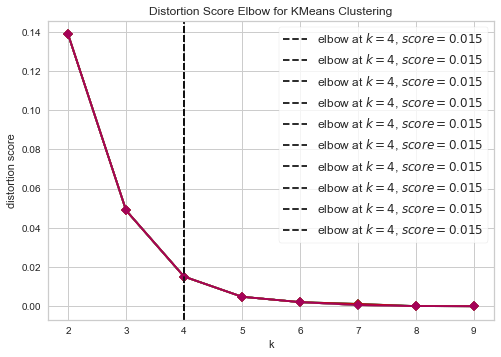

Iniciando Persistencia
Sucesso na inserção
Processando sent: 469
Iniciando Persistencia
Sucesso na inserção
Processando sent: 470
Iniciando Persistencia
Sucesso na inserção
Processando sent: 471
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 472
Iniciando Persistencia
Sucesso na inserção
Processando sent: 473


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (83) found smaller than n_clusters (84). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (83) found smaller than n_clusters (85). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 474


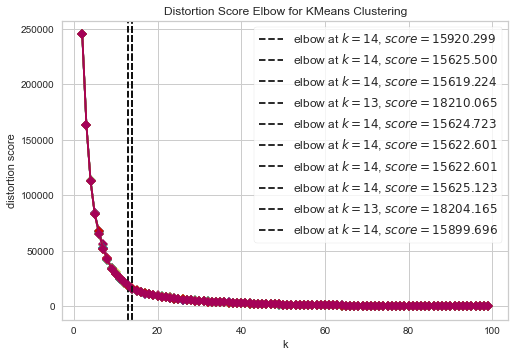

Iniciando Persistencia
Sucesso na inserção
Processando sent: 475


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

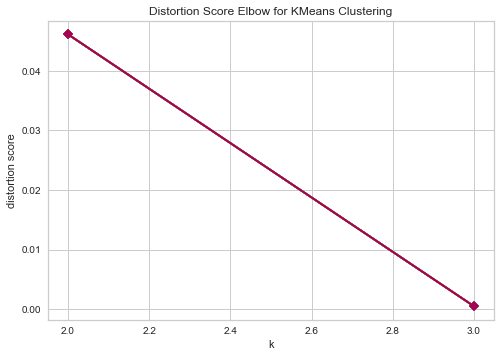

Iniciando Persistencia
Sucesso na inserção
Processando sent: 476
Iniciando Persistencia
Sucesso na inserção
Processando sent: 477
Iniciando Persistencia
Sucesso na inserção
Processando sent: 478
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 479
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 480
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 481


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

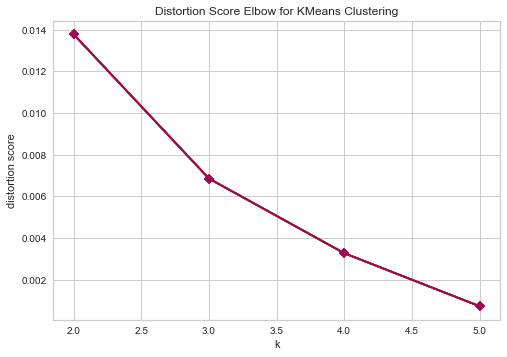

Iniciando Persistencia
Sucesso na inserção
Processando sent: 482
Iniciando Persistencia
Sucesso na inserção
Processando sent: 483
Iniciando Persistencia
Sucesso na inserção
Processando sent: 484
Iniciando Persistencia
Sucesso na inserção
Processando sent: 485


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

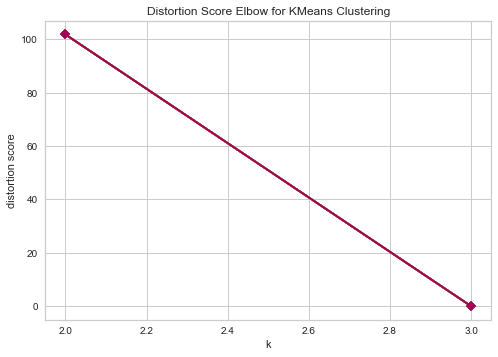

Iniciando Persistencia
Sucesso na inserção
Processando sent: 486
Iniciando Persistencia
Sucesso na inserção
Processando sent: 487
Iniciando Persistencia
Sucesso na inserção
Processando sent: 488


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

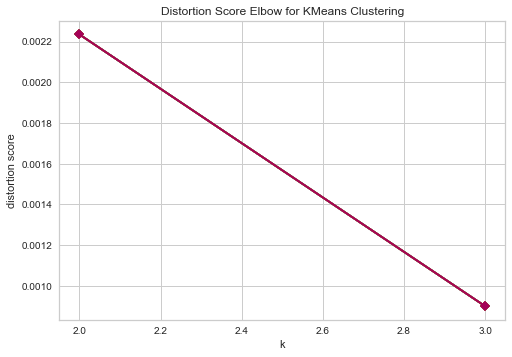

Iniciando Persistencia
Sucesso na inserção
Processando sent: 489


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 490
Iniciando Persistencia
Sucesso na inserção
Processando sent: 491


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

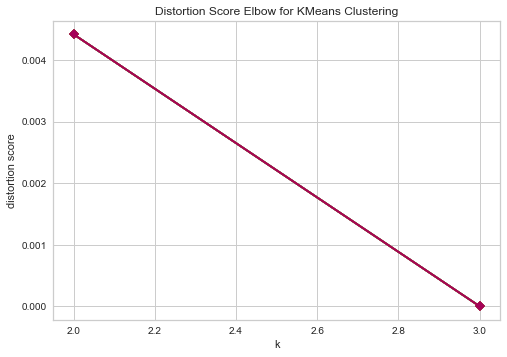

Iniciando Persistencia
Sucesso na inserção
Processando sent: 492
Iniciando Persistencia
Sucesso na inserção
Processando sent: 493
Iniciando Persistencia
Sucesso na inserção
Processando sent: 494


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

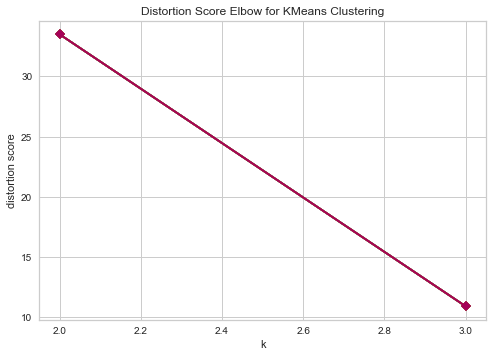

Iniciando Persistencia
Sucesso na inserção
Processando sent: 495
Iniciando Persistencia
Sucesso na inserção
Processando sent: 496
Iniciando Persistencia
Sucesso na inserção
Processando sent: 497
Iniciando Persistencia
Sucesso na inserção
Processando sent: 498


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

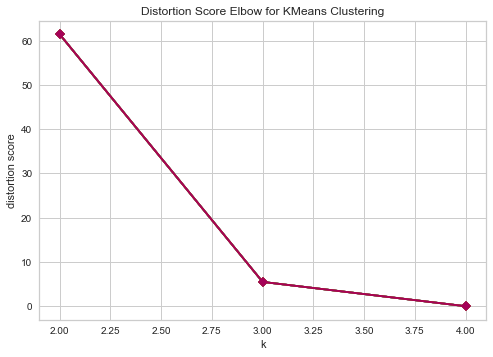

Iniciando Persistencia
Sucesso na inserção
Processando sent: 499


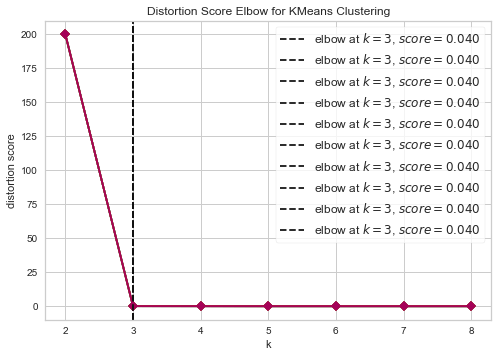

Iniciando Persistencia
Sucesso na inserção
Processando sent: 500
Iniciando Persistencia
Sucesso na inserção
Processando sent: 501
Iniciando Persistencia
Sucesso na inserção
Processando sent: 502
Iniciando Persistencia
Sucesso na inserção
Processando sent: 503
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 504
Iniciando Persistencia
Sucesso na inserção
Processando sent: 505
Iniciando Persistencia
Sucesso na inserção
Processando sent: 506


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

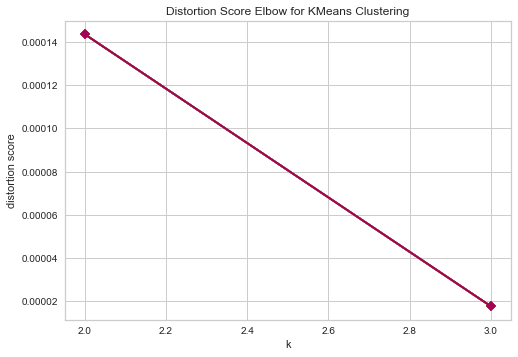

Iniciando Persistencia
Sucesso na inserção
Processando sent: 507


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

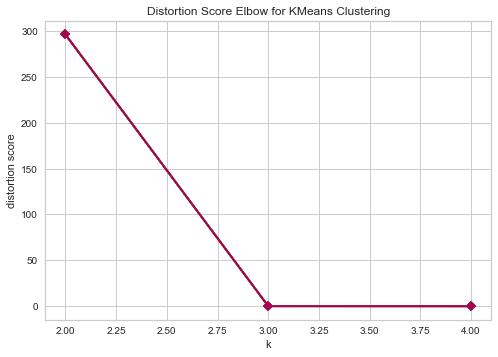

Iniciando Persistencia
Sucesso na inserção
Processando sent: 508
Iniciando Persistencia
Sucesso na inserção
Processando sent: 509
Iniciando Persistencia
Sucesso na inserção
Processando sent: 510


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

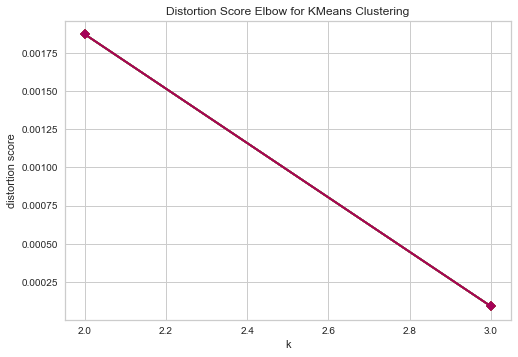

Iniciando Persistencia
Sucesso na inserção
Processando sent: 511
Iniciando Persistencia
Sucesso na inserção
Processando sent: 512
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 513
Iniciando Persistencia
Sucesso na inserção
Processando sent: 514


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

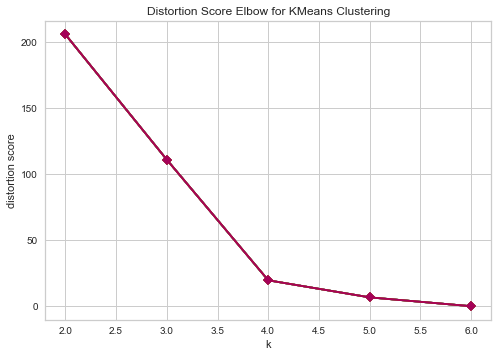

Iniciando Persistencia
Sucesso na inserção
Processando sent: 515
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 516
Iniciando Persistencia
Sucesso na inserção
Processando sent: 517
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 518


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwa

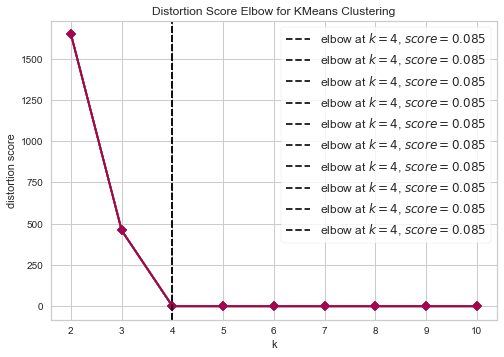

Iniciando Persistencia
Sucesso na inserção
Processando sent: 519


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

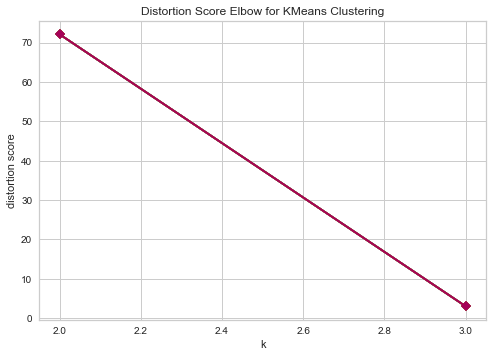

Iniciando Persistencia
Sucesso na inserção
Processando sent: 520
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 521
Iniciando Persistencia
Sucesso na inserção
Processando sent: 522
Iniciando Persistencia
Sucesso na inserção
Processando sent: 523
Iniciando Persistencia
Sucesso na inserção
Processando sent: 524
Iniciando Persistencia
Sucesso na inserção
Processando sent: 525
Iniciando Persistencia
Sucesso na inserção
Processando sent: 526
Iniciando Persistencia
Sucesso na inserção
Processando sent: 527


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

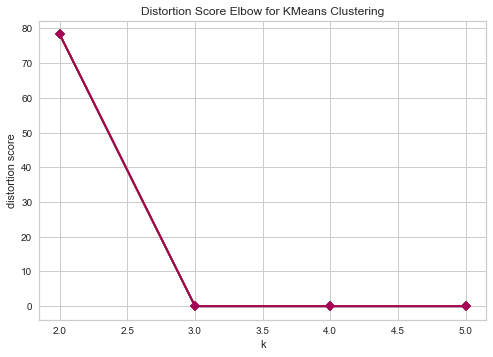

Iniciando Persistencia
Sucesso na inserção
Processando sent: 528
Iniciando Persistencia
Sucesso na inserção
Processando sent: 529
Iniciando Persistencia
Sucesso na inserção
Processando sent: 530
Iniciando Persistencia
Sucesso na inserção
Processando sent: 531


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

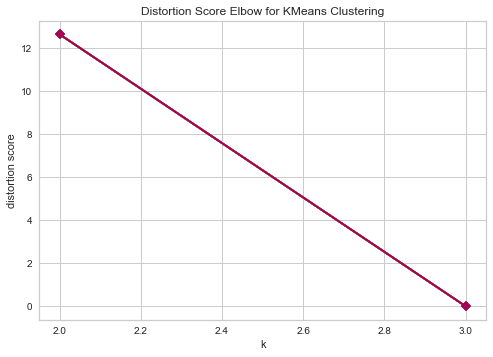

Iniciando Persistencia
Sucesso na inserção
Processando sent: 532
Iniciando Persistencia
Sucesso na inserção
Processando sent: 533
Iniciando Persistencia
Sucesso na inserção
Processando sent: 534
Iniciando Persistencia
Sucesso na inserção
Processando sent: 535


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

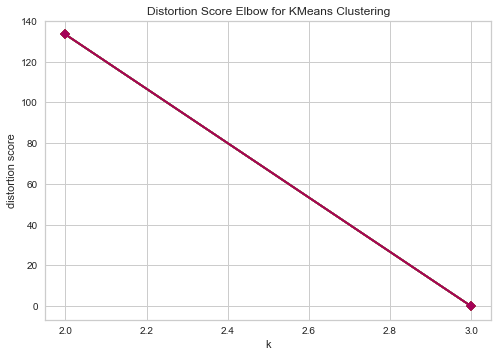

Iniciando Persistencia
Sucesso na inserção
Processando sent: 536
Iniciando Persistencia
Sucesso na inserção
Processando sent: 537
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 538
Iniciando Persistencia
Sucesso na inserção
Processando sent: 539
Iniciando Persistencia
Sucesso na inserção
Processando sent: 540
Iniciando Persistencia
Sucesso na inserção
Processando sent: 541
Iniciando Persistencia
Sucesso na inserção
Processando sent: 542


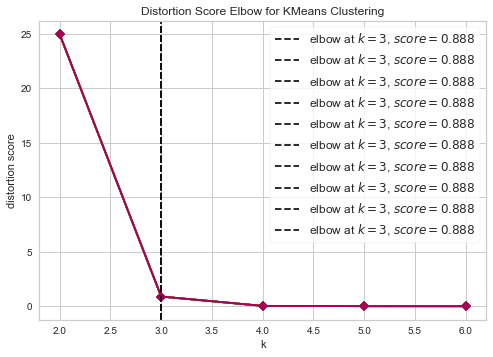

Iniciando Persistencia
Sucesso na inserção
Processando sent: 543
Iniciando Persistencia
Sucesso na inserção
Processando sent: 544
Iniciando Persistencia
Sucesso na inserção
Processando sent: 545
Iniciando Persistencia
Sucesso na inserção
Processando sent: 546
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 547


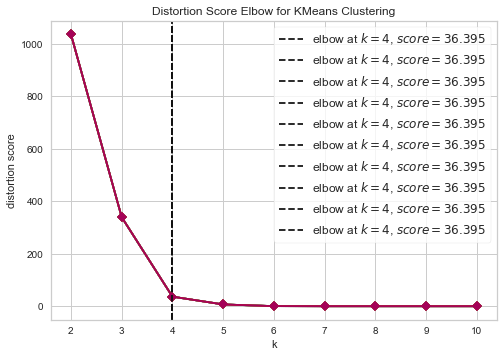

Iniciando Persistencia
Sucesso na inserção
Processando sent: 548


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

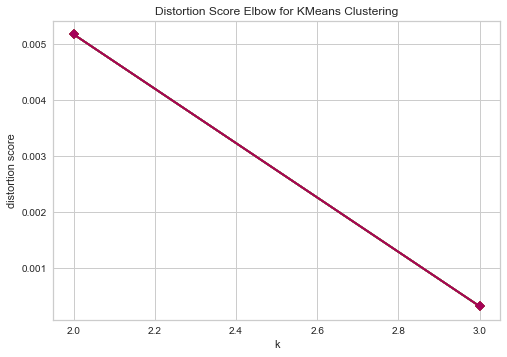

Iniciando Persistencia
Sucesso na inserção
Processando sent: 549
Iniciando Persistencia
Sucesso na inserção
Processando sent: 550
Iniciando Persistencia
Sucesso na inserção
Processando sent: 551
Iniciando Persistencia
Sucesso na inserção
Processando sent: 552
Iniciando Persistencia
Sucesso na inserção
Processando sent: 553
Iniciando Persistencia
Sucesso na inserção
Processando sent: 554
Iniciando Persistencia
Sucesso na inserção
Processando sent: 555
Iniciando Persistencia
Sucesso na inserção
Processando sent: 556


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

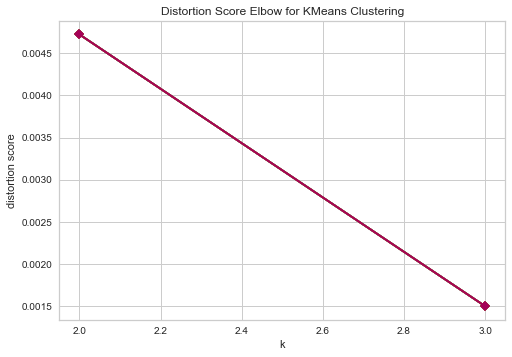

Iniciando Persistencia
Sucesso na inserção
Processando sent: 557
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 558
Iniciando Persistencia
Sucesso na inserção
Processando sent: 559
Iniciando Persistencia
Sucesso na inserção
Processando sent: 560
Iniciando Persistencia
Sucesso na inserção
Processando sent: 561
Iniciando Persistencia
Sucesso na inserção
Processando sent: 562
Iniciando Persistencia
Sucesso na inserção
Processando sent: 563
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 564
Iniciando Persistencia
Sucesso na inserção
Processando sent: 565
Iniciando Persistencia
Sucesso na inserção
Processando sent: 566
Iniciando Persistencia
Sucesso na inserção
Processando sent: 567
Iniciando Persistencia
Sucesso na inserção
Processando sent: 568
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 569


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 570
Iniciando Persistencia
Sucesso na inserção
Processando sent: 571


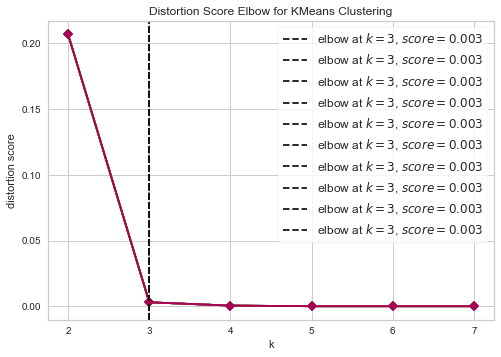

Iniciando Persistencia
Sucesso na inserção
Processando sent: 572
Iniciando Persistencia
Sucesso na inserção
Processando sent: 573


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

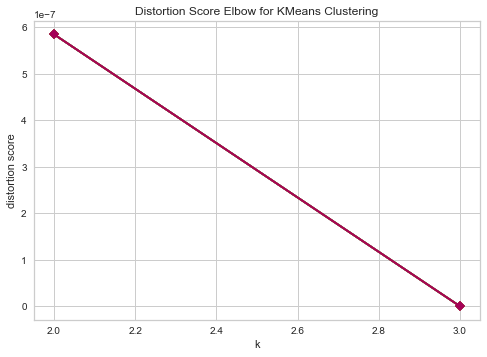

Iniciando Persistencia
Sucesso na inserção
Processando sent: 574
Iniciando Persistencia
Sucesso na inserção
Processando sent: 575
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 576


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 577


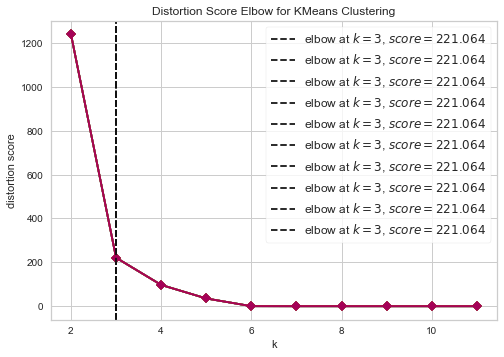

Iniciando Persistencia
Sucesso na inserção
Processando sent: 578


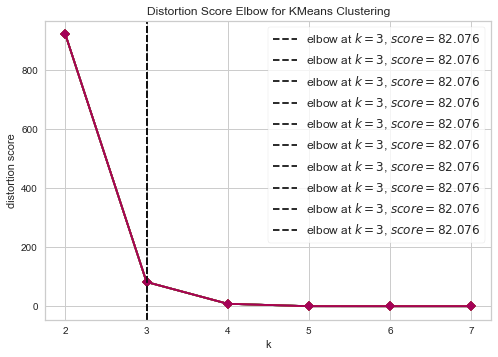

Iniciando Persistencia
Sucesso na inserção
Processando sent: 579
Iniciando Persistencia
Sucesso na inserção
Processando sent: 580
Iniciando Persistencia
Sucesso na inserção
Processando sent: 581
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 582


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 583


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 584


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being 

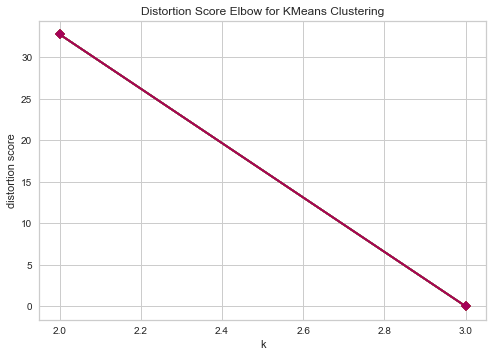

Iniciando Persistencia
Sucesso na inserção
Processando sent: 585


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

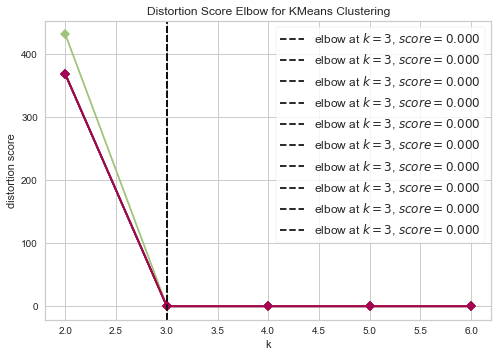

Iniciando Persistencia
Sucesso na inserção
Processando sent: 586


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X

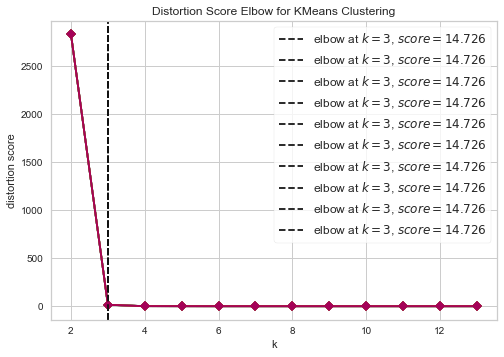

Iniciando Persistencia
Sucesso na inserção
Processando sent: 587


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

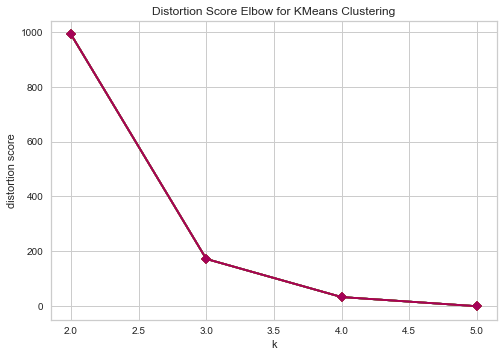

Iniciando Persistencia
Sucesso na inserção
Processando sent: 588


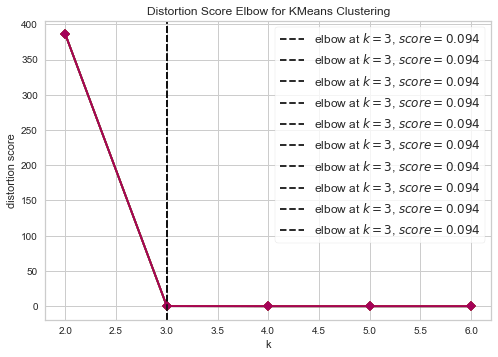

Iniciando Persistencia
Sucesso na inserção
Processando sent: 589


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **k

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 590
Iniciando Persistencia
Sucesso na inserção
Processando sent: 591


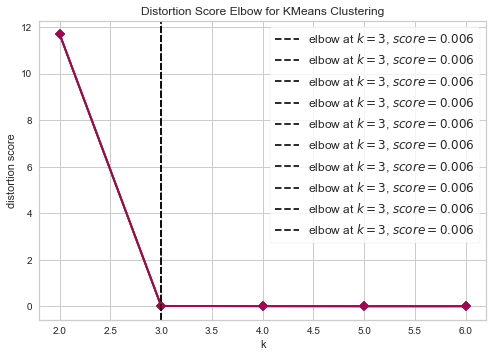

Iniciando Persistencia
Sucesso na inserção
Processando sent: 592
Iniciando Persistencia
Sucesso na inserção
Processando sent: 593


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

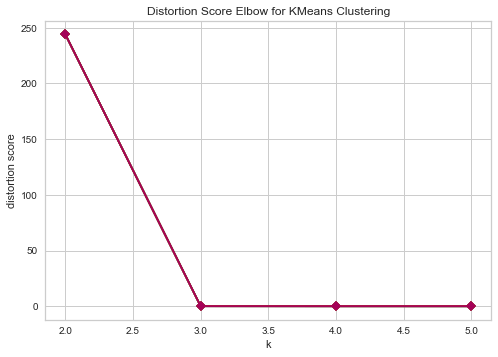

Iniciando Persistencia
Sucesso na inserção
Processando sent: 594


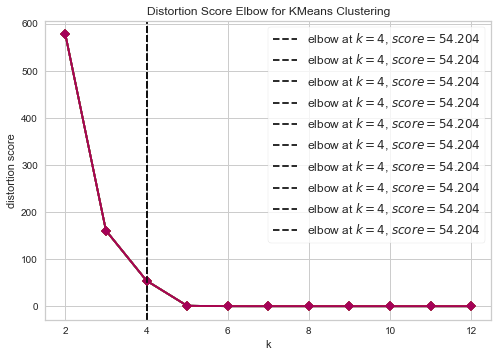

Iniciando Persistencia
Sucesso na inserção
Processando sent: 595


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 596
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 597


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

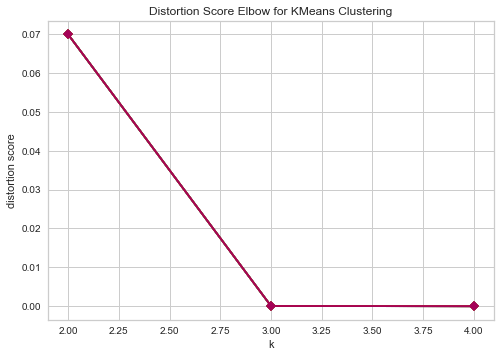

Iniciando Persistencia
Sucesso na inserção
Processando sent: 598


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

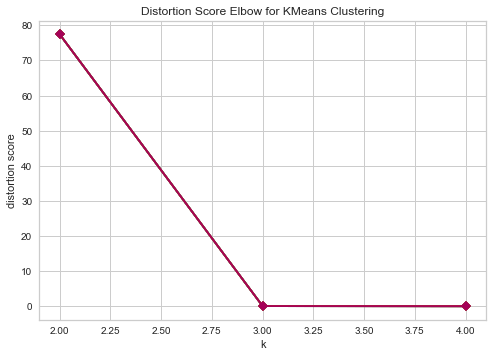

Iniciando Persistencia
Sucesso na inserção
Processando sent: 599


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

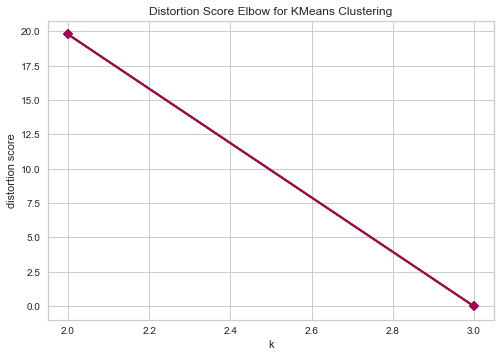

Iniciando Persistencia
Sucesso na inserção
Processando sent: 600


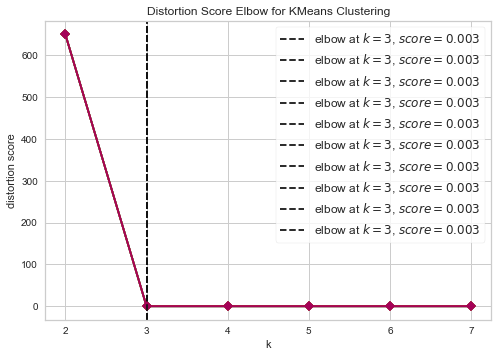

Iniciando Persistencia
Sucesso na inserção
Processando sent: 601


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

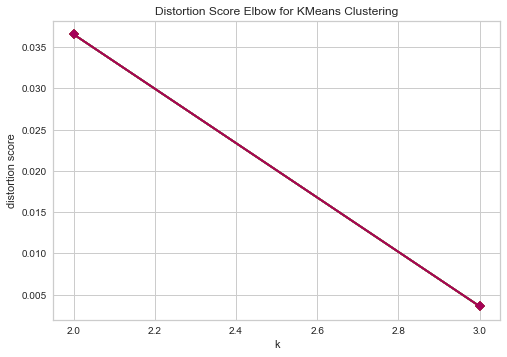

Iniciando Persistencia
Sucesso na inserção
Processando sent: 602
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 603
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 604


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

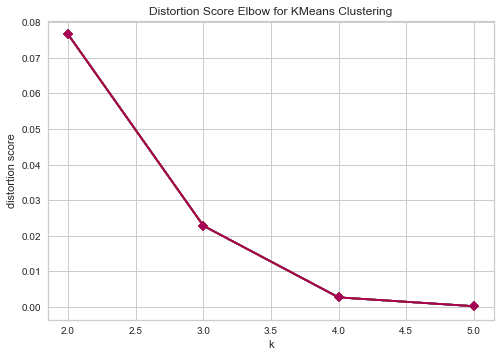

Iniciando Persistencia
Sucesso na inserção
Processando sent: 605


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

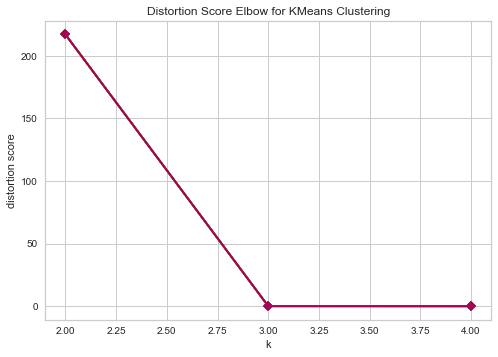

Iniciando Persistencia
Sucesso na inserção
Processando sent: 606
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 607


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 608


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

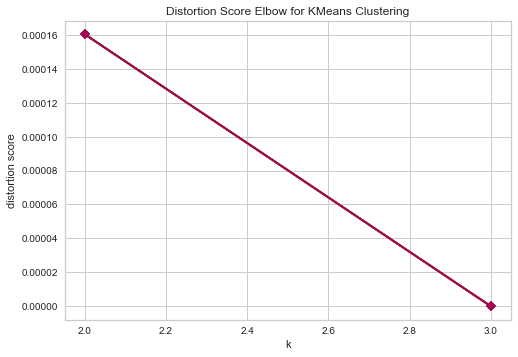

Iniciando Persistencia
Sucesso na inserção
Processando sent: 609


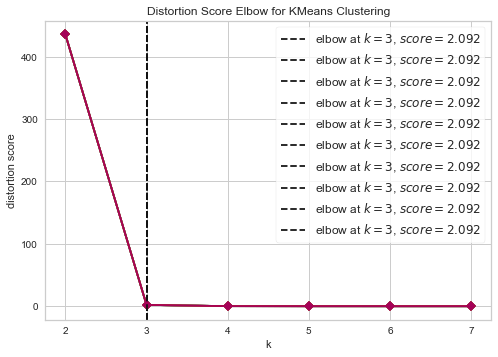

Iniciando Persistencia
Sucesso na inserção
Processando sent: 610


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 611


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

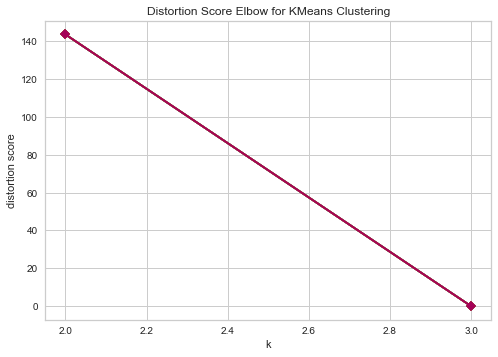

Iniciando Persistencia
Sucesso na inserção
Processando sent: 612
Iniciando Persistencia
Sucesso na inserção
Processando sent: 613
Iniciando Persistencia
Sucesso na inserção
Processando sent: 614


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 615
Iniciando Persistencia
Sucesso na inserção
Processando sent: 616


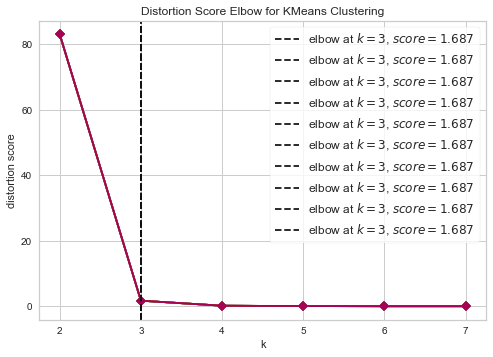

Iniciando Persistencia
Sucesso na inserção
Processando sent: 617
Iniciando Persistencia
Sucesso na inserção
Processando sent: 618


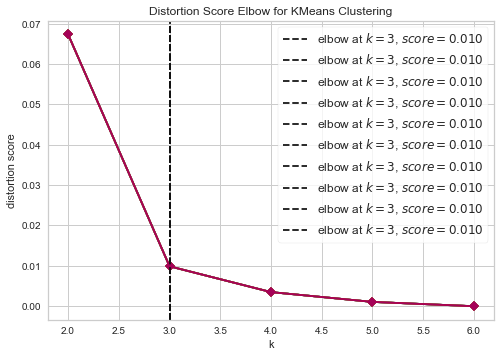

Iniciando Persistencia
Sucesso na inserção
Processando sent: 619


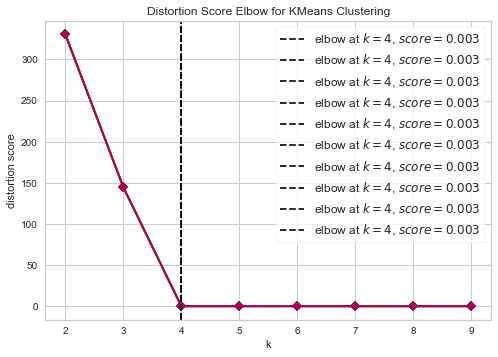

Iniciando Persistencia
Sucesso na inserção
Processando sent: 620


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 621
Iniciando Persistencia
Sucesso na inserção
Processando sent: 622
Iniciando Persistencia
Sucesso na inserção
Processando sent: 623


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (35) found smaller than n_clusters (36). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 624


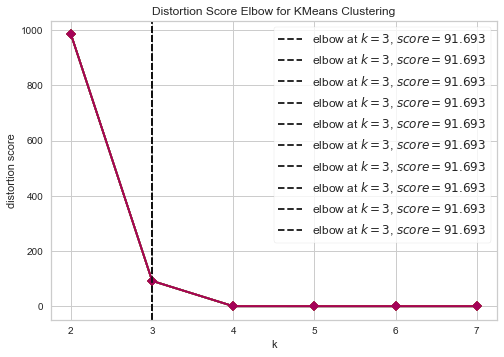

Iniciando Persistencia
Sucesso na inserção
Processando sent: 625
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 626
Iniciando Persistencia
Sucesso na inserção
Processando sent: 627


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X

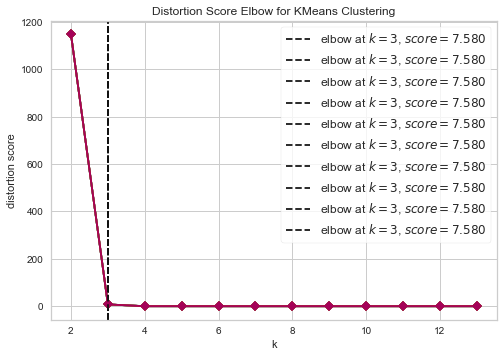

Iniciando Persistencia
Sucesso na inserção
Processando sent: 628
Iniciando Persistencia
Sucesso na inserção
Processando sent: 629
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 630
Iniciando Persistencia
Sucesso na inserção
Processando sent: 631
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 632
Iniciando Persistencia
Sucesso na inserção
Processando sent: 633


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 634
Iniciando Persistencia
Sucesso na inserção
Processando sent: 635
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 636


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

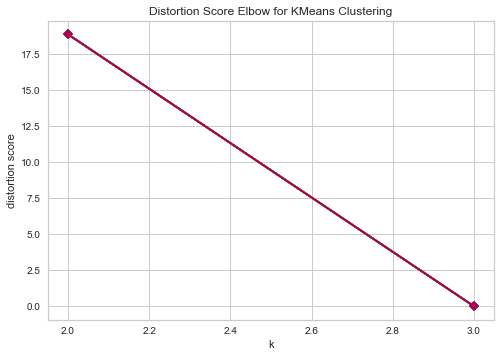

Iniciando Persistencia
Sucesso na inserção
Processando sent: 637


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

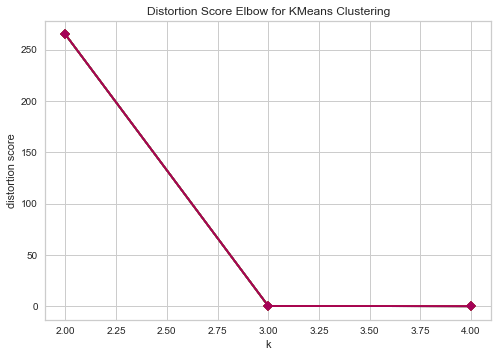

Iniciando Persistencia
Sucesso na inserção
Processando sent: 638
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 639
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 640
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 641


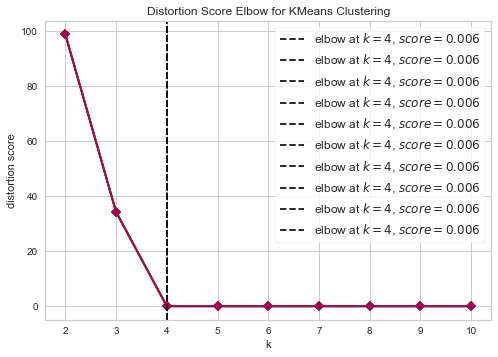

Iniciando Persistencia
Sucesso na inserção
Processando sent: 642


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

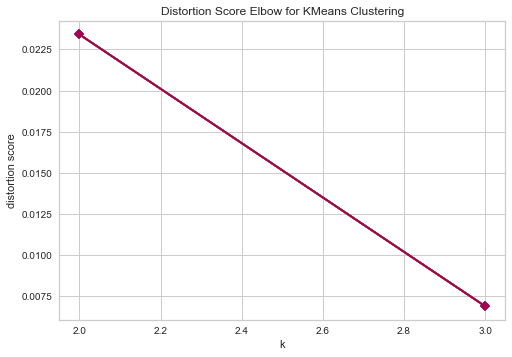

Iniciando Persistencia
Sucesso na inserção
Processando sent: 643


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

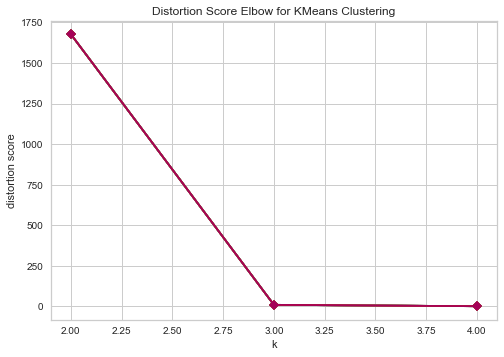

Iniciando Persistencia
Sucesso na inserção
Processando sent: 644


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 645
Iniciando Persistencia
Sucesso na inserção
Processando sent: 646


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 647
Iniciando Persistencia
Sucesso na inserção
Processando sent: 648


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

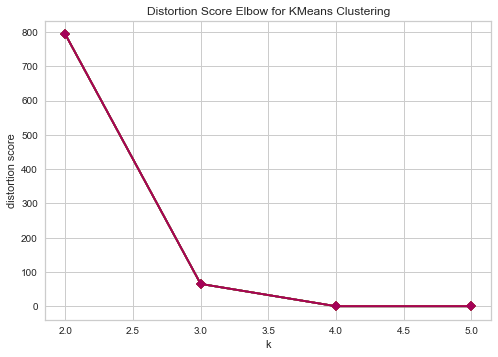

Iniciando Persistencia
Sucesso na inserção
Processando sent: 649
Iniciando Persistencia
Sucesso na inserção
Processando sent: 650
Iniciando Persistencia
Sucesso na inserção
Processando sent: 651


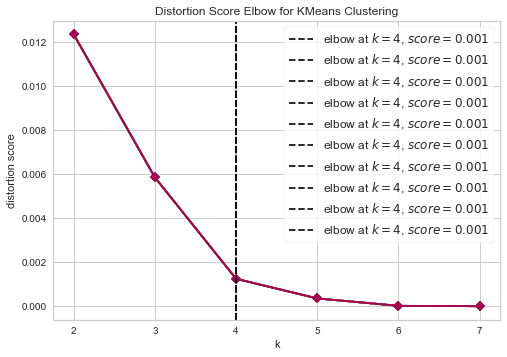

Iniciando Persistencia
Sucesso na inserção
Processando sent: 652


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

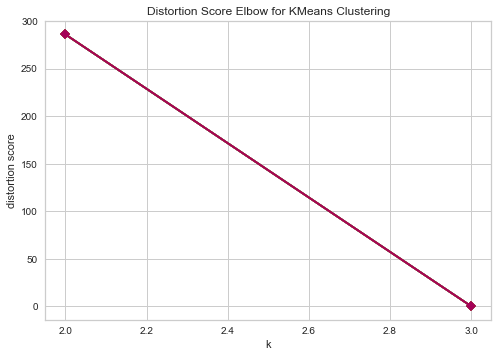

Iniciando Persistencia
Sucesso na inserção
Processando sent: 653
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 654


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.esti

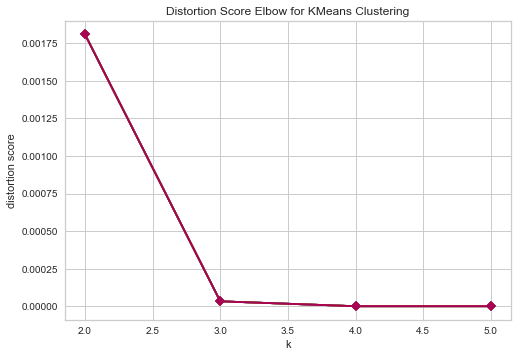

Iniciando Persistencia
Sucesso na inserção
Processando sent: 655
Iniciando Persistencia
Sucesso na inserção
Processando sent: 656


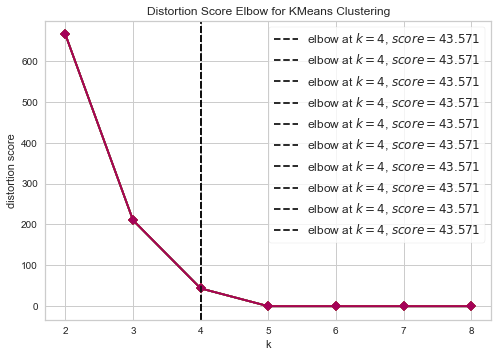

Iniciando Persistencia
Sucesso na inserção
Processando sent: 657


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

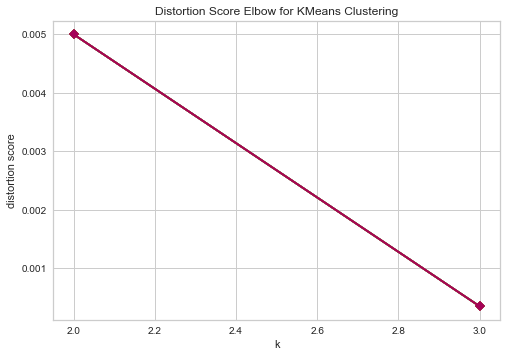

Iniciando Persistencia
Sucesso na inserção
Processando sent: 658


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

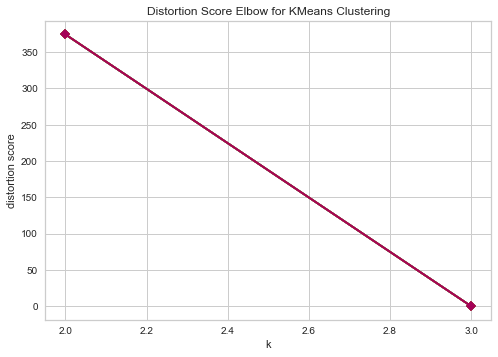

Iniciando Persistencia
Sucesso na inserção
Processando sent: 659


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (21) found smaller than n_clusters (22). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (21) found smaller than n_clusters (23). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 660


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'kn

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 661


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

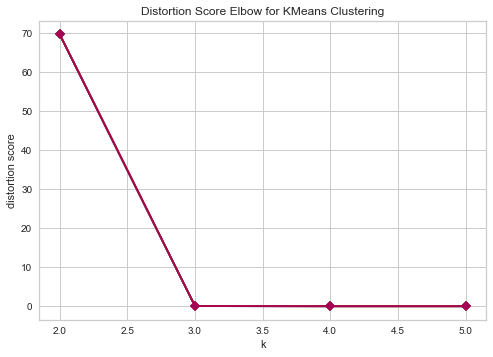

Iniciando Persistencia
Sucesso na inserção
Processando sent: 662


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

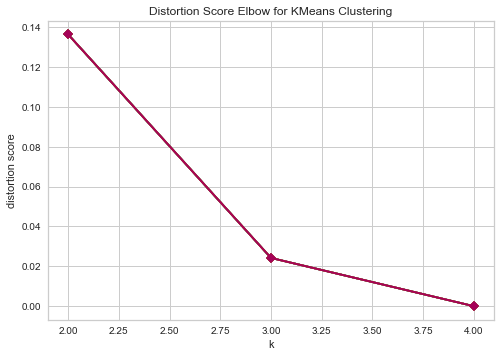

Iniciando Persistencia
Sucesso na inserção
Processando sent: 663


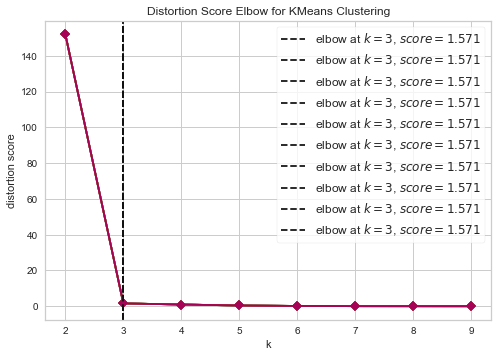

Iniciando Persistencia
Sucesso na inserção
Processando sent: 664
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 665


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

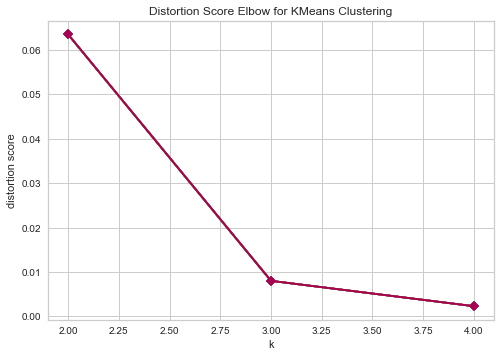

Iniciando Persistencia
Sucesso na inserção
Processando sent: 666


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

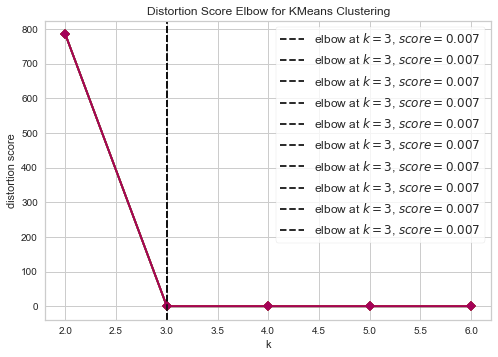

Iniciando Persistencia
Sucesso na inserção
Processando sent: 667
Iniciando Persistencia
Sucesso na inserção
Processando sent: 668


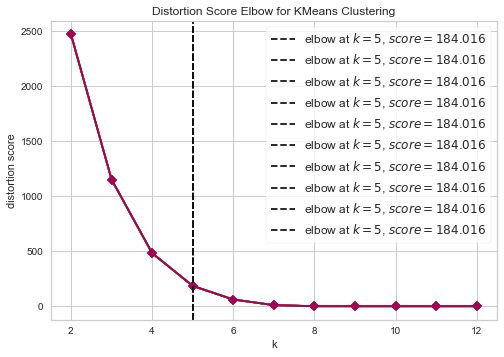

Iniciando Persistencia
Sucesso na inserção
Processando sent: 669


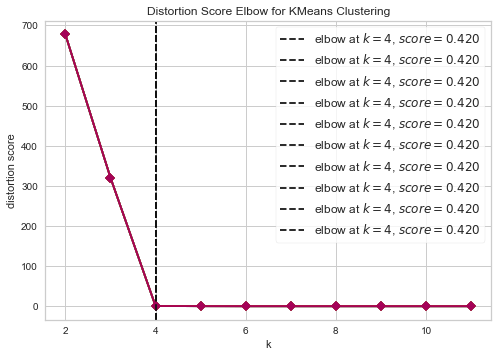

Iniciando Persistencia
Sucesso na inserção
Processando sent: 670
Iniciando Persistencia
Sucesso na inserção
Processando sent: 671


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (73) found smaller than n_clusters (74). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 672
Iniciando Persistencia
Sucesso na inserção
Processando sent: 673
Iniciando Persistencia
Sucesso na inserção
Processando sent: 674


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

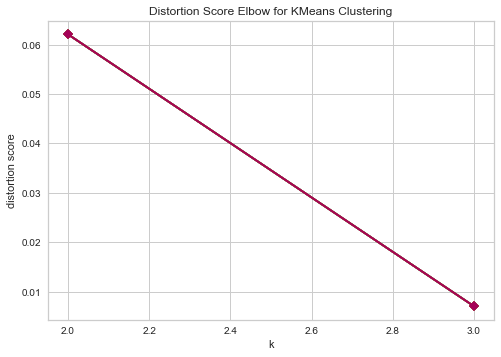

Iniciando Persistencia
Sucesso na inserção
Processando sent: 675
Iniciando Persistencia
Sucesso na inserção
Processando sent: 676


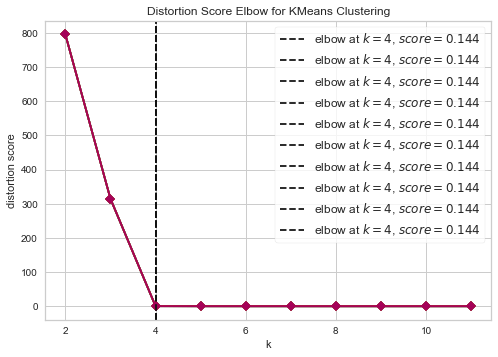

Iniciando Persistencia
Sucesso na inserção
Processando sent: 677
Iniciando Persistencia
Sucesso na inserção
Processando sent: 678
Iniciando Persistencia
Sucesso na inserção
Processando sent: 679


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

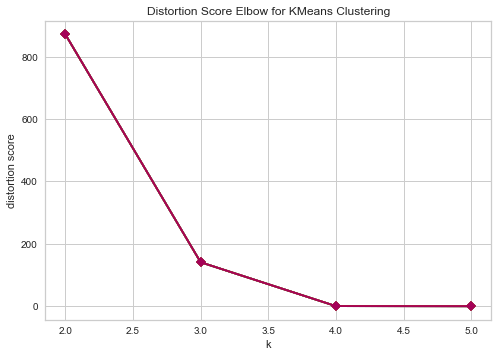

Iniciando Persistencia
Sucesso na inserção
Processando sent: 680


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

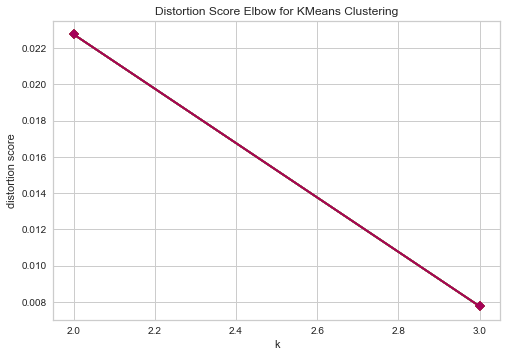

Iniciando Persistencia
Sucesso na inserção
Processando sent: 681


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

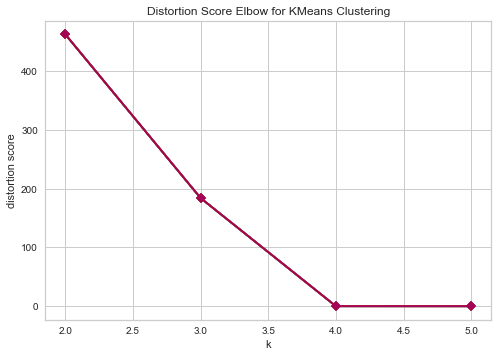

Iniciando Persistencia
Sucesso na inserção
Processando sent: 682
Iniciando Persistencia
Sucesso na inserção
Processando sent: 683


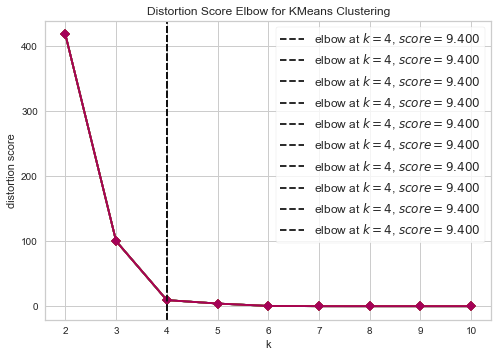

Iniciando Persistencia
Sucesso na inserção
Processando sent: 684
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 685
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 686
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 687
Iniciando Persistencia
Sucesso na inserção
Processando sent: 688
Iniciando Persistencia
Sucesso na inserção
Processando sent: 689


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

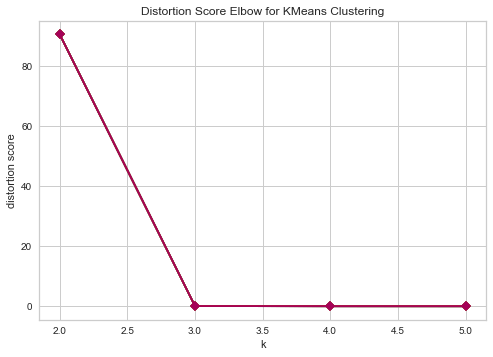

Iniciando Persistencia
Sucesso na inserção
Processando sent: 690


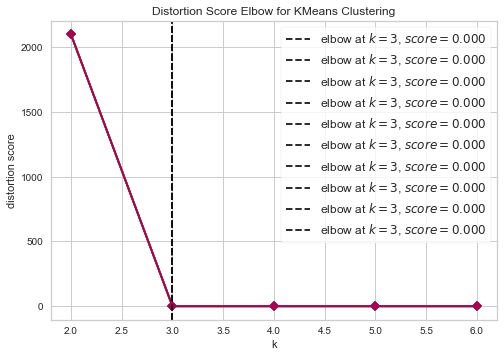

Iniciando Persistencia
Sucesso na inserção
Processando sent: 691
Iniciando Persistencia
Sucesso na inserção
Processando sent: 692


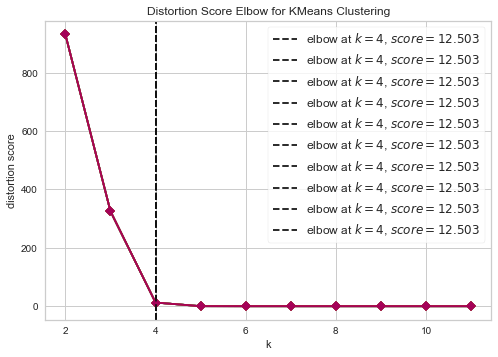

Iniciando Persistencia
Sucesso na inserção
Processando sent: 693
Iniciando Persistencia
Sucesso na inserção
Processando sent: 694
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 695
Iniciando Persistencia
Sucesso na inserção
Processando sent: 696
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 697
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 698
Iniciando Persistencia
Sucesso na inserção
Processando sent: 699


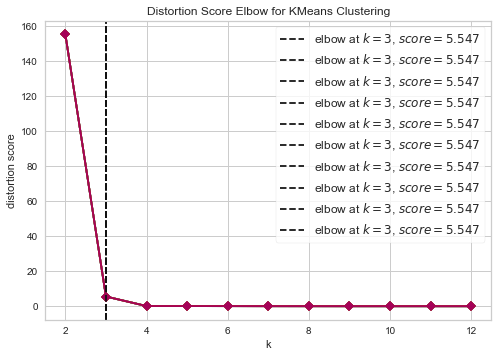

Iniciando Persistencia
Sucesso na inserção
Processando sent: 700


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

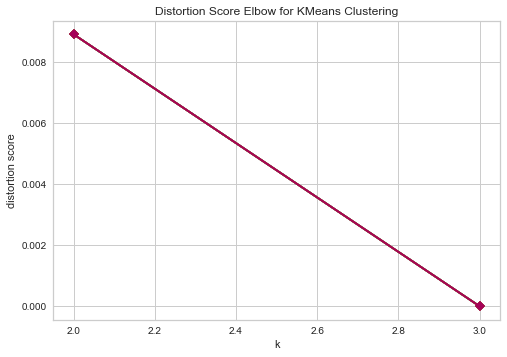

Iniciando Persistencia
Sucesso na inserção
Processando sent: 701


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

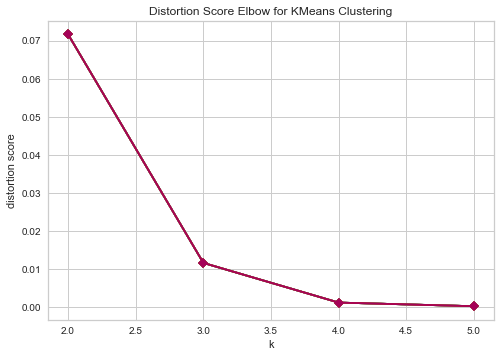

Iniciando Persistencia
Sucesso na inserção
Processando sent: 702


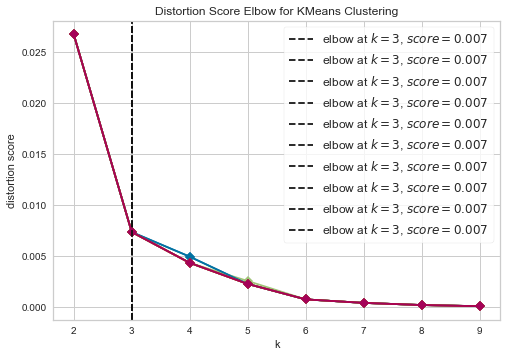

Iniciando Persistencia
Sucesso na inserção
Processando sent: 703


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

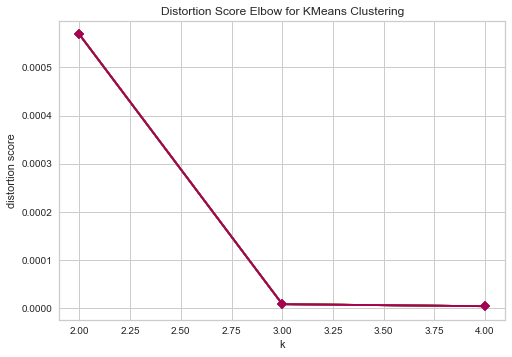

Iniciando Persistencia
Sucesso na inserção
Processando sent: 704
Iniciando Persistencia
Sucesso na inserção
Processando sent: 705
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 706
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 707


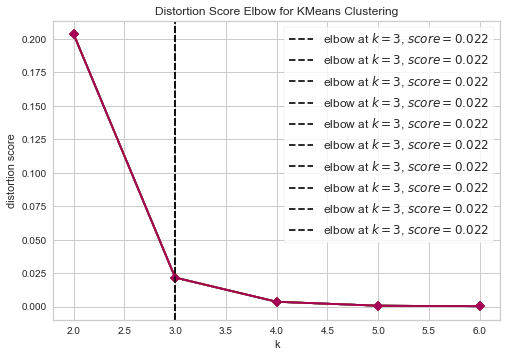

Iniciando Persistencia
Sucesso na inserção
Processando sent: 708
Iniciando Persistencia
Sucesso na inserção
Processando sent: 709
Iniciando Persistencia
Sucesso na inserção
Processando sent: 710
Iniciando Persistencia
Sucesso na inserção
Processando sent: 711
Iniciando Persistencia
Sucesso na inserção
Processando sent: 712
Iniciando Persistencia
Sucesso na inserção
Processando sent: 713


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

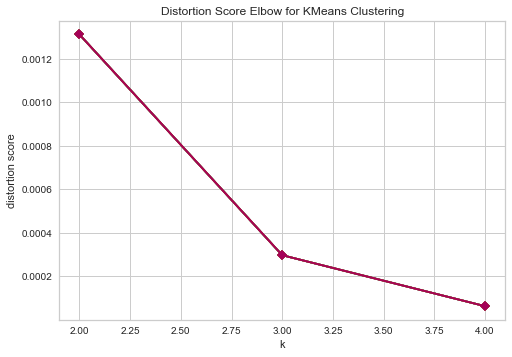

Iniciando Persistencia
Sucesso na inserção
Processando sent: 714
Iniciando Persistencia
Sucesso na inserção
Processando sent: 715


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

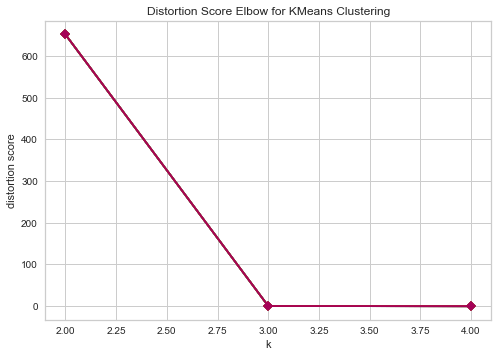

Iniciando Persistencia
Sucesso na inserção
Processando sent: 716


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

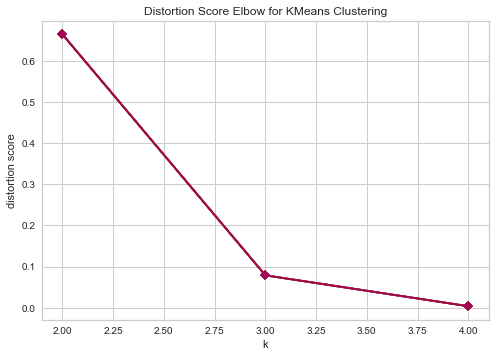

Iniciando Persistencia
Sucesso na inserção
Processando sent: 717
Iniciando Persistencia
Sucesso na inserção
Processando sent: 718


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

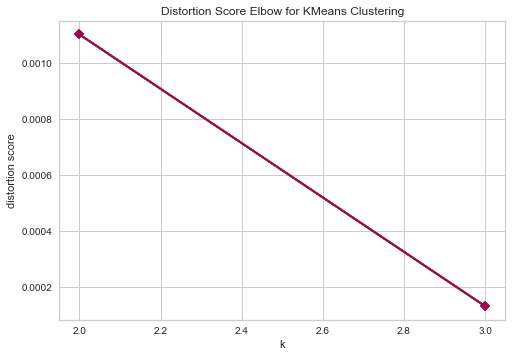

Iniciando Persistencia
Sucesso na inserção
Processando sent: 719


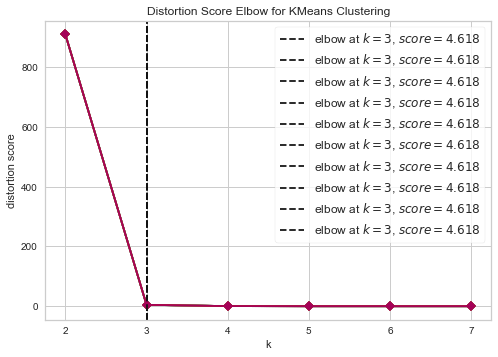

Iniciando Persistencia
Sucesso na inserção
Processando sent: 720


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

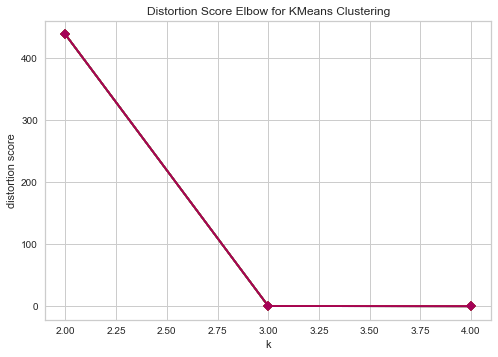

Iniciando Persistencia
Sucesso na inserção
Processando sent: 721
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 722


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

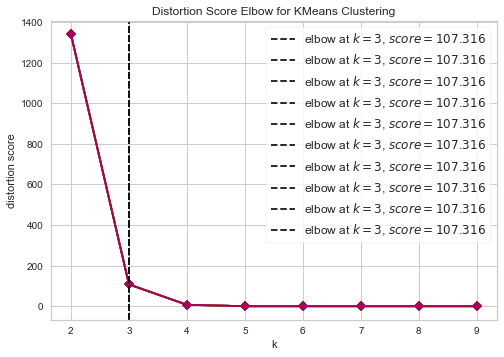

Iniciando Persistencia
Sucesso na inserção
Processando sent: 723
Iniciando Persistencia
Sucesso na inserção
Processando sent: 724


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

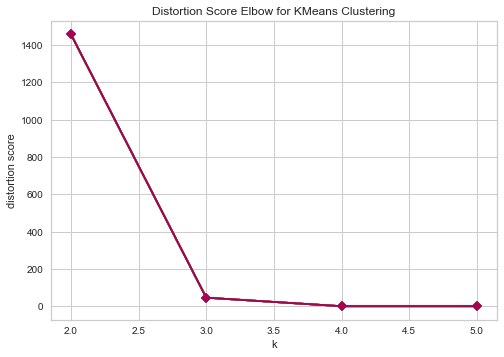

Iniciando Persistencia
Sucesso na inserção
Processando sent: 725
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 726


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

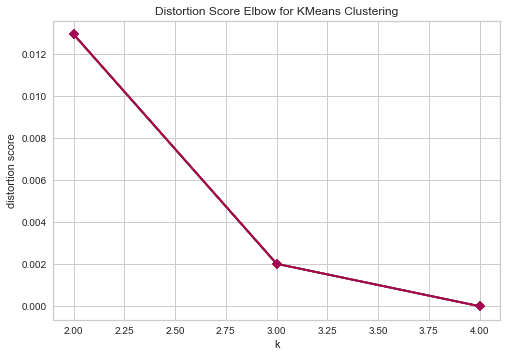

Iniciando Persistencia
Sucesso na inserção
Processando sent: 727
Iniciando Persistencia
Sucesso na inserção
Processando sent: 728
Iniciando Persistencia
Sucesso na inserção
Processando sent: 729


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

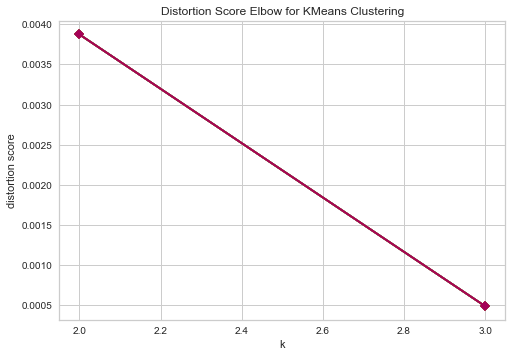

Iniciando Persistencia
Sucesso na inserção
Processando sent: 730


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

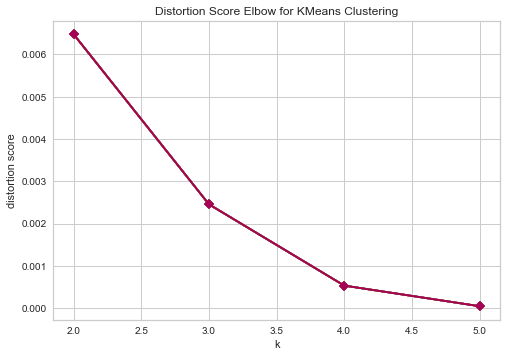

Iniciando Persistencia
Sucesso na inserção
Processando sent: 731
Iniciando Persistencia
Sucesso na inserção
Processando sent: 732
Iniciando Persistencia
Sucesso na inserção
Processando sent: 733


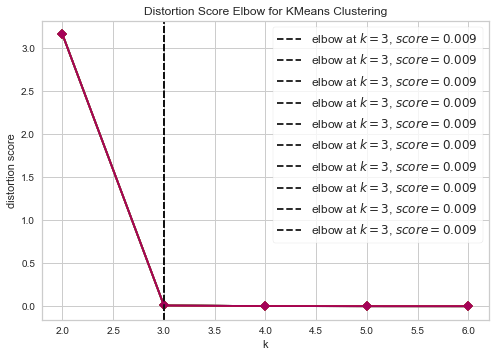

Iniciando Persistencia
Sucesso na inserção
Processando sent: 734
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 735


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

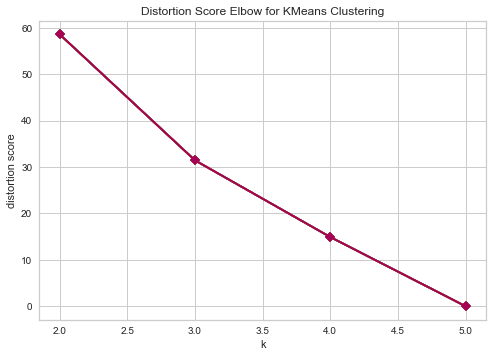

Iniciando Persistencia
Sucesso na inserção
Processando sent: 736
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 737


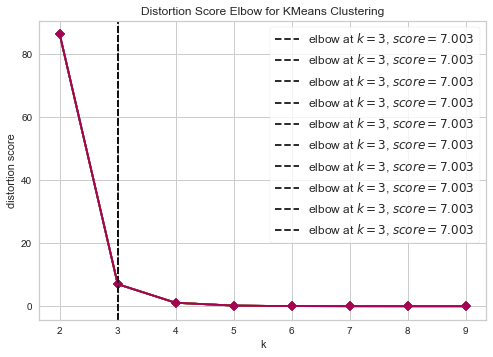

Iniciando Persistencia
Sucesso na inserção
Processando sent: 738


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 739


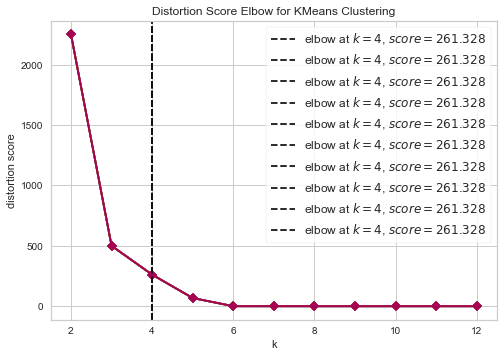

Iniciando Persistencia
Sucesso na inserção
Processando sent: 740
Iniciando Persistencia
Sucesso na inserção
Processando sent: 741
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 742
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 743
Iniciando Persistencia
Sucesso na inserção
Processando sent: 744
Iniciando Persistencia
Sucesso na inserção
Processando sent: 745
Iniciando Persistencia
Sucesso na inserção
Processando sent: 746


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

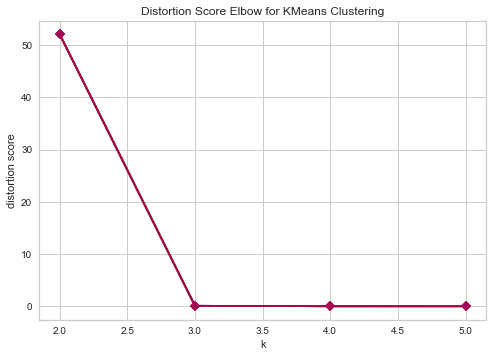

Iniciando Persistencia
Sucesso na inserção
Processando sent: 747


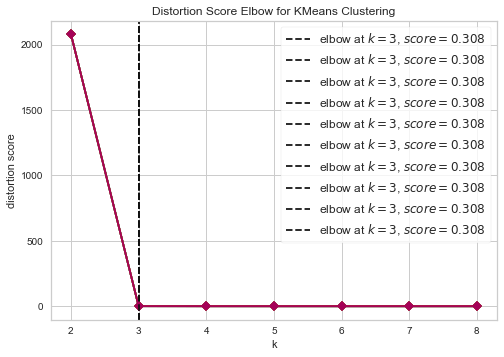

Iniciando Persistencia
Sucesso na inserção
Processando sent: 748


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

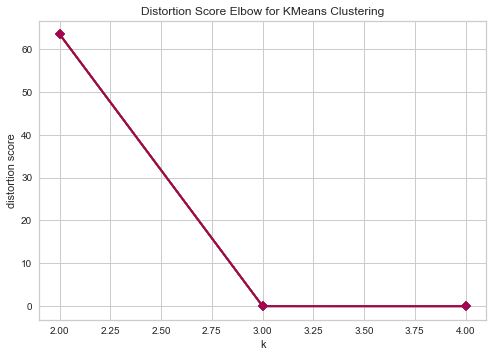

Iniciando Persistencia
Sucesso na inserção
Processando sent: 749


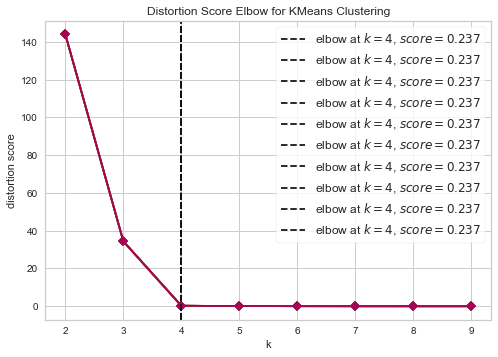

Iniciando Persistencia
Sucesso na inserção
Processando sent: 750


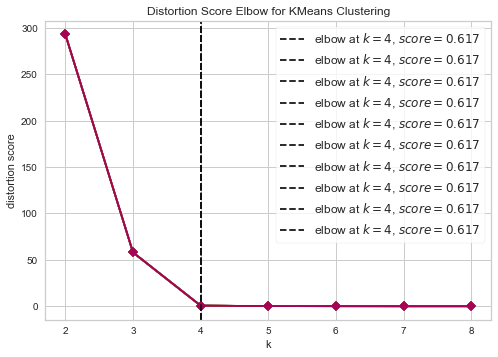

Iniciando Persistencia
Sucesso na inserção
Processando sent: 751


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

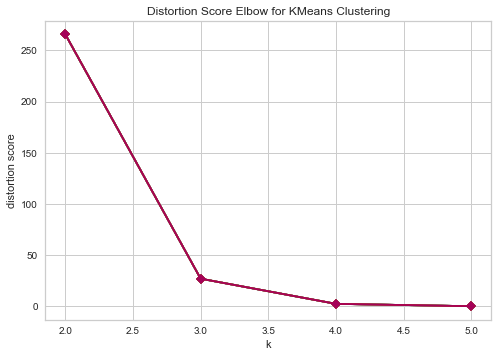

Iniciando Persistencia
Sucesso na inserção
Processando sent: 752


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 753


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

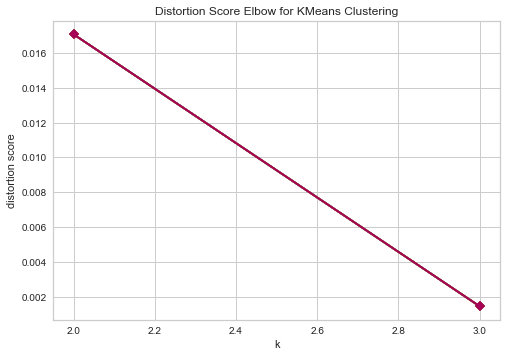

Iniciando Persistencia
Sucesso na inserção
Processando sent: 754


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

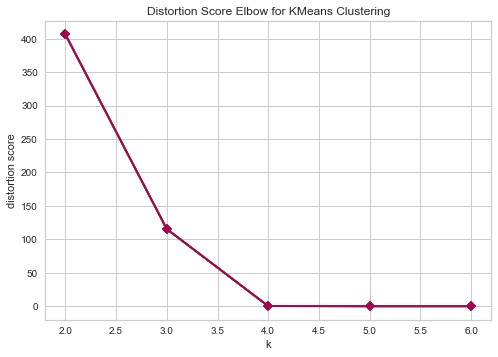

Iniciando Persistencia
Sucesso na inserção
Processando sent: 755


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

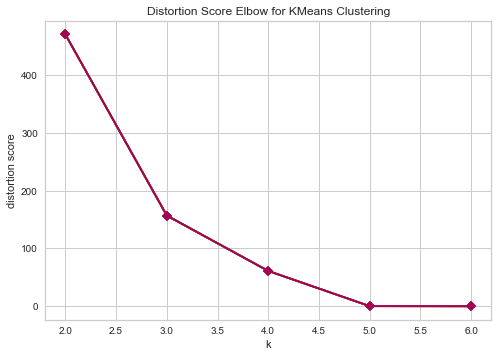

Iniciando Persistencia
Sucesso na inserção
Processando sent: 756


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

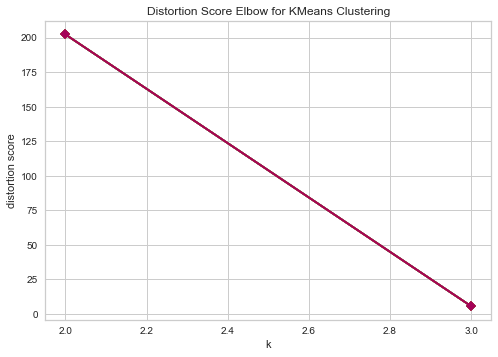

Iniciando Persistencia
Sucesso na inserção
Processando sent: 757


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 758
Iniciando Persistencia
Sucesso na inserção
Processando sent: 759


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (29). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 760


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

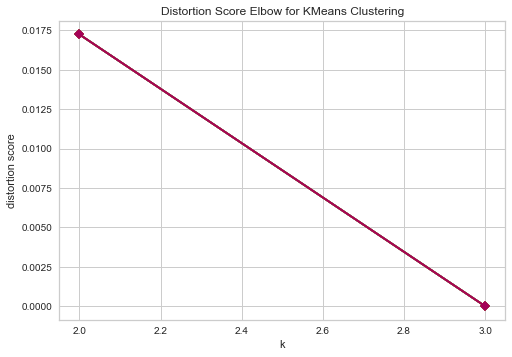

Iniciando Persistencia
Sucesso na inserção
Processando sent: 761


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

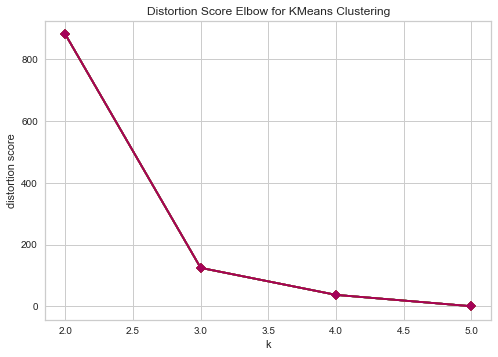

Iniciando Persistencia
Sucesso na inserção
Processando sent: 762
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 763


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

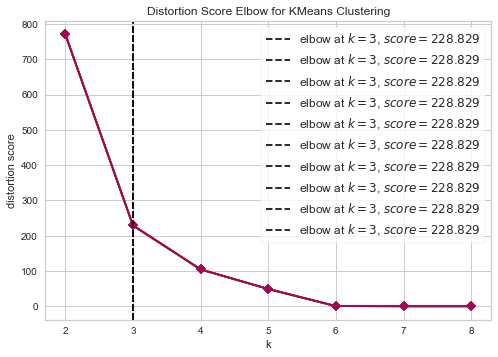

Iniciando Persistencia
Sucesso na inserção
Processando sent: 764


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

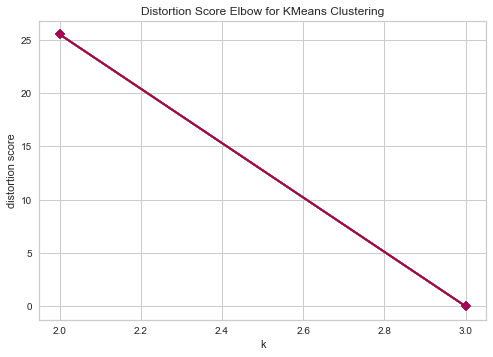

Iniciando Persistencia
Sucesso na inserção
Processando sent: 765


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

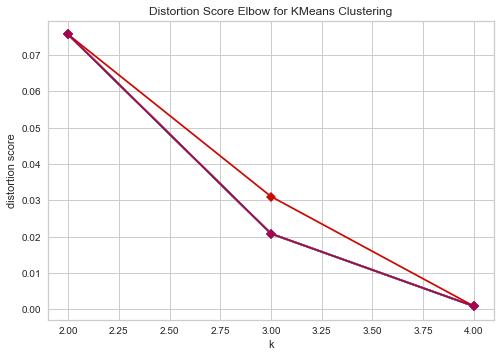

Iniciando Persistencia
Sucesso na inserção
Processando sent: 766
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 767


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

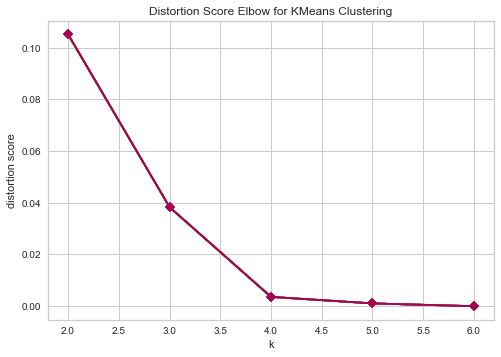

Iniciando Persistencia
Sucesso na inserção
Processando sent: 768
Iniciando Persistencia
Sucesso na inserção
Processando sent: 769
Iniciando Persistencia
Sucesso na inserção
Processando sent: 770


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

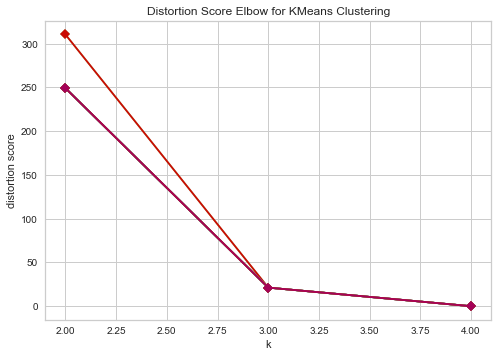

Iniciando Persistencia
Sucesso na inserção
Processando sent: 771
Iniciando Persistencia
Sucesso na inserção
Processando sent: 772
Iniciando Persistencia
Sucesso na inserção
Processando sent: 773
Iniciando Persistencia
Sucesso na inserção
Processando sent: 774


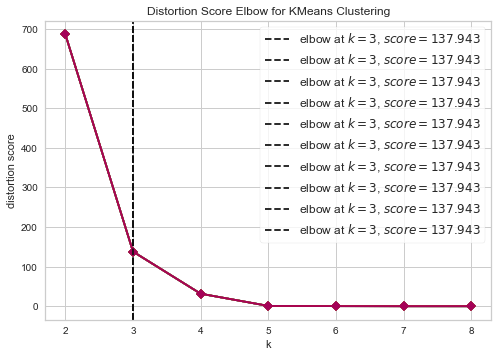

Iniciando Persistencia
Sucesso na inserção
Processando sent: 775


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

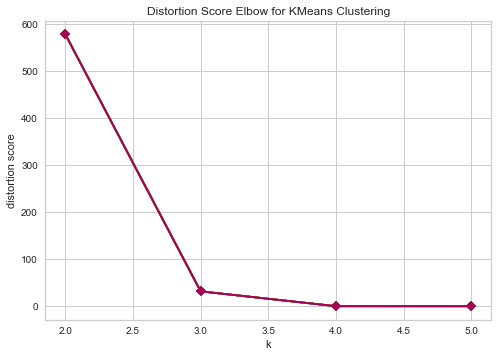

Iniciando Persistencia
Sucesso na inserção
Processando sent: 776
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 777
Iniciando Persistencia
Sucesso na inserção
Processando sent: 778
Iniciando Persistencia
Sucesso na inserção
Processando sent: 779
Iniciando Persistencia
Sucesso na inserção
Processando sent: 780


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

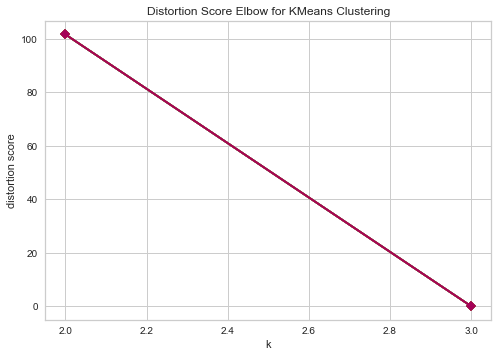

Iniciando Persistencia
Sucesso na inserção
Processando sent: 781


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

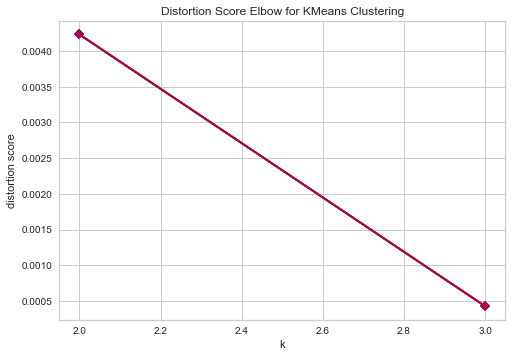

Iniciando Persistencia
Sucesso na inserção
Processando sent: 782


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 783


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

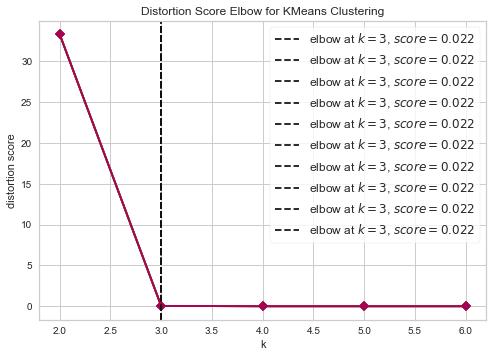

Iniciando Persistencia
Sucesso na inserção
Processando sent: 784
Iniciando Persistencia
Sucesso na inserção
Processando sent: 785
Iniciando Persistencia
Sucesso na inserção
Processando sent: 786


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

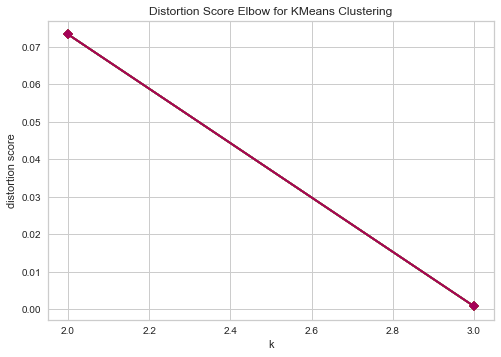

Iniciando Persistencia
Sucesso na inserção
Processando sent: 787
Iniciando Persistencia
Sucesso na inserção
Processando sent: 788
Iniciando Persistencia
Sucesso na inserção
Processando sent: 789
Iniciando Persistencia
Sucesso na inserção
Processando sent: 790


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (29). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 791
Iniciando Persistencia
Sucesso na inserção
Processando sent: 792
Iniciando Persistencia
Sucesso na inserção
Processando sent: 793
Iniciando Persistencia
Sucesso na inserção
Processando sent: 794
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 795
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 796
Iniciando Persistencia
Sucesso na inserção
Processando sent: 797
Iniciando Persistencia
Sucesso na inserção
Processando sent: 798


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

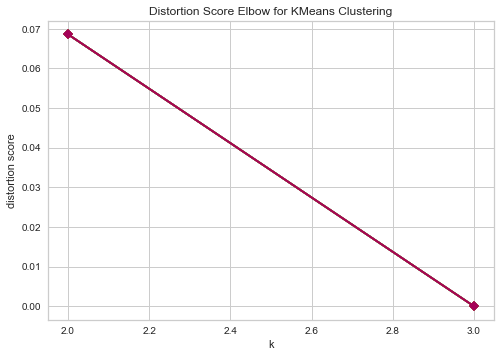

Iniciando Persistencia
Sucesso na inserção
Processando sent: 799


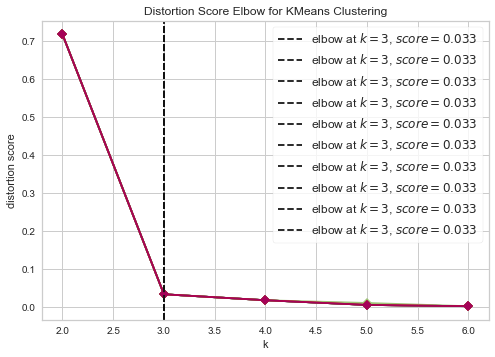

Iniciando Persistencia
Sucesso na inserção
Processando sent: 800
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 801


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

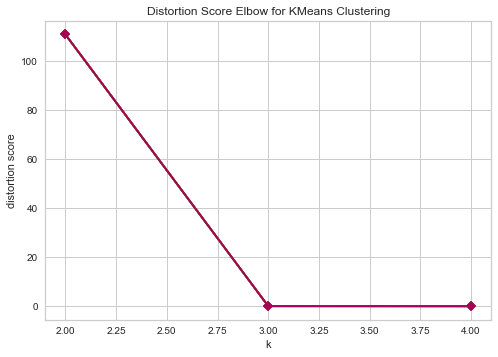

Iniciando Persistencia
Sucesso na inserção
Processando sent: 802
Iniciando Persistencia
Sucesso na inserção
Processando sent: 803


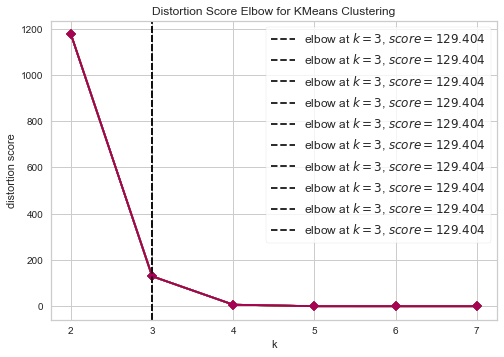

Iniciando Persistencia
Sucesso na inserção
Processando sent: 804


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

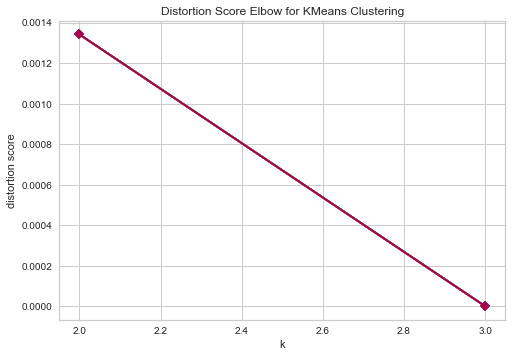

Iniciando Persistencia
Sucesso na inserção
Processando sent: 805


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

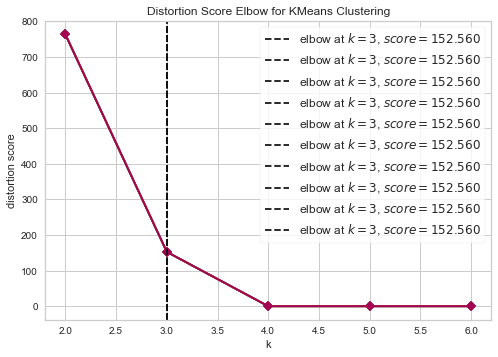

Iniciando Persistencia
Sucesso na inserção
Processando sent: 806


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

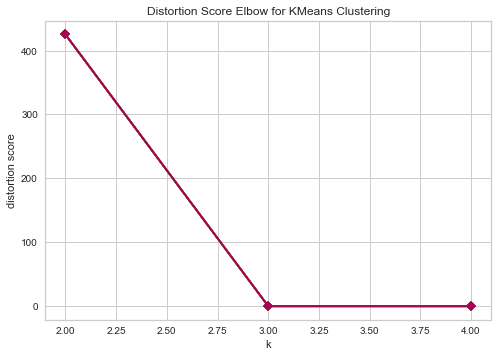

Iniciando Persistencia
Sucesso na inserção
Processando sent: 807


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 808


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

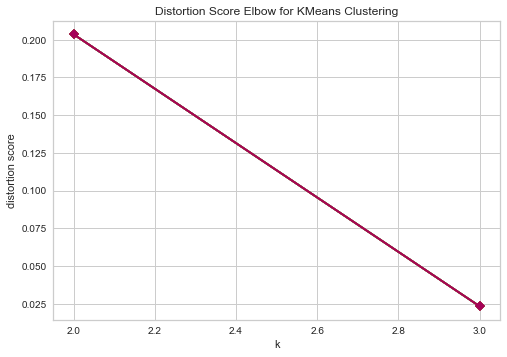

Iniciando Persistencia
Sucesso na inserção
Processando sent: 809
Iniciando Persistencia
Sucesso na inserção
Processando sent: 810
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 811
Iniciando Persistencia
Sucesso na inserção
Processando sent: 812
Iniciando Persistencia
Sucesso na inserção
Processando sent: 813
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 814
Iniciando Persistencia
Sucesso na inserção
Processando sent: 815


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

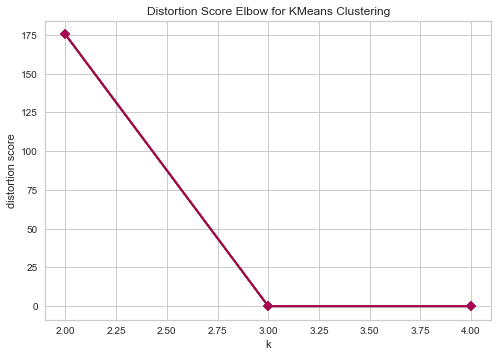

Iniciando Persistencia
Sucesso na inserção
Processando sent: 816
Iniciando Persistencia
Sucesso na inserção
Processando sent: 817


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

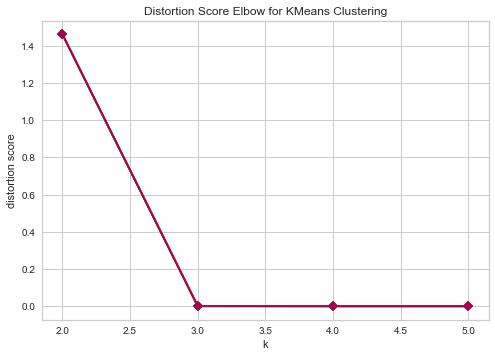

Iniciando Persistencia
Sucesso na inserção
Processando sent: 818
Iniciando Persistencia
Sucesso na inserção
Processando sent: 819
Iniciando Persistencia
Sucesso na inserção
Processando sent: 820


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

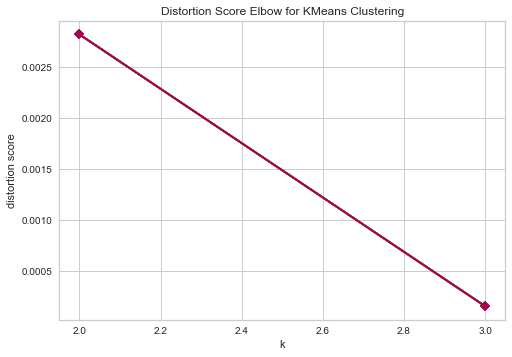

Iniciando Persistencia
Sucesso na inserção
Processando sent: 821
Iniciando Persistencia
Sucesso na inserção
Processando sent: 822
Iniciando Persistencia
Sucesso na inserção
Processando sent: 823
Iniciando Persistencia
Sucesso na inserção
Processando sent: 824
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 825


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

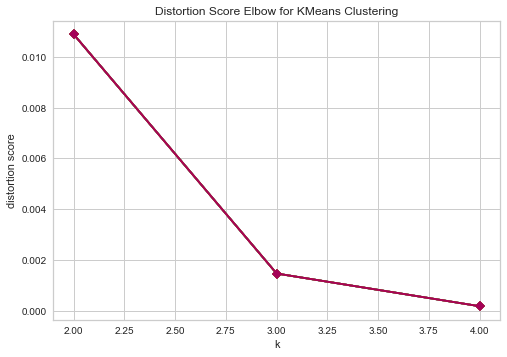

Iniciando Persistencia
Sucesso na inserção
Processando sent: 826
Iniciando Persistencia
Sucesso na inserção
Processando sent: 827


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.esti

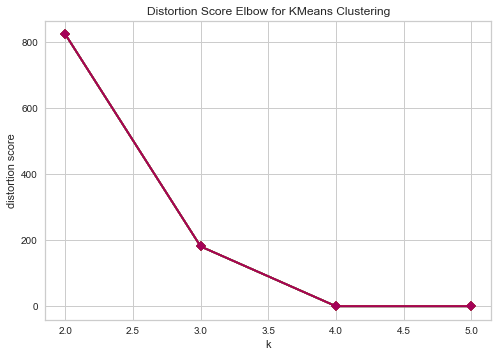

Iniciando Persistencia
Sucesso na inserção
Processando sent: 828


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

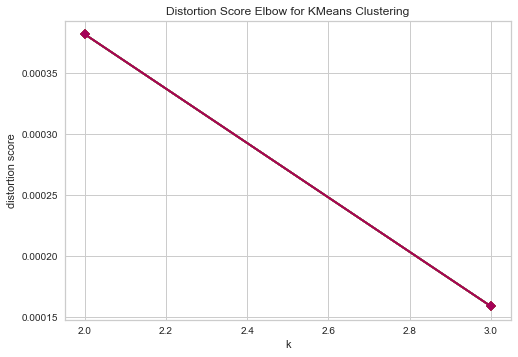

Iniciando Persistencia
Sucesso na inserção
Processando sent: 829
Iniciando Persistencia
Sucesso na inserção
Processando sent: 830


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

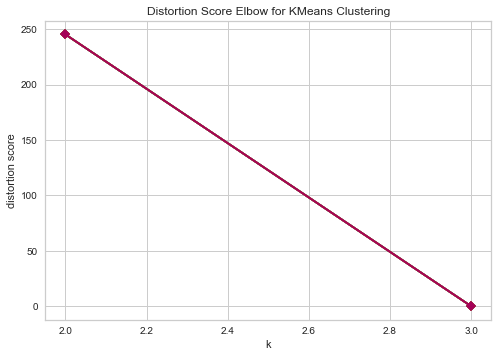

Iniciando Persistencia
Sucesso na inserção
Processando sent: 831
Iniciando Persistencia
Sucesso na inserção
Processando sent: 832


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

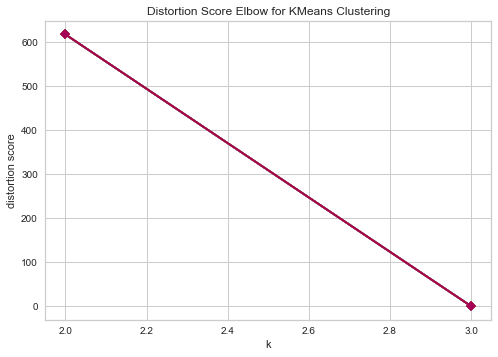

Iniciando Persistencia
Sucesso na inserção
Processando sent: 833


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" det

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 834


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

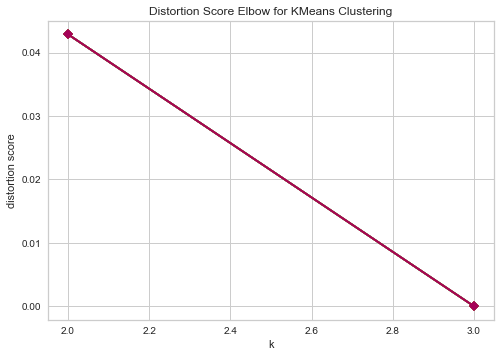

Iniciando Persistencia
Sucesso na inserção
Processando sent: 835


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

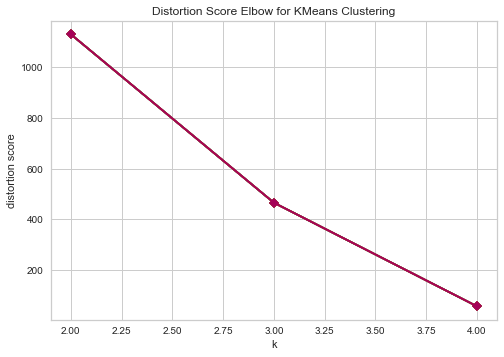

Iniciando Persistencia
Sucesso na inserção
Processando sent: 836


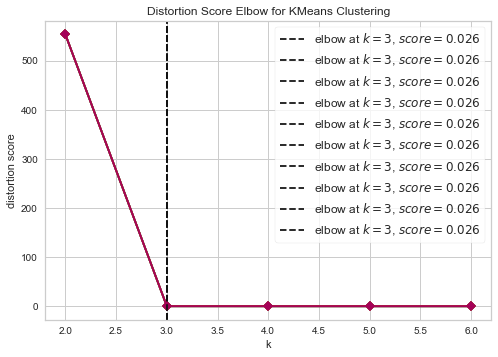

Iniciando Persistencia
Sucesso na inserção
Processando sent: 837
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 838


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

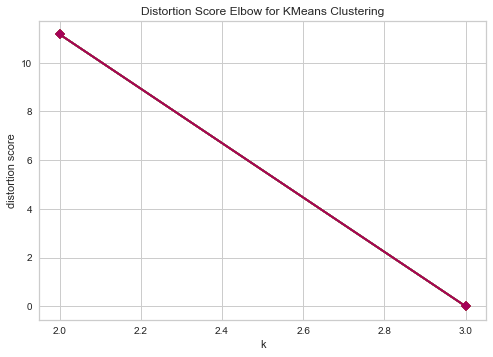

Iniciando Persistencia
Sucesso na inserção
Processando sent: 839


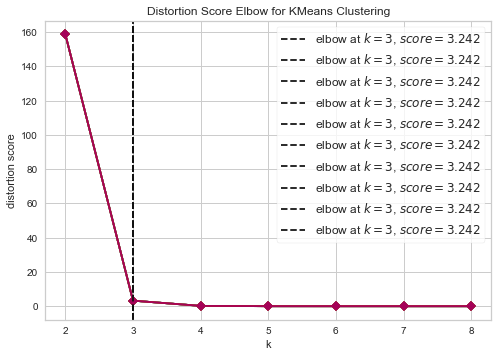

Iniciando Persistencia
Sucesso na inserção
Processando sent: 840
Iniciando Persistencia
Sucesso na inserção
Processando sent: 841


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

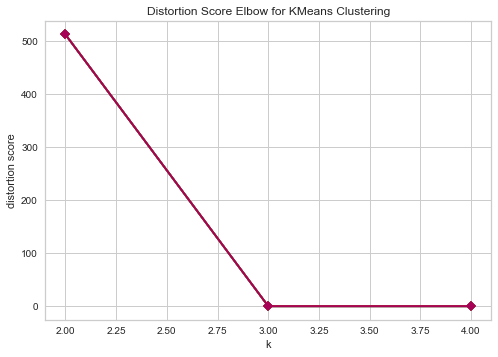

Iniciando Persistencia
Sucesso na inserção
Processando sent: 842


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

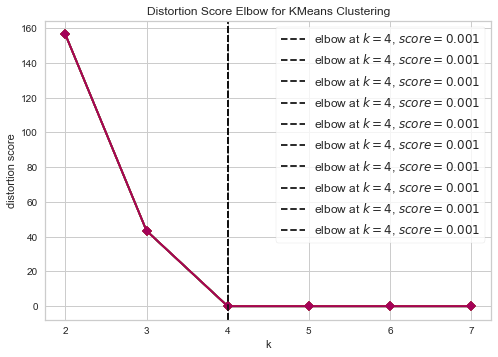

Iniciando Persistencia
Sucesso na inserção
Processando sent: 843
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 844


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

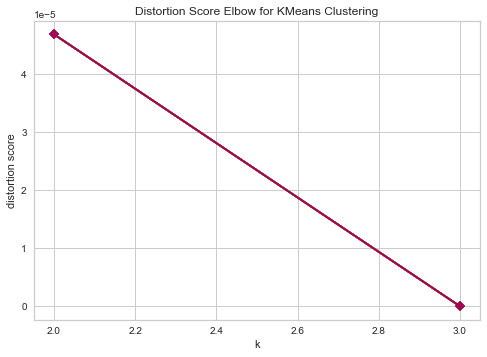

Iniciando Persistencia
Sucesso na inserção
Processando sent: 845
Iniciando Persistencia
Sucesso na inserção
Processando sent: 846


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

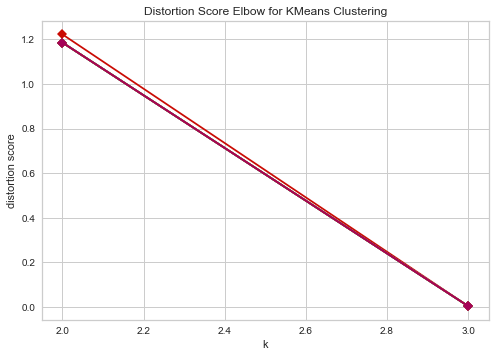

Iniciando Persistencia
Sucesso na inserção
Processando sent: 847
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 848


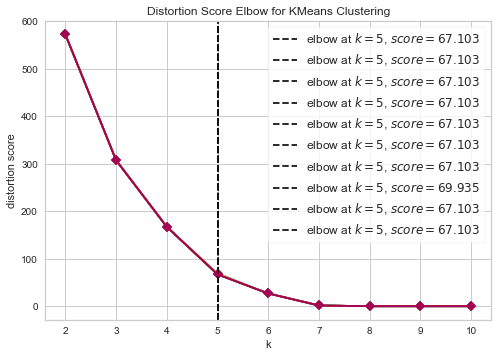

Iniciando Persistencia
Sucesso na inserção
Processando sent: 849


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

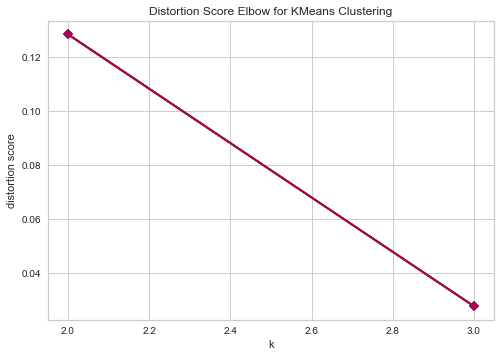

Iniciando Persistencia
Sucesso na inserção
Processando sent: 850
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 851
Iniciando Persistencia
Sucesso na inserção
Processando sent: 852
Iniciando Persistencia
Sucesso na inserção
Processando sent: 853
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 854


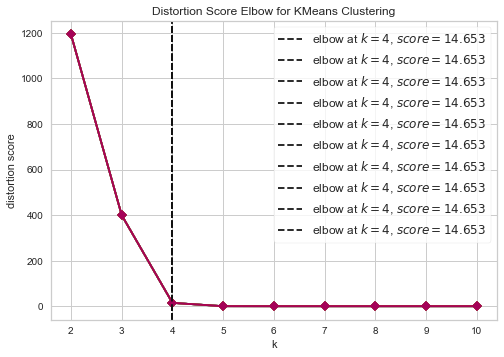

Iniciando Persistencia
Sucesso na inserção
Processando sent: 855
Iniciando Persistencia
Sucesso na inserção
Processando sent: 856


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

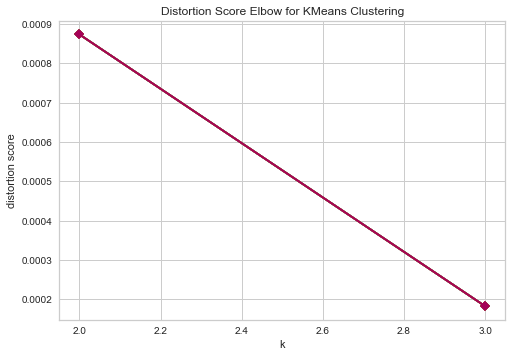

Iniciando Persistencia
Sucesso na inserção
Processando sent: 857


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

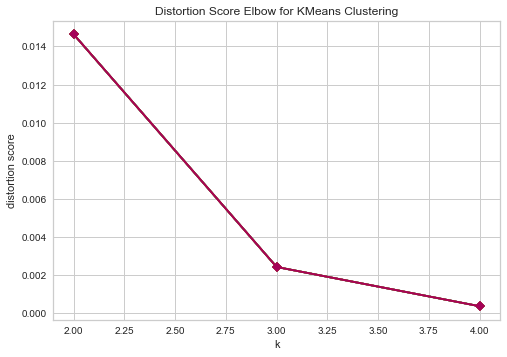

Iniciando Persistencia
Sucesso na inserção
Processando sent: 858
Iniciando Persistencia
Sucesso na inserção
Processando sent: 859


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

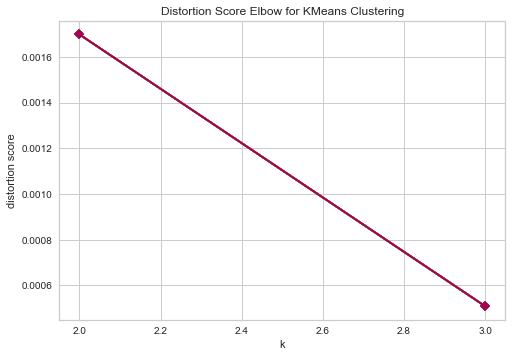

Iniciando Persistencia
Sucesso na inserção
Processando sent: 860
Iniciando Persistencia
Sucesso na inserção
Processando sent: 861
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 862
Iniciando Persistencia
Sucesso na inserção
Processando sent: 863
Iniciando Persistencia
Sucesso na inserção
Processando sent: 864
Iniciando Persistencia
Sucesso na inserção
Processando sent: 865
Iniciando Persistencia
Sucesso na inserção
Processando sent: 866


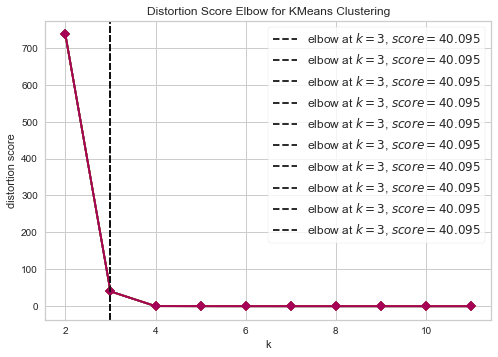

Iniciando Persistencia
Sucesso na inserção
Processando sent: 867


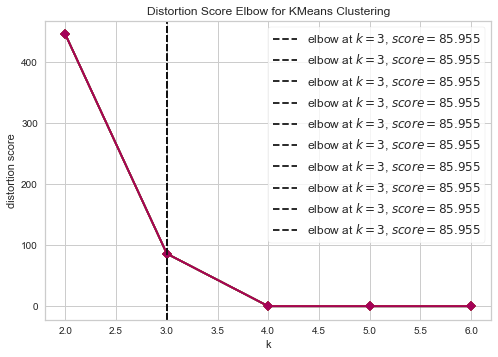

Iniciando Persistencia
Sucesso na inserção
Processando sent: 868
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 869


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

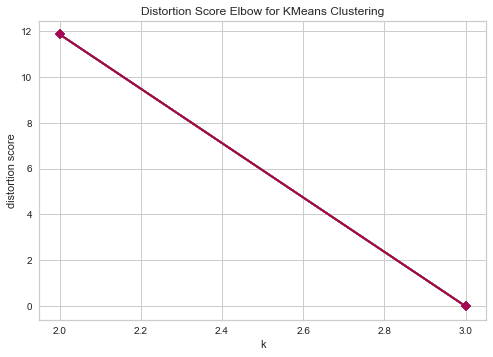

Iniciando Persistencia
Sucesso na inserção
Processando sent: 870


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

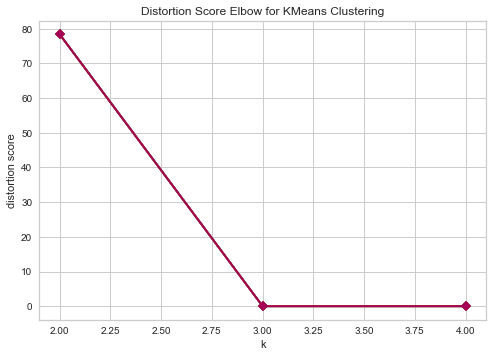

Iniciando Persistencia
Sucesso na inserção
Processando sent: 871


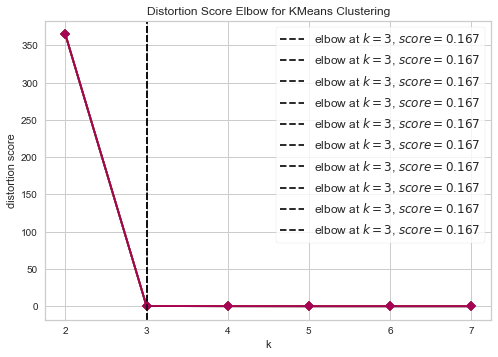

Iniciando Persistencia
Sucesso na inserção
Processando sent: 872
Iniciando Persistencia
Sucesso na inserção
Processando sent: 873


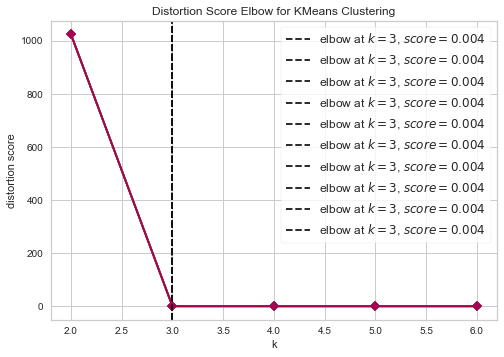

Iniciando Persistencia
Sucesso na inserção
Processando sent: 874


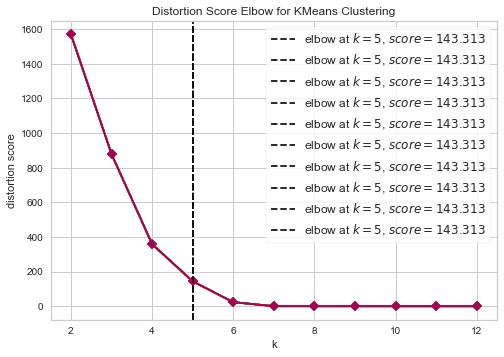

Iniciando Persistencia
Sucesso na inserção
Processando sent: 875
Iniciando Persistencia
Sucesso na inserção
Processando sent: 876


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

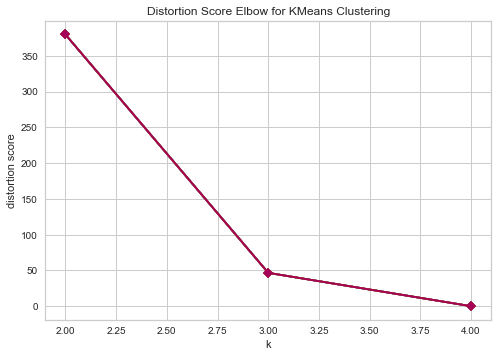

Iniciando Persistencia
Sucesso na inserção
Processando sent: 877
Iniciando Persistencia
Sucesso na inserção
Processando sent: 878
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 879
Iniciando Persistencia
Sucesso na inserção
Processando sent: 880


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

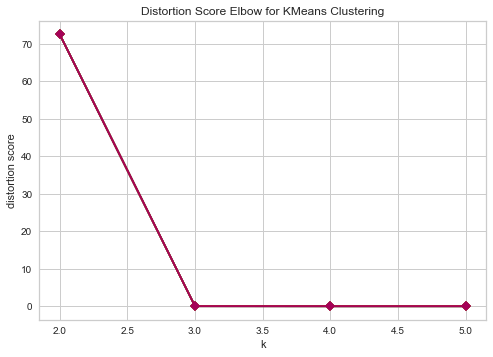

Iniciando Persistencia
Sucesso na inserção
Processando sent: 881
Iniciando Persistencia
Sucesso na inserção
Processando sent: 882


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

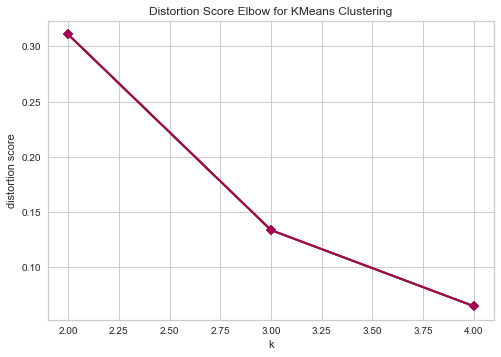

Iniciando Persistencia
Sucesso na inserção
Processando sent: 883


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

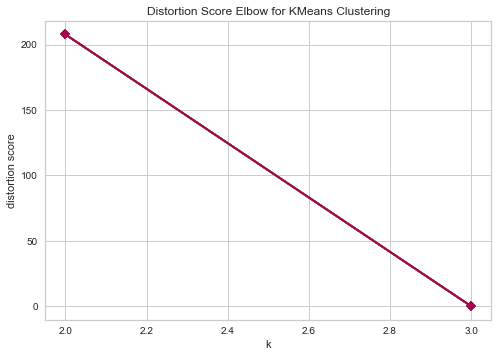

Iniciando Persistencia
Sucesso na inserção
Processando sent: 884


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

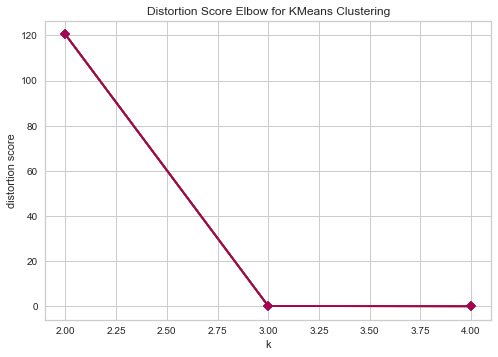

Iniciando Persistencia
Sucesso na inserção
Processando sent: 885
Iniciando Persistencia
Sucesso na inserção
Processando sent: 886


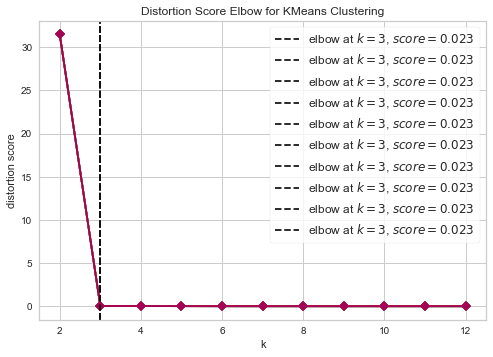

Iniciando Persistencia
Sucesso na inserção
Processando sent: 887


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

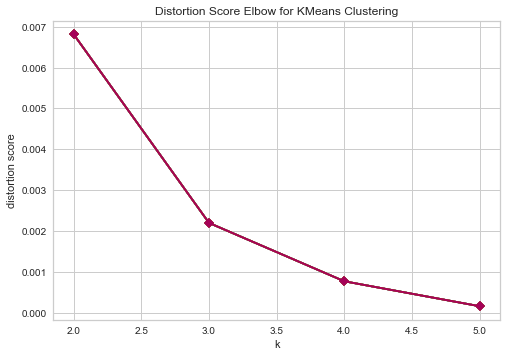

Iniciando Persistencia
Sucesso na inserção
Processando sent: 888


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

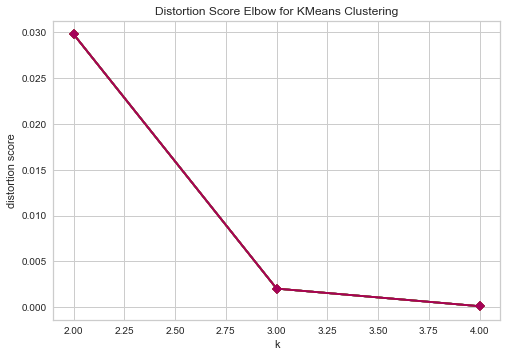

Iniciando Persistencia
Sucesso na inserção
Processando sent: 889


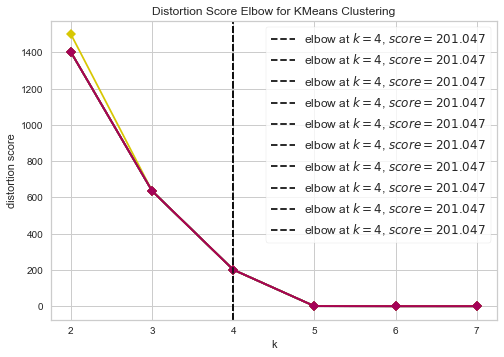

Iniciando Persistencia
Sucesso na inserção
Processando sent: 890


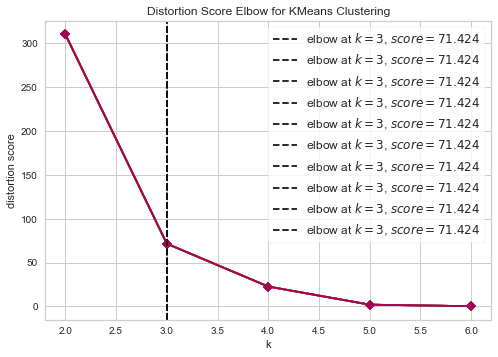

Iniciando Persistencia
Sucesso na inserção
Processando sent: 891


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

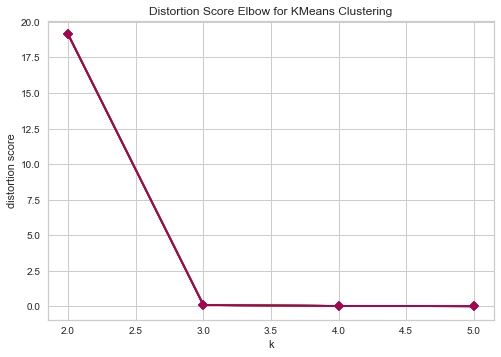

Iniciando Persistencia
Sucesso na inserção
Processando sent: 892
Iniciando Persistencia
Sucesso na inserção
Processando sent: 893
Iniciando Persistencia
Sucesso na inserção
Processando sent: 894


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

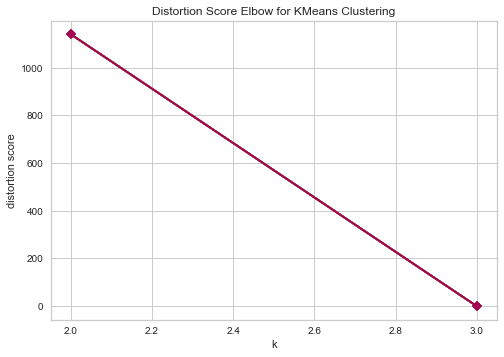

Iniciando Persistencia
Sucesso na inserção
Processando sent: 895
Iniciando Persistencia
Sucesso na inserção
Processando sent: 896
Iniciando Persistencia
Sucesso na inserção
Processando sent: 897


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

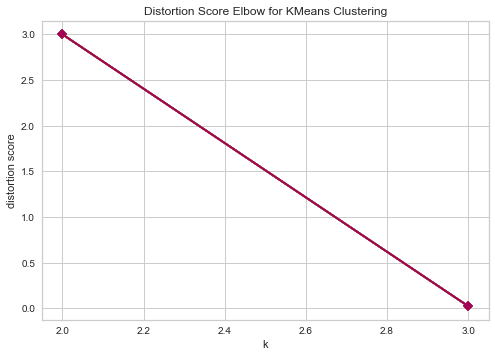

Iniciando Persistencia
Sucesso na inserção
Processando sent: 898
Iniciando Persistencia
Sucesso na inserção
Processando sent: 899
Iniciando Persistencia
Sucesso na inserção
Processando sent: 900
Iniciando Persistencia
Sucesso na inserção
Processando sent: 901


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

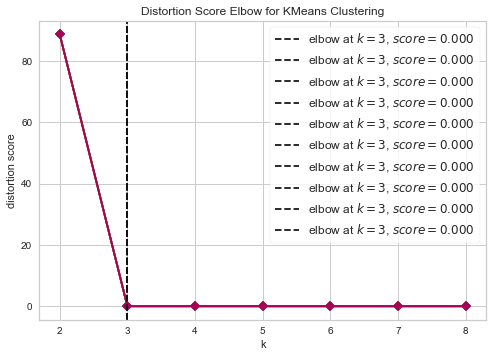

Iniciando Persistencia
Sucesso na inserção
Processando sent: 902
Iniciando Persistencia
Sucesso na inserção
Processando sent: 903
Iniciando Persistencia
Sucesso na inserção
Processando sent: 904


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

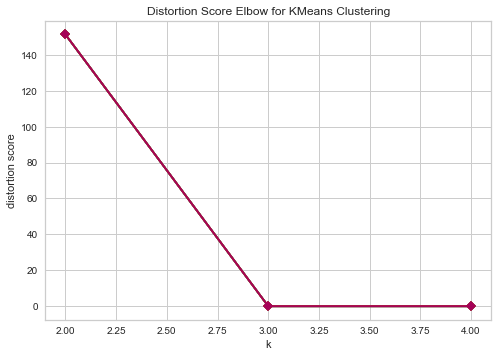

Iniciando Persistencia
Sucesso na inserção
Processando sent: 905
Iniciando Persistencia
Sucesso na inserção
Processando sent: 906
Iniciando Persistencia
Sucesso na inserção
Processando sent: 907
Iniciando Persistencia
Sucesso na inserção
Processando sent: 908


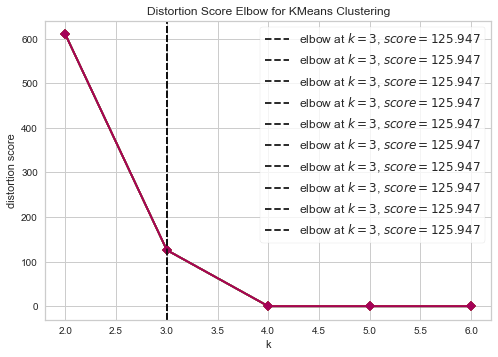

Iniciando Persistencia
Sucesso na inserção
Processando sent: 909
Iniciando Persistencia
Sucesso na inserção
Processando sent: 910


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 911
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 912
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 913
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 914


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

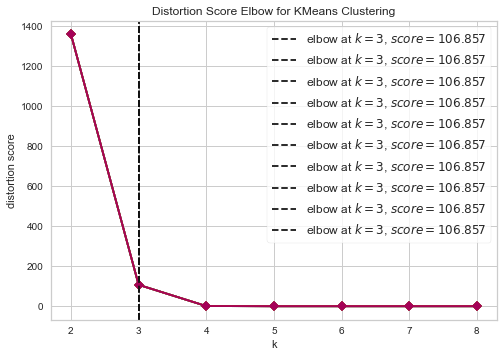

Iniciando Persistencia
Sucesso na inserção
Processando sent: 915


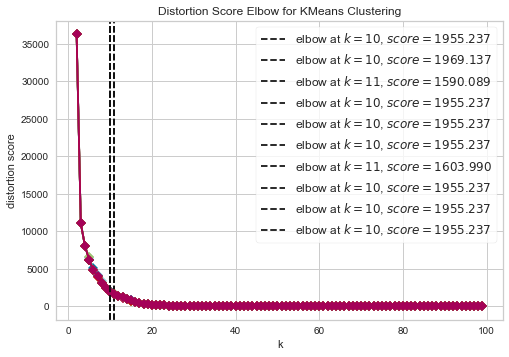

Iniciando Persistencia
Sucesso na inserção
Processando sent: 916


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

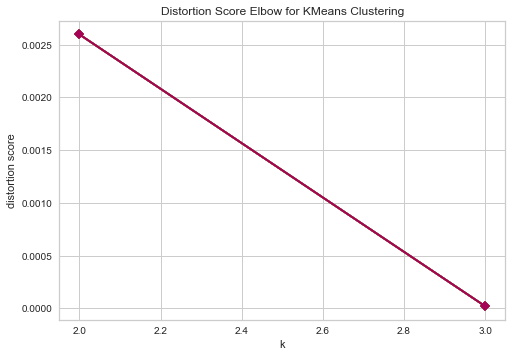

Iniciando Persistencia
Sucesso na inserção
Processando sent: 917


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

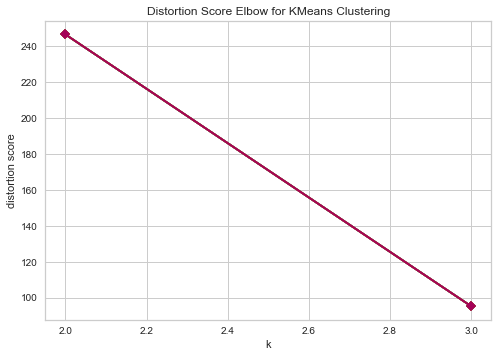

Iniciando Persistencia
Sucesso na inserção
Processando sent: 918


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (45) found smaller than n_clusters (46). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (45) found smaller than n_clusters (47). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 919


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (81) found smaller than n_clusters (82). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 920


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (25) found smaller than n_clusters (26). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 921


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (52) found smaller than n_clusters (53). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 922


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (22). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 923


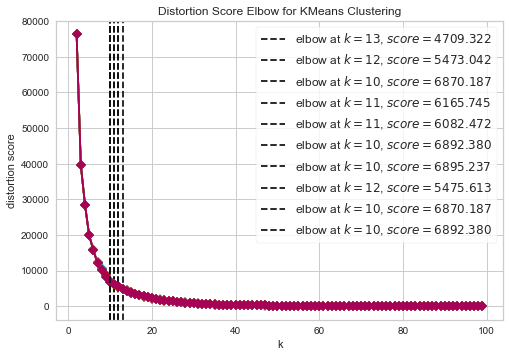

Iniciando Persistencia
Sucesso na inserção
Processando sent: 924
Iniciando Persistencia
Sucesso na inserção
Processando sent: 925


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (43) found smaller than n_clusters (44). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 926


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (47) found smaller than n_clusters (48). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (47) found smaller than n_clusters (49). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (47) found smaller than n_clusters (50). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 927


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (22). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 928


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 929


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (33). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (34). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 930


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 931
Iniciando Persistencia
Sucesso na inserção
Processando sent: 932


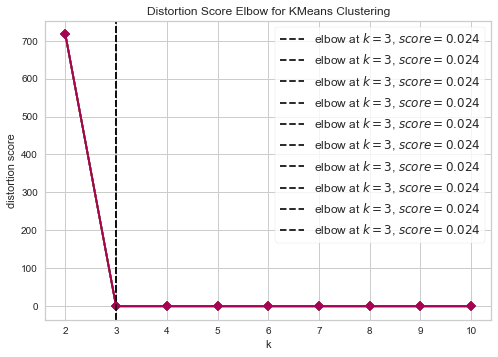

Iniciando Persistencia
Sucesso na inserção
Processando sent: 933
Iniciando Persistencia
Sucesso na inserção
Processando sent: 934
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 935
Iniciando Persistencia
Sucesso na inserção
Processando sent: 936


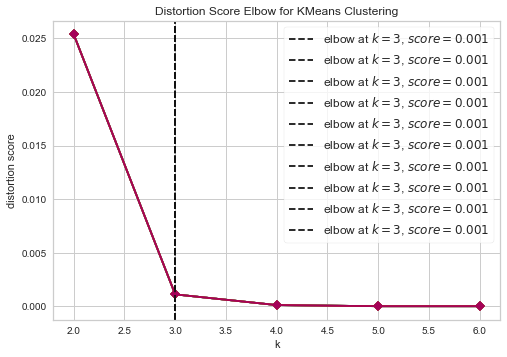

Iniciando Persistencia
Sucesso na inserção
Processando sent: 937
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 938
Iniciando Persistencia
Sucesso na inserção
Processando sent: 939
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 940
Iniciando Persistencia
Sucesso na inserção
Processando sent: 941


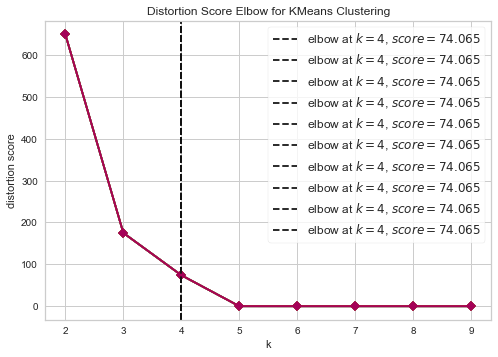

Iniciando Persistencia
Sucesso na inserção
Processando sent: 942


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

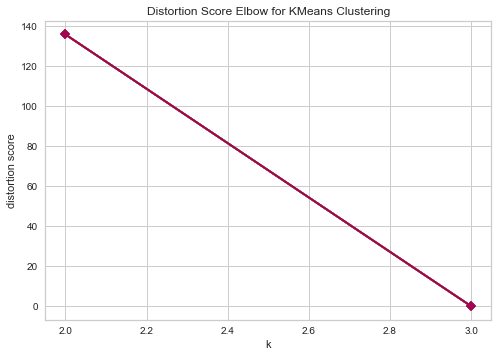

Iniciando Persistencia
Sucesso na inserção
Processando sent: 943
Iniciando Persistencia
Sucesso na inserção
Processando sent: 944


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

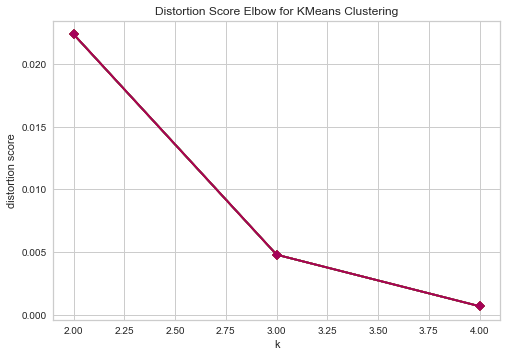

Iniciando Persistencia
Sucesso na inserção
Processando sent: 945
Iniciando Persistencia
Sucesso na inserção
Processando sent: 946
Iniciando Persistencia
Sucesso na inserção
Processando sent: 947
Iniciando Persistencia
Sucesso na inserção
Processando sent: 948


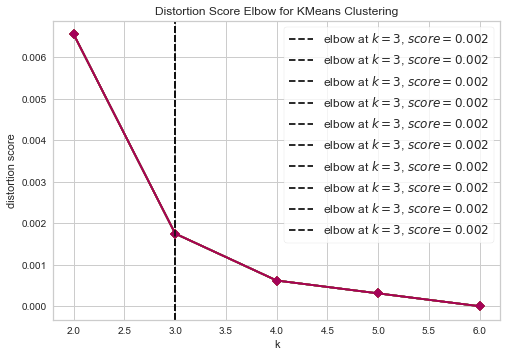

Iniciando Persistencia
Sucesso na inserção
Processando sent: 949


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

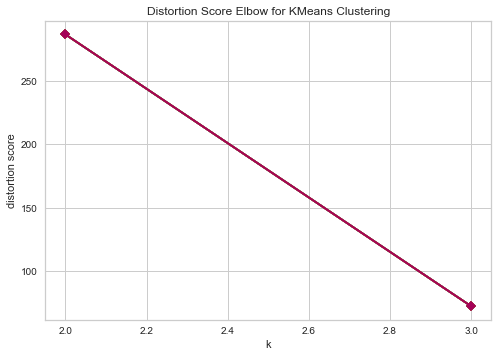

Iniciando Persistencia
Sucesso na inserção
Processando sent: 950
Iniciando Persistencia
Sucesso na inserção
Processando sent: 951


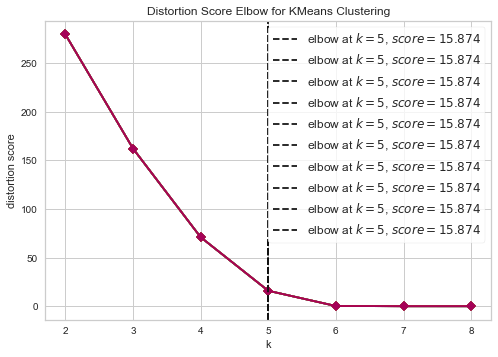

Iniciando Persistencia
Sucesso na inserção
Processando sent: 952


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

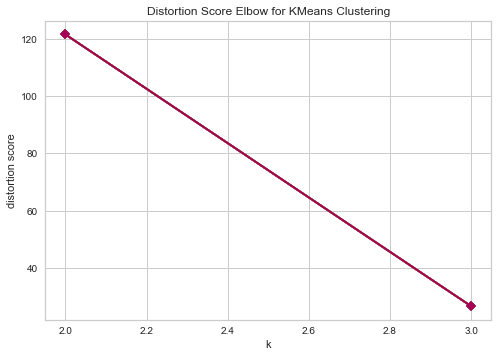

Iniciando Persistencia
Sucesso na inserção
Processando sent: 953


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

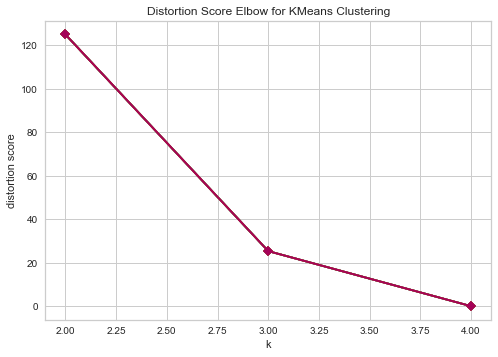

Iniciando Persistencia
Sucesso na inserção
Processando sent: 954
Iniciando Persistencia
Sucesso na inserção
Processando sent: 955


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

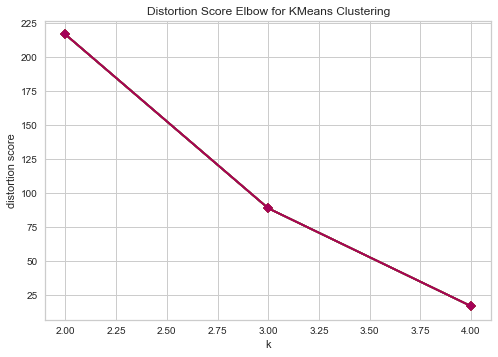

Iniciando Persistencia
Sucesso na inserção
Processando sent: 956
Iniciando Persistencia
Sucesso na inserção
Processando sent: 957
Iniciando Persistencia
Sucesso na inserção
Processando sent: 958


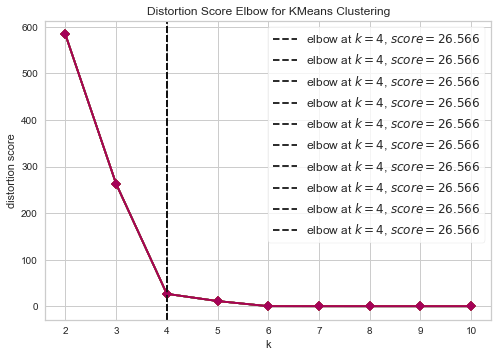

Iniciando Persistencia
Sucesso na inserção
Processando sent: 959


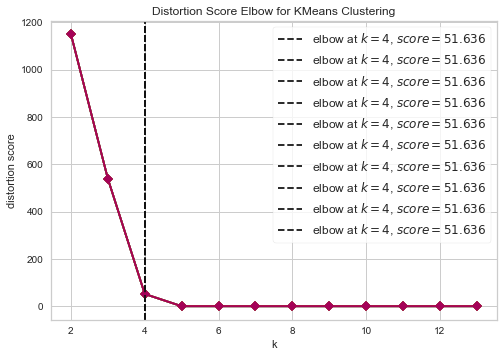

Iniciando Persistencia
Sucesso na inserção
Processando sent: 960
Iniciando Persistencia
Sucesso na inserção
Processando sent: 961


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

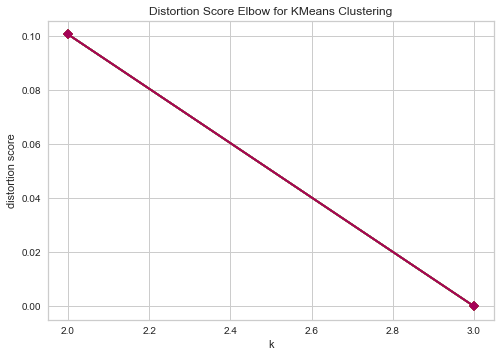

Iniciando Persistencia
Sucesso na inserção
Processando sent: 962
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 963
Iniciando Persistencia
Sucesso na inserção
Processando sent: 964
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 965


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

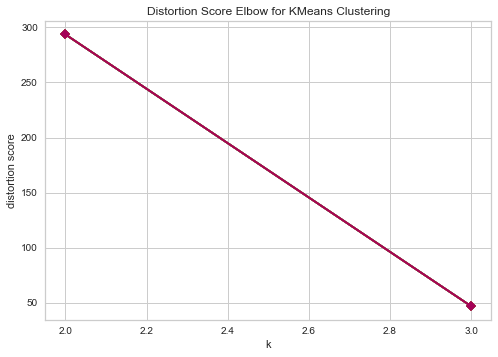

Iniciando Persistencia
Sucesso na inserção
Processando sent: 966
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 967


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 968


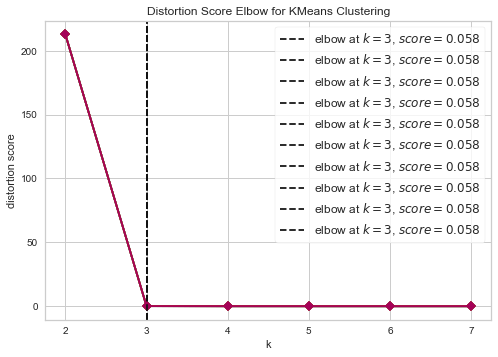

Iniciando Persistencia
Sucesso na inserção
Processando sent: 969


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 970


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (26) found smaller than n_clusters (27). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 971
Iniciando Persistencia
Sucesso na inserção
Processando sent: 972
Iniciando Persistencia
Sucesso na inserção
Processando sent: 973


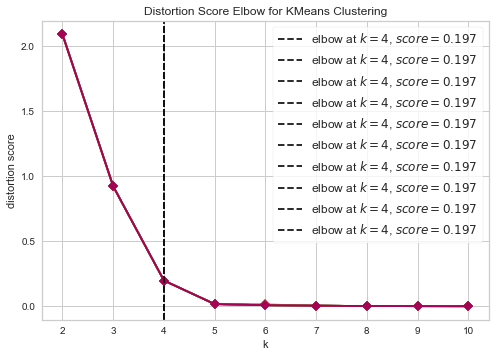

Iniciando Persistencia
Sucesso na inserção
Processando sent: 974


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

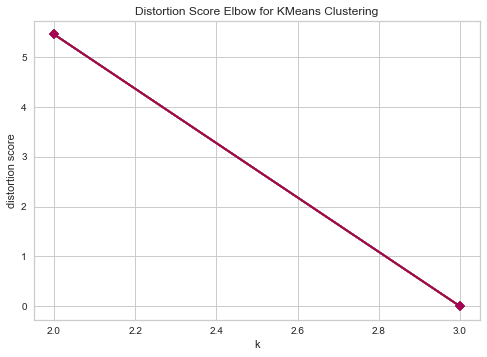

Iniciando Persistencia
Sucesso na inserção
Processando sent: 975


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 976


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

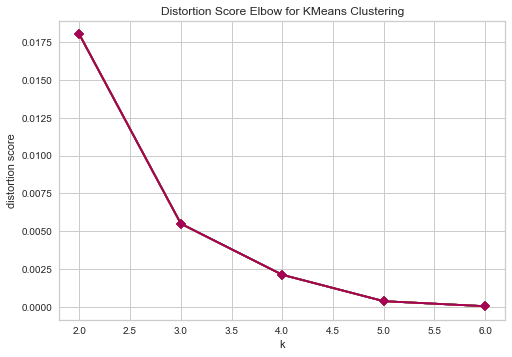

Iniciando Persistencia
Sucesso na inserção
Processando sent: 977


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (29) found smaller than n_clusters (30). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (29) found smaller than n_clusters (31). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 978


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

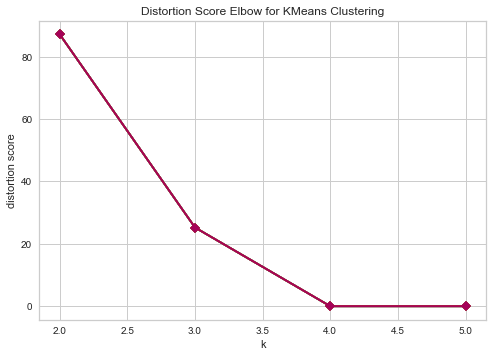

Iniciando Persistencia
Sucesso na inserção
Processando sent: 979
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 980


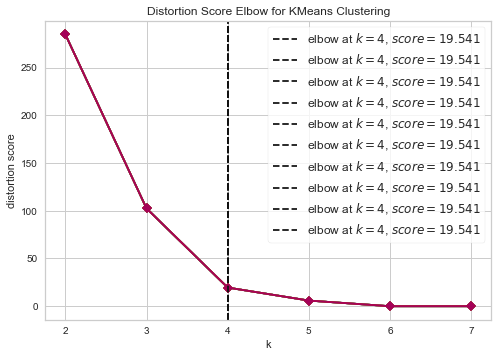

Iniciando Persistencia
Sucesso na inserção
Processando sent: 981


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (39) found smaller than n_clusters (40). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (39) found smaller than n_clusters (41). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 982


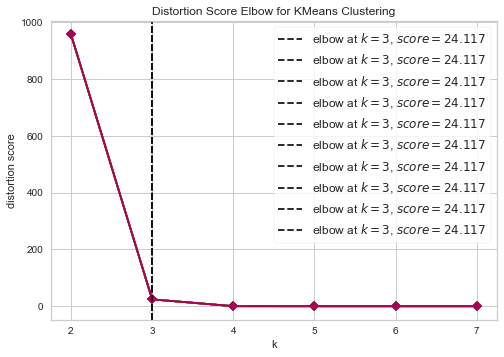

Iniciando Persistencia
Sucesso na inserção
Processando sent: 983


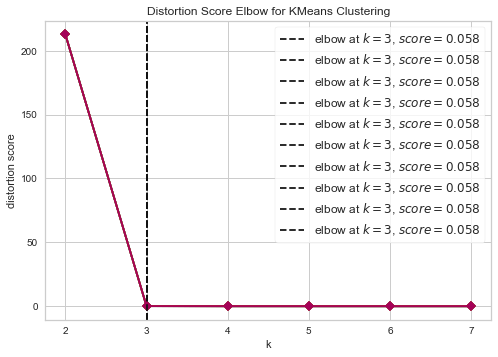

Iniciando Persistencia
Sucesso na inserção
Processando sent: 984


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X

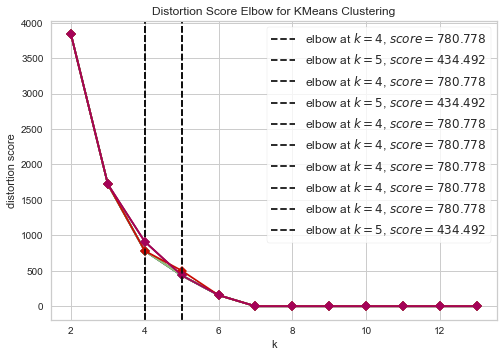

Iniciando Persistencia
Sucesso na inserção
Processando sent: 985


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (26) found smaller than n_clusters (27). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (26) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 986
Iniciando Persistencia
Sucesso na inserção
Processando sent: 987
Iniciando Persistencia
Sucesso na inserção
Processando sent: 988


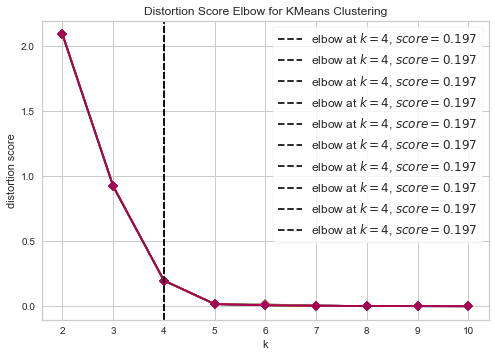

Iniciando Persistencia
Sucesso na inserção
Processando sent: 989


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

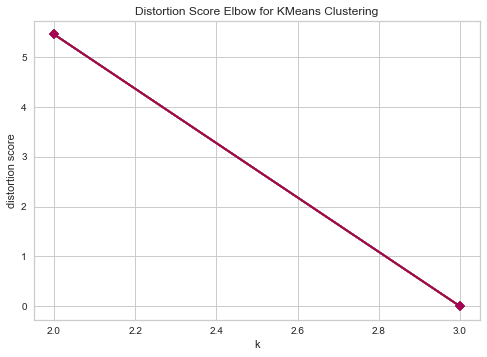

Iniciando Persistencia
Sucesso na inserção
Processando sent: 990


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 991


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.

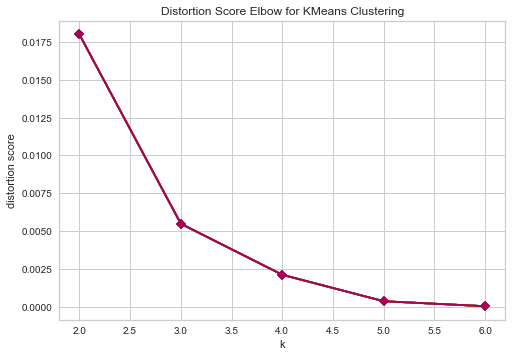

Iniciando Persistencia
Sucesso na inserção
Processando sent: 992


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (33). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (34). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (35). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 993


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message,

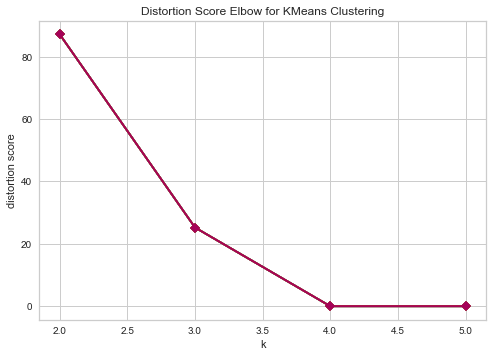

Iniciando Persistencia
Sucesso na inserção
Processando sent: 994
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 995


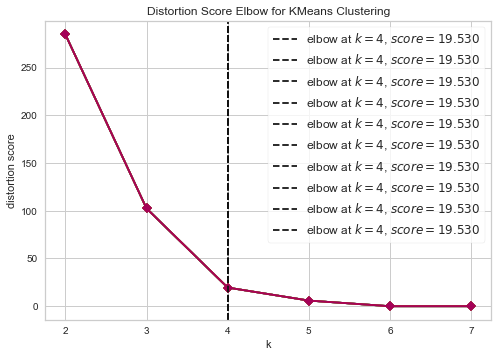

Iniciando Persistencia
Sucesso na inserção
Processando sent: 996


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (39) found smaller than n_clusters (40). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (39) found smaller than n_clusters (41). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 997


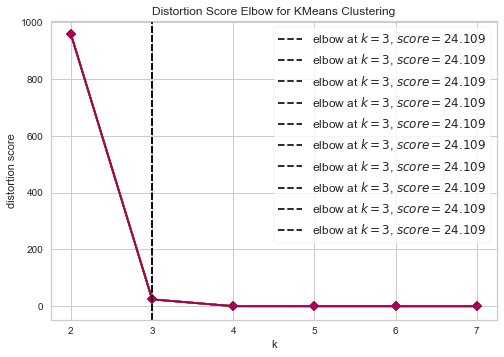

Iniciando Persistencia
Sucesso na inserção
Processando sent: 998


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (52) found smaller than n_clusters (53). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 999


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (74) found smaller than n_clusters (75). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (74) found smaller than n_clusters (76). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1000


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1001


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (75) found smaller than n_clusters (76). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (75) found smaller than n_clusters (77). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1002


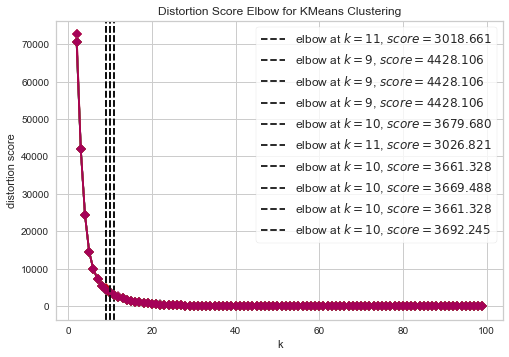

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1003


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (48) found smaller than n_clusters (49). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (48) found smaller than n_clusters (50). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1004


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (49) found smaller than n_clusters (50). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1005


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (33). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (34). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1006


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1007


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being 

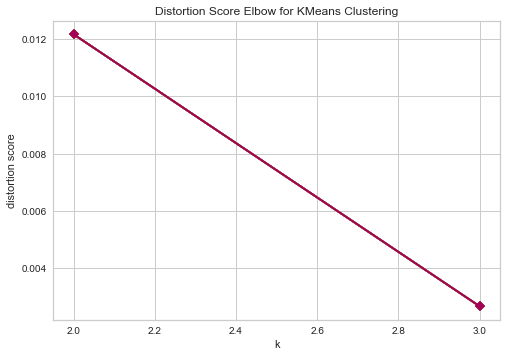

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1008


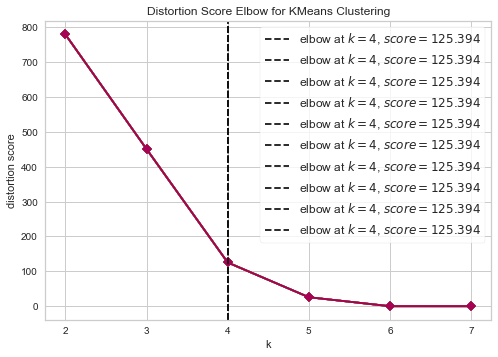

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1009


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

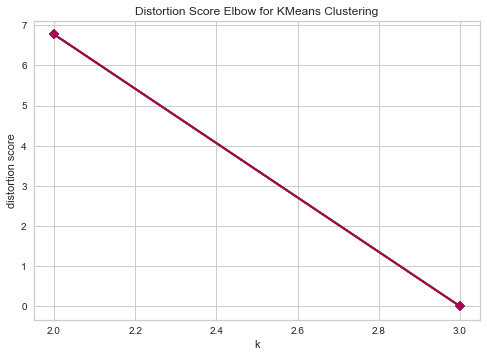

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1010
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1011


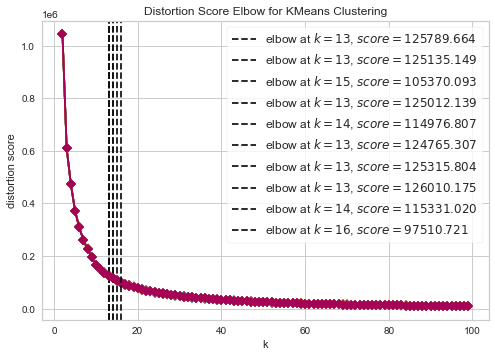

Iniciando Persistencia
Infelizmente algo deu errado na inserção (persistir_uma_linha)
(2013, 'Lost connection to MySQL server during query ([WinError 10060] Uma tentativa de conexão falhou porque o componente conectado não respondeu\r\ncorretamente após um período de tempo ou a conexão estabelecida falhou\r\nporque o host conectado não respondeu)')
DEU BOOO
Processando sent: 1012


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

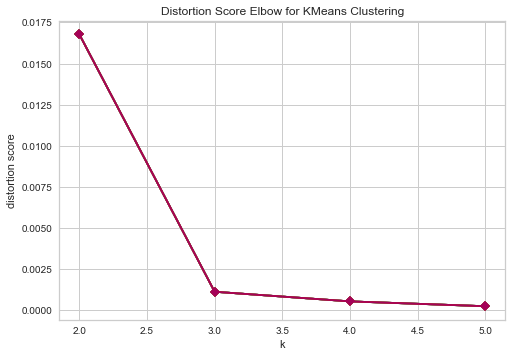

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1013


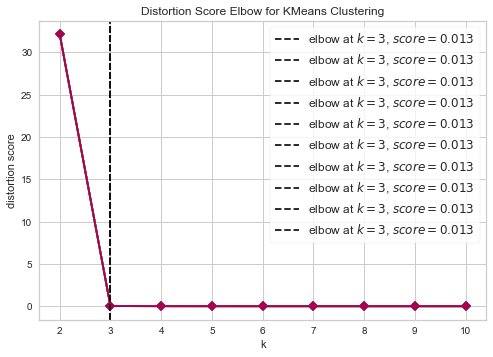

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1014


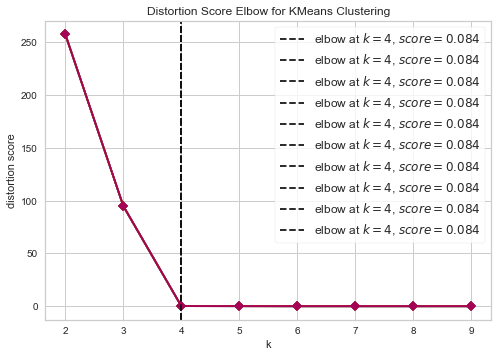

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1015
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1016
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1017
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1018


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

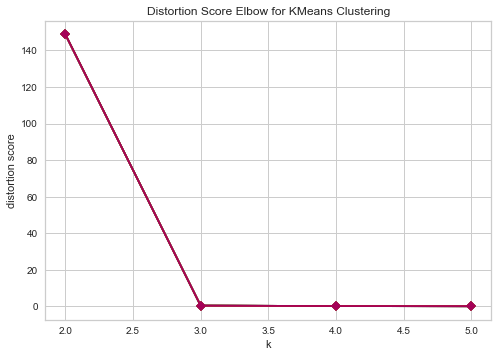

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1019


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

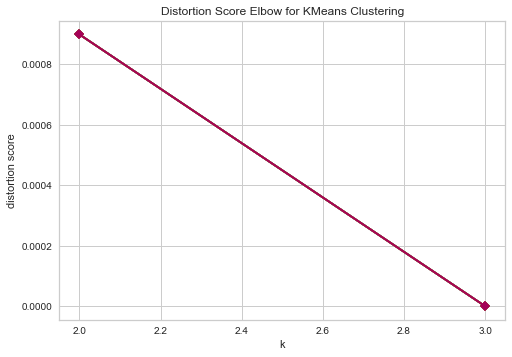

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1020


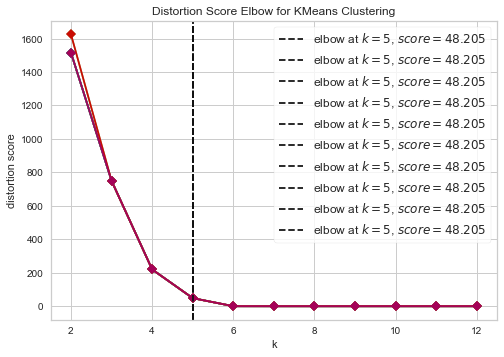

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1021


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

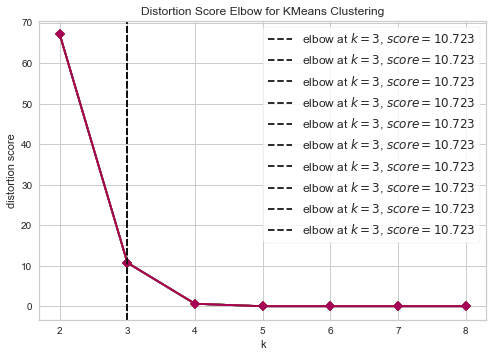

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1022
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1023


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

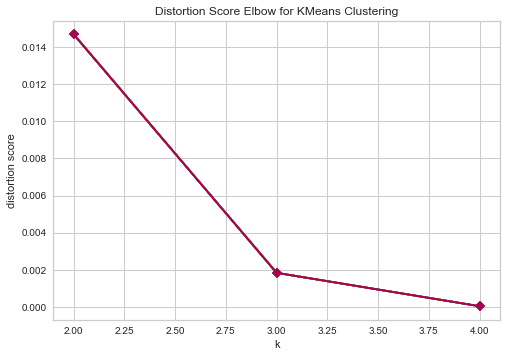

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1024


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

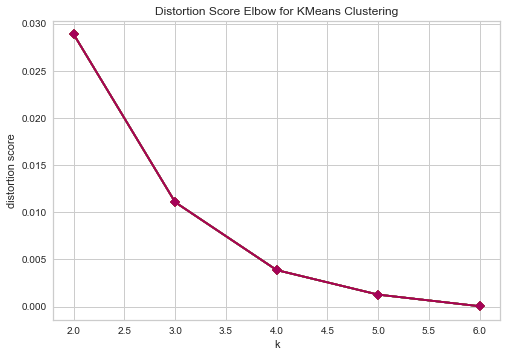

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1025
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1026
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1027
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1028
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1029
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1030


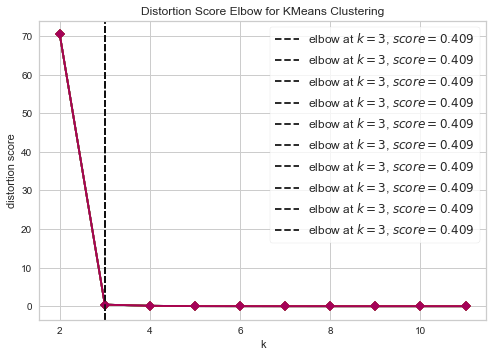

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1031
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1032


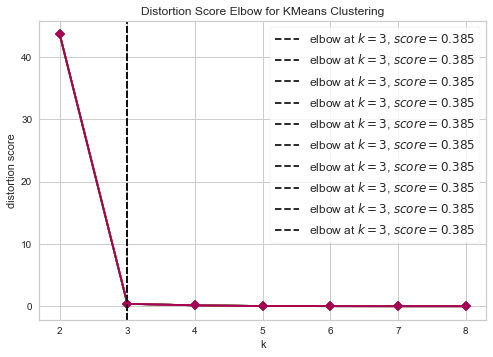

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1033
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1034
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1035
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1036


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

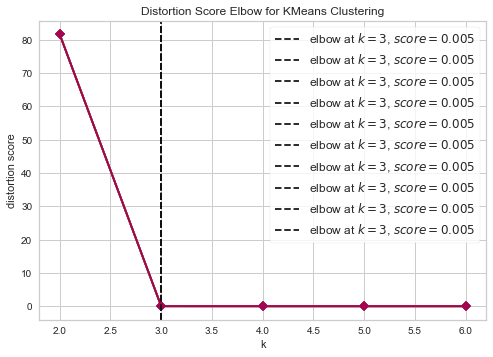

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1037
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1038


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

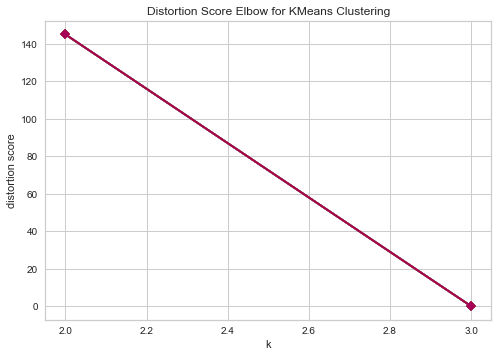

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1039
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1040
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1041


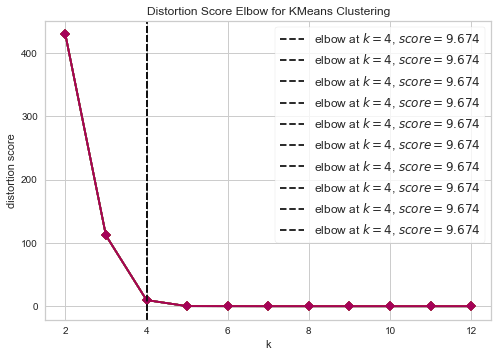

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1042
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1043
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1044


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

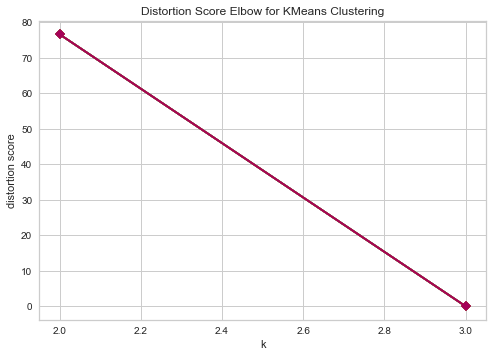

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1045


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1046
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1047


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

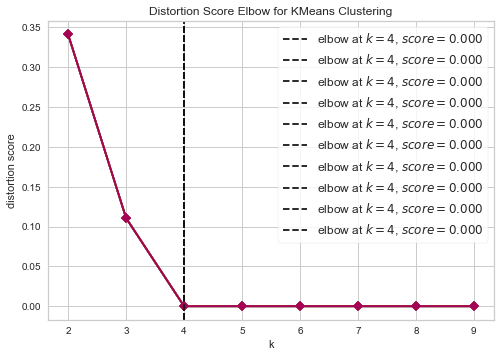

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1048
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1049


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

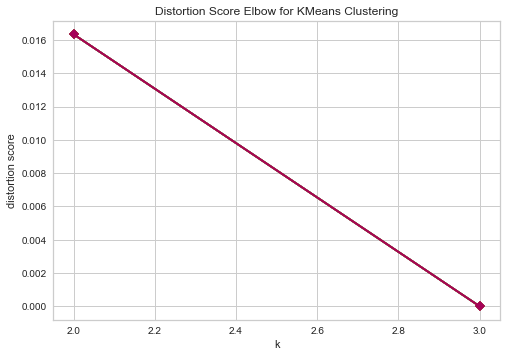

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1050
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1051


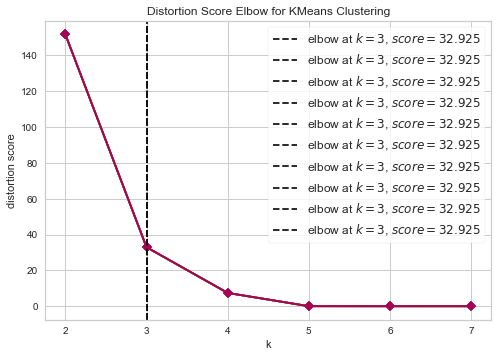

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1052


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1053
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1054
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1055


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: R

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1056


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (28) found smaller than n_clusters (29). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (28) found smaller than n_clusters (30). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1057


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

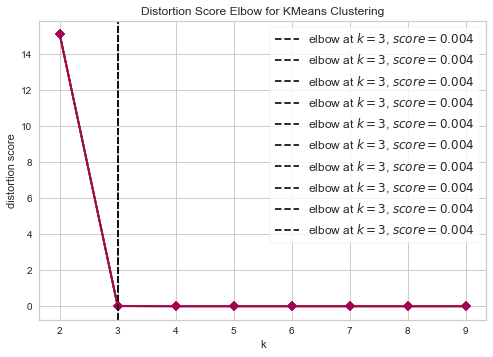

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1058
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1059
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1060
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1061
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1062
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1063
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1064


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

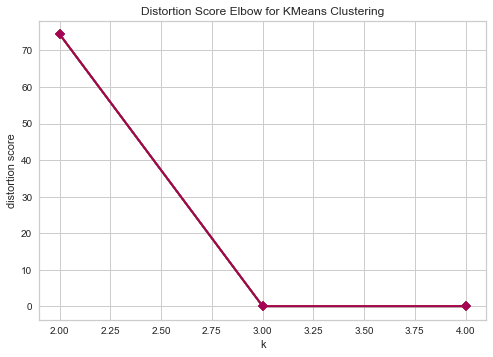

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1065
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1066


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (47) found smaller than n_clusters (48). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1067


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (29). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1068


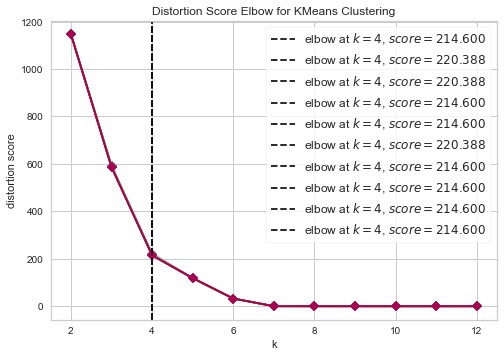

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1069


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (26) found smaller than n_clusters (27). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1070


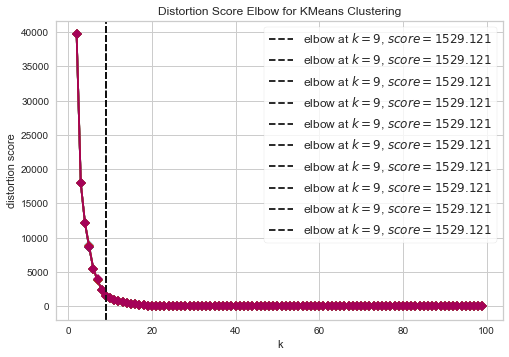

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1071


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (49) found smaller than n_clusters (50). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (49) found smaller than n_clusters (51). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1072


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.

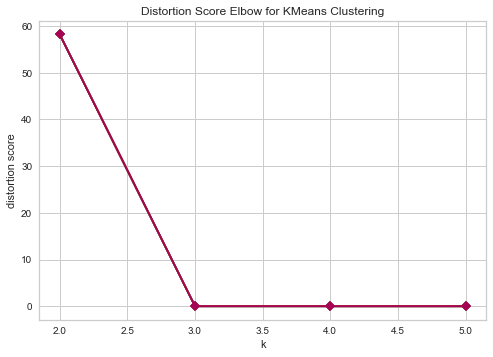

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1073


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1074
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1075


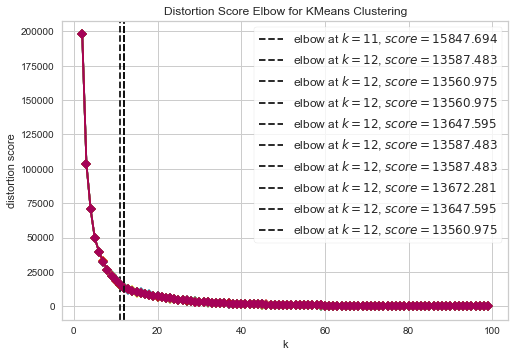

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1076
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1077
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1078


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1079


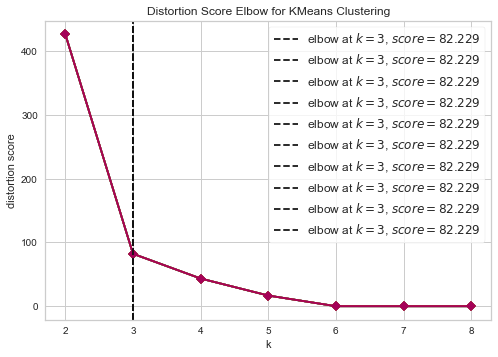

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1080


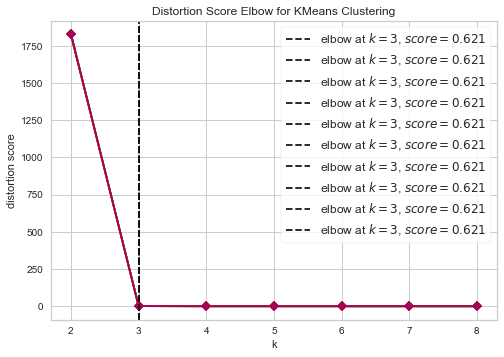

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1081
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1082
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1083


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

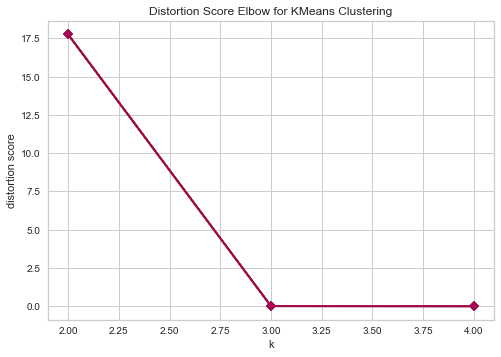

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1084
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1085


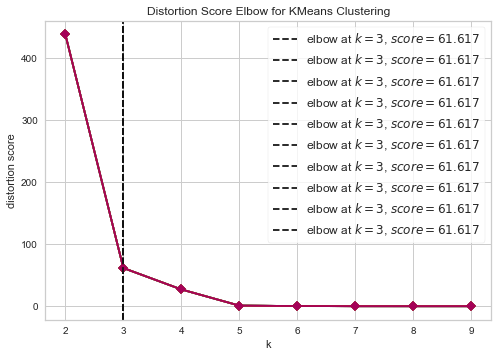

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1086
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1087


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

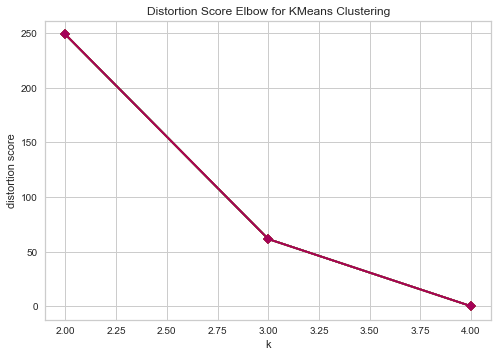

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1088
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1089
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1090
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1091
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1092


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1093
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1094
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1095
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1096


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1097


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1098
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1099


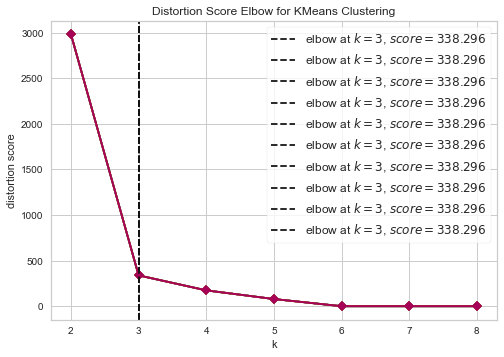

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1100


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

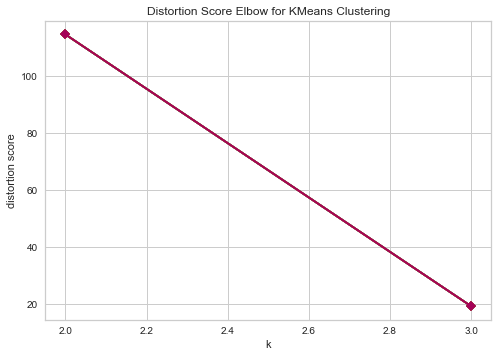

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1101
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1102


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (82) found smaller than n_clusters (83). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (82) found smaller than n_clusters (84). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1103


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

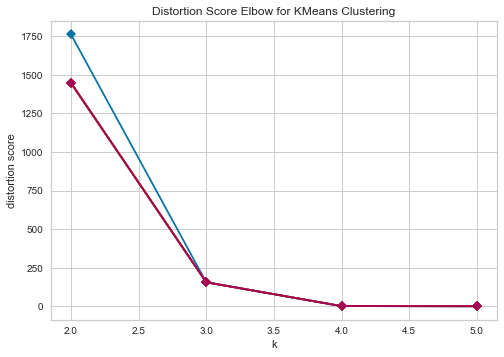

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1104


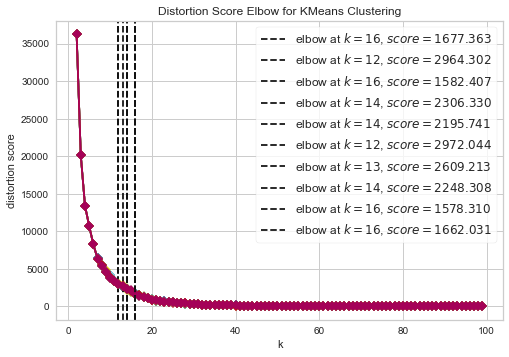

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1105
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1106


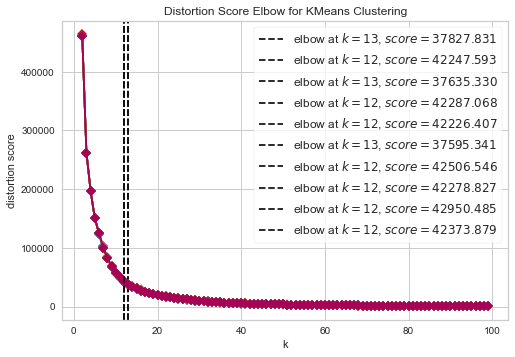

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1107


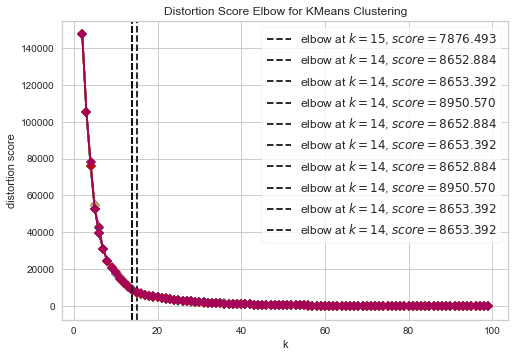

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1108
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1109


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1110


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (37) found smaller than n_clusters (38). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (37) found smaller than n_clusters (39). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (37) found smaller than n_clusters (40). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (37) found smaller than n_clusters (41). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1111


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (48) found smaller than n_clusters (49). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (48) found smaller than n_clusters (50). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1112


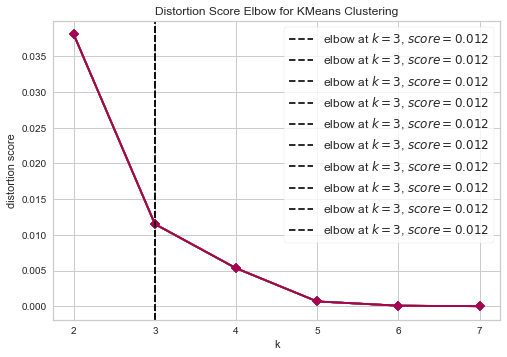

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1113
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1114


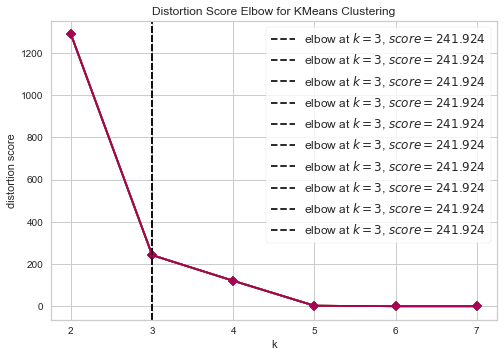

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1115


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1116


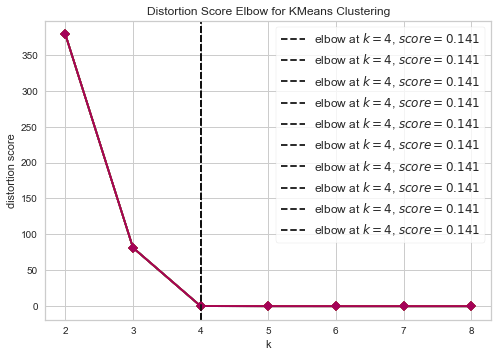

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1117


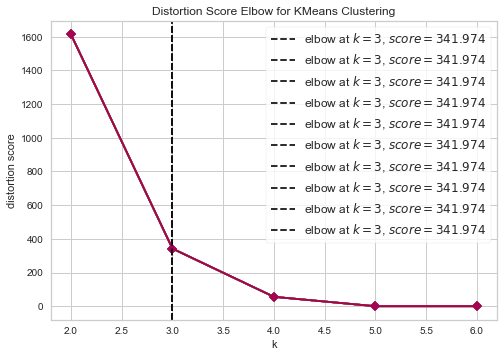

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1118


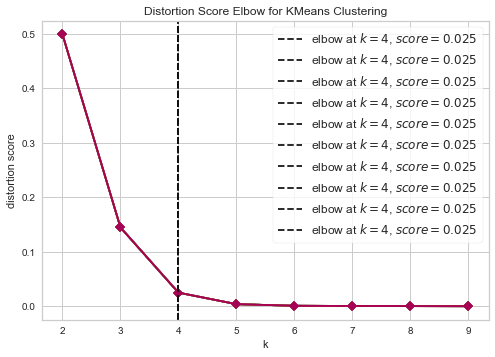

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1119
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1120
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1121
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1122


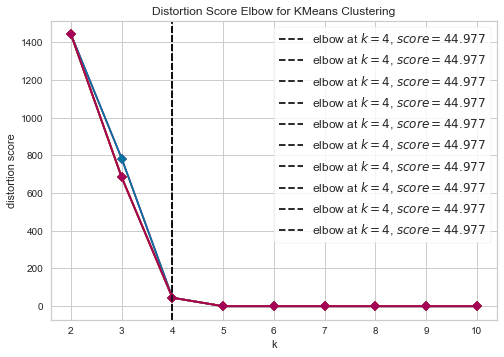

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1123


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

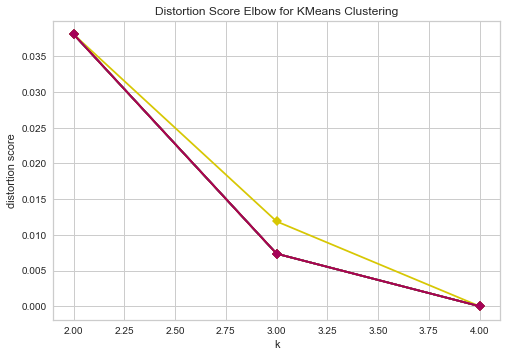

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1124


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

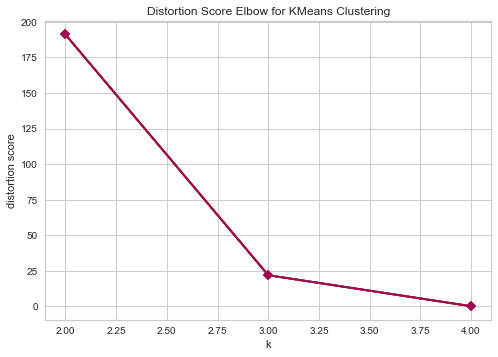

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1125
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1126


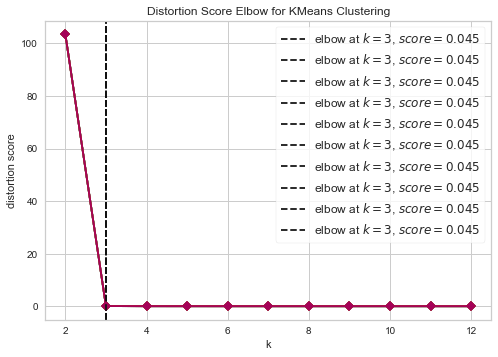

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1127
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1128
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1129


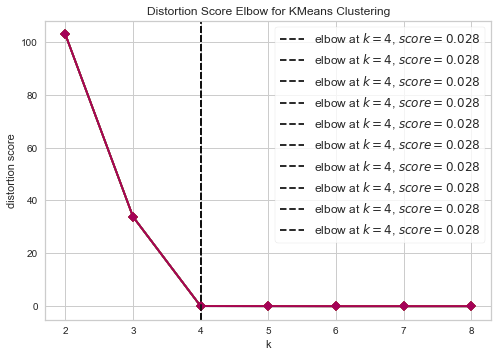

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1130
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1131


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1132


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (70) found smaller than n_clusters (71). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (70) found smaller than n_clusters (72). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1133


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (29). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1134


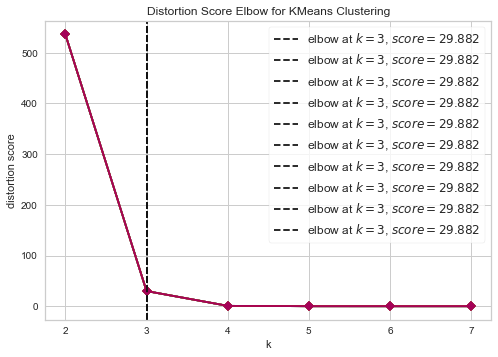

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1135


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1136


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

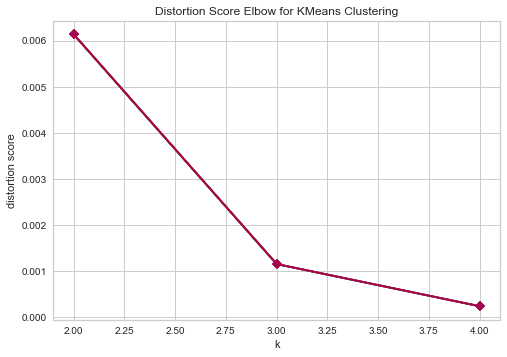

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1137


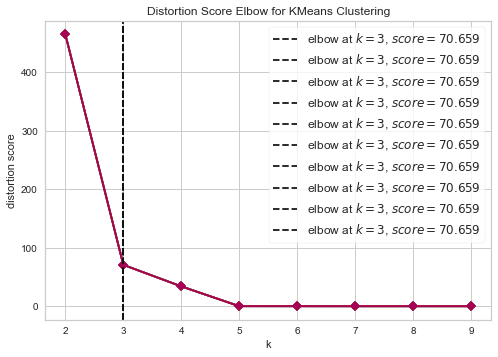

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1138


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

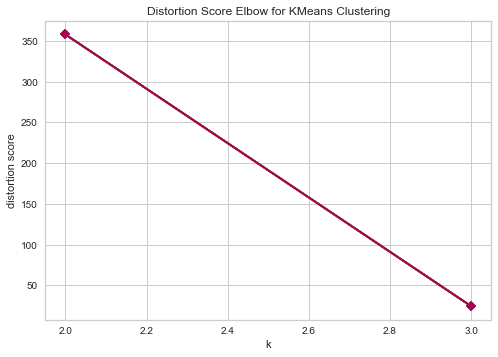

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1139
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1140


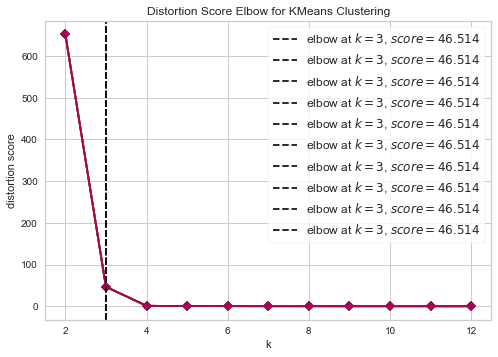

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1141


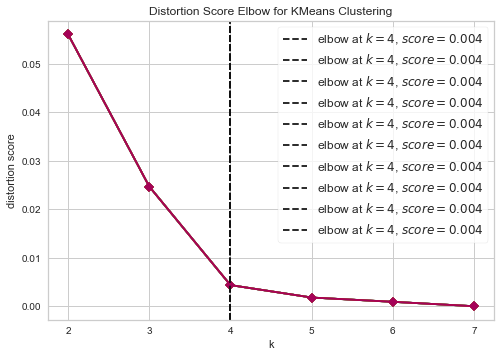

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1142


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (47) found smaller than n_clusters (48). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (47) found smaller than n_clusters (49). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1143


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1144


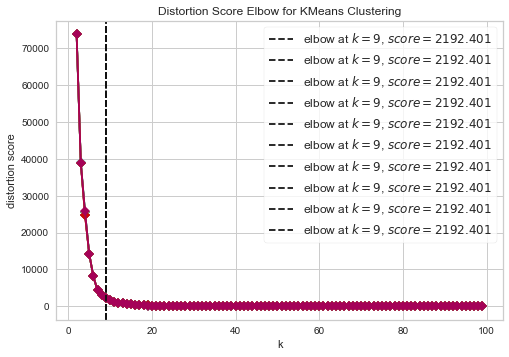

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1145


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (83) found smaller than n_clusters (84). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (83) found smaller than n_clusters (85). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1146
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1147


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X

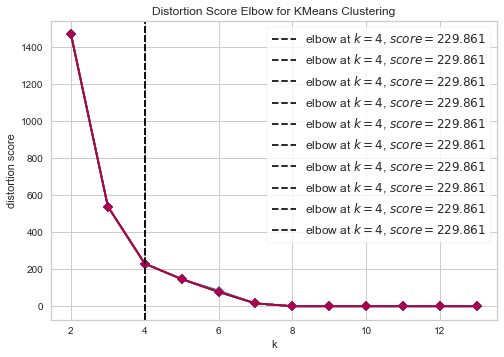

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1148


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

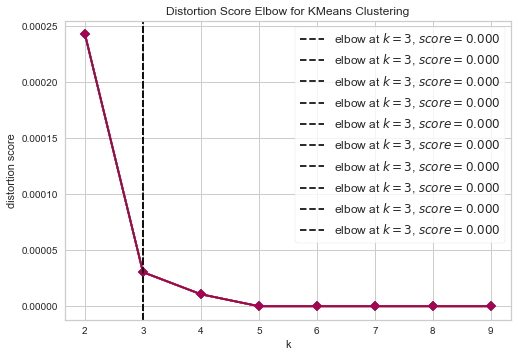

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1149


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

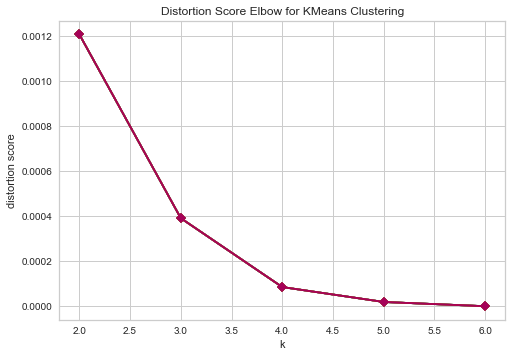

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1150
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1151
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1152
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1153
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1154


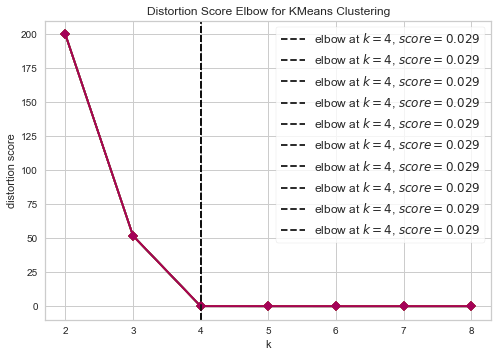

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1155
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1156
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1157


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

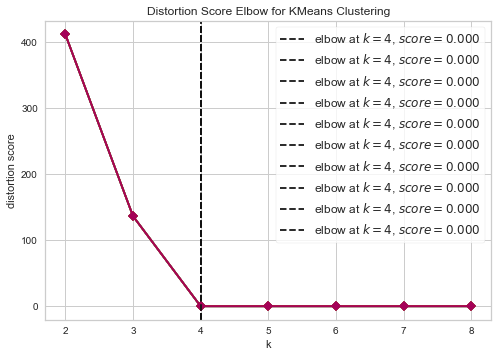

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1158
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1159
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1160


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

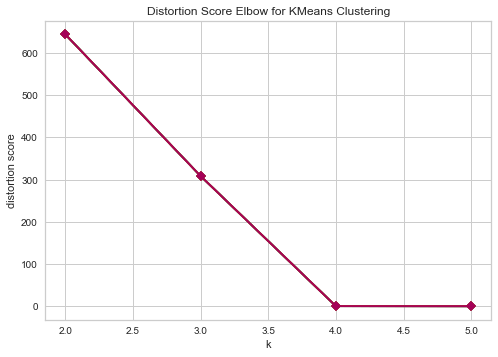

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1161
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1162
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1163


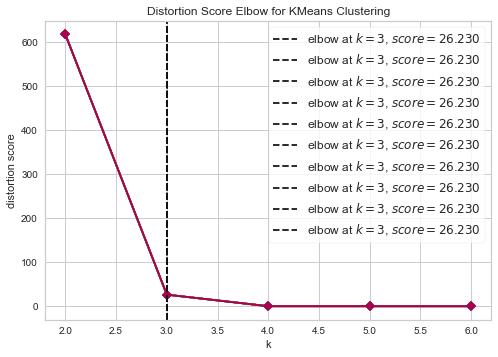

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1164
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1165


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

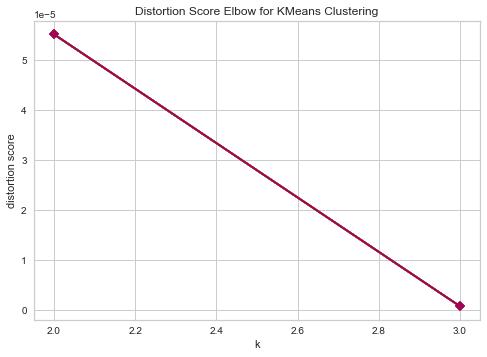

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1166
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1167


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

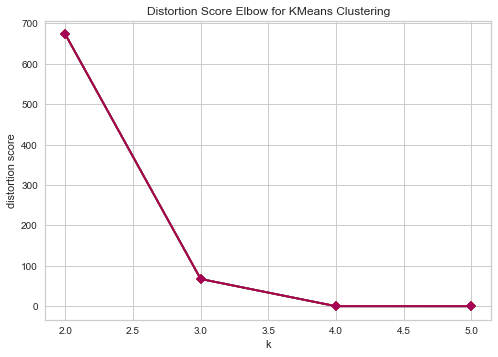

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1168


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1169
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1170
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1171


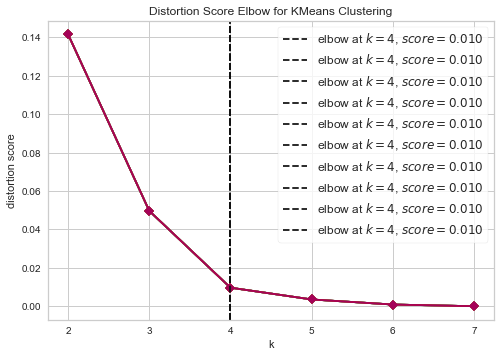

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1172


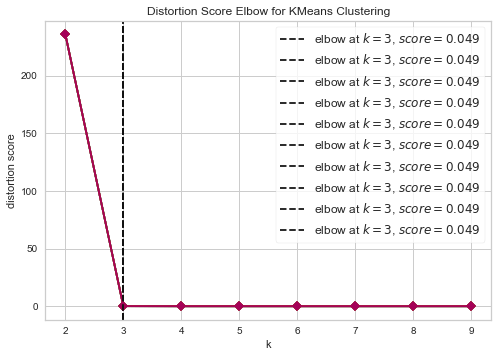

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1173


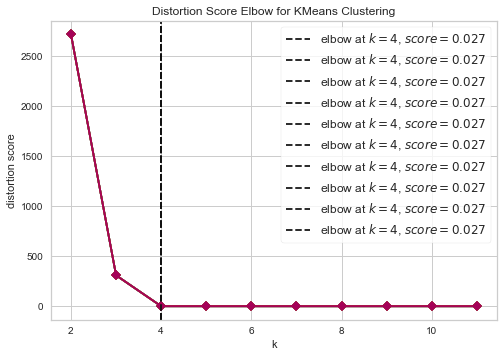

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1174
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1175
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1176
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1177
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1178
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1179


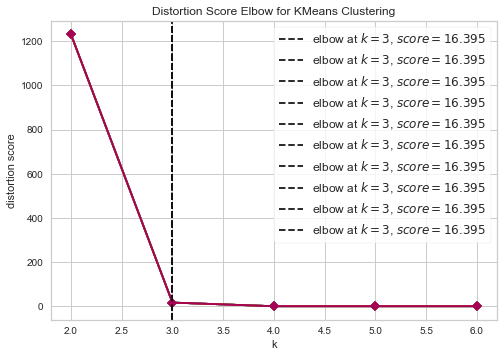

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1180
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1181
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1182


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

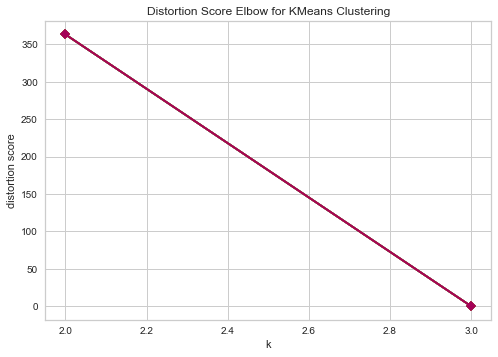

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1183


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (39) found smaller than n_clusters (40). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1184
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1185

C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)


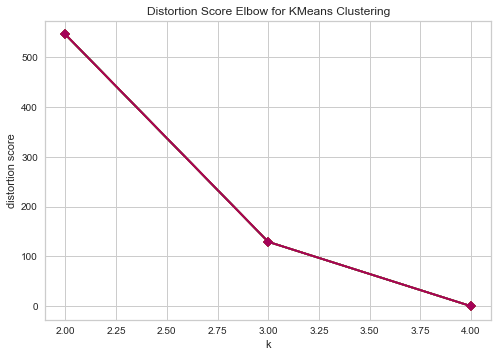

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1186
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1187
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1188


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

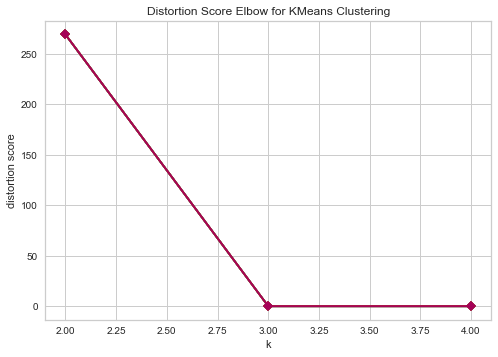

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1189


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

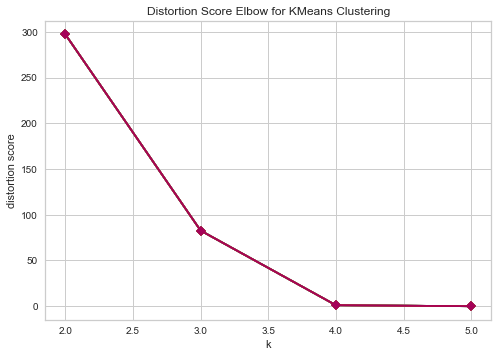

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1190
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1191
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1192


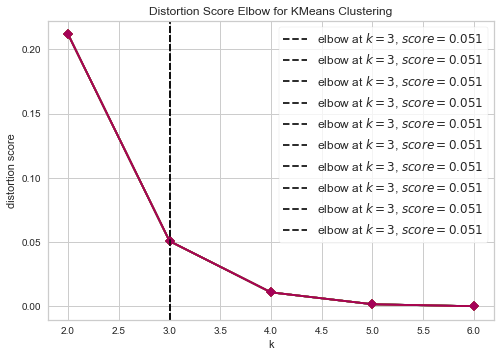

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1193


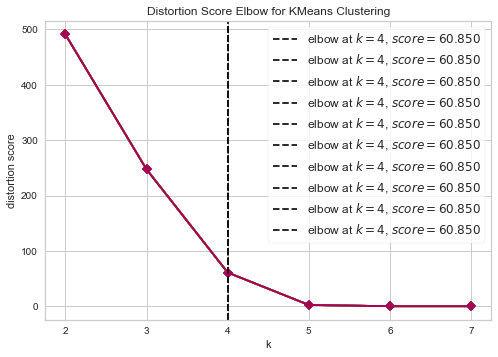

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1194


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1195
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1196


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1197


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (33). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1198
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1199
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1200


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

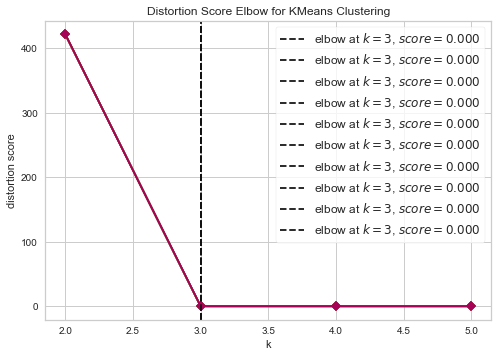

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1201


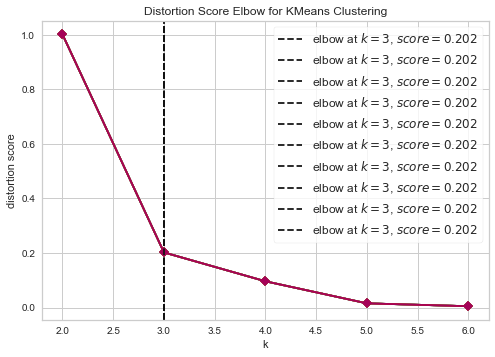

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1202
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1203
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1204
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1205


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

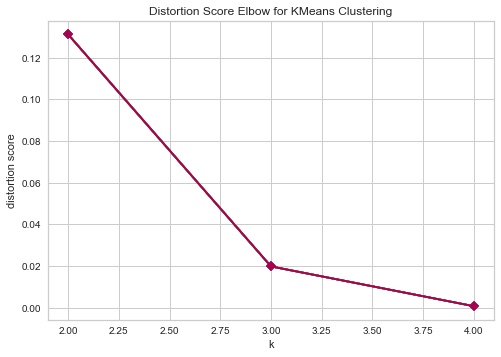

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1206
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1207


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

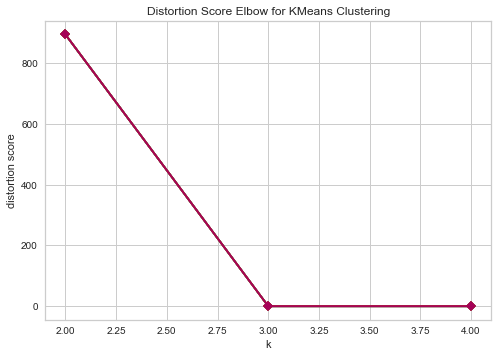

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1208
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1209


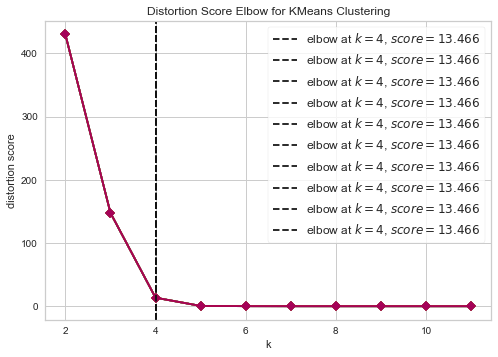

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1210
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1211


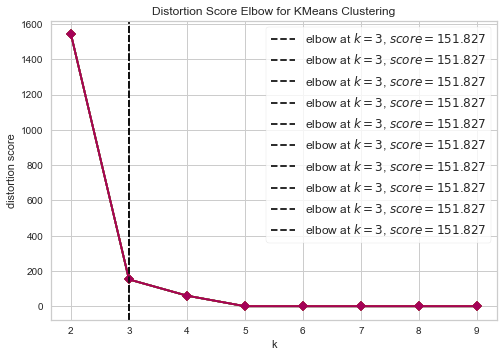

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1212


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

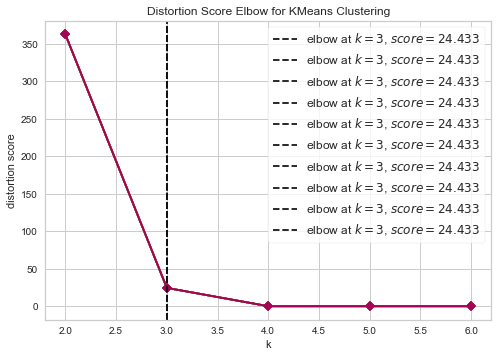

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1213


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1214


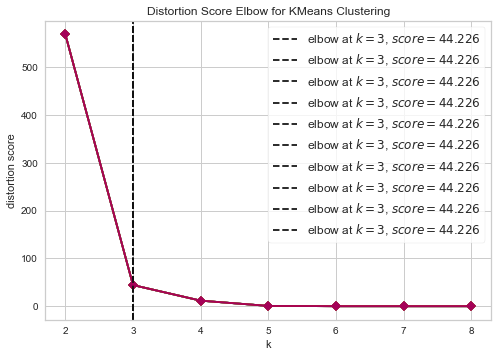

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1215


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1216


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.

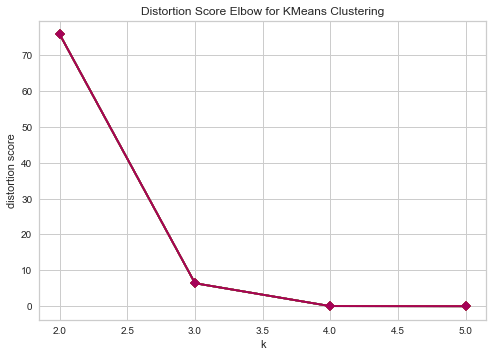

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1217


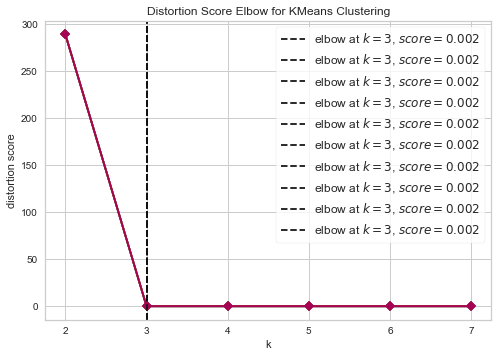

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1218
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1219
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1220


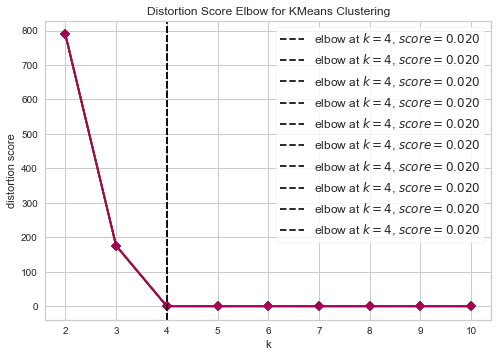

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1221
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1222


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (22). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (23). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1223
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1224


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

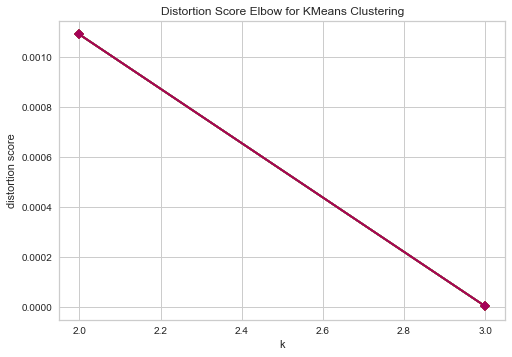

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1225


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1226
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1227
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1228


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kw

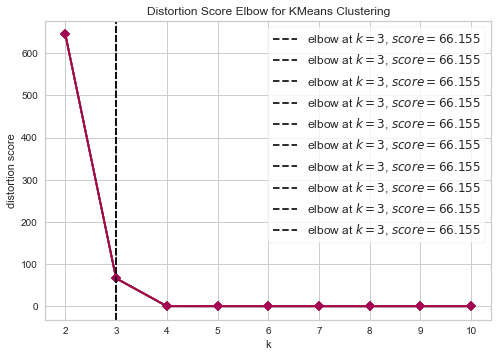

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1229


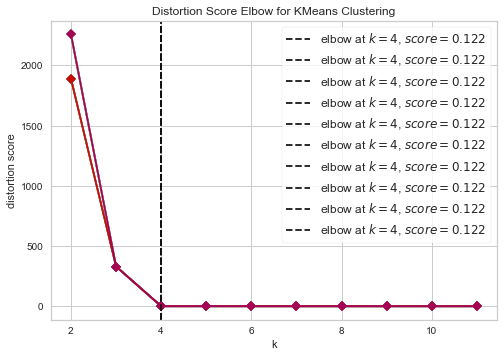

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1230


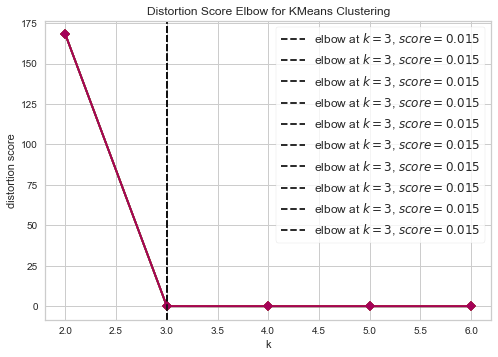

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1231
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1232


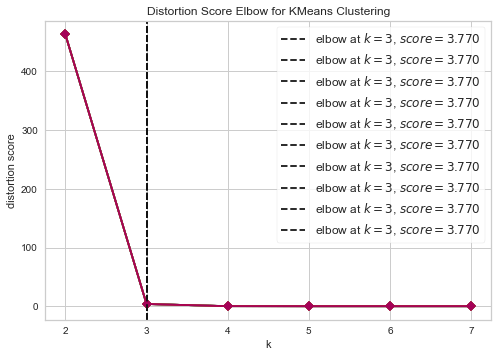

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1233


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (17) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1234
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1235


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

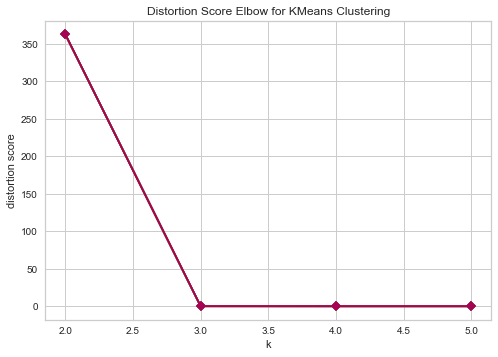

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1236
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1237
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1238


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (19). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (18) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1239


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

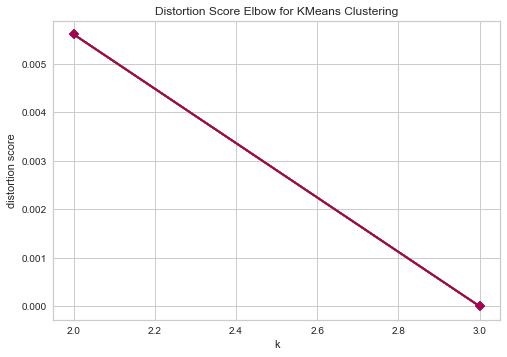

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1240
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1241


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

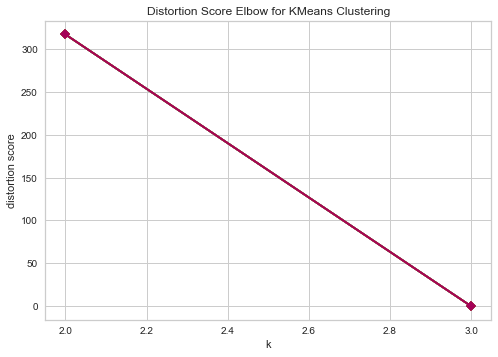

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1242
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1243
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1244
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1245
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1246
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1247
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1248


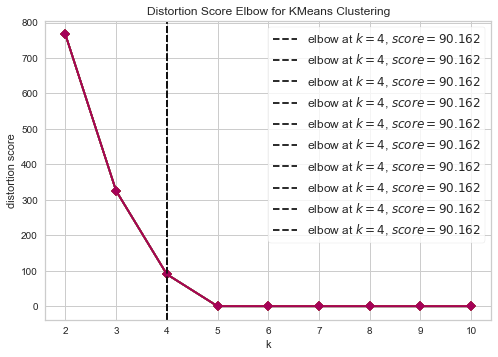

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1249


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X

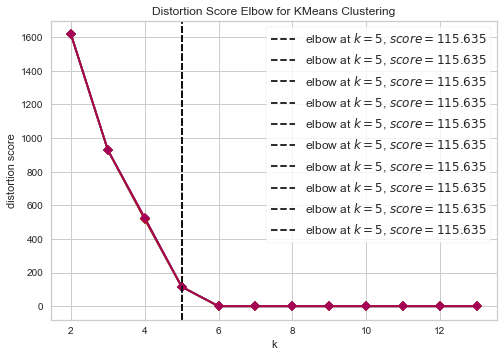

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1250
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1251
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1252


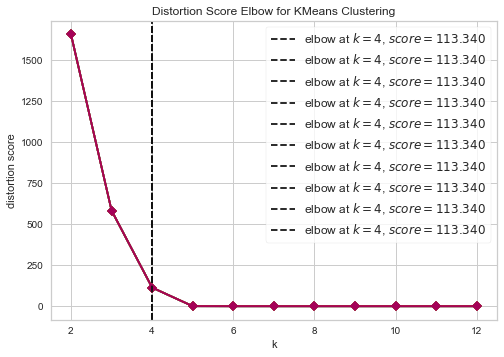

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1253


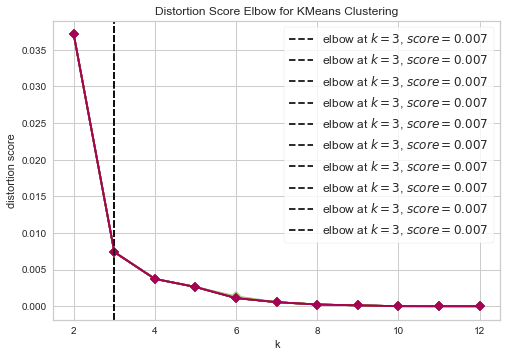

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1254


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1255


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

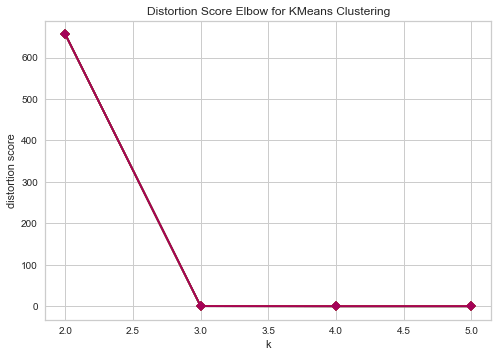

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1256


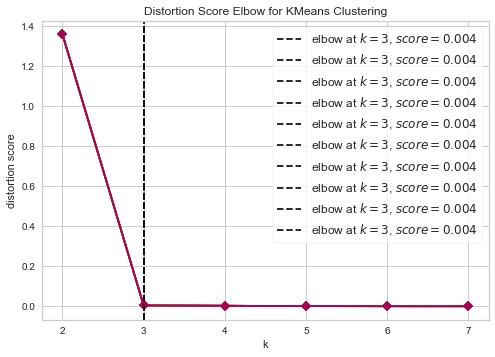

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1257


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

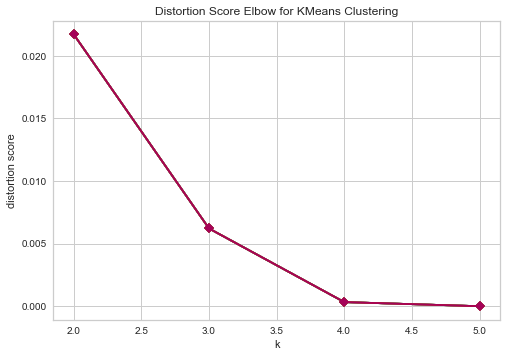

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1258


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1259
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1260
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1261


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

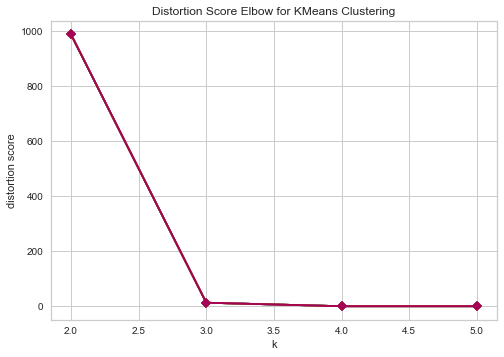

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1262


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: R

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1263


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

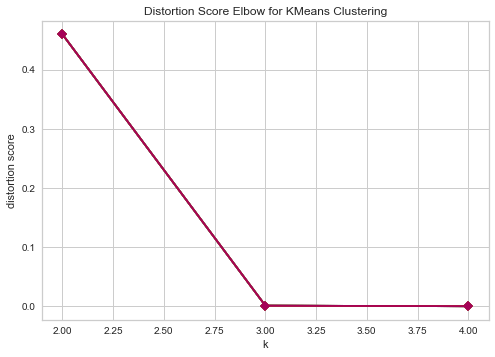

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1264


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **k

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1265
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1266


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1267


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1268
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1269


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

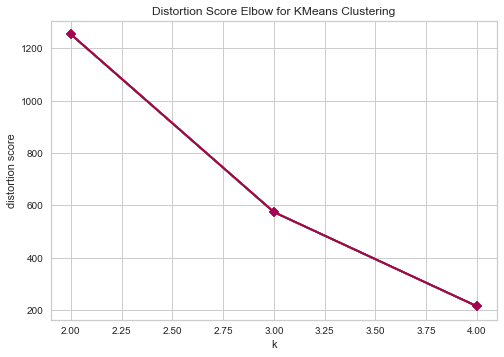

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1270


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

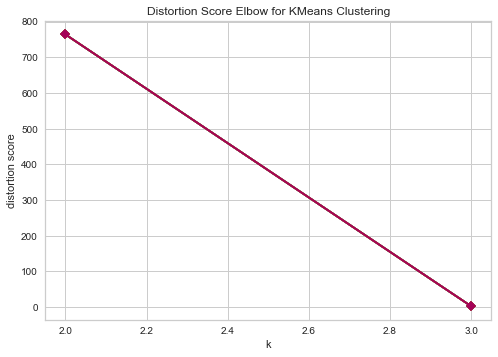

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1271


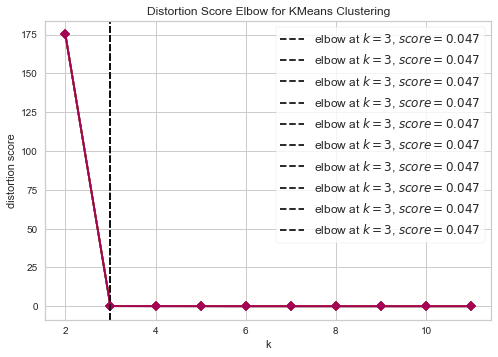

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1272


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

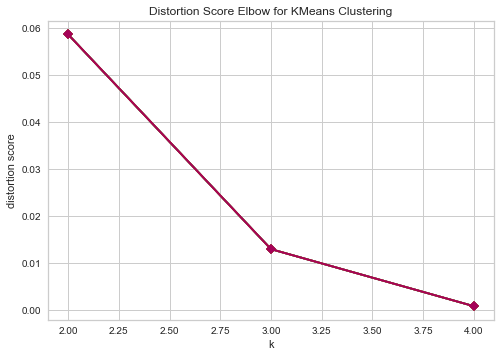

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1273


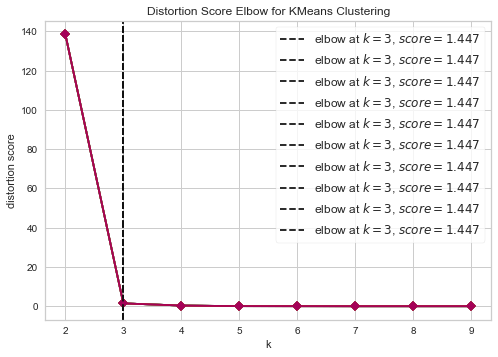

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1274
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1275
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1276


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

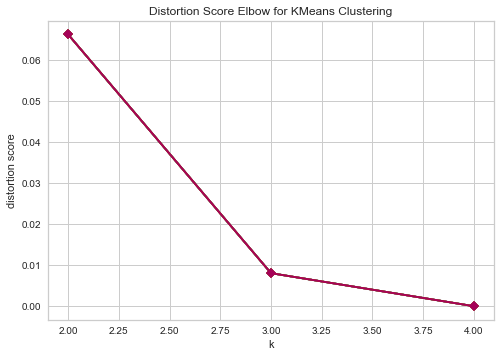

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1277
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1278
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1279
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1280


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

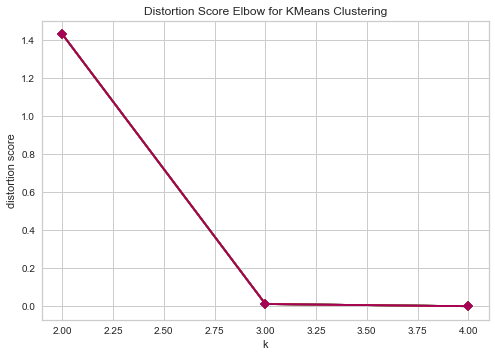

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1281


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

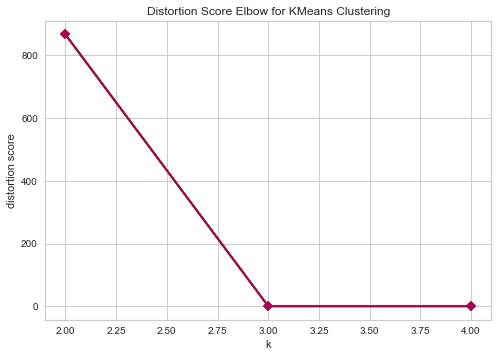

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1282
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1283
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1284
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1285


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

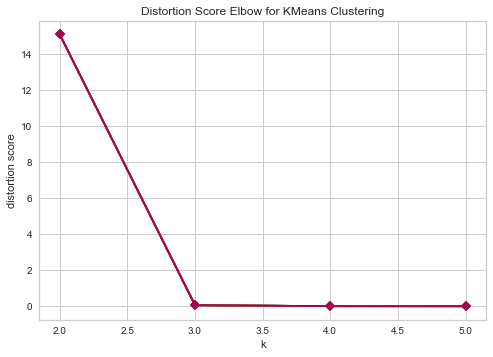

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1286


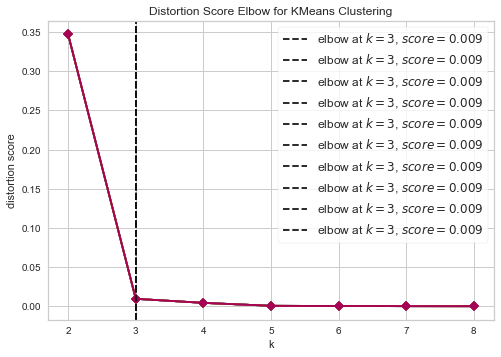

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1287


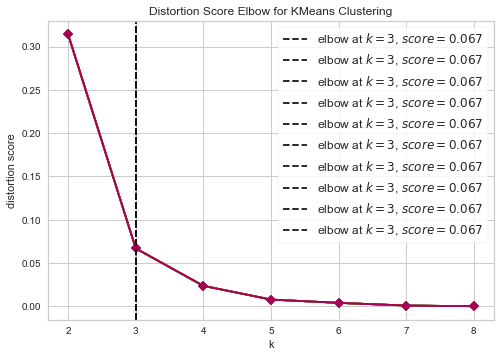

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1288
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1289


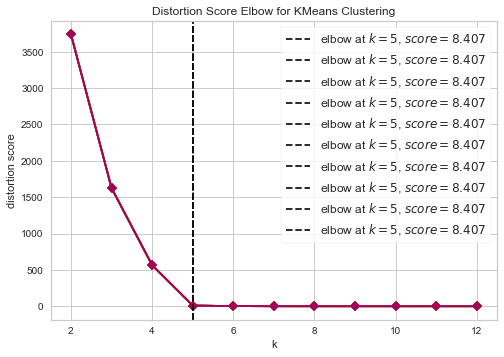

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1290


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **

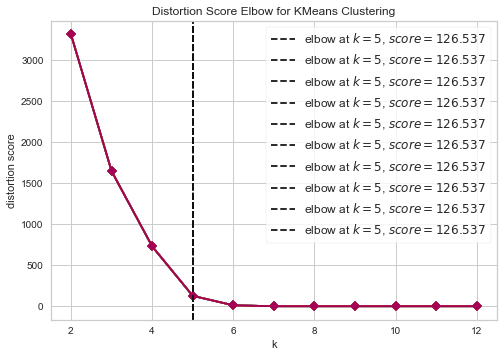

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1291


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (23) found smaller than n_clusters (24). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (23) found smaller than n_clusters (25). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1292
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1293
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1294


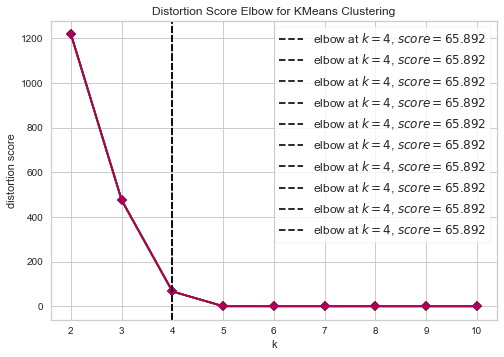

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1295


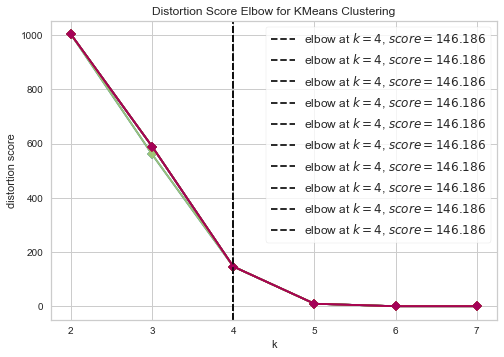

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1296
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1297


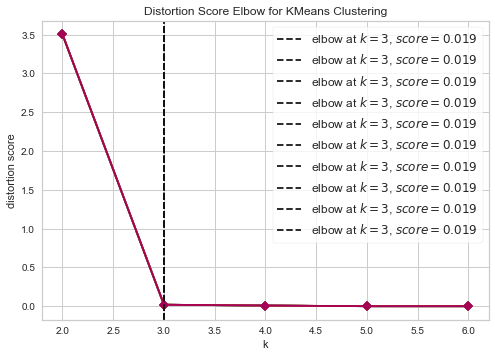

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1298


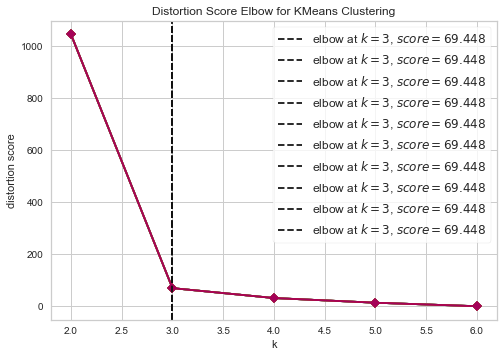

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1299


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (32) found smaller than n_clusters (33). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1300
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1301
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1302
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1303


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

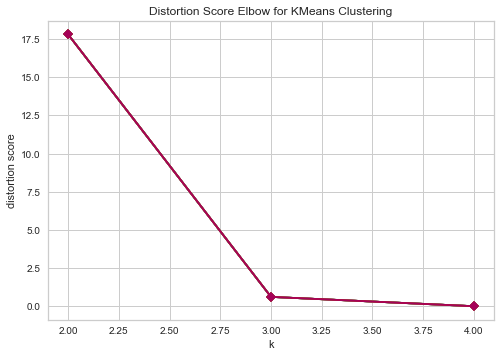

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1304


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

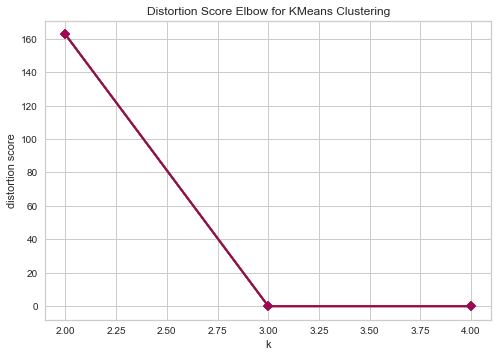

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1305


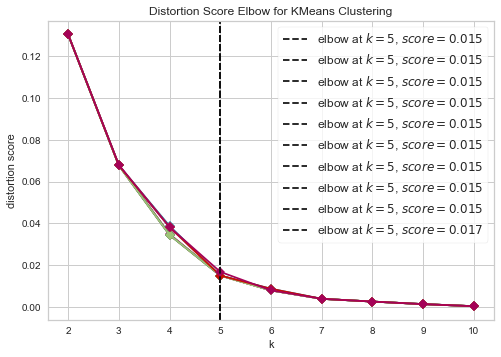

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1306
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1307


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1308


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.

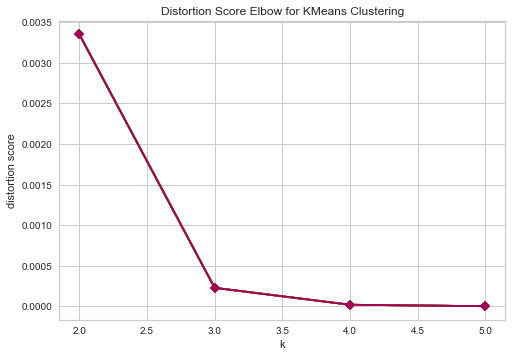

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1309
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1310
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1311
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1312


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1313


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (20). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (19) found smaller than n_clusters (21). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1314


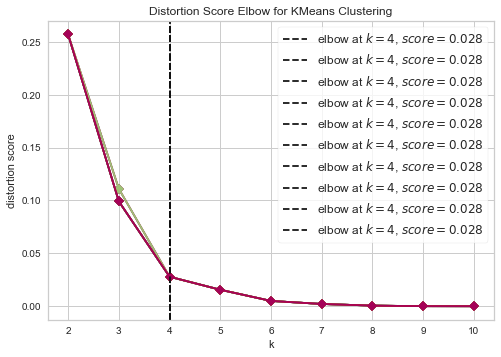

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1315


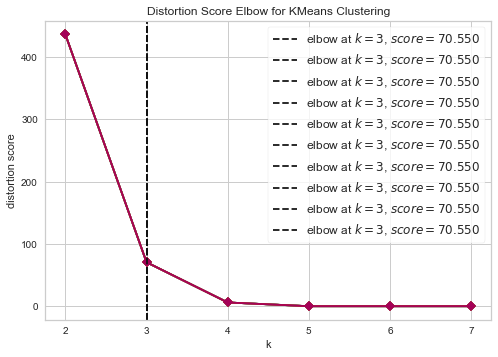

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1316


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

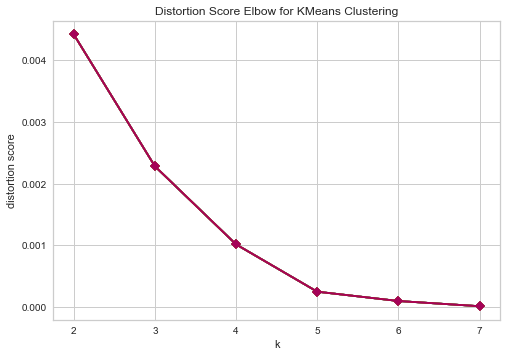

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1317
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1318
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1319


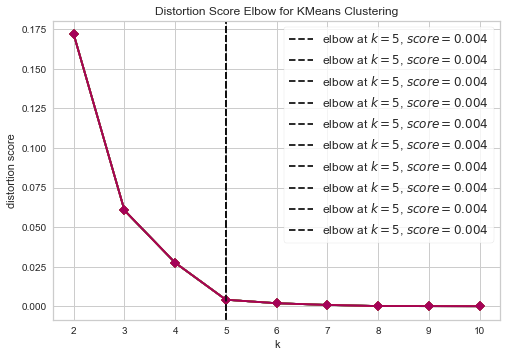

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1320


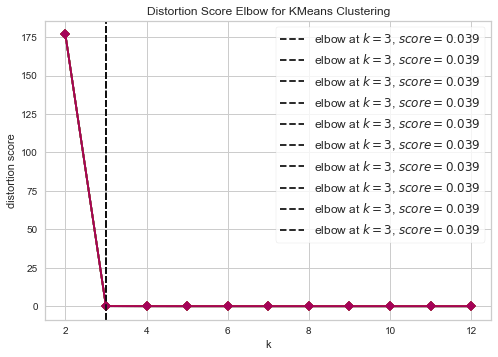

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1321


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

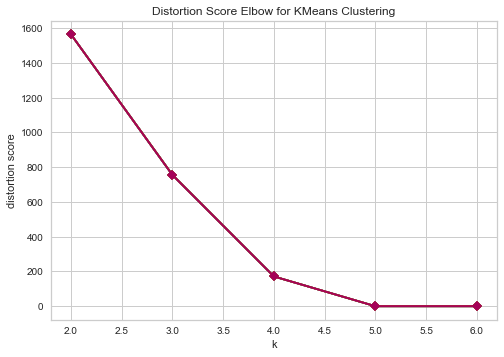

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1322


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

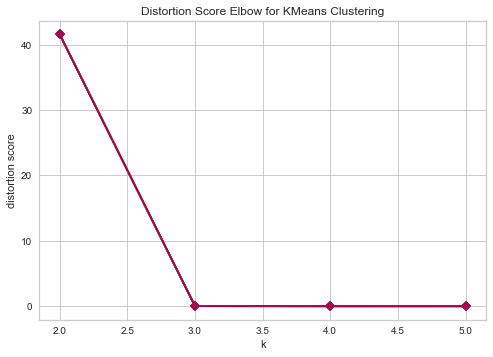

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1323
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1324


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

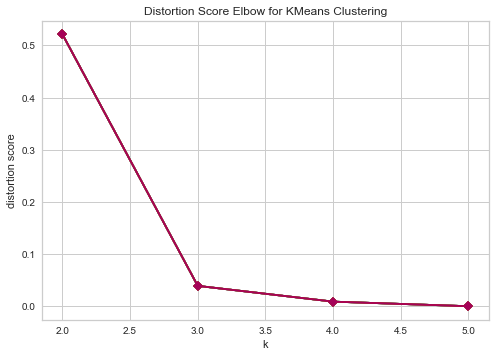

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1325


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1326


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

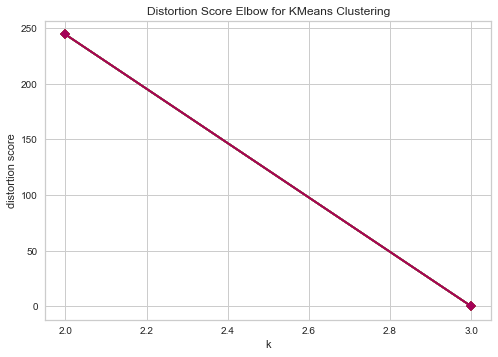

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1327
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1328


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (12) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1329


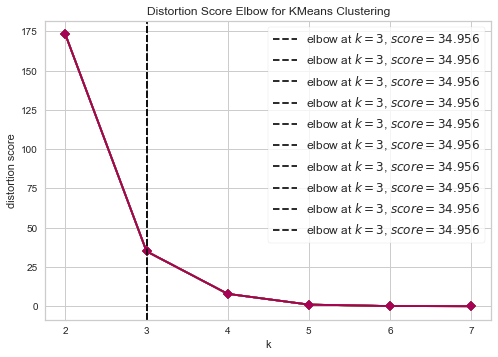

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1330


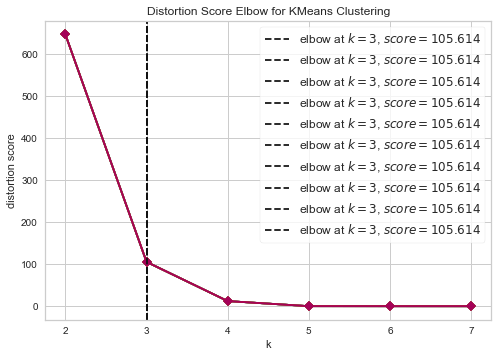

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1331


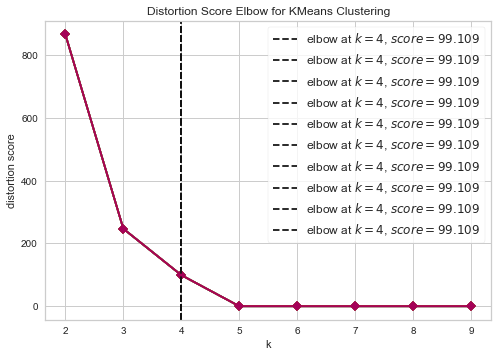

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1332


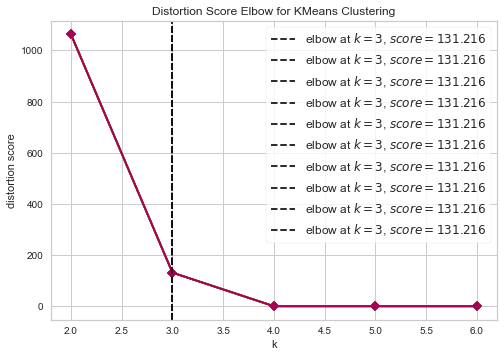

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1333


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

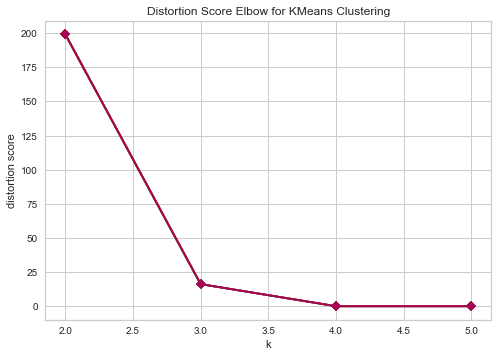

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1334
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1335


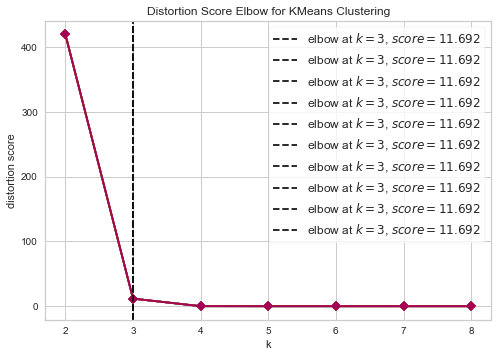

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1336
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1337
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1338
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1339
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1340


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (14) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1341
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1342
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1343


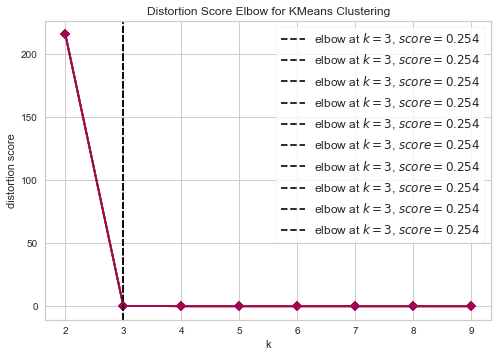

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1344


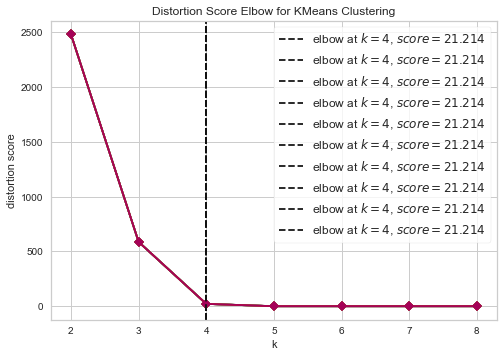

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1345
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1346
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1347
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1348


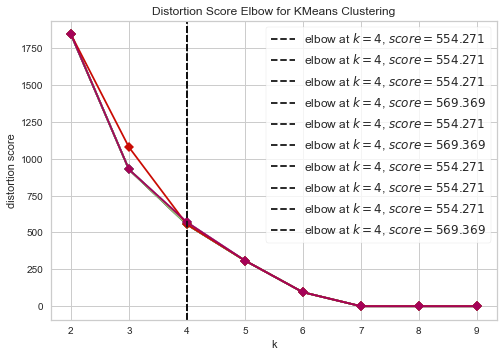

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1349


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

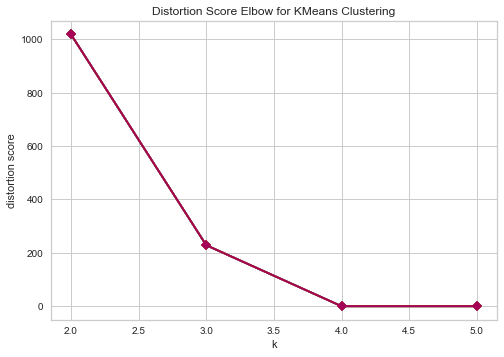

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1350


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1351


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1352


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

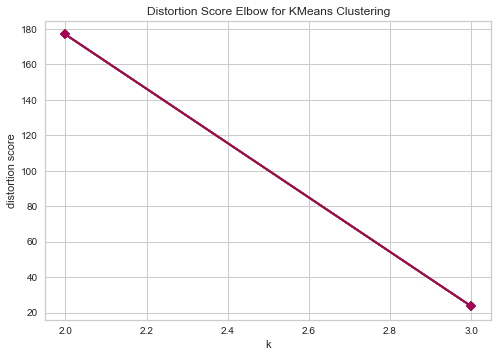

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1353


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

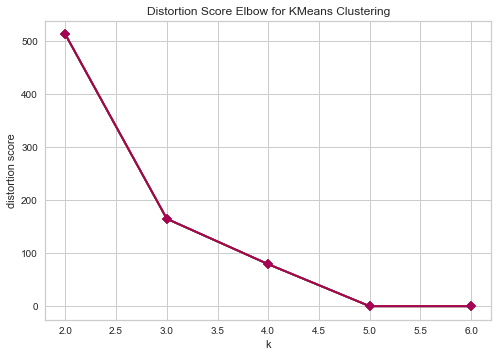

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1354


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

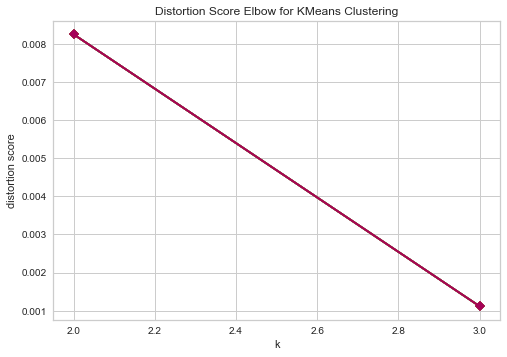

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1355
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1356
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1357
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1358


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (15) found smaller than n_clusters (18). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1359


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

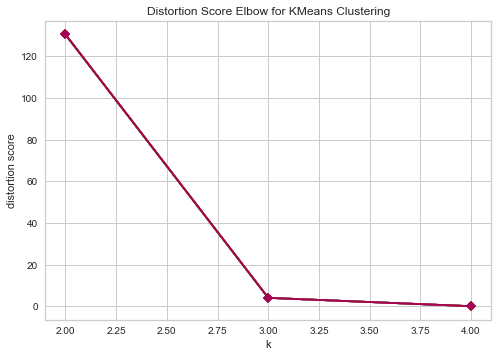

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1360
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1361
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1362
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1363
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1364


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

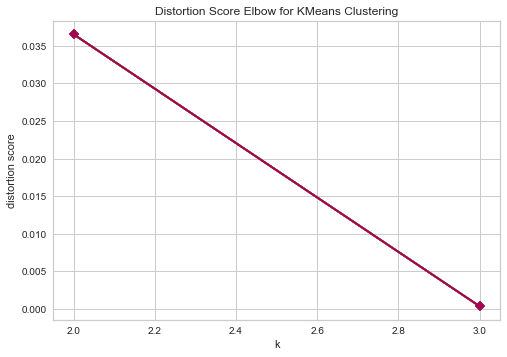

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1365
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1366
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1367


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

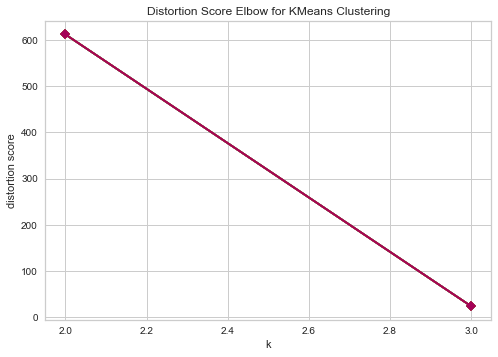

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1368
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1369


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

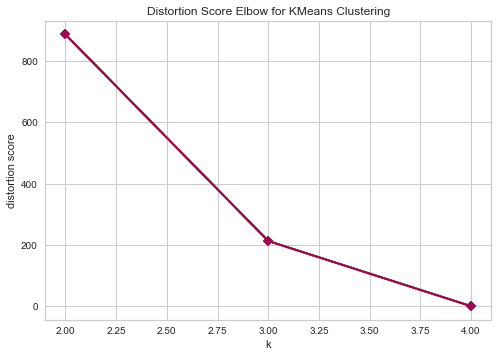

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1370


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

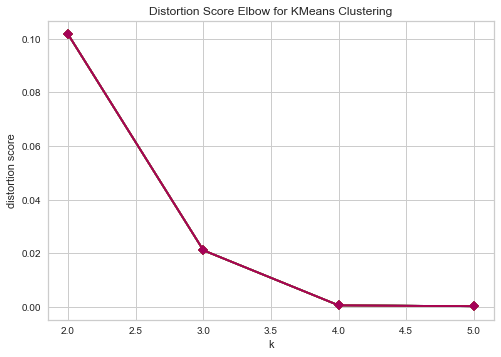

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1371


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

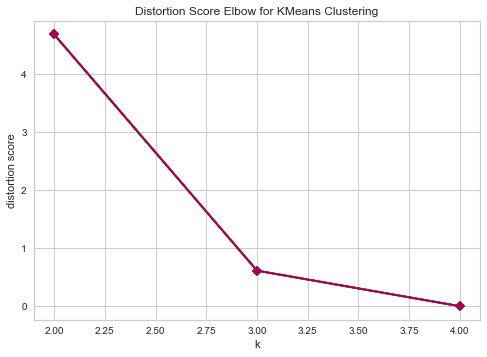

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1372


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1373
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1374
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1375
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1376


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

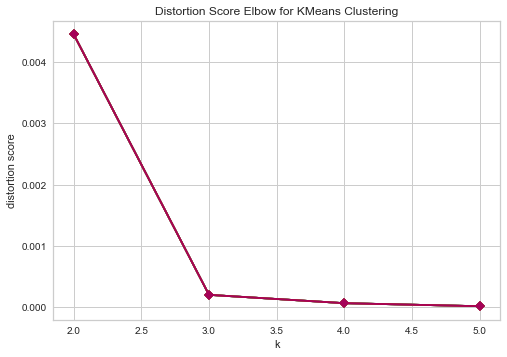

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1377


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

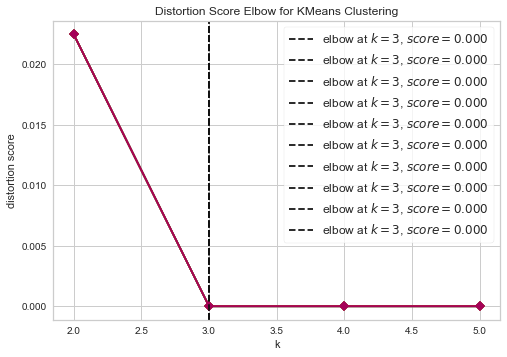

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1378


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

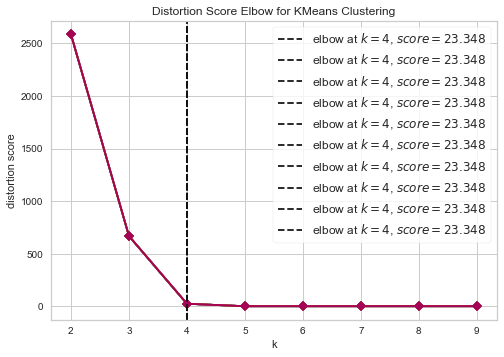

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1379
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1380
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1381
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1382
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1383


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  self.esti

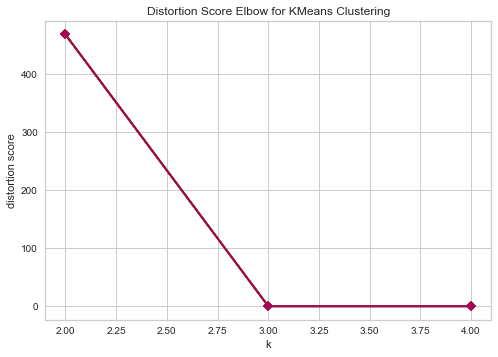

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1384
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1385


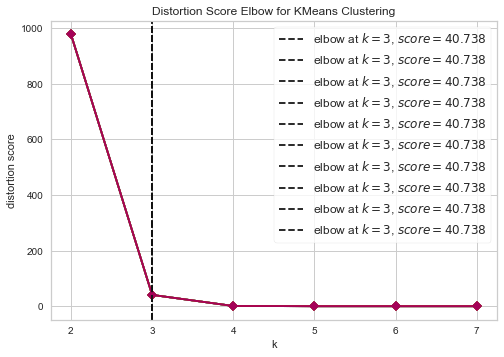

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1386
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1387
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1388
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1389
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1390
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1391
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1392
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1393
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1394
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1395
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1396
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1397


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

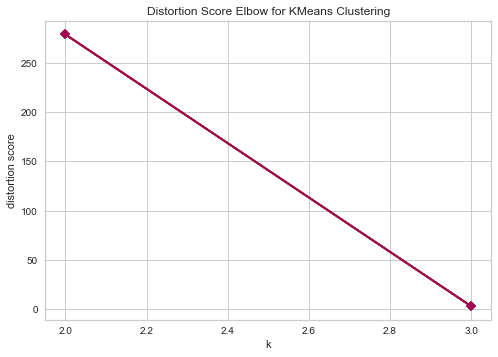

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1398
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1399
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1400
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1401


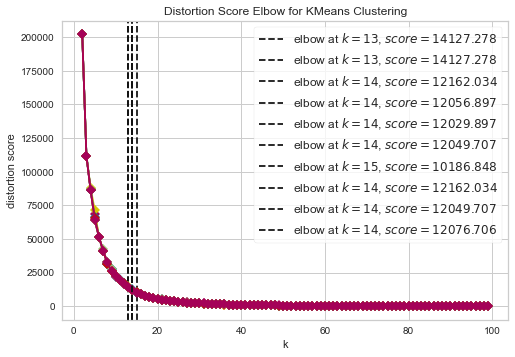

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1402
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1403
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1404
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1405
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1406
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1407


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

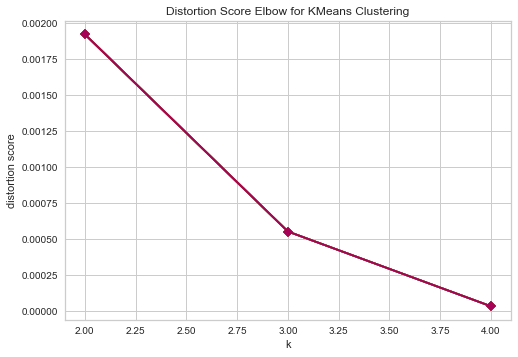

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1408
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1409
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1410


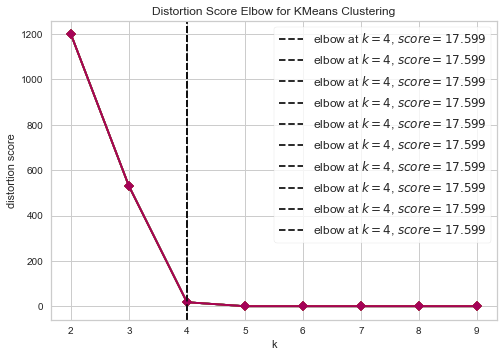

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1411
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1412
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1413
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1414
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1415


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

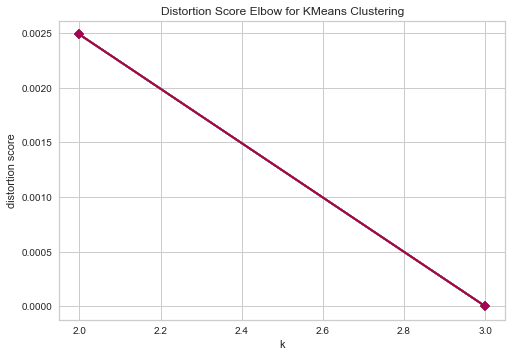

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1416
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1417
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1418
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1419


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (11) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1420
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1421
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1422


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

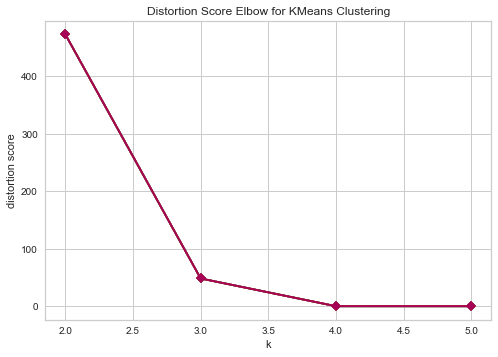

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1423


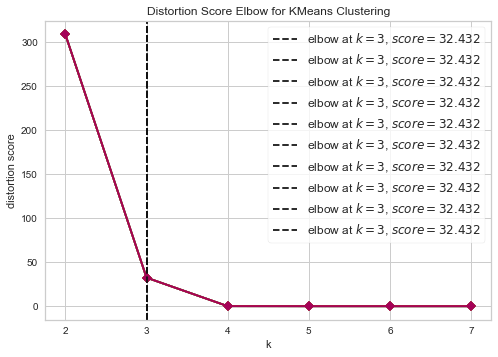

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1424


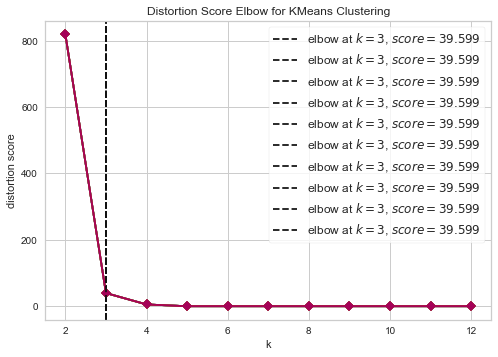

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1425
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1426
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1427
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1428


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' 

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1429


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being 

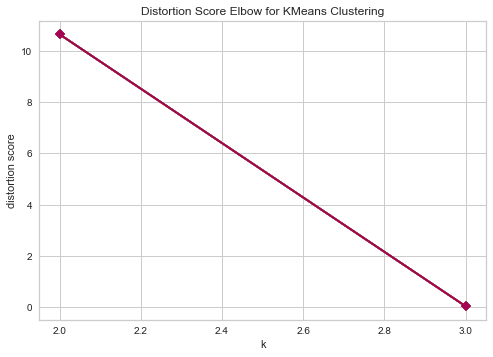

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1430


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (16) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1431
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1432
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1433


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

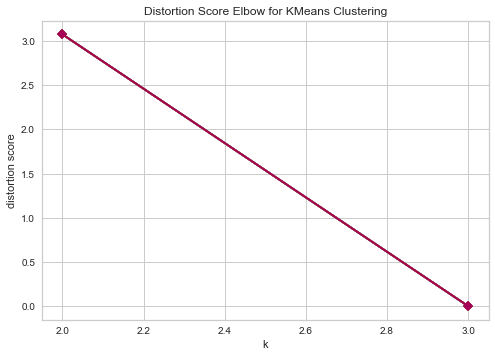

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1434


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.esti

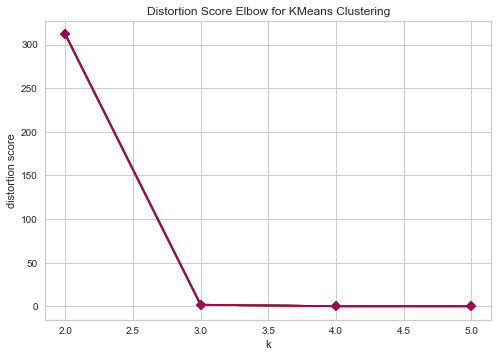

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1435


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

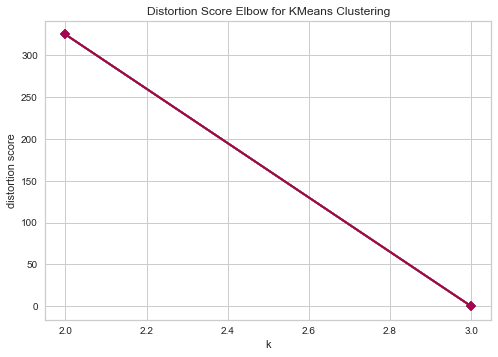

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1436


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

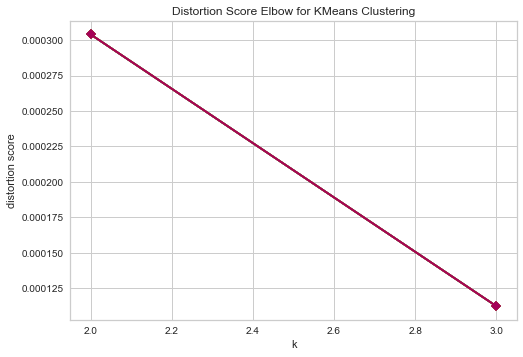

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1437
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1438
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1439


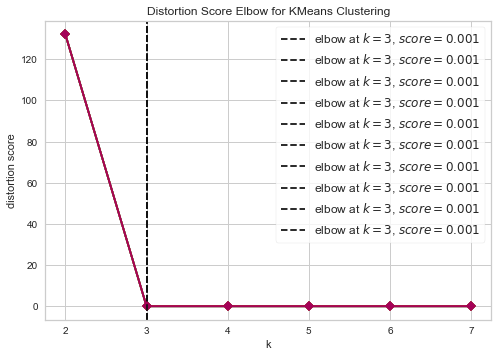

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1440


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1441
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1442
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1443
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1444
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1445
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1446


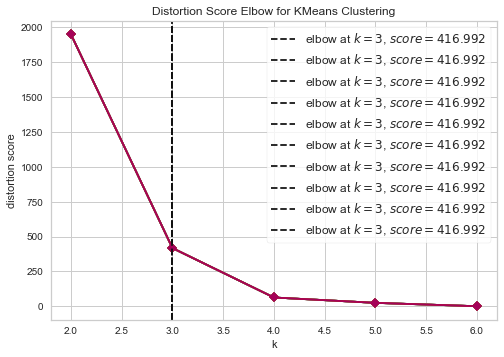

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1447
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1448


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

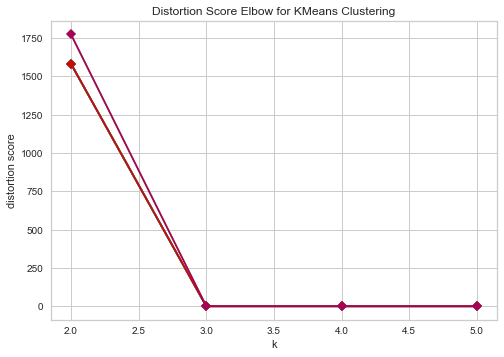

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1449


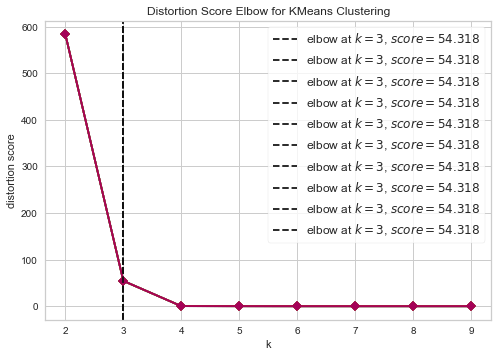

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1450
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1451


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

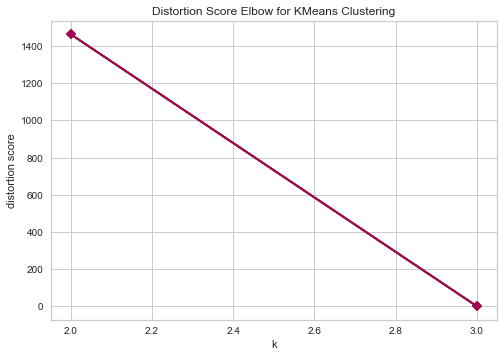

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1452


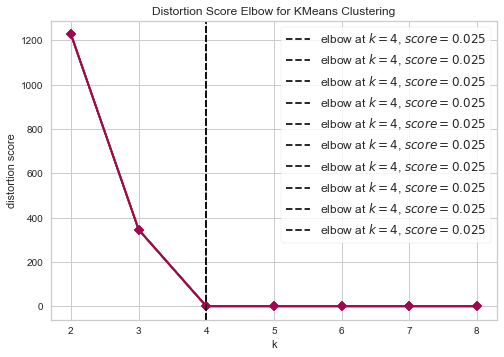

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1453
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1454


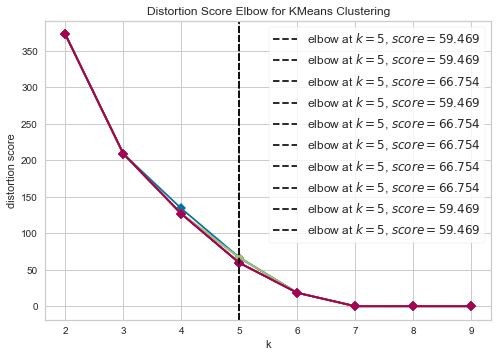

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1455


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

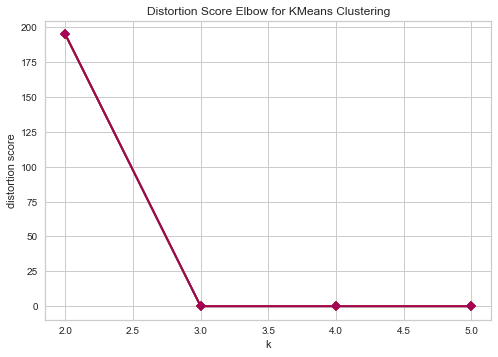

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1456


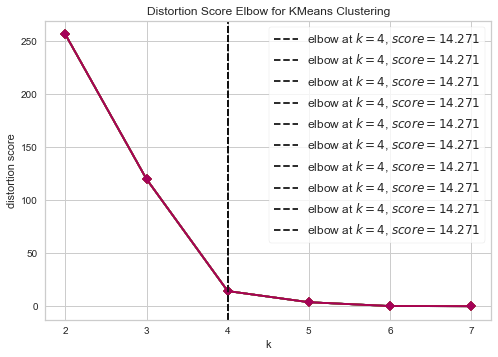

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1457
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1458
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1459


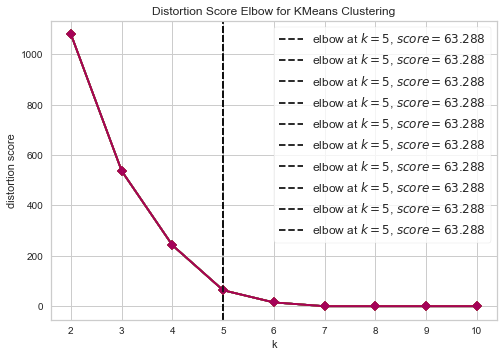

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1460


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

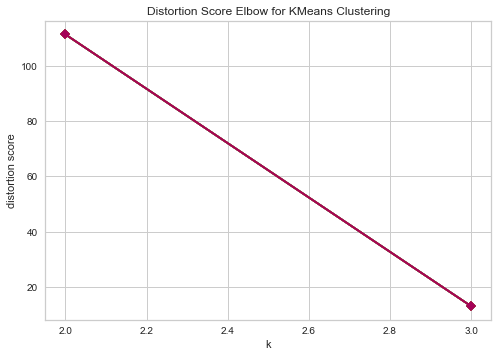

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1461


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

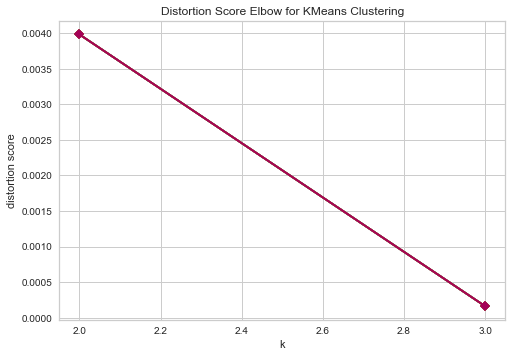

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1462


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

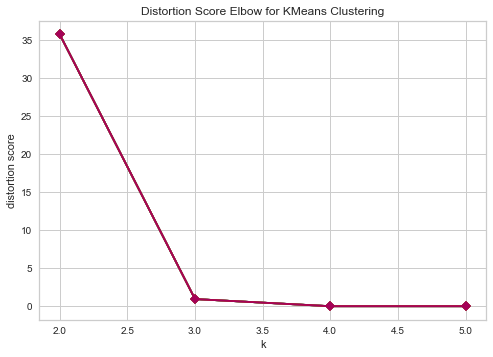

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1463
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1464


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

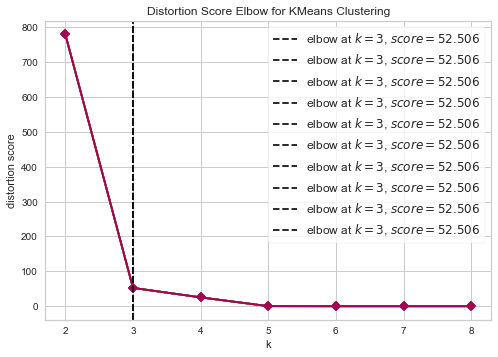

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1465


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

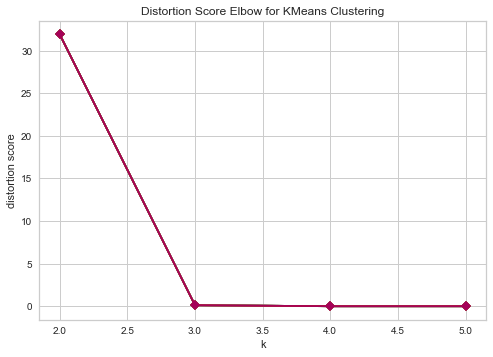

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1466


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

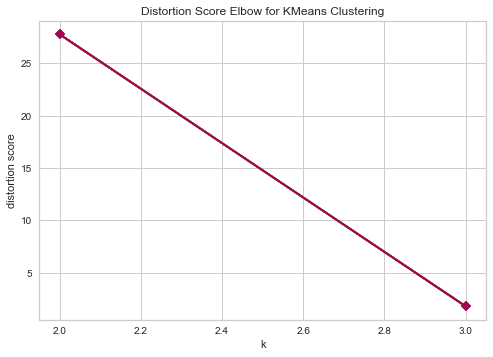

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1467


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.esti

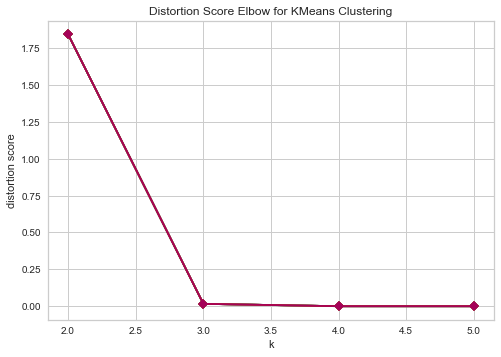

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1468
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1469
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1470
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1471


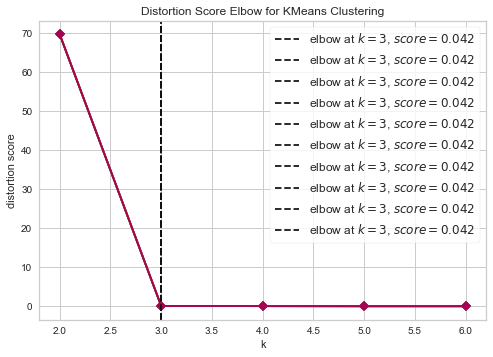

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1472
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1473


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

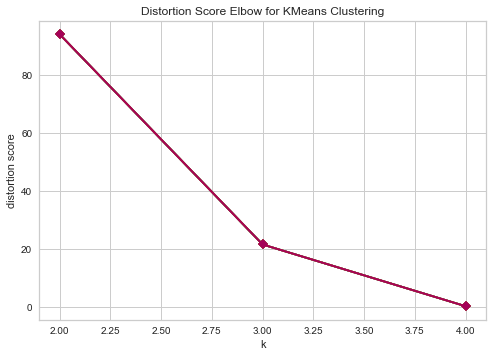

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1474
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1475
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1476


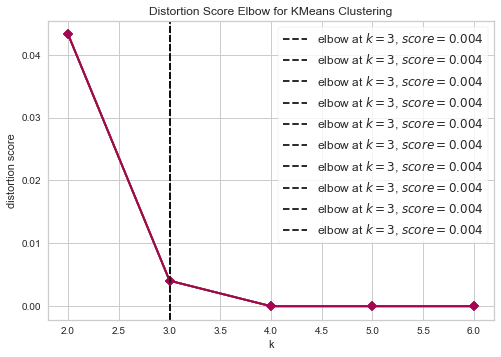

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1477


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

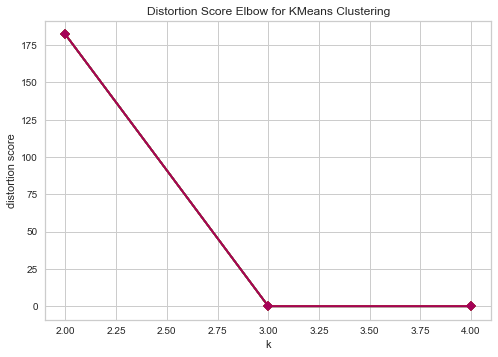

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1478
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1479
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1480
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1481
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1482
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1483
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1484
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1485
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1486
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1487


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

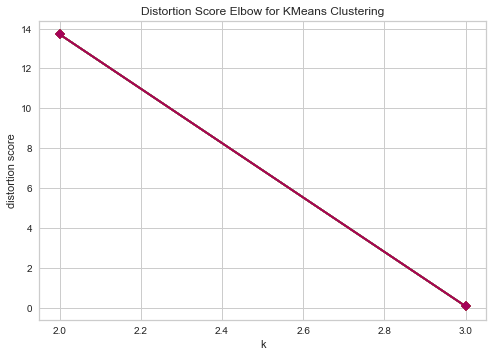

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1488
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1489
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1490


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

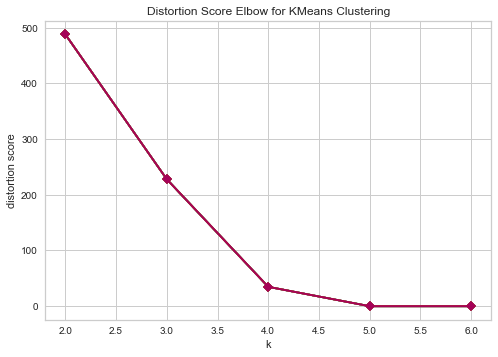

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1491


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

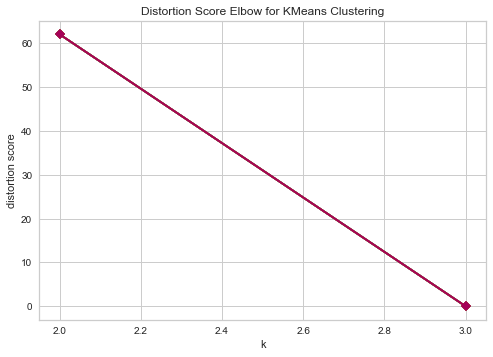

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1492


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

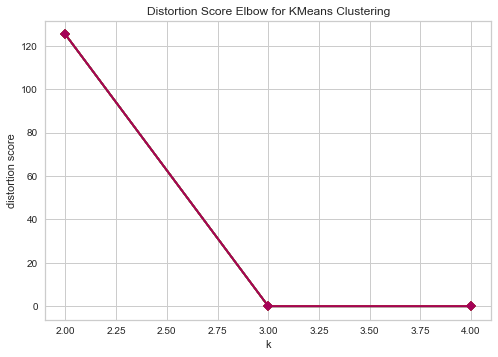

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1493
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1494


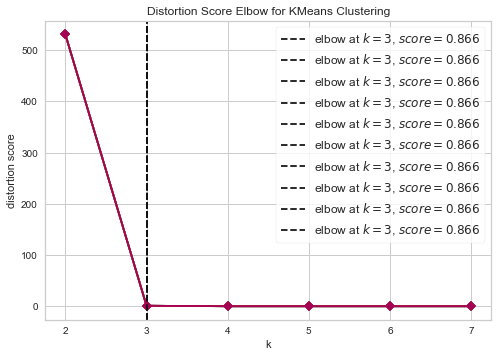

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1495


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (12). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (13). Possibly due to duplicate points in X.
  self.estimator.fit(X, **

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1496
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1497

C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (14). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (15). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (16). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (13) found smaller than n_clusters (17). Possibly due to duplicate points in X.
  self.estimator.fit(X


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1498
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1499
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1500


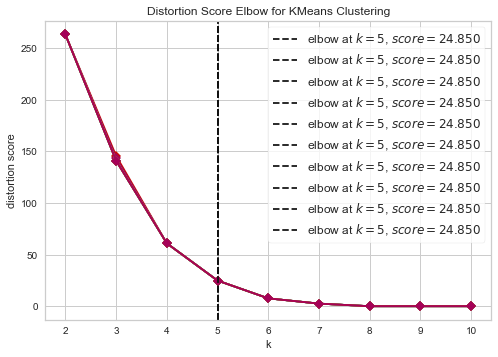

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1501


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (44) found smaller than n_clusters (45). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (44) found smaller than n_clusters (46). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (44) found smaller than n_clusters (47). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (44) found smaller than n_clusters (48). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1502
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1503


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

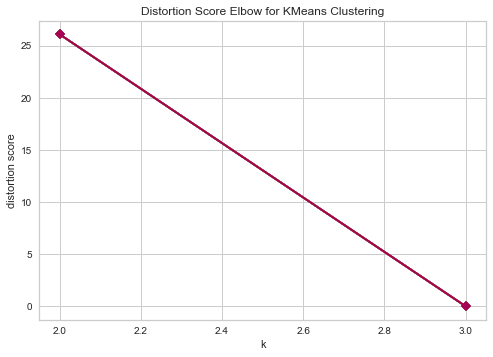

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1504


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (27) found smaller than n_clusters (28). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1505
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1506


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

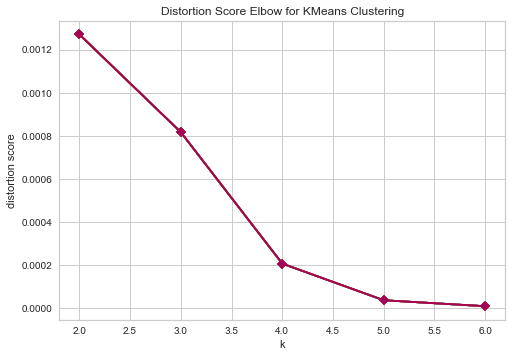

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1507
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1508


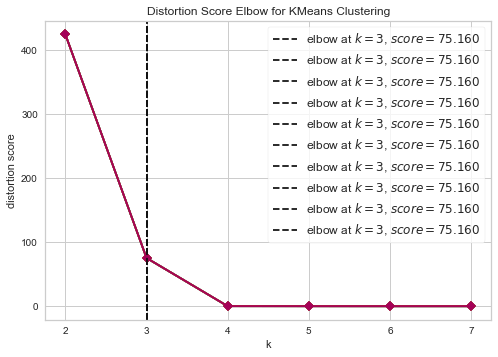

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1509
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1510
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1511
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1512
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1513
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1514
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1515
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1516


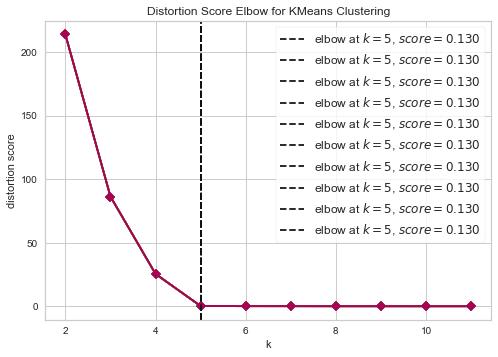

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1517
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1518
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1519


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

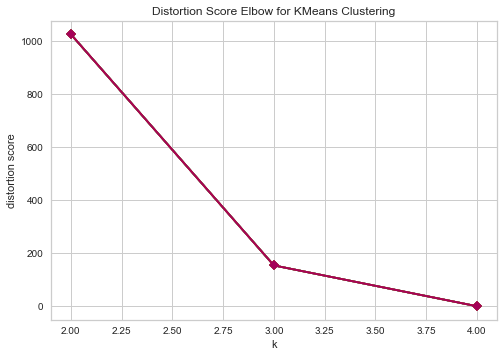

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1520
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1521
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1522
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1523
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1524
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1525
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1526


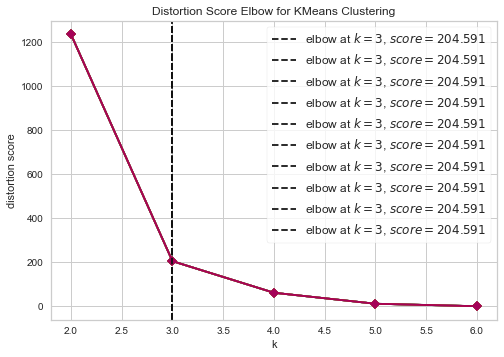

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1527
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1528
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1529
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1530


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

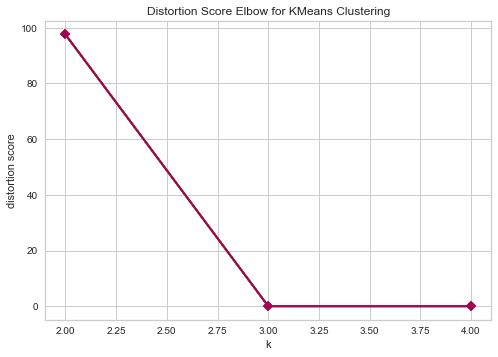

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1531
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1532
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1533
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1534


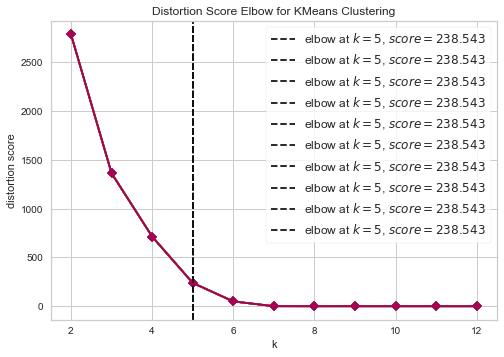

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1535
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1536
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1537


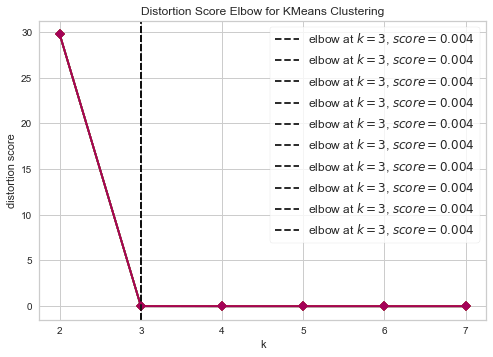

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1538


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

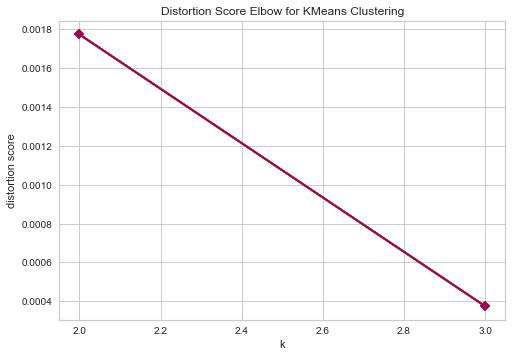

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1539
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1540


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

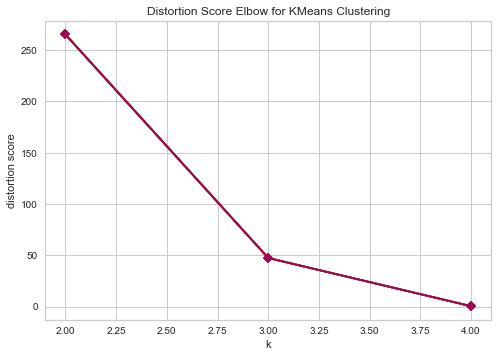

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1541
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1542


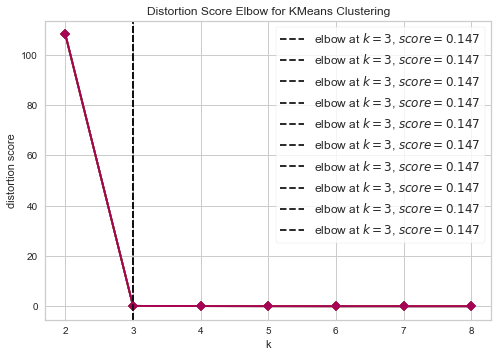

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1543
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1544


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1545


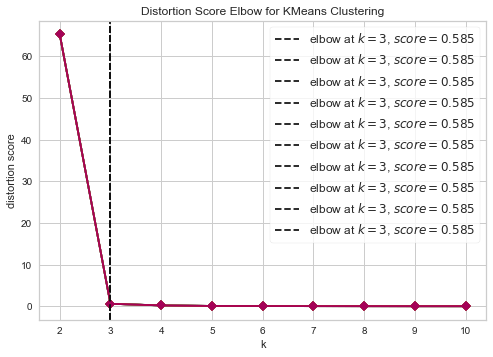

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1546


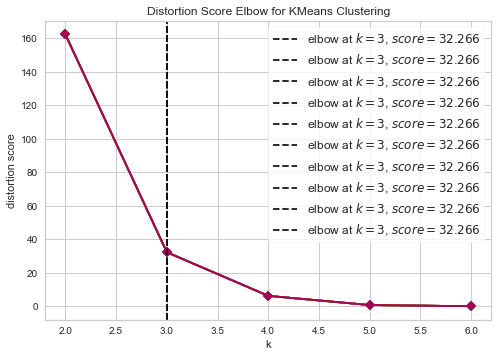

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1547
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1548
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1549
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1550


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

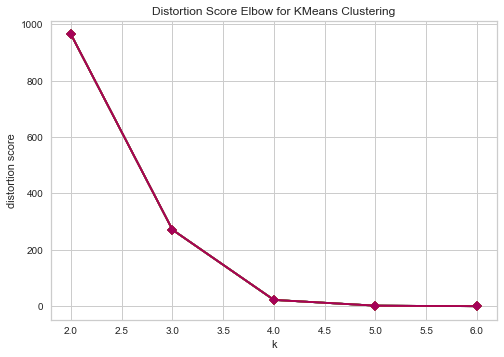

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1551
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1552
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1553
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1554
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1555
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1556


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

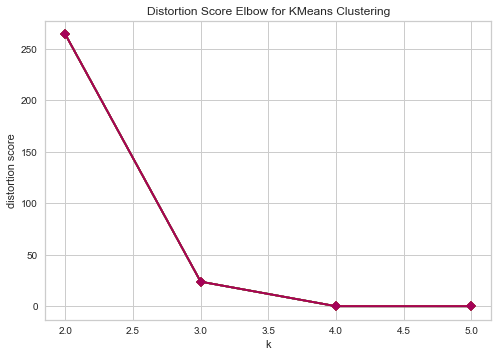

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1557


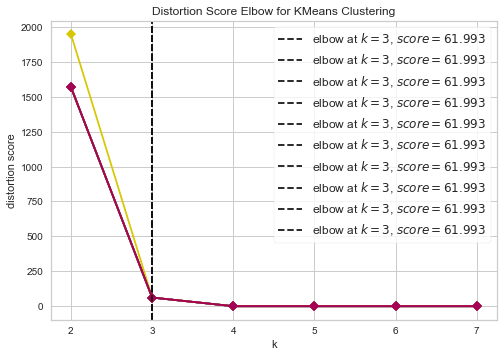

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1558


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwar

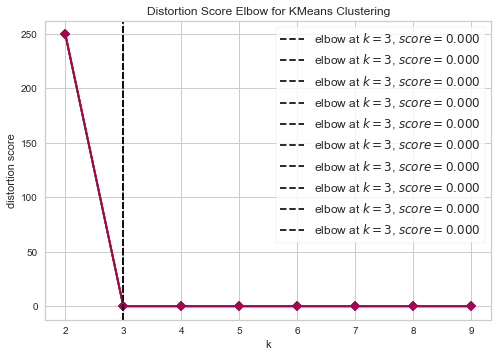

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1559
** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1560


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

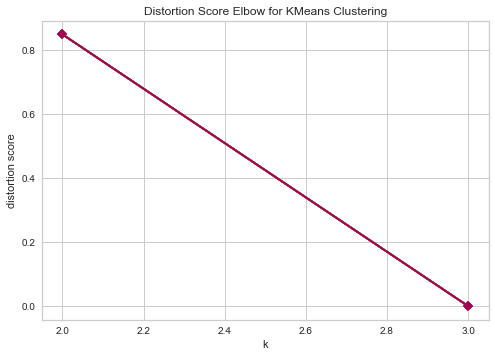

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1561
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1562


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (23). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (24). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (25). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (22) found smaller than n_clusters (26). Possibly due to duplicate points in X.
  self.estimator.fit(X

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1563


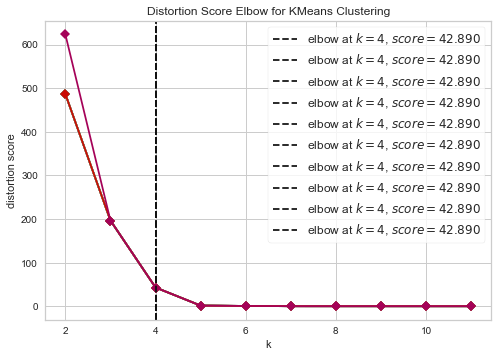

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1564


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  self.esti

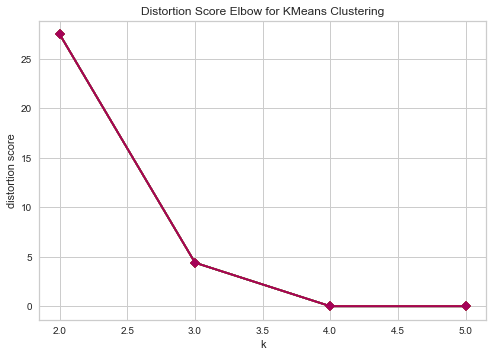

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1565


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

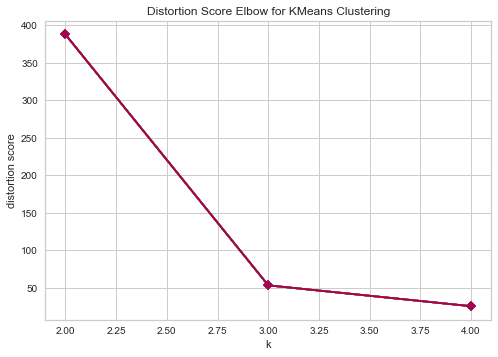

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1566


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.

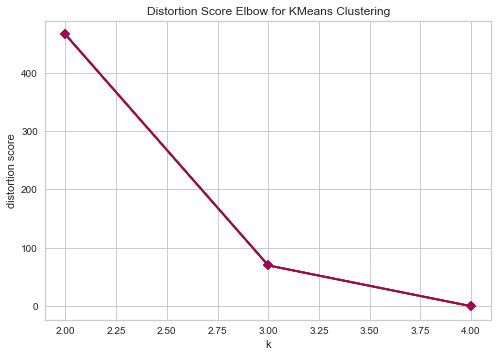

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1567
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1568


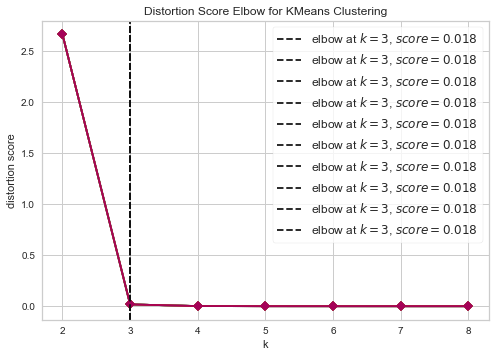

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1569
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1570


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1571
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1572


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being 

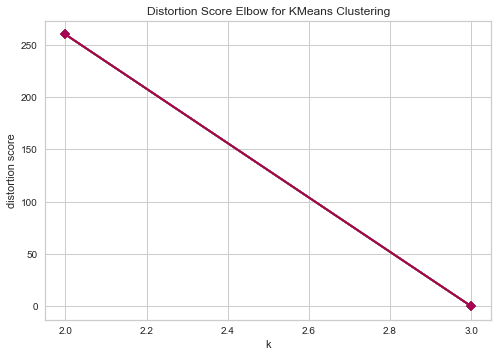

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1573
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1574


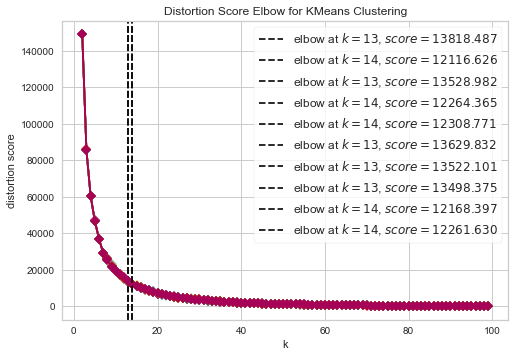

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1575


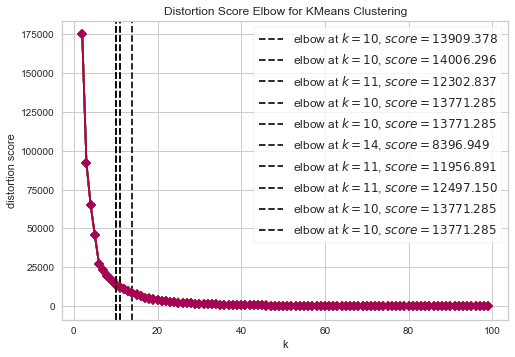

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1576


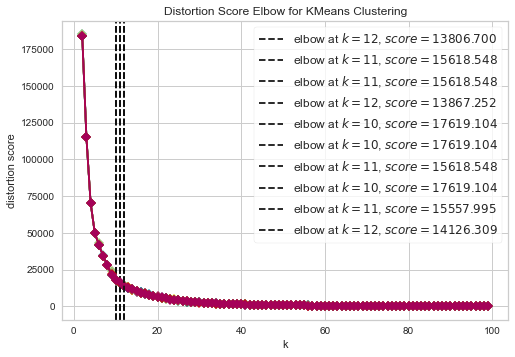

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1577


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:312: ConvergenceWarning: Number of distinct clusters (70) found smaller than n_clusters (71). Possibly due to duplicate points in X.
  self.estimator.fit(X, **kwargs)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:93: RuntimeWarning: Mean of empty slice.
  center = instances.mean(axis=0)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\numpy\core\_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee

** DEU RUIM NO AGRUPAMENTO **
None
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1578


C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\cluster\elbow.py:343: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:182: YellowbrickWarning: No "knee" or "elbow point" detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\jpsan\anaconda3\envs\projetos\lib\site-packages\yellowbrick\utils\kneed.py:140: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being 

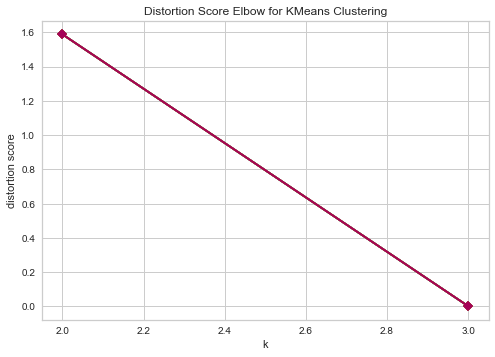

Iniciando Persistencia
Sucesso na inserção
Processando sent: 1579
Iniciando Persistencia
Sucesso na inserção
Processando sent: 1580


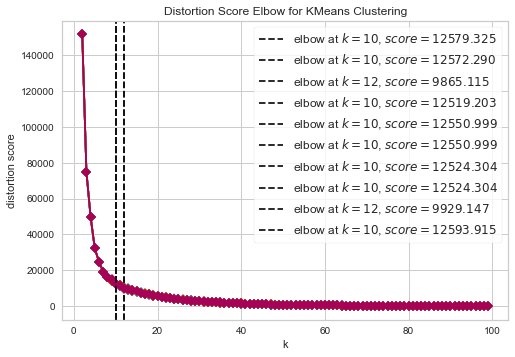

Iniciando Persistencia
Sucesso na inserção

Sentenças com ERRO!:
[2, 3, 5, 10, 12, 14, 17, 19, 34, 35, 37, 40, 41, 43, 46, 48, 49, 51, 52, 60, 61, 63, 65, 66, 67, 72, 75, 77, 78, 79, 84, 90, 101, 105, 106, 122, 129, 130, 134, 136, 145, 146, 151, 156, 161, 163, 165, 166, 168, 173, 175, 176, 192, 197, 198, 200, 202, 206, 210, 213, 231, 233, 248, 254, 255, 258, 263, 269, 271, 288, 291, 295, 300, 303, 304, 305, 307, 310, 313, 316, 321, 322, 323, 324, 329, 332, 336, 339, 340, 342, 343, 345, 358, 360, 363, 367, 372, 375, 386, 396, 397, 409, 410, 419, 427, 431, 435, 438, 446, 449, 455, 463, 464, 467, 471, 473, 478, 479, 480, 489, 503, 512, 515, 517, 520, 537, 546, 557, 563, 568, 569, 575, 576, 581, 582, 583, 589, 595, 596, 602, 603, 606, 607, 610, 614, 620, 623, 625, 629, 631, 633, 635, 638, 639, 640, 644, 646, 653, 659, 660, 664, 671, 684, 685, 686, 694, 696, 697, 705, 706, 721, 725, 734, 736, 738, 741, 742, 752, 757, 759, 762, 766, 776, 782, 790, 794, 795, 800, 807, 810, 813, 824, 833, 837,

In [9]:
print('Informe tag do método:')
tag_metodo = input()

print('Informe table - embeddings/tsne:')
table = input()

print('Informe a medida do cotovelo - distortion/silhouette/calinski_harabasz:')
metric = input()


query = '''SELECT s.sentenca_id, a.sentenca_id, a.tag_metodo FROM sentencas s LEFT JOIN
    agrupamento a ON s.sentenca_id = a.sentenca_id and tag_metodo = "{}" where a.sentenca_id is null
;'''.format(tag_metodo)

df_id_sentencas = read(conn, query)

lista_erros = []
for row in tqdm(df_id_sentencas.iterrows(), total=df_id_sentencas.shape[0]):
    connector = MySQL_Connector("conn_orfeu")
    conn = connector.return_conn(db_name)
    id_sent = row[1]['sentenca_id']
    print(f'''Processando sent: {id_sent}''')
    
    query = "SELECT * FROM {} where label = 'tupla_completa' and sentenca_id = {}".format(table, id_sent)
    df_aux = read(conn, query)
    
    
    num_tuplas_extraidas = df_aux.shape[0]
    categoria = categorizar_tuplas_clusters(num_tuplas_extraidas)

    features = [atr for atr in list(df_aux.columns) if atr not in {"embedding_id","sentenca_id","tupla_id", "label"}]
    componentes = df_aux.loc[:, features].values

    try:
        num_tuplas_candidatas = gerar_modelos_kMeans(componentes, metric)
    except:
        num_tuplas_candidatas = -1
        lista_erros.append(id_sent)
        print(print("** DEU RUIM NO AGRUPAMENTO **"))
            
    dict_data = {
        "sentenca_id": [id_sent],
        "num_tuplas_extraidas":[num_tuplas_extraidas],
        "categoria":[categoria],
        "num_tuplas_candidatas":[num_tuplas_candidatas],
        "tag_metodo": [tag_metodo]

    }

    df_cluster = pd.DataFrame(dict_data)
    status = replace_df(df_cluster,"agrupamento", conn)
    
    if status == -1:
        lista_erros.append(id_sent)
        print("DEU BOOO")
    
    conn.close()
print("Sentenças com ERRO!:")
print(lista_erros)


# Montando Grupos de Tuplas

In [23]:
len(lista_erros)

182

##### Gerando Amostragem Estratifica 
## Conjunto para avaliação Manual
### 95% de nível de confiança e 5 % de erro amostral
### População 1580 sentenças - Conjunto amostral 309 sentenças

In [42]:
query = '''
SELECT 
    categoria, 
    COUNT(sentenca_id) as total_categoria,
    (COUNT(sentenca_id) /(SELECT COUNT(*) from agrupamento WHERE tag_metodo = "tsne_distortion")) as representatividade,
    (SELECT COUNT(*) from agrupamento WHERE tag_metodo = "tsne_distortion") as total_abs
    FROM 
        agrupamento a 
    INNER JOIN 
        sentencas s  USING(sentenca_id) 
    WHERE 
        tag_metodo= "tsne_distortion" 
    GROUP BY 1;
'''
tamanho_amostral = 309

df_representatividade = read(conn, query)
df_representatividade['total_amostragem'] = df_representatividade.apply(lambda x: 
                                                                        tamanho_amostral * x['representatividade'],
                                                                        axis=1)

df_representatividade['total_amostragem_arredondado'] = df_representatividade.apply(lambda x:
                                                                                    math.ceil(x['total_amostragem']),
                                                                                    axis=1)

print("Total de sentenças: {}".format(df_representatividade['total_amostragem_arredondado'].sum()))
df_representatividade

Total de sentenças: 314


,categoria,total_categoria,representatividade,total_abs,total_amostragem,total_amostragem_arredondado
0,<= 10,279,0.1766,1580,54.5694,55
1,<= 15,115,0.0728,1580,22.4952,23
2,<= 20,48,0.0304,1580,9.3936,10
3,<= 25,37,0.0234,1580,7.2306,8
4,<= 30,26,0.0165,1580,5.0985,6
5,<= 5,993,0.6285,1580,194.2065,195
6,> 30,82,0.0519,1580,16.0371,17


 ### Selecionando as sentenças aleatórias

In [45]:
for row in df_representatividade.iterrows():
    categoria = row[1]['categoria']
    n_amostras = row[1]['total_amostragem_arredondado']
    query = '''
    SELECT 
        sentenca_id, 
        num_tuplas_extraidas, 
        categoria,
        sentenca
    FROM 
        agrupamento
    INNER JOIN sentencas USING(sentenca_id)
    WHERE tag_metodo = "tsne_distortion" 
    AND categoria = '{}' '''.format(categoria)
    df_sentencas = read(conn, query)
    df_amostra = df_sentencas.sample(n=n_amostras, random_state=1)
    
    status = replace_df(df_amostra,"espaco_amostral_sentenca", conn)
    if status == -1:
        print("EROO!!!!!!!!!!")

Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção
Iniciando Persistencia
Sucesso na inserção


### Persistindo as tuplas do espaço amostral das sentenças

In [2]:
query = "SELECT * FROM espaco_amostral_sentenca"

df_amostra = read(conn, query)

for row in df_amostra.iterrows():
    sentenca_id = row[1]['sentenca_id']
    query = f'''SELECT tupla_id, sentenca_id, video_id FROM tuplas where sentenca_id = '{sentenca_id}' '''
    df_tuplas = read(conn, query)
    replace_df(df_tuplas,"espaco_amostral_tuplas", conn)

print("Pronto!")

In [57]:
connector = MySQL_Connector("conn_orfeu")
conn = connector.return_conn(db_name)

In [56]:
conn.close()